**last update: 08/27/2024**  

This notebook is for Bayesian Gaussian process regression test.

Dataset: sythetic data with middle-range oscillations(decades). Annual mean. 100 models in total. Use last 16 models(85-100) as example.

Design: Test different kernels with middle-range oscillation data and give evaluations, for sum of periods & poly(periodic transform). Also for some kernels, consider the evolving uncertainty with more observation years.

Note: In this notebook, there is cross validation(leave-one-out). Only use the mean value of other models as prior and plot.

# Package

In [3]:
import numpy as np
from sklearn.model_selection import GridSearchCV
from tqdm import tqdm
from sklearn.gaussian_process import GaussianProcessRegressor
from sklearn.gaussian_process.kernels import RBF, WhiteKernel, ExpSineSquared, ConstantKernel as C
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.model_selection import RandomizedSearchCV, ParameterGrid
from scipy.optimize import minimize
from pyswarm import pso
from bayes_opt import BayesianOptimization
from scipy.linalg import cholesky, cho_solve,cho_factor,solve_triangular
from scipy.signal import periodogram, welch
from scipy.fft import fft
from statsmodels.tsa.stattools import acf
from sklearn.gaussian_process.kernels import Kernel, WhiteKernel, Matern, RationalQuadratic as RQ, ConstantKernel as C
from sklearn.preprocessing import PolynomialFeatures
from sklearn.gaussian_process import GaussianProcessRegressor
import pywt
from sklearn.gaussian_process.kernels import RBF, ConstantKernel as C, Matern, RationalQuadratic, DotProduct
from sklearn.preprocessing import PolynomialFeatures
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
from bayes_opt import BayesianOptimization, UtilityFunction
from properscoring import crps_gaussian
import gpflow
from gpflow.utilities import print_summary
from gpflow.kernels import RBF, Cosine, Product
from sklearn.preprocessing import StandardScaler

# Data

In [5]:
rainfall = pd.read_csv('../data/rainfall_m.csv')
mod_ids = range(0, 16)
selected_data = rainfall.iloc[84:, 1:]
years = (selected_data.shape[1] // 12)
rainfall_yearly = pd.DataFrame()
for i in range(years):
    rainfall_yearly[i] = selected_data.iloc[:, i*12:(i+1)*12].sum(axis=1)
rainfall_yearly = rainfall_yearly.T
rainfall_yearly.columns = [i+1 for i in range(rainfall_yearly.shape[1])]
rainfall_log = np.log(rainfall_yearly + 1) 
scaler = StandardScaler()
rainfall_yearly = pd.DataFrame(scaler.fit_transform(rainfall_log), columns=rainfall_log.columns)

rainfall_yearly

,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16
0,1.049966,0.276897,0.874912,1.772975,0.605859,0.863551,-0.731022,1.029105,0.319255,0.862609,2.132996,0.377635,-0.064082,0.093615,-1.981993,0.260908
1,0.390946,0.837564,0.871308,1.403351,-0.459364,0.504716,-2.407239,-0.685544,0.463307,0.893008,1.136712,0.284846,-0.365617,-1.079729,-1.692198,0.315072
2,1.830923,-0.550517,-0.398956,1.984271,-0.480969,1.449409,0.137895,0.180023,-0.851568,0.992318,1.914690,-0.693830,0.737268,0.260501,-3.116443,-0.268992
3,1.485755,0.135762,0.472961,1.373483,-1.316320,0.582573,-0.293820,-1.546502,-1.558712,0.946819,0.958237,0.022173,0.424905,0.028166,-1.062340,0.682070
4,2.020372,-1.352819,-1.152945,0.750390,-0.851906,1.395672,1.022974,-0.285297,-0.958991,0.825932,1.349030,-1.254039,1.362815,1.103070,-1.827895,-0.479434
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
95,0.948401,0.002774,0.909081,1.002059,0.097801,-0.977564,0.173246,0.582172,1.023844,0.717312,0.410748,1.226527,-0.261971,-0.872041,0.305036,-1.169992
96,-0.852383,-1.080139,0.680747,0.311569,0.873568,-1.110551,0.765457,1.474393,0.951189,1.496613,0.714005,0.535492,-1.053094,-1.781398,-0.084400,0.626895
97,0.497514,-1.016166,1.915212,0.685441,-0.253651,-2.594711,1.172601,0.039564,0.933429,0.225912,0.706382,-0.096933,-1.332825,-0.213815,0.688473,-1.473634
98,-1.550581,-1.424015,1.646452,-0.712438,0.157370,-2.257376,0.926809,0.713061,0.894607,0.916736,1.128019,-0.593580,-1.918319,-1.017916,-0.478487,0.318546


In [6]:
selected_data = rainfall.iloc[:, 1:]
years = (selected_data.shape[1] // 12)
rainfall_all = pd.DataFrame()
for i in range(years):
    rainfall_all[i] = selected_data.iloc[:, i*12:(i+1)*12].sum(axis=1)

rainfall_all = rainfall_all.T
rainfall_all.columns = [i+1 for i in range(rainfall_all.shape[1])]
rainfall_all_log = np.log(rainfall_all + 1)
scaler = StandardScaler()
rainfall_all = pd.DataFrame(scaler.fit_transform(rainfall_all_log), columns=rainfall_all_log.columns)

rainfall_all

,1,2,3,4,5,6,7,8,9,10,...,91,92,93,94,95,96,97,98,99,100
0,-2.439274,1.174882,-0.733376,-0.521282,-1.100109,0.832297,-0.843171,-0.080403,1.918096,-0.136646,...,-0.731022,1.029105,0.319255,0.862609,2.132996,0.377635,-0.064082,0.093615,-1.981993,0.260908
1,-0.787676,1.246921,1.582399,0.639681,-0.829540,0.529371,-1.357066,-0.271575,1.486388,-1.128430,...,-2.407239,-0.685544,0.463307,0.893008,1.136712,0.284846,-0.365617,-1.079729,-1.692198,0.315072
2,-1.279370,0.678254,0.171822,-1.283355,-0.220452,1.310369,-0.551705,-0.360746,1.531186,-1.384989,...,0.137895,0.180023,-0.851568,0.992318,1.914690,-0.693830,0.737268,0.260501,-3.116443,-0.268992
3,0.681263,0.318577,2.131191,-0.154067,-0.983916,0.547115,-0.977466,0.121726,0.047151,-2.210545,...,-0.293820,-1.546502,-1.558712,0.946819,0.958237,0.022173,0.424905,0.028166,-1.062340,0.682070
4,0.824932,0.380310,-0.195647,-0.464396,0.327646,1.225606,0.040750,-0.209179,0.878397,-1.120644,...,1.022974,-0.285297,-0.958991,0.825932,1.349030,-1.254039,1.362815,1.103070,-1.827895,-0.479434
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
95,-0.120060,0.586151,-0.107641,2.273480,-0.260166,0.236297,0.158062,0.725141,-1.362798,0.601651,...,0.173246,0.582172,1.023844,0.717312,0.410748,1.226527,-0.261971,-0.872041,0.305036,-1.169992
96,0.426730,0.372554,-0.813408,0.898837,-0.807246,1.180120,0.162345,-0.226970,0.445007,-0.899512,...,0.765457,1.474393,0.951189,1.496613,0.714005,0.535492,-1.053094,-1.781398,-0.084400,0.626895
97,-0.374703,0.555211,-0.663636,0.860059,-1.191125,-0.572383,-1.281685,-0.014722,-0.343058,-0.101647,...,1.172601,0.039564,0.933429,0.225912,0.706382,-0.096933,-1.332825,-0.213815,0.688473,-1.473634
98,-0.211841,0.084305,-1.462925,-1.274322,-0.777126,0.247174,-1.795521,-0.920524,0.778060,-0.977654,...,0.926809,0.713061,0.894607,0.916736,1.128019,-0.593580,-1.918319,-1.017916,-0.478487,0.318546


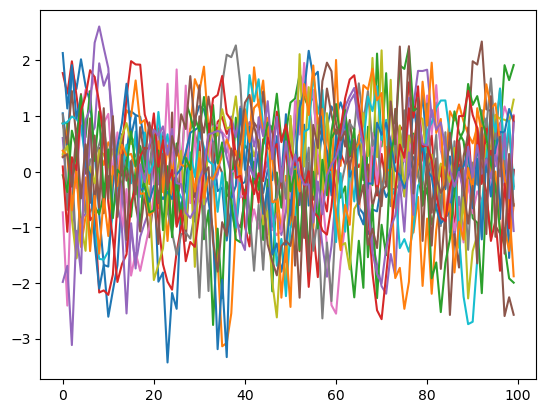

In [7]:
plt.plot(rainfall_yearly)

# Periodic Analysis

In [8]:
# Function to plot and return the top 3 periodicities for each method
def analyze_periodicity(data):
    results = {}
    
    # Convert data to numpy array for FFT
    data = np.asarray(data)
    
    # Fourier Transform
    N = len(data)
    T = 1.0
    yf = fft(data)
    xf = np.fft.fftfreq(N, T)[:N//2]
    fft_amplitudes = 2.0/N * np.abs(yf[0:N//2])
    
    # Avoid division by zero
    non_zero_freqs = xf != 0
    xf = xf[non_zero_freqs]
    fft_amplitudes = fft_amplitudes[non_zero_freqs]
    
    fft_peaks = np.argsort(fft_amplitudes)[-3:]
    fft_periods = 1 / xf[fft_peaks]
    results['FFT'] = fft_periods
    
    # Wavelet Transform
    widths = np.arange(1, 31)
    cwt_matr = pywt.cwt(data, widths, 'mexh')[0]
    wavelet_power = np.sum(cwt_matr**2, axis=1)
    wavelet_peaks = np.argsort(wavelet_power)[-3:]
    wavelet_periods = widths[wavelet_peaks]
    results['Wavelet'] = wavelet_periods
    
    # Autocorrelation
    autocorr = acf(data, nlags=N//2)
    autocorr_peaks = np.argsort(autocorr)[-3:]
    results['Autocorrelation'] = autocorr_peaks
    
    # Power Spectral Density
    freqs, psd = periodogram(data)
    non_zero_freqs = freqs != 0
    freqs = freqs[non_zero_freqs]
    psd = psd[non_zero_freqs]
    
    psd_peaks = np.argsort(psd)[-3:]
    psd_periods = 1 / freqs[psd_peaks]
    results['PSD'] = psd_periods
    
    return results

# Perform the analysis for each of the 16 models
all_results = []
for col in rainfall_yearly.columns:
    data = rainfall_yearly[col]
    results = analyze_periodicity(data)
    all_results.append(results)

# Aggregate and print the results
for method in ['FFT', 'Wavelet', 'Autocorrelation', 'PSD']:
    print(f"Top 3 periodicities for {method}:")
    for i, result in enumerate(all_results):
        print(f"Model {i+1}: {result[method]}")
    print("\n")

Top 3 periodicities for FFT:
Model 1: [11.11111111 12.5        14.28571429]
Model 2: [25.         11.11111111 14.28571429]
Model 3: [10.         25.         14.28571429]
Model 4: [20.         16.66666667 14.28571429]
Model 5: [16.66666667 11.11111111 14.28571429]
Model 6: [10.         16.66666667 14.28571429]
Model 7: [ 2.12765957 25.         14.28571429]
Model 8: [16.66666667 25.         14.28571429]
Model 9: [33.33333333 20.         14.28571429]
Model 10: [20.         14.28571429 12.5       ]
Model 11: [ 8.33333333 12.5        14.28571429]
Model 12: [11.11111111 14.28571429 12.5       ]
Model 13: [ 2.12765957 16.66666667 14.28571429]
Model 14: [20.         11.11111111 14.28571429]
Model 15: [11.11111111 12.5        14.28571429]
Model 16: [11.11111111 14.28571429 16.66666667]


Top 3 periodicities for Wavelet:
Model 1: [5 3 4]
Model 2: [5 3 4]
Model 3: [5 3 4]
Model 4: [3 5 4]
Model 5: [5 3 4]
Model 6: [5 3 4]
Model 7: [6 4 5]
Model 8: [3 5 4]
Model 9: [6 4 5]
Model 10: [5 4 3]
Model 

significant periods: [10, 30]

In [9]:
oos_gcm = rainfall_all.iloc[:,0].values
oos_gcm

array([-2.43927392, -0.78767647, -1.27937042,  0.68126317,  0.82493237,
        1.75299027,  1.98436921,  1.67404208,  1.39050444,  0.38727728,
       -0.48151018, -0.78681791, -1.83294007, -0.72183621, -1.31199284,
        0.04952879, -0.06237537,  0.61237585,  0.54085534,  0.41096063,
       -0.2204582 ,  0.12004264, -1.26046982, -0.05358961, -0.58555448,
        0.21390608,  0.51890751,  0.52498047,  0.86293786,  0.63782044,
        0.64072302,  0.96889305,  0.46687698,  1.11317883,  0.16449047,
        0.49831575, -0.6552975 , -0.91153417, -1.68640086, -1.80879567,
       -0.53732524, -0.40424406,  0.65592537,  1.20813027,  1.63320693,
        1.73045899,  1.53057614,  0.69869516, -0.19514381, -1.64615297,
       -2.80804055, -3.09892451, -2.72714784, -1.48972802, -0.51802733,
        0.19208176,  0.90122631,  0.45031685,  1.09807396, -0.1836069 ,
        0.26314798, -1.25142829, -0.09561337, -0.59698545,  0.25771731,
        0.61775704,  0.66675827,  1.00431578,  0.74346301,  0.64

# Function

## tuning

In [10]:
def tune_GPR(mod_ids, Nobs, data, pbounds, kernel_func):
    np.float = np.float64
    def gp_target(**params):
        total_lml = 0.0
        for mod_id in mod_ids:
            if mod_id >= data.shape[1]:
                print(f"mod_id {mod_id} is out of bounds for data with {data.shape[1]} columns.")
                continue
            try:
                oos_gcm = data.iloc[:, mod_id].values
            except IndexError as e:
                print(f"IndexError for mod_id {mod_id}: {e}")
                continue

            X_train = np.arange(Nobs).reshape(-1, 1)
            y_train = oos_gcm[:Nobs]

            try:
                kernel = kernel_func(params)
                gp = GaussianProcessRegressor(kernel=kernel, optimizer=None)
                gp.fit(X_train, y_train)
                lml = gp.log_marginal_likelihood()
                if np.isreal(lml):
                    total_lml += lml
                else:
                    total_lml -= np.inf
            except (TypeError, np.linalg.LinAlgError) as e:
                print("Error in kernel construction or GP fitting:", e)
                total_lml -= np.inf

        return total_lml
    
    optimizer = BayesianOptimization(f=gp_target, pbounds=pbounds, random_state=90)
    init_points = 100
    n_iter = 0

    with tqdm(total=init_points + n_iter, desc="Optimization Progress") as pbar:
        try:
            optimizer.maximize(init_points=init_points, n_iter=n_iter)
            pbar.update(init_points + n_iter)
        except Exception as e:
            print("An error occurred during optimization:", e)
            if 'params' in optimizer.max:
                best_params = optimizer.max['params']
                print("Best parameters found during the optimization process: ", best_params)
                kernel = kernel_func(best_params)
                best_total_lml = gp_target(**best_params)
                print("Total log marginal likelihood for best parameters found during the optimization process: ", best_total_lml)
                return kernel
            else:
                print("No valid parameters found during the optimization process.")
                return None

    try:
        best_params = optimizer.max['params']
        # print("Best parameters found: ", best_params)
        kernel = kernel_func(best_params)
        
        # total_lml_train, total_lml_test, total_lml_full = gp_target(**best_params)
        # print("Total log marginal likelihood for best parameters: ", total_lml_train, total_lml_test, total_lml_full)
        
        return kernel
    except KeyError:
        print("No valid parameters found after the optimization process.")
        return None

## calculate mean and std

### calculate posterior

### use gp to obtain posterior

In [11]:
def log_marginal_likelihood_partial(gp, X, y):
    """
    Compute the log marginal likelihood for a given subset of data using a fitted Gaussian Process.
    """
    K = gp.kernel_(X)
    K[np.diag_indices_from(K)] += gp.alpha
    L = np.linalg.cholesky(K)
    alpha = np.linalg.solve(L.T, np.linalg.solve(L, y))
    
    log_likelihood = -0.5 * np.dot(y.T, alpha)
    log_likelihood -= np.sum(np.log(np.diag(L)))
    log_likelihood -= len(X) / 2 * np.log(2 * np.pi)
    
    return log_likelihood

In [12]:
def GPR_func_sklearn(mod_ids, Nobs, data, best_kernel, oos_gcm):
    np.float = np.float64
    total_lml_train = 0.0
    total_lml_test = 0.0
    total_lml_full = 0.0
    
    for mod_id in mod_ids:
        if mod_id >= data.shape[1]:
            print(f"mod_id {mod_id} is out of bounds for data with {data.shape[1]} columns.")
            continue
        
        try:
            oos_gcm = data.iloc[:, mod_id].values
        except IndexError as e:
            print(f"IndexError for mod_id {mod_id}: {e}")
            continue

        X_train = np.arange(Nobs).reshape(-1, 1)
        y_train = oos_gcm[:Nobs]
        X_test = np.arange(Nobs, len(data)).reshape(-1, 1)
        y_test = oos_gcm[Nobs:]
        X_full = np.arange(len(data)).reshape(-1, 1)
        y_full = oos_gcm

        gp = GaussianProcessRegressor(kernel=best_kernel, optimizer=None)
        gp.fit(X_train, y_train)
        lml_train = gp.log_marginal_likelihood()
        if np.isreal(lml_train):
            total_lml_train += lml_train
        else:
            total_lml_train -= np.inf

        lml_test = log_marginal_likelihood_partial(gp, X_test, y_test)
        if np.isreal(lml_test):
            total_lml_test += lml_test
        else:
            total_lml_test -= np.inf

        lml_full = log_marginal_likelihood_partial(gp, X_full, y_full)
        if np.isreal(lml_full):
            total_lml_full += lml_full
        else:
            total_lml_full -= np.inf

    print("total_lml_train:", total_lml_train)
    print("total_lml_test:", total_lml_test)
    print("total_lml_full:", total_lml_full)

    X_train = np.arange(Nobs).reshape(-1, 1)
    y_train = oos_gcm[:Nobs]
    X_full = np.arange(len(data)).reshape(-1, 1)
    y_full = oos_gcm
    gp = GaussianProcessRegressor(kernel=best_kernel, optimizer=None)
    gp.fit(X_train, y_train)
    print("best kernel is:", gp.kernel_)
    
    lml_train = gp.log_marginal_likelihood()
    lml_test = log_marginal_likelihood_partial(gp, X_test, y_test)
    lml_full = log_marginal_likelihood_partial(gp, X_full, y_full)

    print("observation_lml_train:", lml_train)
    print("observation_lml_test:", lml_test)
    print("observation_lml_full:", lml_full)

        
    prior_mu = oos_gcm
    prior_cov = gp.kernel_(X_full, X_full)
    post_mu, post_cov = gp.predict(X_full, return_cov=True)
    return prior_mu, prior_cov, post_mu, post_cov


## plot

In [13]:
# def plot_gpr_results(Nobs, data, best_kernel):
#     prior_mu, prior_cov, post_mu, post_cov = GPR_func_sklearn(Nobs, data, best_kernel)
#     prior_std = np.sqrt(np.diag(prior_cov))
#     post_std = np.sqrt(np.diag(post_cov))
#     # prior_mu_obs = prior_mu[:Nobs]

#     plt.figure()
#     # plt.plot(np.arange(Nobs), prior_mu_obs, 'k', lw=1, label='Prior Observation Mean')
#     # plt.fill_between(np.arange(len(data)), prior_mu - 1.96 * prior_std, prior_mu + 1.96 * prior_std, alpha=0.3, color='gray')
#     t_pred = np.arange(len(data))
#     post_mu_pred = post_mu
#     post_std_pred = post_std
    
#     plt.axvline(x=Nobs, color='grey', linestyle='--', label='Training/Test Split')
#     plt.plot(rainfall_yearly, alpha=0.1, color='blue') #imitate prior region
#     plt.fill_between(t_pred, post_mu_pred - 1.96 * post_std_pred, post_mu_pred + 1.96 * post_std_pred, alpha=0.1, color='r', label='95% Posterior Mean')
#     plt.plot(t_pred, prior_mu, 'b', lw=2, label='Prior Observation Mean',alpha=1)
#     plt.plot(t_pred, post_mu_pred, 'r', lw=2, label='Posterior Mean',alpha=0.6)
    
    
#     plt.legend()
#     plt.xlabel("Year")
#     plt.ylabel("Values")
#     # plt.ylim(-5, 5)
#     plt.title(f'GPR prediction with {Nobs} years for training')
#     plt.show()

In [14]:
# def plot_gpr_results(mod_ids, Nobs, data, best_kernel, oos_gcm, path_way):
#     prior_mu, prior_cov, post_mu, post_cov = GPR_func_sklearn(mod_ids, Nobs, data, best_kernel, oos_gcm)
#     prior_std = np.sqrt(np.diag(prior_cov))
#     post_std = np.sqrt(np.diag(post_cov))
#     def rgb_to_normalized(rgb):
#         return [x / 255.0 for x in rgb]
#     # prior_mu_obs = prior_mu[:Nobs]

#     plt.figure()
#     # plt.plot(np.arange(Nobs), prior_mu_obs, 'k', lw=1, label='Prior Observation Mean')
#     plt.fill_between(np.arange(len(data)), prior_mu - 1.64 * prior_std, prior_mu + 1.64 * prior_std, alpha=0.1, color=rgb_to_normalized((8,124,148)), label='Prior 90% CI')
#     t_pred = np.arange(len(data))
#     post_mu_pred = post_mu
#     post_std_pred = post_std
    
#     plt.axvline(x=Nobs, color='grey', linestyle='--', label='Training/Test Split')
#     # plt.plot(rainfall_yearly, alpha=0.1, color='blue') #imitate prior region
#     plt.fill_between(t_pred, post_mu_pred - 1.96 * post_std_pred, post_mu_pred + 1.96 * post_std_pred, alpha=0.2,color=rgb_to_normalized((234,171,0)), label='Posterior 90% CI')
#     plt.plot(t_pred, prior_mu, color=rgb_to_normalized((8,124,148)), lw=2, label='Prior Observation Mean',alpha=0.5)
#     plt.plot(t_pred, post_mu_pred,color=rgb_to_normalized((234,171,0)), lw=2, label='Posterior Mean')
    
    
#     plt.legend()
#     plt.xlabel("Year")
#     plt.ylabel("Value")
#     # plt.ylim(-5, 5)
#     plt.xlim(0, 100)
#     # plt.title(f'GPR prediction with {Nobs} years for training')
#     plt.savefig(path_way, format='svg', bbox_inches='tight') 
#     plt.show()

## combination

In [15]:
def gpr_model(mod_ids, Nobs, data, pbounds, kernel_func, oos_gcm, path_way):
    np.float = np.float64
    best_kernel = tune_GPR(mod_ids, Nobs, data, pbounds, kernel_func)
    plot_gpr_results(mod_ids, Nobs, data, best_kernel, oos_gcm, path_way)

# Visualization Sample

In [16]:
def plot_gpr_results(mod_ids, Nobs, data, best_kernel, oos_gcm, path_way):
    prior_mu, prior_cov, post_mu, post_cov = GPR_func_sklearn(mod_ids, Nobs, data, best_kernel, oos_gcm)
    prior_std = np.sqrt(np.diag(prior_cov))
    post_std = np.sqrt(np.diag(post_cov))
    
    def rgb_to_normalized(rgb):
        return [x / 255.0 for x in rgb]

    plt.figure()
    plt.axvline(x=Nobs, color='black', linestyle='--', label='Training/Test Split')
    plt.fill_between(np.arange(len(data)), prior_mu - 1.64 * prior_std, prior_mu + 1.64 * prior_std, 
                     alpha=0.1, color=rgb_to_normalized((8,124,148)), label='Prior 90% CI')
    

    plt.fill_between(np.arange(len(data)), post_mu - 1.96 * post_std, post_mu + 1.96 * post_std, 
                     alpha=0.2, color=rgb_to_normalized((234,171,0)), label='Posterior 90% CI')
    
    plt.plot(np.arange(len(data)), prior_mu, color=rgb_to_normalized((8,124,148)), lw=2, label='Prior Observation Mean', alpha=0.5)
    plt.plot(np.arange(len(data)), post_mu, color=rgb_to_normalized((234,171,0)), lw=2, label='Posterior Mean')
    
    plt.legend(loc='lower center', bbox_to_anchor=(0.5, -0.3), ncol=5)
    plt.xlabel("Year")
    plt.ylabel("Value")
    plt.xlim(0, 100)
    plt.savefig(path_way, format='svg', bbox_inches='tight') 
    plt.show()


Optimization Progress:   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   |    c2     |    c3     |    ls1    |    ls2    |   noise   |   per1    |   per2    |
-------------------------------------------------------------------------------------------------------------
| 1         | -2.355e+0 | 0.3908    | 0.3996    | 9.855     | 9.046     | 0.1861    | 15.35     | 16.68     |
| 2         | -1.343e+0 | 1.325     | 0.5777    | 6.356     | 5.802     | 0.6188    | 17.36     | 15.16     |
| 3         | -1.419e+0 | 0.4693    | 1.15      | 8.258     | 5.039     | 0.6876    | 25.19     | 22.85     |
| 4         | -7.652e+0 | 0.8315    | 0.2522    | 8.077     | 8.117     | 0.05083   | 21.89     | 29.37     |
| 5         | -1.445e+0 | 1.974     | 1.658     | 6.902     | 6.236     | 0.5992    | 23.63     | 26.77     |
| 6         | -1.495e+0 | 0.974     | 1.141     | 9.565     | 2.847     | 0.4844    | 26.26     | 22.14     |
| 7         | -1.378e+0 | 1.307     | 0.8918    | 7.815     | 3.049     | 0.7597    | 18.0      | 25.07     |
| 8       

Optimization Progress: 100%|██████████| 100/100 [00:03<00:00, 32.59it/s]

| 96        | -3.264e+0 | 1.326     | 1.401     | 1.385     | 2.963     | 0.05956   | 23.93     | 14.61     |
| 97        | -1.408e+0 | 1.819     | 1.781     | 8.466     | 5.246     | 0.6369    | 21.5      | 18.5      |
| 98        | -1.489e+0 | 0.6228    | 1.404     | 6.374     | 9.996     | 0.308     | 16.17     | 13.81     |
| 99        | -1.244e+0 | 1.723     | 0.6796    | 1.377     | 9.616     | 0.6422    | 28.17     | 19.38     |
| 100       | -1.878e+0 | 1.388     | 0.1743    | 4.904     | 6.185     | 0.237     | 28.76     | 14.21     |


total_lml_train: -1200.0334634853482
total_lml_test: -742.6672326338118
total_lml_full: -2266.9258718459614
best kernel is: 1.1**2 * ExpSineSquared(length_scale=1.16, periodicity=26.3) + 1.16**2 * ExpSineSquared(length_scale=3.08, periodicity=16.5) + WhiteKernel(noise_level=0.479)
observation_lml_train: -84.87516265436292
observation_lml_test: -58.747347433085864
observation_lml_full: -146.4179518634565


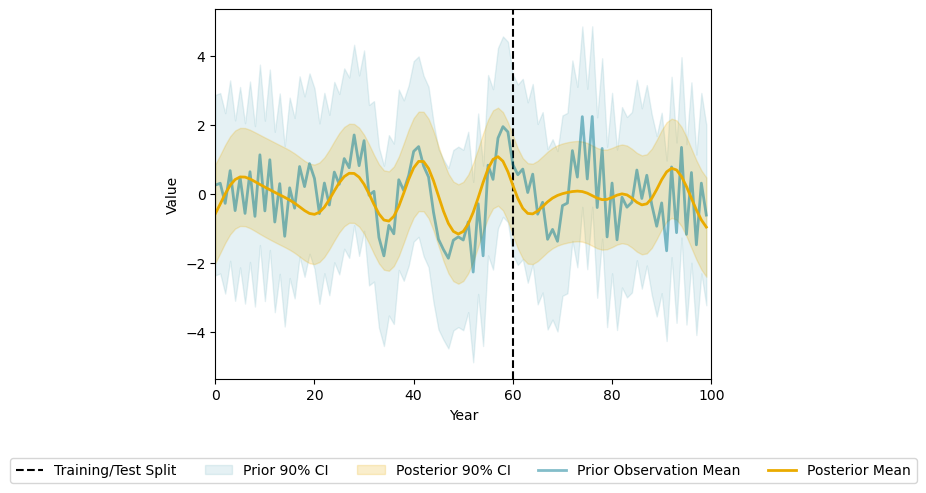

In [17]:
def pe2(best_params):
    kernel = (
        C(best_params['c2']) * ExpSineSquared(length_scale=best_params['ls1'], periodicity=best_params['per1']) +
        C(best_params['c3']) * ExpSineSquared(length_scale=best_params['ls2'], periodicity=best_params['per2']) +
        WhiteKernel(noise_level=best_params['noise'])
    )
    return kernel

pbounds = {
    'c2': (1e-1, 2),
    'c3': (1e-1, 2),
    'ls1': (1e-2, 1e1),
    'per1': (10, 30),
    'ls2': (1e-2, 1e1),
    'per2': (10, 30),
    'noise': (1e-6, 1),
}

# gpr_model(mod_ids, 20, rainfall_yearly, pbounds, pe2, oos_gcm)
# gpr_model(mod_ids, 40, rainfall_yearly, pbounds, pe2, oos_gcm)
gpr_model(mod_ids, 60, rainfall_yearly, pbounds, pe2, oos_gcm, '../poster/plot/result/mid.svg')
# gpr_model(mod_ids, 80, rainfall_yearly, pbounds, pe2, oos_gcm)

# kernel

Test different kernels. Note that '_' means the sum of kernel, and kernel1kernel2 means kernel1*kernel2. Number means how many kernels we use of the same structure.

With other kernels to be implementation. Such as some kernels to make an addition or product.

## sum of periods

### 2 periods

Optimization Progress:   0%|          | 0/200 [00:00<?, ?it/s]

|   iter    |  target   |    c1     |    c2     |    c3     | dp_sig... |    ls1    |    ls2    |   noise   |   per1    |   per2    |
-------------------------------------------------------------------------------------------------------------------------------------
|  1        | -535.3    |  0.1612   |  0.3996   |  1.972    |  9.045    |  1.869    |  2.684    |  0.3341   |  22.89    |  15.03    |
|  2        | -547.0    |  0.3541   |  1.202    |  1.276    |  3.678    |  2.589    |  1.952    |  0.5525   |  26.51    |  20.07    |
|  3        | -581.0    |  0.375    |  1.543    |  1.32     |  3.851    |  0.8102   |  8.077    |  0.8115   |  11.02    |  21.89    |
|  4        | -621.5    |  0.4873   |  1.974    |  1.658    |  6.899    |  6.236    |  5.996    |  0.6816   |  26.77    |  19.2     |
|  5        | -598.2    |  0.3191   |  1.917    |  0.6396   |  4.844    |  8.133    |  6.072    |  0.6352   |  18.33    |  25.62    |
|  6        | -619.0    |  0.2217   |  1.543    |  0.8598   | 

Optimization Progress:   0%|          | 0/200 [00:06<?, ?it/s]

An error occurred during optimization: 'x0' must only have one dimension.
Best parameters found during the optimization process:  {'c1': 0.31254919701164463, 'c2': 0.7339216671980757, 'c3': 1.1542813402970926, 'dp_sigma_0': 1.1361638223994437, 'ls1': 1.6384809904855957, 'ls2': 1.306951422959589, 'noise': 0.29724639149666837, 'per1': 25.978821140880434, 'per2': 20.466514000883517}
Total log marginal likelihood for best parameters found during the optimization process:  -461.23030308516525


total_lml_train: -461.23030308516525
total_lml_test: -2265.314201686196
total_lml_full: -2966.564436431149
best kernel is: 0.559**2 * DotProduct(sigma_0=1.14) ** 2 + 0.857**2 * ExpSineSquared(length_scale=1.64, periodicity=26) + 1.07**2 * ExpSineSquared(length_scale=1.31, periodicity=20.5) + WhiteKernel(noise_level=0.297)
observation_lml_train: -31.957263086465247
observation_lml_test: -189.85183736828125
observation_lml_full: -212.1678624074934


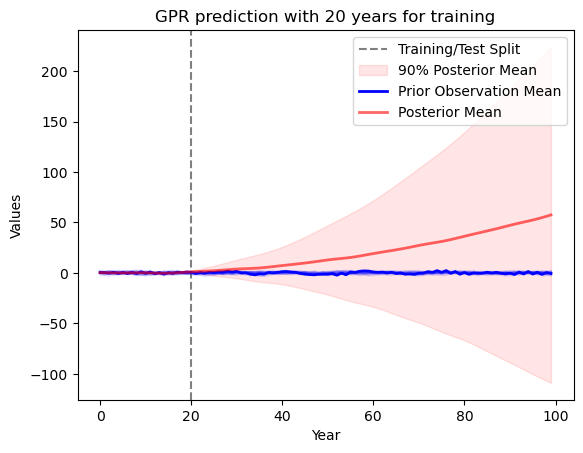

Optimization Progress:   0%|          | 0/200 [00:00<?, ?it/s]

|   iter    |  target   |    c1     |    c2     |    c3     | dp_sig... |    ls1    |    ls2    |   noise   |   per1    |   per2    |
-------------------------------------------------------------------------------------------------------------------------------------
|  1        | -958.8    |  0.1612   |  0.3996   |  1.972    |  9.045    |  1.869    |  2.684    |  0.3341   |  22.89    |  15.03    |
|  2        | -1.044e+0 |  0.3541   |  1.202    |  1.276    |  3.678    |  2.589    |  1.952    |  0.5525   |  26.51    |  20.07    |
|  3        | -1.163e+0 |  0.375    |  1.543    |  1.32     |  3.851    |  0.8102   |  8.077    |  0.8115   |  11.02    |  21.89    |
|  4        | -1.123e+0 |  0.4873   |  1.974    |  1.658    |  6.899    |  6.236    |  5.996    |  0.6816   |  26.77    |  19.2     |
|  5        | -1.111e+0 |  0.3191   |  1.917    |  0.6396   |  4.844    |  8.133    |  6.072    |  0.6352   |  18.33    |  25.62    |
|  6        | -1.135e+0 |  0.2217   |  1.543    |  0.8598   | 

Optimization Progress:   0%|          | 0/200 [00:06<?, ?it/s]

|  100      | -1.602e+0 |  0.1737   |  0.1132   |  0.1596   |  3.488    |  6.512    |  2.878    |  0.1738   |  14.66    |  19.52    |
An error occurred during optimization: 'x0' must only have one dimension.
Best parameters found during the optimization process:  {'c1': 0.3279624920157345, 'c2': 1.4137759556387235, 'c3': 1.3971759543117677, 'dp_sigma_0': 3.7554701038189053, 'ls1': 3.9490186686975965, 'ls2': 0.6080409153923771, 'noise': 0.26177480186279994, 'per1': 16.967513075030467, 'per2': 27.595300688691864}
Total log marginal likelihood for best parameters found during the optimization process:  -903.272008356525


total_lml_train: -903.272008356525
total_lml_test: -1412.2698975300225
total_lml_full: -2794.9020194814493
best kernel is: 0.573**2 * DotProduct(sigma_0=3.76) ** 2 + 1.19**2 * ExpSineSquared(length_scale=3.95, periodicity=17) + 1.18**2 * ExpSineSquared(length_scale=0.608, periodicity=27.6) + WhiteKernel(noise_level=0.262)
observation_lml_train: -62.69076130463559
observation_lml_test: -126.08363257897119
observation_lml_full: -184.03755533063185


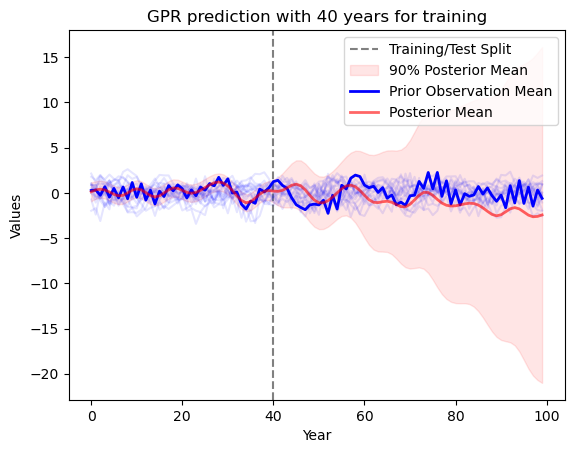

Optimization Progress:   0%|          | 0/200 [00:00<?, ?it/s]

|   iter    |  target   |    c1     |    c2     |    c3     | dp_sig... |    ls1    |    ls2    |   noise   |   per1    |   per2    |
-------------------------------------------------------------------------------------------------------------------------------------
|  1        | -1.552e+0 |  0.1612   |  0.3996   |  1.972    |  9.045    |  1.869    |  2.684    |  0.3341   |  22.89    |  15.03    |
|  2        | -1.577e+0 |  0.3541   |  1.202    |  1.276    |  3.678    |  2.589    |  1.952    |  0.5525   |  26.51    |  20.07    |
|  3        | -1.664e+0 |  0.375    |  1.543    |  1.32     |  3.851    |  0.8102   |  8.077    |  0.8115   |  11.02    |  21.89    |
|  4        | -1.638e+0 |  0.4873   |  1.974    |  1.658    |  6.899    |  6.236    |  5.996    |  0.6816   |  26.77    |  19.2     |
|  5        | -1.629e+0 |  0.3191   |  1.917    |  0.6396   |  4.844    |  8.133    |  6.072    |  0.6352   |  18.33    |  25.62    |
|  6        | -1.68e+03 |  0.2217   |  1.543    |  0.8598   | 

Optimization Progress:   0%|          | 0/200 [00:07<?, ?it/s]

|  100      | -2.466e+0 |  0.1737   |  0.1132   |  0.1596   |  3.488    |  6.512    |  2.878    |  0.1738   |  14.66    |  19.52    |
An error occurred during optimization: 'x0' must only have one dimension.
Best parameters found during the optimization process:  {'c1': 0.3765191337881476, 'c2': 0.5495317852458314, 'c3': 0.9709720906285789, 'dp_sigma_0': 1.0842799927261235, 'ls1': 2.1993116276165146, 'ls2': 4.192452383243492, 'noise': 0.46884505302805596, 'per1': 18.377436543470434, 'per2': 13.806333942449134}
Total log marginal likelihood for best parameters found during the optimization process:  -1404.7619517174924


total_lml_train: -1404.7619517174924
total_lml_test: -976.1481762939425
total_lml_full: -2398.2174900675213
best kernel is: 0.614**2 * DotProduct(sigma_0=1.08) ** 2 + 0.741**2 * ExpSineSquared(length_scale=2.2, periodicity=18.4) + 0.985**2 * ExpSineSquared(length_scale=4.19, periodicity=13.8) + WhiteKernel(noise_level=0.469)
observation_lml_train: -95.50346701492057
observation_lml_test: -68.89476208287743
observation_lml_full: -159.86602535502968


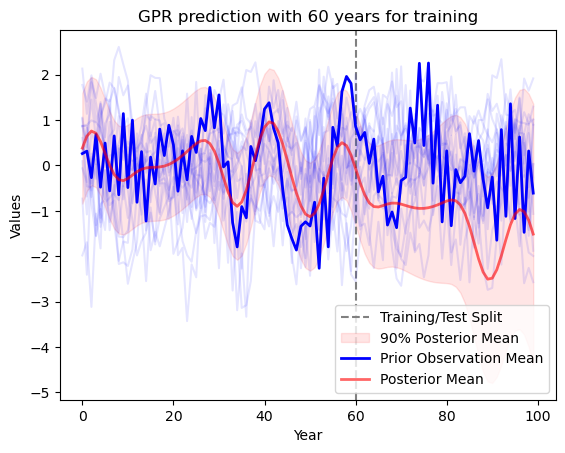

Optimization Progress:   0%|          | 0/200 [00:00<?, ?it/s]

|   iter    |  target   |    c1     |    c2     |    c3     | dp_sig... |    ls1    |    ls2    |   noise   |   per1    |   per2    |
-------------------------------------------------------------------------------------------------------------------------------------
|  1        | -2.101e+0 |  0.1612   |  0.3996   |  1.972    |  9.045    |  1.869    |  2.684    |  0.3341   |  22.89    |  15.03    |
|  2        | -2.083e+0 |  0.3541   |  1.202    |  1.276    |  3.678    |  2.589    |  1.952    |  0.5525   |  26.51    |  20.07    |
|  3        | -2.151e+0 |  0.375    |  1.543    |  1.32     |  3.851    |  0.8102   |  8.077    |  0.8115   |  11.02    |  21.89    |
|  4        | -2.131e+0 |  0.4873   |  1.974    |  1.658    |  6.899    |  6.236    |  5.996    |  0.6816   |  26.77    |  19.2     |
|  5        | -2.121e+0 |  0.3191   |  1.917    |  0.6396   |  4.844    |  8.133    |  6.072    |  0.6352   |  18.33    |  25.62    |
|  6        | -2.188e+0 |  0.2217   |  1.543    |  0.8598   | 

Optimization Progress:   0%|          | 0/200 [00:11<?, ?it/s]

An error occurred during optimization: 'x0' must only have one dimension.
Best parameters found during the optimization process:  {'c1': 0.3765191337881476, 'c2': 0.5495317852458314, 'c3': 0.9709720906285789, 'dp_sigma_0': 1.0842799927261235, 'ls1': 2.1993116276165146, 'ls2': 4.192452383243492, 'noise': 0.46884505302805596, 'per1': 18.377436543470434, 'per2': 13.806333942449134}
Total log marginal likelihood for best parameters found during the optimization process:  -1883.3664466647629


total_lml_train: -1883.3664466647629
total_lml_test: -566.5615520876934
total_lml_full: -2398.2174900675213
best kernel is: 0.614**2 * DotProduct(sigma_0=1.08) ** 2 + 0.741**2 * ExpSineSquared(length_scale=2.2, periodicity=18.4) + 0.985**2 * ExpSineSquared(length_scale=4.19, periodicity=13.8) + WhiteKernel(noise_level=0.469)
observation_lml_train: -129.0265622602525
observation_lml_test: -40.21911333518295
observation_lml_full: -159.86602535502968


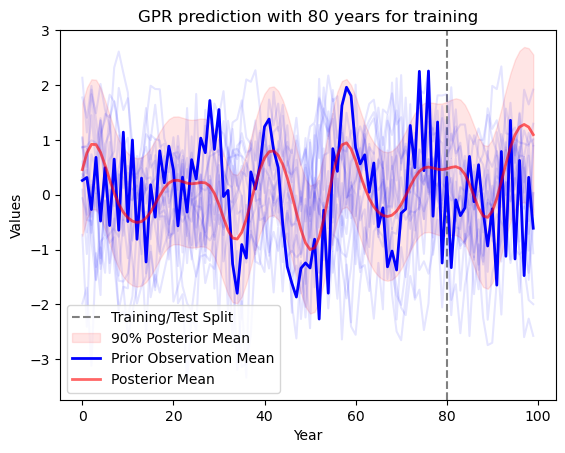

In [115]:
def pe2_poly(best_params):
    kernel = (
        C(best_params['c1']) * (DotProduct(sigma_0=best_params['dp_sigma_0']) ** 2) +
        C(best_params['c2']) * ExpSineSquared(length_scale=best_params['ls1'], periodicity=best_params['per1']) +
        C(best_params['c3']) * ExpSineSquared(length_scale=best_params['ls2'], periodicity=best_params['per2']) +
        WhiteKernel(noise_level=best_params['noise'])
    )
    return kernel

pbounds = {
    'c1': (1e-1, 0.5),
    'c2': (1e-1, 2),
    'c3': (1e-1, 2),
    'ls1': (1e-2, 1e1),
    'per1': (10, 30),
    'ls2': (1e-2, 1e1),
    'per2': (10, 30),
    'noise': (1e-6, 1),
    'dp_sigma_0': (1e-3, 1e1),
}

gpr_model(mod_ids, 20, rainfall_yearly, pbounds, pe2_poly, oos_gcm)
gpr_model(mod_ids, 40, rainfall_yearly, pbounds, pe2_poly, oos_gcm)
gpr_model(mod_ids, 60, rainfall_yearly, pbounds, pe2_poly, oos_gcm)
gpr_model(mod_ids, 80, rainfall_yearly, pbounds, pe2_poly, oos_gcm)

Optimization Progress:   0%|          | 0/200 [00:00<?, ?it/s]

|   iter    |  target   |    c1     |    c2     |    c3     | dp_sig... |    ls1    |    ls2    |   noise   |   per1    |   per2    |
-------------------------------------------------------------------------------------------------------------------------------------
|  1        | -535.3    |  0.1612   |  0.3996   |  1.972    |  9.045    |  1.869    |  2.684    |  0.3341   |  22.89    |  15.03    |
|  2        | -547.0    |  0.3541   |  1.202    |  1.276    |  3.678    |  2.589    |  1.952    |  0.5525   |  26.51    |  20.07    |
|  3        | -581.0    |  0.375    |  1.543    |  1.32     |  3.851    |  0.8102   |  8.077    |  0.8115   |  11.02    |  21.89    |
|  4        | -621.5    |  0.4873   |  1.974    |  1.658    |  6.899    |  6.236    |  5.996    |  0.6816   |  26.77    |  19.2     |
|  5        | -598.2    |  0.3191   |  1.917    |  0.6396   |  4.844    |  8.133    |  6.072    |  0.6352   |  18.33    |  25.62    |
|  6        | -619.0    |  0.2217   |  1.543    |  0.8598   | 

Optimization Progress:   0%|          | 0/200 [00:06<?, ?it/s]

An error occurred during optimization: 'x0' must only have one dimension.
Best parameters found during the optimization process:  {'c1': 0.31254919701164463, 'c2': 0.7339216671980757, 'c3': 1.1542813402970926, 'dp_sigma_0': 1.1361638223994437, 'ls1': 1.6384809904855957, 'ls2': 1.306951422959589, 'noise': 0.29724639149666837, 'per1': 25.978821140880434, 'per2': 20.466514000883517}
Total log marginal likelihood for best parameters found during the optimization process:  -461.23030308516525


total_lml_train: -461.23030308516525
total_lml_test: -2265.314201686196
total_lml_full: -2966.564436431149
best kernel is: 0.559**2 * DotProduct(sigma_0=1.14) ** 2 + 0.857**2 * ExpSineSquared(length_scale=1.64, periodicity=26) + 1.07**2 * ExpSineSquared(length_scale=1.31, periodicity=20.5) + WhiteKernel(noise_level=0.297)
observation_lml_train: -31.957263086465247
observation_lml_test: -189.85183736828125
observation_lml_full: -212.1678624074934


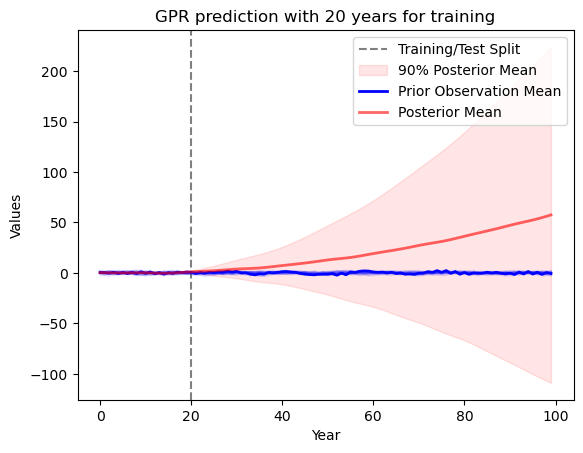

In [117]:
gpr_model(mod_ids, 20, rainfall_yearly, pbounds, pe2_poly, oos_gcm)

In [119]:
kernel = tune_GPR(mod_ids, 20, rainfall_yearly, pbounds, pe2_poly)

Optimization Progress:   0%|          | 0/200 [00:00<?, ?it/s]

|   iter    |  target   |    c1     |    c2     |    c3     | dp_sig... |    ls1    |    ls2    |   noise   |   per1    |   per2    |
-------------------------------------------------------------------------------------------------------------------------------------
|  1        | -535.3    |  0.1612   |  0.3996   |  1.972    |  9.045    |  1.869    |  2.684    |  0.3341   |  22.89    |  15.03    |
|  2        | -547.0    |  0.3541   |  1.202    |  1.276    |  3.678    |  2.589    |  1.952    |  0.5525   |  26.51    |  20.07    |
|  3        | -581.0    |  0.375    |  1.543    |  1.32     |  3.851    |  0.8102   |  8.077    |  0.8115   |  11.02    |  21.89    |
|  4        | -621.5    |  0.4873   |  1.974    |  1.658    |  6.899    |  6.236    |  5.996    |  0.6816   |  26.77    |  19.2     |
|  5        | -598.2    |  0.3191   |  1.917    |  0.6396   |  4.844    |  8.133    |  6.072    |  0.6352   |  18.33    |  25.62    |
|  6        | -619.0    |  0.2217   |  1.543    |  0.8598   | 

Optimization Progress:   0%|          | 0/200 [00:06<?, ?it/s]

|  100      | -757.3    |  0.1737   |  0.1132   |  0.1596   |  3.488    |  6.512    |  2.878    |  0.1738   |  14.66    |  19.52    |
An error occurred during optimization: 'x0' must only have one dimension.
Best parameters found during the optimization process:  {'c1': 0.31254919701164463, 'c2': 0.7339216671980757, 'c3': 1.1542813402970926, 'dp_sigma_0': 1.1361638223994437, 'ls1': 1.6384809904855957, 'ls2': 1.306951422959589, 'noise': 0.29724639149666837, 'per1': 25.978821140880434, 'per2': 20.466514000883517}
Total log marginal likelihood for best parameters found during the optimization process:  -461.23030308516525


total_lml_train: -2261.019967373276
total_lml_test: -538.636965046144
total_lml_full: -2966.564436431149
best kernel is: 0.559**2 * DotProduct(sigma_0=1.14) ** 2 + 0.857**2 * ExpSineSquared(length_scale=1.64, periodicity=26) + 1.07**2 * ExpSineSquared(length_scale=1.31, periodicity=20.5) + WhiteKernel(noise_level=0.297)
observation_lml_train: -168.84650375629008
observation_lml_test: -45.00175560130588
observation_lml_full: -212.1678624074934


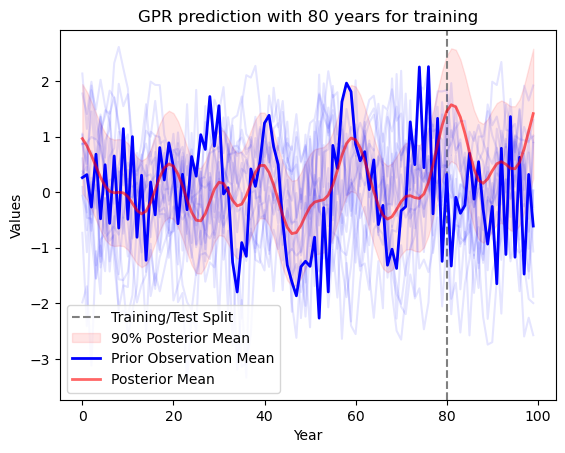

In [120]:
plot_gpr_results(mod_ids, 80, rainfall_yearly, kernel, oos_gcm)

Optimization Progress:   0%|          | 0/200 [00:00<?, ?it/s]

|   iter    |  target   |    c2     |    c3     |    ls1    |    ls2    |   noise   |   per1    |   per2    |
-------------------------------------------------------------------------------------------------------------
|  1        | -755.6    |  0.3908   |  0.3996   |  9.855    |  9.046    |  0.1861   |  15.35    |  16.68    |
|  2        | -447.9    |  1.325    |  0.5777   |  6.356    |  5.802    |  0.6188   |  17.36    |  15.16    |
|  3        | -465.8    |  0.4693   |  1.15     |  8.258    |  5.039    |  0.6876   |  25.19    |  22.85    |
|  4        | -1.95e+03 |  0.8315   |  0.2522   |  8.077    |  8.117    |  0.05083  |  21.89    |  29.37    |
|  5        | -471.4    |  1.974    |  1.658    |  6.902    |  6.236    |  0.5992   |  23.63    |  26.77    |
|  6        | -447.7    |  0.974    |  1.141    |  9.565    |  2.847    |  0.4844   |  26.26    |  22.14    |
|  7        | -451.3    |  1.307    |  0.8918   |  7.815    |  3.049    |  0.7597   |  18.0     |  25.07    |
|  8      

Optimization Progress:   0%|          | 0/200 [00:02<?, ?it/s]

|  97       | -446.8    |  1.819    |  1.781    |  8.466    |  5.246    |  0.6369   |  21.5     |  18.5     |
|  98       | -510.0    |  0.6228   |  1.404    |  6.374    |  9.996    |  0.308    |  16.17    |  13.81    |
|  99       | -415.3    |  1.723    |  0.6796   |  1.377    |  9.616    |  0.6422   |  28.17    |  19.38    |
|  100      | -595.2    |  1.388    |  0.1743   |  4.904    |  6.185    |  0.237    |  28.76    |  14.21    |
An error occurred during optimization: 'x0' must only have one dimension.
Best parameters found during the optimization process:  {'c2': 1.1540871173333993, 'c3': 0.5730696743919911, 'ls1': 1.146479989760988, 'ls2': 0.7620949227652593, 'noise': 0.26338727588783784, 'per1': 15.506640886283176, 'per2': 29.1657676440799}
Total log marginal likelihood for best parameters found during the optimization process:  -346.8837484276528


total_lml_train: -346.8837484276528
total_lml_test: -1879.494485446142
total_lml_full: -2429.5434428261524
best kernel is: 1.07**2 * ExpSineSquared(length_scale=1.15, periodicity=15.5) + 0.757**2 * ExpSineSquared(length_scale=0.762, periodicity=29.2) + WhiteKernel(noise_level=0.263)
observation_lml_train: -27.32682793579106
observation_lml_test: -152.66765344589498
observation_lml_full: -189.34997544809988


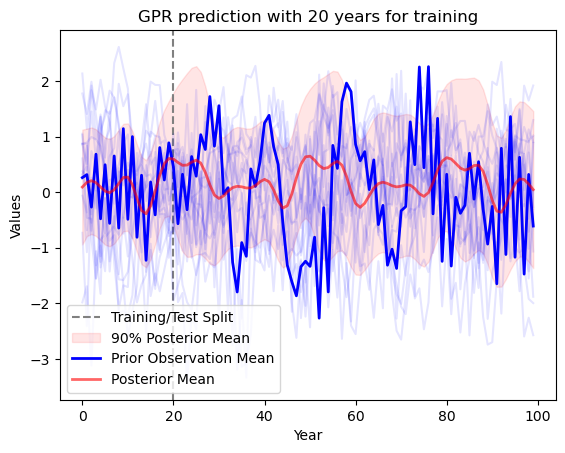

Optimization Progress:   0%|          | 0/200 [00:00<?, ?it/s]

|   iter    |  target   |    c2     |    c3     |    ls1    |    ls2    |   noise   |   per1    |   per2    |
-------------------------------------------------------------------------------------------------------------
|  1        | -1.534e+0 |  0.3908   |  0.3996   |  9.855    |  9.046    |  0.1861   |  15.35    |  16.68    |
|  2        | -897.2    |  1.325    |  0.5777   |  6.356    |  5.802    |  0.6188   |  17.36    |  15.16    |
|  3        | -936.8    |  0.4693   |  1.15     |  8.258    |  5.039    |  0.6876   |  25.19    |  22.85    |
|  4        | -4.798e+0 |  0.8315   |  0.2522   |  8.077    |  8.117    |  0.05083  |  21.89    |  29.37    |
|  5        | -954.0    |  1.974    |  1.658    |  6.902    |  6.236    |  0.5992   |  23.63    |  26.77    |
|  6        | -978.7    |  0.974    |  1.141    |  9.565    |  2.847    |  0.4844   |  26.26    |  22.14    |
|  7        | -899.1    |  1.307    |  0.8918   |  7.815    |  3.049    |  0.7597   |  18.0     |  25.07    |
|  8      

Optimization Progress:   0%|          | 0/200 [00:03<?, ?it/s]

An error occurred during optimization: 'x0' must only have one dimension.
Best parameters found during the optimization process:  {'c2': 1.587401619150392, 'c3': 1.6292577289606536, 'ls1': 5.608531784347997, 'ls2': 1.1255916772342913, 'noise': 0.2962031063208207, 'per1': 15.422108429293456, 'per2': 25.872093818910905}
Total log marginal likelihood for best parameters found during the optimization process:  -747.4023591928029


total_lml_train: -747.4023591928029
total_lml_test: -1215.851047287791
total_lml_full: -2384.883311975339
best kernel is: 1.26**2 * ExpSineSquared(length_scale=5.61, periodicity=15.4) + 1.28**2 * ExpSineSquared(length_scale=1.13, periodicity=25.9) + WhiteKernel(noise_level=0.296)
observation_lml_train: -49.636621044890155
observation_lml_test: -122.2236551137097
observation_lml_full: -180.70143508848628


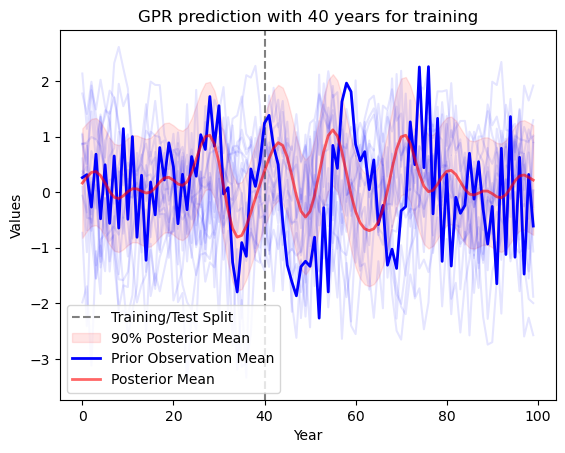

Optimization Progress:   0%|          | 0/200 [00:00<?, ?it/s]

|   iter    |  target   |    c2     |    c3     |    ls1    |    ls2    |   noise   |   per1    |   per2    |
-------------------------------------------------------------------------------------------------------------
|  1        | -2.355e+0 |  0.3908   |  0.3996   |  9.855    |  9.046    |  0.1861   |  15.35    |  16.68    |
|  2        | -1.343e+0 |  1.325    |  0.5777   |  6.356    |  5.802    |  0.6188   |  17.36    |  15.16    |
|  3        | -1.419e+0 |  0.4693   |  1.15     |  8.258    |  5.039    |  0.6876   |  25.19    |  22.85    |
|  4        | -7.652e+0 |  0.8315   |  0.2522   |  8.077    |  8.117    |  0.05083  |  21.89    |  29.37    |
|  5        | -1.445e+0 |  1.974    |  1.658    |  6.902    |  6.236    |  0.5992   |  23.63    |  26.77    |
|  6        | -1.495e+0 |  0.974    |  1.141    |  9.565    |  2.847    |  0.4844   |  26.26    |  22.14    |
|  7        | -1.378e+0 |  1.307    |  0.8918   |  7.815    |  3.049    |  0.7597   |  18.0     |  25.07    |
|  8      

Optimization Progress:   0%|          | 0/200 [00:03<?, ?it/s]

|  98       | -1.489e+0 |  0.6228   |  1.404    |  6.374    |  9.996    |  0.308    |  16.17    |  13.81    |
|  99       | -1.244e+0 |  1.723    |  0.6796   |  1.377    |  9.616    |  0.6422   |  28.17    |  19.38    |
|  100      | -1.878e+0 |  1.388    |  0.1743   |  4.904    |  6.185    |  0.237    |  28.76    |  14.21    |
An error occurred during optimization: 'x0' must only have one dimension.
Best parameters found during the optimization process:  {'c2': 1.2043271729280505, 'c3': 1.3504867302229664, 'ls1': 1.1586604522550457, 'ls2': 3.076991904563972, 'noise': 0.47921939607525155, 'per1': 26.288152735969675, 'per2': 16.484440866436202}
Total log marginal likelihood for best parameters found during the optimization process:  -1200.0334634853482


total_lml_train: -1200.0334634853482
total_lml_test: -742.6672326338118
total_lml_full: -2266.9258718459614
best kernel is: 1.1**2 * ExpSineSquared(length_scale=1.16, periodicity=26.3) + 1.16**2 * ExpSineSquared(length_scale=3.08, periodicity=16.5) + WhiteKernel(noise_level=0.479)
observation_lml_train: -84.87516265436292
observation_lml_test: -58.747347433085864
observation_lml_full: -146.4179518634565


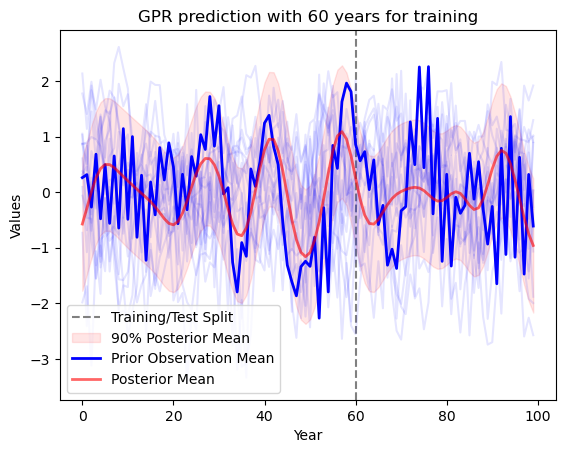

Optimization Progress:   0%|          | 0/200 [00:00<?, ?it/s]

|   iter    |  target   |    c2     |    c3     |    ls1    |    ls2    |   noise   |   per1    |   per2    |
-------------------------------------------------------------------------------------------------------------
|  1        | -3.145e+0 |  0.3908   |  0.3996   |  9.855    |  9.046    |  0.1861   |  15.35    |  16.68    |
|  2        | -1.778e+0 |  1.325    |  0.5777   |  6.356    |  5.802    |  0.6188   |  17.36    |  15.16    |
|  3        | -1.882e+0 |  0.4693   |  1.15     |  8.258    |  5.039    |  0.6876   |  25.19    |  22.85    |
|  4        | -1.079e+0 |  0.8315   |  0.2522   |  8.077    |  8.117    |  0.05083  |  21.89    |  29.37    |
|  5        | -1.921e+0 |  1.974    |  1.658    |  6.902    |  6.236    |  0.5992   |  23.63    |  26.77    |
|  6        | -1.997e+0 |  0.974    |  1.141    |  9.565    |  2.847    |  0.4844   |  26.26    |  22.14    |
|  7        | -1.832e+0 |  1.307    |  0.8918   |  7.815    |  3.049    |  0.7597   |  18.0     |  25.07    |
|  8      

Optimization Progress:   0%|          | 0/200 [00:05<?, ?it/s]

Total log marginal likelihood for best parameters found during the optimization process:  -1676.414970751814


total_lml_train: -1676.414970751814
total_lml_test: -401.0986942700158
total_lml_full: -2098.1168041256547
best kernel is: 1.28**2 * ExpSineSquared(length_scale=4.99, periodicity=20.9) + 0.801**2 * ExpSineSquared(length_scale=1.41, periodicity=14.7) + WhiteKernel(noise_level=0.671)
observation_lml_train: -114.60972159962205
observation_lml_test: -28.11642125198793
observation_lml_full: -141.55705690423125


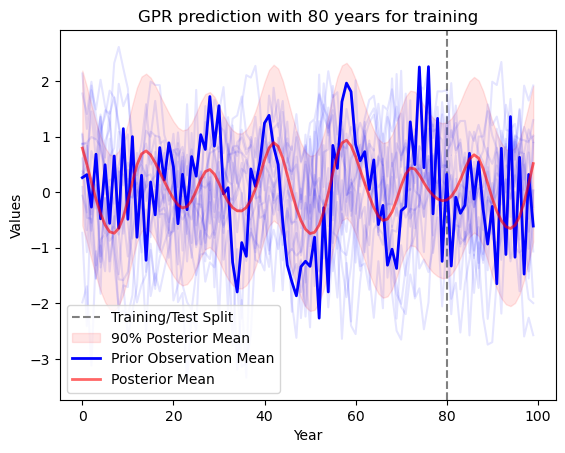

In [ ]:
def pe2(best_params):
    kernel = (
        C(best_params['c2']) * ExpSineSquared(length_scale=best_params['ls1'], periodicity=best_params['per1']) +
        C(best_params['c3']) * ExpSineSquared(length_scale=best_params['ls2'], periodicity=best_params['per2']) +
        WhiteKernel(noise_level=best_params['noise'])
    )
    return kernel

pbounds = {
    'c2': (1e-1, 2),
    'c3': (1e-1, 2),
    'ls1': (1e-2, 1e1),
    'per1': (10, 30),
    'ls2': (1e-2, 1e1),
    'per2': (10, 30),
    'noise': (1e-6, 1),
}

gpr_model(mod_ids, 20, rainfall_yearly, pbounds, pe2, oos_gcm)
gpr_model(mod_ids, 40, rainfall_yearly, pbounds, pe2, oos_gcm)
gpr_model(mod_ids, 60, rainfall_yearly, pbounds, pe2, oos_gcm)
gpr_model(mod_ids, 80, rainfall_yearly, pbounds, pe2, oos_gcm)

Optimization Progress:   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   |    c2     |    c3     |    ls1    |    ls2    |   noise   |   per1    |   per2    |
-------------------------------------------------------------------------------------------------------------
| 1         | -755.6    | 0.3908    | 0.3996    | 9.855     | 9.046     | 0.1861    | 15.35     | 16.68     |
| 2         | -447.9    | 1.325     | 0.5777    | 6.356     | 5.802     | 0.6188    | 17.36     | 15.16     |
| 3         | -465.8    | 0.4693    | 1.15      | 8.258     | 5.039     | 0.6876    | 25.19     | 22.85     |
| 4         | -1.95e+03 | 0.8315    | 0.2522    | 8.077     | 8.117     | 0.05083   | 21.89     | 29.37     |
| 5         | -471.4    | 1.974     | 1.658     | 6.902     | 6.236     | 0.5992    | 23.63     | 26.77     |
| 6         | -447.7    | 0.974     | 1.141     | 9.565     | 2.847     | 0.4844    | 26.26     | 22.14     |
| 7         | -451.3    | 1.307     | 0.8918    | 7.815     | 3.049     | 0.7597    | 18.0      | 25.07     |
| 8       

Optimization Progress: 100%|██████████| 100/100 [00:02<00:00, 36.18it/s]

| 96        | -511.8    | 1.326     | 1.401     | 1.385     | 2.963     | 0.05956   | 23.93     | 14.61     |
| 97        | -446.8    | 1.819     | 1.781     | 8.466     | 5.246     | 0.6369    | 21.5      | 18.5      |
| 98        | -510.0    | 0.6228    | 1.404     | 6.374     | 9.996     | 0.308     | 16.17     | 13.81     |
| 99        | -415.3    | 1.723     | 0.6796    | 1.377     | 9.616     | 0.6422    | 28.17     | 19.38     |
| 100       | -595.2    | 1.388     | 0.1743    | 4.904     | 6.185     | 0.237     | 28.76     | 14.21     |


total_lml_train: -346.8837484276528
total_lml_test: -1879.494485446142
total_lml_full: -2429.5434428261524
best kernel is: 1.07**2 * ExpSineSquared(length_scale=1.15, periodicity=15.5) + 0.757**2 * ExpSineSquared(length_scale=0.762, periodicity=29.2) + WhiteKernel(noise_level=0.263)
observation_lml_train: -27.32682793579106
observation_lml_test: -152.66765344589498
observation_lml_full: -189.34997544809988


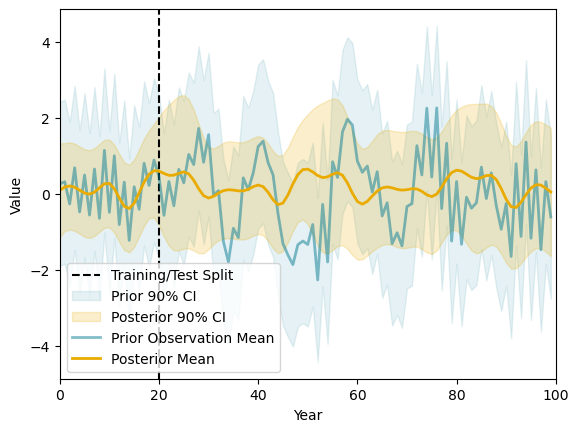

Optimization Progress:   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   |    c2     |    c3     |    ls1    |    ls2    |   noise   |   per1    |   per2    |
-------------------------------------------------------------------------------------------------------------
| 1         | -1.534e+0 | 0.3908    | 0.3996    | 9.855     | 9.046     | 0.1861    | 15.35     | 16.68     |
| 2         | -897.2    | 1.325     | 0.5777    | 6.356     | 5.802     | 0.6188    | 17.36     | 15.16     |
| 3         | -936.8    | 0.4693    | 1.15      | 8.258     | 5.039     | 0.6876    | 25.19     | 22.85     |
| 4         | -4.798e+0 | 0.8315    | 0.2522    | 8.077     | 8.117     | 0.05083   | 21.89     | 29.37     |
| 5         | -954.0    | 1.974     | 1.658     | 6.902     | 6.236     | 0.5992    | 23.63     | 26.77     |
| 6         | -978.7    | 0.974     | 1.141     | 9.565     | 2.847     | 0.4844    | 26.26     | 22.14     |
| 7         | -899.1    | 1.307     | 0.8918    | 7.815     | 3.049     | 0.7597    | 18.0      | 25.07     |
| 8       

Optimization Progress: 100%|██████████| 100/100 [00:02<00:00, 34.90it/s]

| 98        | -1.001e+0 | 0.6228    | 1.404     | 6.374     | 9.996     | 0.308     | 16.17     | 13.81     |
| 99        | -824.3    | 1.723     | 0.6796    | 1.377     | 9.616     | 0.6422    | 28.17     | 19.38     |
| 100       | -1.237e+0 | 1.388     | 0.1743    | 4.904     | 6.185     | 0.237     | 28.76     | 14.21     |


total_lml_train: -747.4023591928029
total_lml_test: -1215.851047287791
total_lml_full: -2384.883311975339
best kernel is: 1.26**2 * ExpSineSquared(length_scale=5.61, periodicity=15.4) + 1.28**2 * ExpSineSquared(length_scale=1.13, periodicity=25.9) + WhiteKernel(noise_level=0.296)
observation_lml_train: -49.636621044890155
observation_lml_test: -122.2236551137097
observation_lml_full: -180.70143508848628


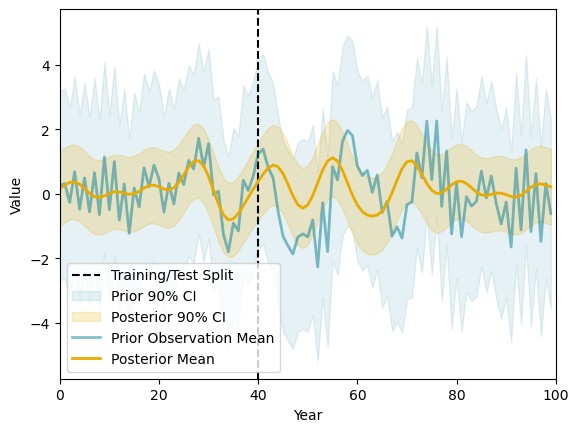

Optimization Progress:   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   |    c2     |    c3     |    ls1    |    ls2    |   noise   |   per1    |   per2    |
-------------------------------------------------------------------------------------------------------------
| 1         | -2.355e+0 | 0.3908    | 0.3996    | 9.855     | 9.046     | 0.1861    | 15.35     | 16.68     |
| 2         | -1.343e+0 | 1.325     | 0.5777    | 6.356     | 5.802     | 0.6188    | 17.36     | 15.16     |
| 3         | -1.419e+0 | 0.4693    | 1.15      | 8.258     | 5.039     | 0.6876    | 25.19     | 22.85     |
| 4         | -7.652e+0 | 0.8315    | 0.2522    | 8.077     | 8.117     | 0.05083   | 21.89     | 29.37     |
| 5         | -1.445e+0 | 1.974     | 1.658     | 6.902     | 6.236     | 0.5992    | 23.63     | 26.77     |
| 6         | -1.495e+0 | 0.974     | 1.141     | 9.565     | 2.847     | 0.4844    | 26.26     | 22.14     |
| 7         | -1.378e+0 | 1.307     | 0.8918    | 7.815     | 3.049     | 0.7597    | 18.0      | 25.07     |
| 8       

Optimization Progress: 100%|██████████| 100/100 [00:03<00:00, 29.59it/s]

| 100       | -1.878e+0 | 1.388     | 0.1743    | 4.904     | 6.185     | 0.237     | 28.76     | 14.21     |


total_lml_train: -1200.0334634853482
total_lml_test: -742.6672326338118
total_lml_full: -2266.9258718459614
best kernel is: 1.1**2 * ExpSineSquared(length_scale=1.16, periodicity=26.3) + 1.16**2 * ExpSineSquared(length_scale=3.08, periodicity=16.5) + WhiteKernel(noise_level=0.479)
observation_lml_train: -84.87516265436292
observation_lml_test: -58.747347433085864
observation_lml_full: -146.4179518634565


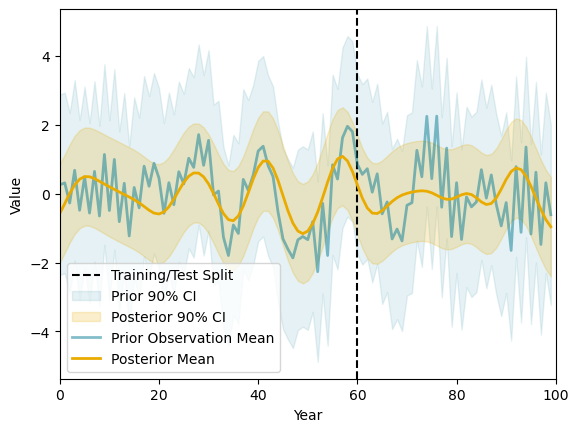

Optimization Progress:   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   |    c2     |    c3     |    ls1    |    ls2    |   noise   |   per1    |   per2    |
-------------------------------------------------------------------------------------------------------------
| 1         | -3.145e+0 | 0.3908    | 0.3996    | 9.855     | 9.046     | 0.1861    | 15.35     | 16.68     |
| 2         | -1.778e+0 | 1.325     | 0.5777    | 6.356     | 5.802     | 0.6188    | 17.36     | 15.16     |
| 3         | -1.882e+0 | 0.4693    | 1.15      | 8.258     | 5.039     | 0.6876    | 25.19     | 22.85     |
| 4         | -1.079e+0 | 0.8315    | 0.2522    | 8.077     | 8.117     | 0.05083   | 21.89     | 29.37     |
| 5         | -1.921e+0 | 1.974     | 1.658     | 6.902     | 6.236     | 0.5992    | 23.63     | 26.77     |
| 6         | -1.997e+0 | 0.974     | 1.141     | 9.565     | 2.847     | 0.4844    | 26.26     | 22.14     |
| 7         | -1.832e+0 | 1.307     | 0.8918    | 7.815     | 3.049     | 0.7597    | 18.0      | 25.07     |
| 8       

Optimization Progress:   0%|          | 0/100 [00:00<?, ?it/s]


KeyboardInterrupt: 

In [31]:
def pe2(best_params):
    kernel = (
        C(best_params['c2']) * ExpSineSquared(length_scale=best_params['ls1'], periodicity=best_params['per1']) +
        C(best_params['c3']) * ExpSineSquared(length_scale=best_params['ls2'], periodicity=best_params['per2']) +
        WhiteKernel(noise_level=best_params['noise'])
    )
    return kernel

pbounds = {
    'c2': (1e-1, 2),
    'c3': (1e-1, 2),
    'ls1': (1e-2, 1e1),
    'per1': (10, 30),
    'ls2': (1e-2, 1e1),
    'per2': (10, 30),
    'noise': (1e-6, 1),
}

gpr_model(mod_ids, 20, rainfall_yearly, pbounds, pe2, oos_gcm)
gpr_model(mod_ids, 40, rainfall_yearly, pbounds, pe2, oos_gcm)
gpr_model(mod_ids, 60, rainfall_yearly, pbounds, pe2, oos_gcm)
gpr_model(mod_ids, 80, rainfall_yearly, pbounds, pe2, oos_gcm)

Optimization Progress:   0%|          | 0/200 [00:00<?, ?it/s]

|   iter    |  target   |    c2     |    c3     |    ls1    |    ls2    |   noise   |   per1    |   per2    |
-------------------------------------------------------------------------------------------------------------
|  1        | -755.6    |  0.3908   |  0.3996   |  9.855    |  9.046    |  0.1861   |  15.35    |  16.68    |
|  2        | -447.9    |  1.325    |  0.5777   |  6.356    |  5.802    |  0.6188   |  17.36    |  15.16    |
|  3        | -465.8    |  0.4693   |  1.15     |  8.258    |  5.039    |  0.6876   |  25.19    |  22.85    |
|  4        | -1.95e+03 |  0.8315   |  0.2522   |  8.077    |  8.117    |  0.05083  |  21.89    |  29.37    |
|  5        | -471.4    |  1.974    |  1.658    |  6.902    |  6.236    |  0.5992   |  23.63    |  26.77    |
|  6        | -447.7    |  0.974    |  1.141    |  9.565    |  2.847    |  0.4844   |  26.26    |  22.14    |
|  7        | -451.3    |  1.307    |  0.8918   |  7.815    |  3.049    |  0.7597   |  18.0     |  25.07    |
|  8      

Optimization Progress:   0%|          | 0/200 [00:02<?, ?it/s]

|  97       | -446.8    |  1.819    |  1.781    |  8.466    |  5.246    |  0.6369   |  21.5     |  18.5     |
|  98       | -510.0    |  0.6228   |  1.404    |  6.374    |  9.996    |  0.308    |  16.17    |  13.81    |
|  99       | -415.3    |  1.723    |  0.6796   |  1.377    |  9.616    |  0.6422   |  28.17    |  19.38    |
|  100      | -595.2    |  1.388    |  0.1743   |  4.904    |  6.185    |  0.237    |  28.76    |  14.21    |
An error occurred during optimization: 'x0' must only have one dimension.
Best parameters found during the optimization process:  {'c2': 1.1540871173333993, 'c3': 0.5730696743919911, 'ls1': 1.146479989760988, 'ls2': 0.7620949227652593, 'noise': 0.26338727588783784, 'per1': 15.506640886283176, 'per2': 29.1657676440799}
Total log marginal likelihood for best parameters found during the optimization process:  -346.8837484276528


total_lml_train: -346.8837484276528
total_lml_test: -1879.494485446142
total_lml_full: -2429.5434428261524
best kernel is: 1.07**2 * ExpSineSquared(length_scale=1.15, periodicity=15.5) + 0.757**2 * ExpSineSquared(length_scale=0.762, periodicity=29.2) + WhiteKernel(noise_level=0.263)
observation_lml_train: -27.32682793579106
observation_lml_test: -152.66765344589498
observation_lml_full: -189.34997544809988


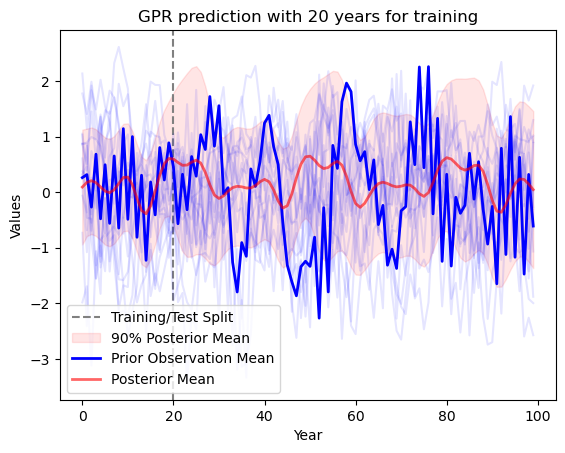

Optimization Progress:   0%|          | 0/200 [00:00<?, ?it/s]

|   iter    |  target   |    c2     |    c3     |    ls1    |    ls2    |   noise   |   per1    |   per2    |
-------------------------------------------------------------------------------------------------------------
|  1        | -1.534e+0 |  0.3908   |  0.3996   |  9.855    |  9.046    |  0.1861   |  15.35    |  16.68    |
|  2        | -897.2    |  1.325    |  0.5777   |  6.356    |  5.802    |  0.6188   |  17.36    |  15.16    |
|  3        | -936.8    |  0.4693   |  1.15     |  8.258    |  5.039    |  0.6876   |  25.19    |  22.85    |
|  4        | -4.798e+0 |  0.8315   |  0.2522   |  8.077    |  8.117    |  0.05083  |  21.89    |  29.37    |
|  5        | -954.0    |  1.974    |  1.658    |  6.902    |  6.236    |  0.5992   |  23.63    |  26.77    |
|  6        | -978.7    |  0.974    |  1.141    |  9.565    |  2.847    |  0.4844   |  26.26    |  22.14    |
|  7        | -899.1    |  1.307    |  0.8918   |  7.815    |  3.049    |  0.7597   |  18.0     |  25.07    |
|  8      

Optimization Progress:   0%|          | 0/200 [00:03<?, ?it/s]

An error occurred during optimization: 'x0' must only have one dimension.
Best parameters found during the optimization process:  {'c2': 1.587401619150392, 'c3': 1.6292577289606536, 'ls1': 5.608531784347997, 'ls2': 1.1255916772342913, 'noise': 0.2962031063208207, 'per1': 15.422108429293456, 'per2': 25.872093818910905}
Total log marginal likelihood for best parameters found during the optimization process:  -747.4023591928029


total_lml_train: -747.4023591928029
total_lml_test: -1215.851047287791
total_lml_full: -2384.883311975339
best kernel is: 1.26**2 * ExpSineSquared(length_scale=5.61, periodicity=15.4) + 1.28**2 * ExpSineSquared(length_scale=1.13, periodicity=25.9) + WhiteKernel(noise_level=0.296)
observation_lml_train: -49.636621044890155
observation_lml_test: -122.2236551137097
observation_lml_full: -180.70143508848628


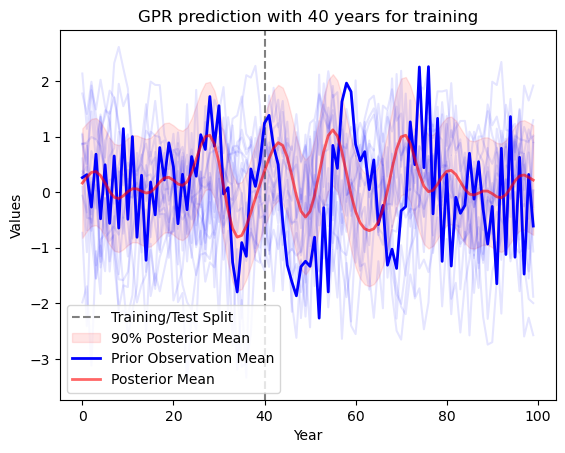

Optimization Progress:   0%|          | 0/200 [00:00<?, ?it/s]

|   iter    |  target   |    c2     |    c3     |    ls1    |    ls2    |   noise   |   per1    |   per2    |
-------------------------------------------------------------------------------------------------------------
|  1        | -2.355e+0 |  0.3908   |  0.3996   |  9.855    |  9.046    |  0.1861   |  15.35    |  16.68    |
|  2        | -1.343e+0 |  1.325    |  0.5777   |  6.356    |  5.802    |  0.6188   |  17.36    |  15.16    |
|  3        | -1.419e+0 |  0.4693   |  1.15     |  8.258    |  5.039    |  0.6876   |  25.19    |  22.85    |
|  4        | -7.652e+0 |  0.8315   |  0.2522   |  8.077    |  8.117    |  0.05083  |  21.89    |  29.37    |
|  5        | -1.445e+0 |  1.974    |  1.658    |  6.902    |  6.236    |  0.5992   |  23.63    |  26.77    |
|  6        | -1.495e+0 |  0.974    |  1.141    |  9.565    |  2.847    |  0.4844   |  26.26    |  22.14    |
|  7        | -1.378e+0 |  1.307    |  0.8918   |  7.815    |  3.049    |  0.7597   |  18.0     |  25.07    |
|  8      

Optimization Progress:   0%|          | 0/200 [00:03<?, ?it/s]

|  98       | -1.489e+0 |  0.6228   |  1.404    |  6.374    |  9.996    |  0.308    |  16.17    |  13.81    |
|  99       | -1.244e+0 |  1.723    |  0.6796   |  1.377    |  9.616    |  0.6422   |  28.17    |  19.38    |
|  100      | -1.878e+0 |  1.388    |  0.1743   |  4.904    |  6.185    |  0.237    |  28.76    |  14.21    |
An error occurred during optimization: 'x0' must only have one dimension.
Best parameters found during the optimization process:  {'c2': 1.2043271729280505, 'c3': 1.3504867302229664, 'ls1': 1.1586604522550457, 'ls2': 3.076991904563972, 'noise': 0.47921939607525155, 'per1': 26.288152735969675, 'per2': 16.484440866436202}
Total log marginal likelihood for best parameters found during the optimization process:  -1200.0334634853482


total_lml_train: -1200.0334634853482
total_lml_test: -742.6672326338118
total_lml_full: -2266.9258718459614
best kernel is: 1.1**2 * ExpSineSquared(length_scale=1.16, periodicity=26.3) + 1.16**2 * ExpSineSquared(length_scale=3.08, periodicity=16.5) + WhiteKernel(noise_level=0.479)
observation_lml_train: -84.87516265436292
observation_lml_test: -58.747347433085864
observation_lml_full: -146.4179518634565


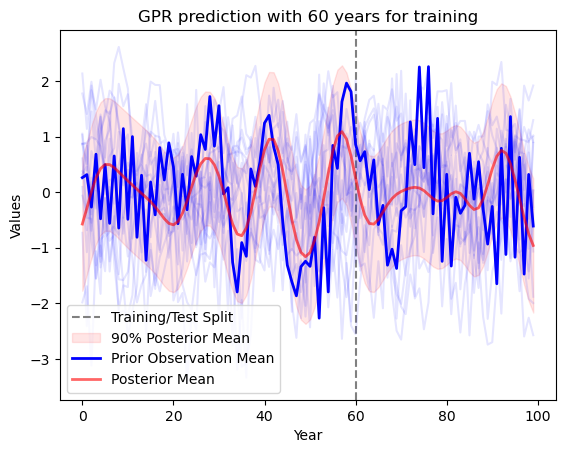

Optimization Progress:   0%|          | 0/200 [00:00<?, ?it/s]

|   iter    |  target   |    c2     |    c3     |    ls1    |    ls2    |   noise   |   per1    |   per2    |
-------------------------------------------------------------------------------------------------------------
|  1        | -3.145e+0 |  0.3908   |  0.3996   |  9.855    |  9.046    |  0.1861   |  15.35    |  16.68    |
|  2        | -1.778e+0 |  1.325    |  0.5777   |  6.356    |  5.802    |  0.6188   |  17.36    |  15.16    |
|  3        | -1.882e+0 |  0.4693   |  1.15     |  8.258    |  5.039    |  0.6876   |  25.19    |  22.85    |
|  4        | -1.079e+0 |  0.8315   |  0.2522   |  8.077    |  8.117    |  0.05083  |  21.89    |  29.37    |
|  5        | -1.921e+0 |  1.974    |  1.658    |  6.902    |  6.236    |  0.5992   |  23.63    |  26.77    |
|  6        | -1.997e+0 |  0.974    |  1.141    |  9.565    |  2.847    |  0.4844   |  26.26    |  22.14    |
|  7        | -1.832e+0 |  1.307    |  0.8918   |  7.815    |  3.049    |  0.7597   |  18.0     |  25.07    |
|  8      

Optimization Progress:   0%|          | 0/200 [00:05<?, ?it/s]

Total log marginal likelihood for best parameters found during the optimization process:  -1676.414970751814


total_lml_train: -1676.414970751814
total_lml_test: -401.0986942700158
total_lml_full: -2098.1168041256547
best kernel is: 1.28**2 * ExpSineSquared(length_scale=4.99, periodicity=20.9) + 0.801**2 * ExpSineSquared(length_scale=1.41, periodicity=14.7) + WhiteKernel(noise_level=0.671)
observation_lml_train: -114.60972159962205
observation_lml_test: -28.11642125198793
observation_lml_full: -141.55705690423125


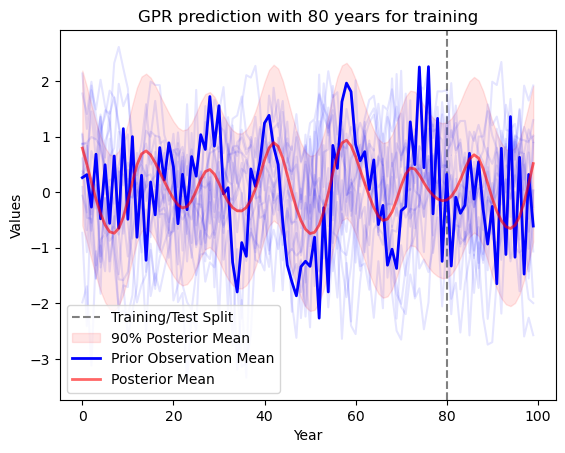

In [ ]:
def pe2(best_params):
    kernel = (
        C(best_params['c2']) * ExpSineSquared(length_scale=best_params['ls1'], periodicity=best_params['per1']) +
        C(best_params['c3']) * ExpSineSquared(length_scale=best_params['ls2'], periodicity=best_params['per2']) +
        WhiteKernel(noise_level=best_params['noise'])
    )
    return kernel

pbounds = {
    'c2': (1e-1, 2),
    'c3': (1e-1, 2),
    'ls1': (1e-2, 1e1),
    'per1': (10, 30),
    'ls2': (1e-2, 1e1),
    'per2': (10, 30),
    'noise': (1e-6, 1),
}

gpr_model(mod_ids, 20, rainfall_yearly, pbounds, pe2, oos_gcm)
gpr_model(mod_ids, 40, rainfall_yearly, pbounds, pe2, oos_gcm)
gpr_model(mod_ids, 60, rainfall_yearly, pbounds, pe2, oos_gcm)
gpr_model(mod_ids, 80, rainfall_yearly, pbounds, pe2, oos_gcm)

Optimization Progress:   0%|          | 0/200 [00:00<?, ?it/s]

|   iter    |  target   |    c2     |    c3     | c_matern  |    ls1    |    ls2    | matern_ls | matern_nu |   noise   |   per1    |   per2    |
-------------------------------------------------------------------------------------------------------------------------------------------------
|  1        | -407.8    |  0.2377   |  0.2419   |  0.9869   |  9.046    |  1.869    |  2.684    |  1.168    |  0.6446   |  15.03    |  22.7     |
|  2        | -403.6    |  0.6218   |  0.6569   |  0.431    |  2.589    |  1.952    |  5.53     |  2.151    |  0.5035   |  23.75    |  25.19    |
|  3        | -473.7    |  0.6781   |  0.4465   |  0.1721   |  8.077    |  8.117    |  0.5178   |  1.689    |  0.9683   |  29.72    |  26.4     |
|  4        | -434.0    |  0.7209   |  0.6609   |  0.6393   |  6.819    |  8.389    |  4.606    |  1.595    |  0.9565   |  15.68    |  19.69    |
|  5        | -377.5    |  0.8318   |  0.6461   |  0.6717   |  4.173    |  7.815    |  3.049    |  2.019    |  0.3999   |  2

Optimization Progress:   0%|          | 0/200 [00:04<?, ?it/s]

Total log marginal likelihood for best parameters found during the optimization process:  -360.8183722056411


total_lml_train: -360.8183722056411
total_lml_test: -1534.3821663825674
total_lml_full: -1915.5952528570613
best kernel is: 0.931**2 * ExpSineSquared(length_scale=1.16, periodicity=12.6) + 0.789**2 * ExpSineSquared(length_scale=3.08, periodicity=10.6) + 0.832**2 * Matern(length_scale=4.8, nu=2.13) + WhiteKernel(noise_level=0.324)
observation_lml_train: -26.82809541148777
observation_lml_test: -117.02214904309717
observation_lml_full: -141.04742343111485


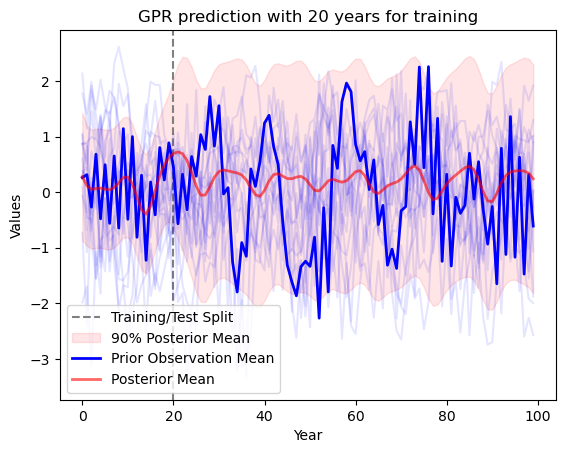

Optimization Progress:   0%|          | 0/200 [00:00<?, ?it/s]

|   iter    |  target   |    c2     |    c3     | c_matern  |    ls1    |    ls2    | matern_ls | matern_nu |   noise   |   per1    |   per2    |
-------------------------------------------------------------------------------------------------------------------------------------------------
|  1        | -812.2    |  0.2377   |  0.2419   |  0.9869   |  9.046    |  1.869    |  2.684    |  1.168    |  0.6446   |  15.03    |  22.7     |
|  2        | -803.6    |  0.6218   |  0.6569   |  0.431    |  2.589    |  1.952    |  5.53     |  2.151    |  0.5035   |  23.75    |  25.19    |
|  3        | -927.4    |  0.6781   |  0.4465   |  0.1721   |  8.077    |  8.117    |  0.5178   |  1.689    |  0.9683   |  29.72    |  26.4     |
|  4        | -857.1    |  0.7209   |  0.6609   |  0.6393   |  6.819    |  8.389    |  4.606    |  1.595    |  0.9565   |  15.68    |  19.69    |
|  5        | -746.6    |  0.8318   |  0.6461   |  0.6717   |  4.173    |  7.815    |  3.049    |  2.019    |  0.3999   |  2

Optimization Progress:   0%|          | 0/200 [00:05<?, ?it/s]

Total log marginal likelihood for best parameters found during the optimization process:  -720.3630036743011


total_lml_train: -720.3630036743011
total_lml_test: -1140.7974099554713
total_lml_full: -1915.5952528570613
best kernel is: 0.931**2 * ExpSineSquared(length_scale=1.16, periodicity=12.6) + 0.789**2 * ExpSineSquared(length_scale=3.08, periodicity=10.6) + 0.832**2 * Matern(length_scale=4.8, nu=2.13) + WhiteKernel(noise_level=0.324)
observation_lml_train: -48.192910784972156
observation_lml_test: -94.27592982344544
observation_lml_full: -141.04742343111485


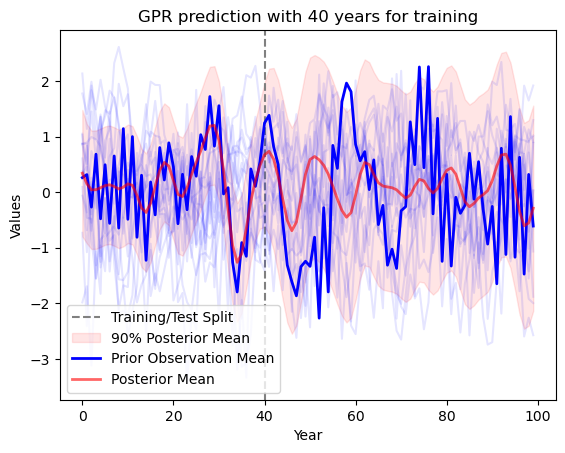

Optimization Progress:   0%|          | 0/200 [00:00<?, ?it/s]

|   iter    |  target   |    c2     |    c3     | c_matern  |    ls1    |    ls2    | matern_ls | matern_nu |   noise   |   per1    |   per2    |
-------------------------------------------------------------------------------------------------------------------------------------------------
|  1        | -1.222e+0 |  0.2377   |  0.2419   |  0.9869   |  9.046    |  1.869    |  2.684    |  1.168    |  0.6446   |  15.03    |  22.7     |
|  2        | -1.223e+0 |  0.6218   |  0.6569   |  0.431    |  2.589    |  1.952    |  5.53     |  2.151    |  0.5035   |  23.75    |  25.19    |
|  3        | -1.386e+0 |  0.6781   |  0.4465   |  0.1721   |  8.077    |  8.117    |  0.5178   |  1.689    |  0.9683   |  29.72    |  26.4     |
|  4        | -1.284e+0 |  0.7209   |  0.6609   |  0.6393   |  6.819    |  8.389    |  4.606    |  1.595    |  0.9565   |  15.68    |  19.69    |
|  5        | -1.125e+0 |  0.8318   |  0.6461   |  0.6717   |  4.173    |  7.815    |  3.049    |  2.019    |  0.3999   |  2

Optimization Progress:   0%|          | 0/200 [00:07<?, ?it/s]

|  99       | -1.164e+0 |  0.8501   |  0.1942   |  0.9442   |  9.846    |  2.02     |  4.071    |  2.484    |  0.5639   |  21.21    |  20.72    |
|  100      | -1.218e+0 |  0.6171   |  0.9233   |  0.8126   |  1.633    |  1.869    |  1.651    |  1.281    |  0.4384   |  17.62    |  29.77    |
An error occurred during optimization: 'x0' must only have one dimension.
Best parameters found during the optimization process:  {'c2': 0.47828825177336387, 'c3': 0.3216723744617143, 'c_matern': 0.7571953945480517, 'ls1': 8.47260816185323, 'ls2': 8.737514904491793, 'matern_ls': 3.8735273011942826, 'matern_nu': 2.075836248211955, 'noise': 0.2895637482234354, 'per1': 11.286866406065252, 'per2': 20.937102523193747}
Total log marginal likelihood for best parameters found during the optimization process:  -1093.2049490953104


total_lml_train: -1093.2049490953104
total_lml_test: -740.651490512042
total_lml_full: -1819.683625916198
best kernel is: 0.692**2 * ExpSineSquared(length_scale=8.47, periodicity=11.3) + 0.567**2 * ExpSineSquared(length_scale=8.74, periodicity=20.9) + 0.87**2 * Matern(length_scale=3.87, nu=2.08) + WhiteKernel(noise_level=0.29)
observation_lml_train: -74.38284436039883
observation_lml_test: -64.22357572236697
observation_lml_full: -137.44055386800045


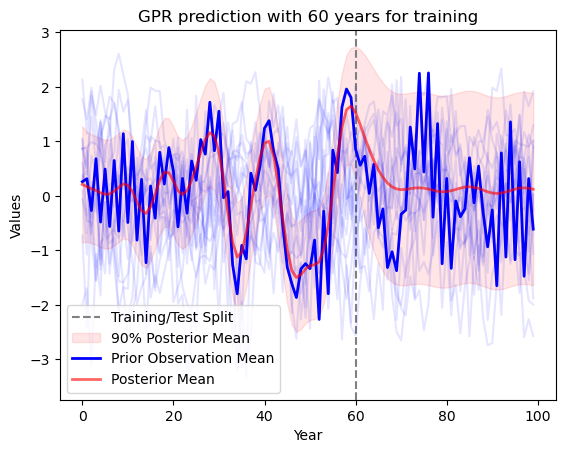

Optimization Progress:   0%|          | 0/200 [00:00<?, ?it/s]

|   iter    |  target   |    c2     |    c3     | c_matern  |    ls1    |    ls2    | matern_ls | matern_nu |   noise   |   per1    |   per2    |
-------------------------------------------------------------------------------------------------------------------------------------------------
|  1        | -1.627e+0 |  0.2377   |  0.2419   |  0.9869   |  9.046    |  1.869    |  2.684    |  1.168    |  0.6446   |  15.03    |  22.7     |
|  2        | -1.638e+0 |  0.6218   |  0.6569   |  0.431    |  2.589    |  1.952    |  5.53     |  2.151    |  0.5035   |  23.75    |  25.19    |
|  3        | -1.842e+0 |  0.6781   |  0.4465   |  0.1721   |  8.077    |  8.117    |  0.5178   |  1.689    |  0.9683   |  29.72    |  26.4     |
|  4        | -1.709e+0 |  0.7209   |  0.6609   |  0.6393   |  6.819    |  8.389    |  4.606    |  1.595    |  0.9565   |  15.68    |  19.69    |
|  5        | -1.497e+0 |  0.8318   |  0.6461   |  0.6717   |  4.173    |  7.815    |  3.049    |  2.019    |  0.3999   |  2

Optimization Progress:   0%|          | 0/200 [00:11<?, ?it/s]

|  100      | -1.622e+0 |  0.6171   |  0.9233   |  0.8126   |  1.633    |  1.869    |  1.651    |  1.281    |  0.4384   |  17.62    |  29.77    |
An error occurred during optimization: 'x0' must only have one dimension.
Best parameters found during the optimization process:  {'c2': 0.47828825177336387, 'c3': 0.3216723744617143, 'c_matern': 0.7571953945480517, 'ls1': 8.47260816185323, 'ls2': 8.737514904491793, 'matern_ls': 3.8735273011942826, 'matern_nu': 2.075836248211955, 'noise': 0.2895637482234354, 'per1': 11.286866406065252, 'per2': 20.937102523193747}
Total log marginal likelihood for best parameters found during the optimization process:  -1458.789835849418


total_lml_train: -1458.789835849418
total_lml_test: -374.33205930504187
total_lml_full: -1819.683625916198
best kernel is: 0.692**2 * ExpSineSquared(length_scale=8.47, periodicity=11.3) + 0.567**2 * ExpSineSquared(length_scale=8.74, periodicity=20.9) + 0.87**2 * Matern(length_scale=3.87, nu=2.08) + WhiteKernel(noise_level=0.29)
observation_lml_train: -104.53498441475182
observation_lml_test: -34.01478198228855
observation_lml_full: -137.44055386800045


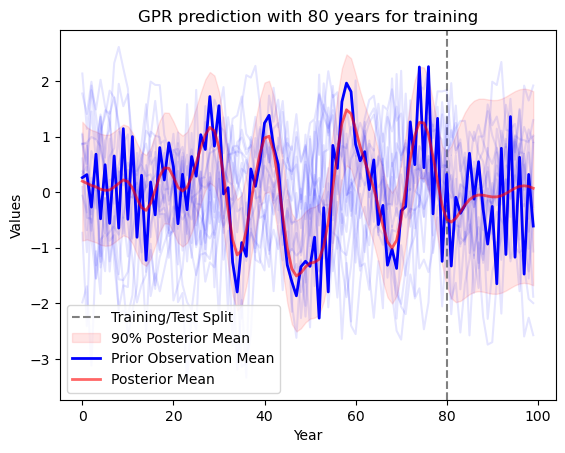

In [109]:
def pe2_matern(best_params):
    kernel = (
        C(best_params['c2']) * ExpSineSquared(length_scale=best_params['ls1'], periodicity=best_params['per1']) +
        C(best_params['c3']) * ExpSineSquared(length_scale=best_params['ls2'], periodicity=best_params['per2']) +
        C(best_params['c_matern']) * Matern(length_scale=best_params['matern_ls'], nu=best_params['matern_nu']) +
        WhiteKernel(noise_level=best_params['noise'])
    )
    return kernel

pbounds = {
    'c2': (1e-1, 1),
    'c3': (1e-1, 1),
    'ls1': (1e-2, 1e1),
    'per1': (10, 30),
    'ls2': (1e-2, 1e1),
    'per2': (10, 30),
    'noise': (1e-6, 1),
    'c_matern': (1e-1, 1), 
    'matern_ls': (1e-2, 1e1),
    'matern_nu': (0.5, 2.5), 
}

gpr_model(mod_ids, 20, rainfall_yearly, pbounds, pe2_matern, oos_gcm)
gpr_model(mod_ids, 40, rainfall_yearly, pbounds, pe2_matern, oos_gcm)
gpr_model(mod_ids, 60, rainfall_yearly, pbounds, pe2_matern, oos_gcm)
gpr_model(mod_ids, 80, rainfall_yearly, pbounds, pe2_matern, oos_gcm)

Optimization Progress:   0%|          | 0/200 [00:00<?, ?it/s]

|   iter    |  target   |    c2     |    c3     |   c_rbf   |    ls1    |    ls2    |   noise   |   per1    |   per2    |  rbf_ls   |
-------------------------------------------------------------------------------------------------------------------------------------
|  1        | -360.7    |  1.615    |  1.661    |  0.9869   |  9.046    |  1.869    |  0.2677   |  16.68    |  22.89    |  2.522    |
|  2        | -412.1    |  6.389    |  5.84     |  0.6569   |  3.684    |  2.589    |  0.1944   |  21.05    |  26.51    |  5.039    |
|  3        | -518.7    |  6.907    |  7.62     |  0.6781   |  3.856    |  0.8102   |  0.8075   |  26.23    |  11.02    |  5.947    |
|  4        | -429.2    |  9.686    |  9.864    |  0.8378   |  6.902    |  6.236    |  0.5992   |  23.63    |  26.77    |  4.606    |
|  5        | -436.5    |  5.523    |  9.569    |  0.3556   |  4.849    |  8.133    |  0.6068   |  22.7     |  18.33    |  7.815    |
|  6        | -471.5    |  3.112    |  7.621    |  0.4599   | 

Optimization Progress:   0%|          | 0/200 [00:03<?, ?it/s]

|  98       | -435.3    |  7.442    |  2.636    |  0.9412   |  6.001    |  8.402    |  0.4616   |  22.79    |  16.37    |  7.25     |
|  99       | -593.1    |  2.318    |  2.744    |  0.646    |  8.307    |  5.615    |  0.1465   |  16.76    |  26.39    |  9.525    |
|  100      | -368.2    |  1.925    |  0.1686   |  0.1282   |  3.493    |  6.512    |  0.2871   |  13.48    |  14.66    |  4.763    |
An error occurred during optimization: 'x0' must only have one dimension.
Best parameters found during the optimization process:  {'c2': 2.6231470791664075, 'c3': 8.166153909889129, 'c_rbf': 0.4505917094674723, 'ls1': 5.707730243682303, 'ls2': 4.650007515728829, 'noise': 0.2320163127657809, 'per1': 12.340868933556948, 'per2': 19.27231790897052, 'rbf_ls': 2.982137651860002}
Total log marginal likelihood for best parameters found during the optimization process:  -358.80511470330833


total_lml_train: -358.80511470330833
total_lml_test: -1484.4350174849592
total_lml_full: -1835.0141100102765
best kernel is: 1.62**2 * ExpSineSquared(length_scale=5.71, periodicity=12.3) + 2.86**2 * ExpSineSquared(length_scale=4.65, periodicity=19.3) + 0.671**2 * RBF(length_scale=2.98) + WhiteKernel(noise_level=0.232)
observation_lml_train: -28.45450861222872
observation_lml_test: -120.26935611044166
observation_lml_full: -146.256818499749


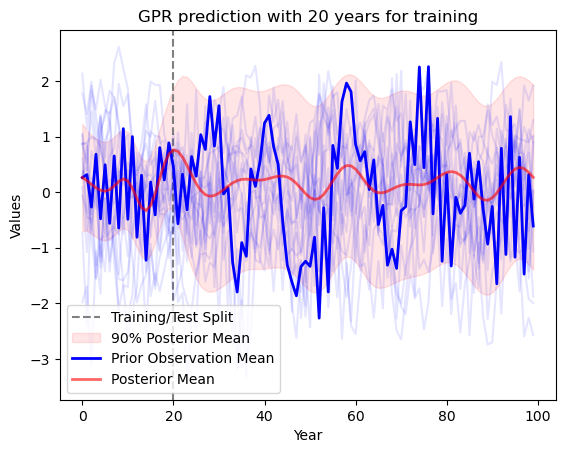

Optimization Progress:   0%|          | 0/200 [00:00<?, ?it/s]

|   iter    |  target   |    c2     |    c3     |   c_rbf   |    ls1    |    ls2    |   noise   |   per1    |   per2    |  rbf_ls   |
-------------------------------------------------------------------------------------------------------------------------------------
|  1        | -714.9    |  1.615    |  1.661    |  0.9869   |  9.046    |  1.869    |  0.2677   |  16.68    |  22.89    |  2.522    |
|  2        | -809.8    |  6.389    |  5.84     |  0.6569   |  3.684    |  2.589    |  0.1944   |  21.05    |  26.51    |  5.039    |
|  3        | -1.015e+0 |  6.907    |  7.62     |  0.6781   |  3.856    |  0.8102   |  0.8075   |  26.23    |  11.02    |  5.947    |
|  4        | -828.8    |  9.686    |  9.864    |  0.8378   |  6.902    |  6.236    |  0.5992   |  23.63    |  26.77    |  4.606    |
|  5        | -883.1    |  5.523    |  9.569    |  0.3556   |  4.849    |  8.133    |  0.6068   |  22.7     |  18.33    |  7.815    |
|  6        | -965.0    |  3.112    |  7.621    |  0.4599   | 

Optimization Progress:   0%|          | 0/200 [00:04<?, ?it/s]

An error occurred during optimization: 'x0' must only have one dimension.
Best parameters found during the optimization process:  {'c2': 2.6231470791664075, 'c3': 8.166153909889129, 'c_rbf': 0.4505917094674723, 'ls1': 5.707730243682303, 'ls2': 4.650007515728829, 'noise': 0.2320163127657809, 'per1': 12.340868933556948, 'per2': 19.27231790897052, 'rbf_ls': 2.982137651860002}
Total log marginal likelihood for best parameters found during the optimization process:  -714.1673142602406


total_lml_train: -714.1673142602406
total_lml_test: -1115.466705262118
total_lml_full: -1835.0141100102765
best kernel is: 1.62**2 * ExpSineSquared(length_scale=5.71, periodicity=12.3) + 2.86**2 * ExpSineSquared(length_scale=4.65, periodicity=19.3) + 0.671**2 * RBF(length_scale=2.98) + WhiteKernel(noise_level=0.232)
observation_lml_train: -49.716321573880634
observation_lml_test: -96.90578038685706
observation_lml_full: -146.256818499749


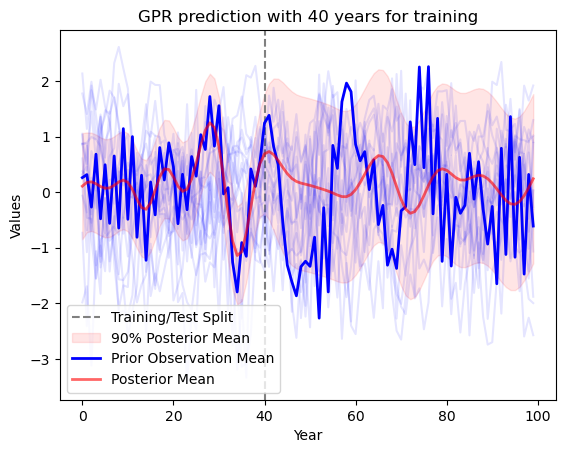

Optimization Progress:   0%|          | 0/200 [00:00<?, ?it/s]

|   iter    |  target   |    c2     |    c3     |   c_rbf   |    ls1    |    ls2    |   noise   |   per1    |   per2    |  rbf_ls   |
-------------------------------------------------------------------------------------------------------------------------------------
|  1        | -1.082e+0 |  1.615    |  1.661    |  0.9869   |  9.046    |  1.869    |  0.2677   |  16.68    |  22.89    |  2.522    |
|  2        | -1.235e+0 |  6.389    |  5.84     |  0.6569   |  3.684    |  2.589    |  0.1944   |  21.05    |  26.51    |  5.039    |
|  3        | -1.47e+03 |  6.907    |  7.62     |  0.6781   |  3.856    |  0.8102   |  0.8075   |  26.23    |  11.02    |  5.947    |
|  4        | -1.239e+0 |  9.686    |  9.864    |  0.8378   |  6.902    |  6.236    |  0.5992   |  23.63    |  26.77    |  4.606    |
|  5        | -1.376e+0 |  5.523    |  9.569    |  0.3556   |  4.849    |  8.133    |  0.6068   |  22.7     |  18.33    |  7.815    |
|  6        | -1.478e+0 |  3.112    |  7.621    |  0.4599   | 

Optimization Progress:   0%|          | 0/200 [00:04<?, ?it/s]

|  99       | -2.177e+0 |  2.318    |  2.744    |  0.646    |  8.307    |  5.615    |  0.1465   |  16.76    |  26.39    |  9.525    |
|  100      | -1.219e+0 |  1.925    |  0.1686   |  0.1282   |  3.493    |  6.512    |  0.2871   |  13.48    |  14.66    |  4.763    |
An error occurred during optimization: 'x0' must only have one dimension.
Best parameters found during the optimization process:  {'c2': 1.6152365677848544, 'c3': 1.6610880439931324, 'c_rbf': 0.9869420027648373, 'ls1': 9.045932330744884, 'ls2': 1.8689218440437394, 'noise': 0.26771024670364724, 'per1': 16.681023149767583, 'per2': 22.89183741865049, 'rbf_ls': 2.521558335171484}
Total log marginal likelihood for best parameters found during the optimization process:  -1082.3762682767333


total_lml_train: -1082.3762682767333
total_lml_test: -740.5705295494704
total_lml_full: -1794.1561294270273
best kernel is: 1.27**2 * ExpSineSquared(length_scale=9.05, periodicity=16.7) + 1.29**2 * ExpSineSquared(length_scale=1.87, periodicity=22.9) + 0.993**2 * RBF(length_scale=2.52) + WhiteKernel(noise_level=0.268)
observation_lml_train: -75.2585146972865
observation_lml_test: -67.75922257782481
observation_lml_full: -140.82648340020535


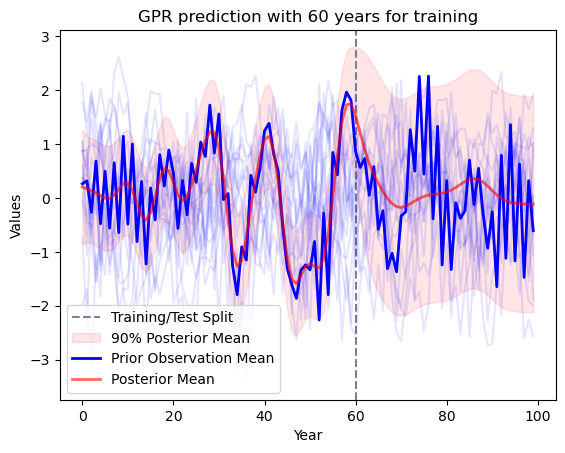

Optimization Progress:   0%|          | 0/200 [00:00<?, ?it/s]

|   iter    |  target   |    c2     |    c3     |   c_rbf   |    ls1    |    ls2    |   noise   |   per1    |   per2    |  rbf_ls   |
-------------------------------------------------------------------------------------------------------------------------------------
|  1        | -1.438e+0 |  1.615    |  1.661    |  0.9869   |  9.046    |  1.869    |  0.2677   |  16.68    |  22.89    |  2.522    |
|  2        | -1.686e+0 |  6.389    |  5.84     |  0.6569   |  3.684    |  2.589    |  0.1944   |  21.05    |  26.51    |  5.039    |
|  3        | -1.912e+0 |  6.907    |  7.62     |  0.6781   |  3.856    |  0.8102   |  0.8075   |  26.23    |  11.02    |  5.947    |
|  4        | -1.644e+0 |  9.686    |  9.864    |  0.8378   |  6.902    |  6.236    |  0.5992   |  23.63    |  26.77    |  4.606    |
|  5        | -1.855e+0 |  5.523    |  9.569    |  0.3556   |  4.849    |  8.133    |  0.6068   |  22.7     |  18.33    |  7.815    |
|  6        | -1.993e+0 |  3.112    |  7.621    |  0.4599   | 

Optimization Progress:   0%|          | 0/200 [00:06<?, ?it/s]

|  99       | -3.134e+0 |  2.318    |  2.744    |  0.646    |  8.307    |  5.615    |  0.1465   |  16.76    |  26.39    |  9.525    |
|  100      | -1.674e+0 |  1.925    |  0.1686   |  0.1282   |  3.493    |  6.512    |  0.2871   |  13.48    |  14.66    |  4.763    |
An error occurred during optimization: 'x0' must only have one dimension.
Best parameters found during the optimization process:  {'c2': 1.6152365677848544, 'c3': 1.6610880439931324, 'c_rbf': 0.9869420027648373, 'ls1': 9.045932330744884, 'ls2': 1.8689218440437394, 'noise': 0.26771024670364724, 'per1': 16.681023149767583, 'per2': 22.89183741865049, 'rbf_ls': 2.521558335171484}
Total log marginal likelihood for best parameters found during the optimization process:  -1438.1151668795126


total_lml_train: -1438.1151668795126
total_lml_test: -379.7636094009795
total_lml_full: -1794.1561294270273
best kernel is: 1.27**2 * ExpSineSquared(length_scale=9.05, periodicity=16.7) + 1.29**2 * ExpSineSquared(length_scale=1.87, periodicity=22.9) + 0.993**2 * RBF(length_scale=2.52) + WhiteKernel(noise_level=0.268)
observation_lml_train: -105.73144378520614
observation_lml_test: -36.936429395326996
observation_lml_full: -140.82648340020535


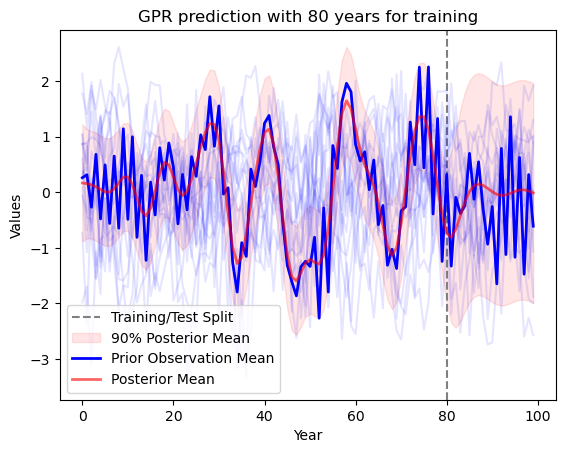

In [110]:
def pe2_rbf(best_params):
    kernel = (
        C(best_params['c2']) * ExpSineSquared(length_scale=best_params['ls1'], periodicity=best_params['per1']) +
        C(best_params['c3']) * ExpSineSquared(length_scale=best_params['ls2'], periodicity=best_params['per2']) +
        C(best_params['c_rbf']) * RBF(length_scale=best_params['rbf_ls']) +
        WhiteKernel(noise_level=best_params['noise'])
    )
    return kernel

pbounds = {
    'c2': (1e-1, 1e1),
    'c3': (1e-1, 1e1),
    'c_rbf': (1e-1, 1),  # New coefficient for RBF kernel
    'ls1': (1e-2, 1e1),
    'per1': (10, 30),
    'ls2': (1e-2, 1e1),
    'per2': (10, 30),
    'rbf_ls': (1e-2, 1e1),  # New parameter for RBF kernel length scale
    'noise': (1e-6, 1),
}

gpr_model(mod_ids, 20, rainfall_yearly, pbounds, pe2_rbf, oos_gcm)
gpr_model(mod_ids, 40, rainfall_yearly, pbounds, pe2_rbf, oos_gcm)
gpr_model(mod_ids, 60, rainfall_yearly, pbounds, pe2_rbf, oos_gcm)
gpr_model(mod_ids, 80, rainfall_yearly, pbounds, pe2_rbf, oos_gcm)

Optimization Progress:   0%|          | 0/200 [00:00<?, ?it/s]

|   iter    |  target   |    c2     |    c3     |    ls1    |    ls2    |   noise   |   per1    |   per2    |  rbf_ls1  |  rbf_ls2  |
-------------------------------------------------------------------------------------------------------------------------------------
|  1        | -354.1    |  0.3908   |  0.3996   |  9.855    |  9.046    |  0.1861   |  15.35    |  16.68    |  6.449    |  2.522    |
|  2        | -370.2    |  1.307    |  1.202    |  6.192    |  3.684    |  0.2582   |  13.89    |  21.05    |  8.258    |  5.039    |
|  3        | -461.1    |  1.406    |  1.543    |  6.427    |  3.856    |  0.0801   |  26.15    |  26.23    |  0.5178   |  5.947    |
|  4        | -406.2    |  1.94     |  1.974    |  8.2      |  6.902    |  0.6232   |  21.98    |  23.63    |  8.389    |  4.606    |
|  5        | -421.2    |  1.141    |  1.917    |  2.847    |  4.849    |  0.8131   |  22.14    |  22.7     |  4.173    |  7.815    |
|  6        | -434.7    |  0.678    |  1.543    |  4.005    | 

Optimization Progress:   0%|          | 0/200 [00:03<?, ?it/s]

An error occurred during optimization: 'x0' must only have one dimension.
Best parameters found during the optimization process:  {'c2': 0.5730696743919911, 'c3': 0.3161473453999877, 'ls1': 0.7620949227652593, 'ls2': 2.6412315273510276, 'noise': 0.27533276898211445, 'per1': 29.1657676440799, 'per2': 16.901008175485188, 'rbf_ls1': 4.449127468803838, 'rbf_ls2': 2.9849019979073703}
Total log marginal likelihood for best parameters found during the optimization process:  -338.76619126919707


total_lml_train: -338.76619126919707
total_lml_test: -1404.853773548745
total_lml_full: -1738.4279026953761
best kernel is: 0.757**2 * ExpSineSquared(length_scale=0.762, periodicity=29.2) * RBF(length_scale=4.45) + 0.562**2 * ExpSineSquared(length_scale=2.64, periodicity=16.9) * RBF(length_scale=2.98) + WhiteKernel(noise_level=0.275)
observation_lml_train: -25.72120605573525
observation_lml_test: -110.55870903194106
observation_lml_full: -136.01192118676343


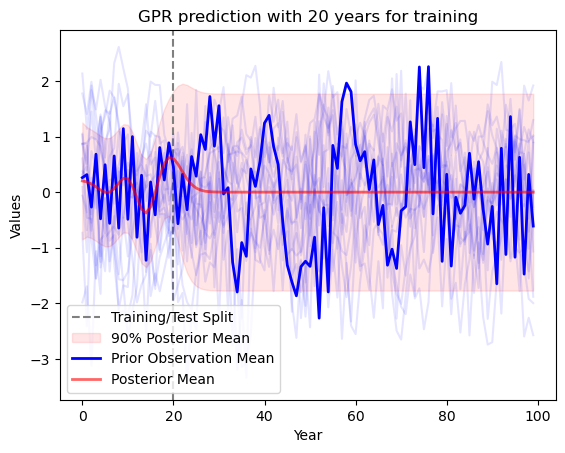

Optimization Progress:   0%|          | 0/200 [00:00<?, ?it/s]

|   iter    |  target   |    c2     |    c3     |    ls1    |    ls2    |   noise   |   per1    |   per2    |  rbf_ls1  |  rbf_ls2  |
-------------------------------------------------------------------------------------------------------------------------------------
|  1        | -718.7    |  0.3908   |  0.3996   |  9.855    |  9.046    |  0.1861   |  15.35    |  16.68    |  6.449    |  2.522    |
|  2        | -743.3    |  1.307    |  1.202    |  6.192    |  3.684    |  0.2582   |  13.89    |  21.05    |  8.258    |  5.039    |
|  3        | -919.3    |  1.406    |  1.543    |  6.427    |  3.856    |  0.0801   |  26.15    |  26.23    |  0.5178   |  5.947    |
|  4        | -805.5    |  1.94     |  1.974    |  8.2      |  6.902    |  0.6232   |  21.98    |  23.63    |  8.389    |  4.606    |
|  5        | -836.3    |  1.141    |  1.917    |  2.847    |  4.849    |  0.8131   |  22.14    |  22.7     |  4.173    |  7.815    |
|  6        | -865.1    |  0.678    |  1.543    |  4.005    | 

Optimization Progress:   0%|          | 0/200 [00:04<?, ?it/s]

Total log marginal likelihood for best parameters found during the optimization process:  -682.8997915882627


total_lml_train: -682.8997915882627
total_lml_test: -1060.7813123802819
total_lml_full: -1738.4279026953761
best kernel is: 0.757**2 * ExpSineSquared(length_scale=0.762, periodicity=29.2) * RBF(length_scale=4.45) + 0.562**2 * ExpSineSquared(length_scale=2.64, periodicity=16.9) * RBF(length_scale=2.98) + WhiteKernel(noise_level=0.275)
observation_lml_train: -46.66100878386994
observation_lml_test: -89.8267864395819
observation_lml_full: -136.01192118676343


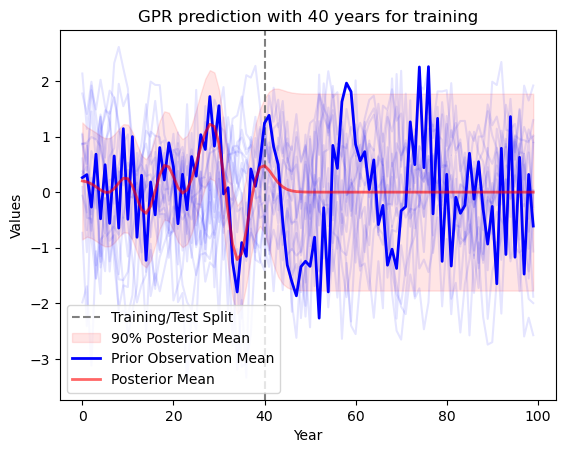

Optimization Progress:   0%|          | 0/200 [00:00<?, ?it/s]

|   iter    |  target   |    c2     |    c3     |    ls1    |    ls2    |   noise   |   per1    |   per2    |  rbf_ls1  |  rbf_ls2  |
-------------------------------------------------------------------------------------------------------------------------------------
|  1        | -1.102e+0 |  0.3908   |  0.3996   |  9.855    |  9.046    |  0.1861   |  15.35    |  16.68    |  6.449    |  2.522    |
|  2        | -1.126e+0 |  1.307    |  1.202    |  6.192    |  3.684    |  0.2582   |  13.89    |  21.05    |  8.258    |  5.039    |
|  3        | -1.384e+0 |  1.406    |  1.543    |  6.427    |  3.856    |  0.0801   |  26.15    |  26.23    |  0.5178   |  5.947    |
|  4        | -1.21e+03 |  1.94     |  1.974    |  8.2      |  6.902    |  0.6232   |  21.98    |  23.63    |  8.389    |  4.606    |
|  5        | -1.256e+0 |  1.141    |  1.917    |  2.847    |  4.849    |  0.8131   |  22.14    |  22.7     |  4.173    |  7.815    |
|  6        | -1.312e+0 |  0.678    |  1.543    |  4.005    | 

Optimization Progress:   0%|          | 0/200 [00:04<?, ?it/s]

Total log marginal likelihood for best parameters found during the optimization process:  -1039.5746523785638


total_lml_train: -1039.5746523785638
total_lml_test: -704.7656952599162
total_lml_full: -1738.4279026953761
best kernel is: 0.757**2 * ExpSineSquared(length_scale=0.762, periodicity=29.2) * RBF(length_scale=4.45) + 0.562**2 * ExpSineSquared(length_scale=2.64, periodicity=16.9) * RBF(length_scale=2.98) + WhiteKernel(noise_level=0.275)
observation_lml_train: -72.08881086203587
observation_lml_test: -64.20582548381218
observation_lml_full: -136.01192118676343


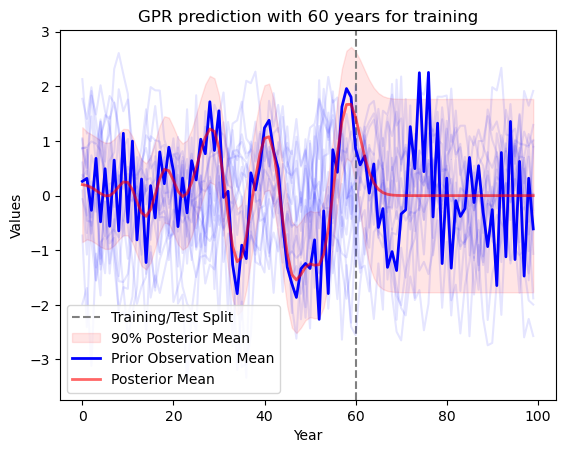

Optimization Progress:   0%|          | 0/200 [00:00<?, ?it/s]

|   iter    |  target   |    c2     |    c3     |    ls1    |    ls2    |   noise   |   per1    |   per2    |  rbf_ls1  |  rbf_ls2  |
-------------------------------------------------------------------------------------------------------------------------------------
|  1        | -1.48e+03 |  0.3908   |  0.3996   |  9.855    |  9.046    |  0.1861   |  15.35    |  16.68    |  6.449    |  2.522    |
|  2        | -1.513e+0 |  1.307    |  1.202    |  6.192    |  3.684    |  0.2582   |  13.89    |  21.05    |  8.258    |  5.039    |
|  3        | -1.847e+0 |  1.406    |  1.543    |  6.427    |  3.856    |  0.0801   |  26.15    |  26.23    |  0.5178   |  5.947    |
|  4        | -1.616e+0 |  1.94     |  1.974    |  8.2      |  6.902    |  0.6232   |  21.98    |  23.63    |  8.389    |  4.606    |
|  5        | -1.676e+0 |  1.141    |  1.917    |  2.847    |  4.849    |  0.8131   |  22.14    |  22.7     |  4.173    |  7.815    |
|  6        | -1.757e+0 |  0.678    |  1.543    |  4.005    | 

Optimization Progress:   0%|          | 0/200 [00:06<?, ?it/s]


total_lml_train: -1390.999316682953
total_lml_test: -355.7693856875351
total_lml_full: -1738.4279026953761
best kernel is: 0.757**2 * ExpSineSquared(length_scale=0.762, periodicity=29.2) * RBF(length_scale=4.45) + 0.562**2 * ExpSineSquared(length_scale=2.64, periodicity=16.9) * RBF(length_scale=2.98) + WhiteKernel(noise_level=0.275)
observation_lml_train: -102.10652357431897
observation_lml_test: -34.36198562589525
observation_lml_full: -136.01192118676343


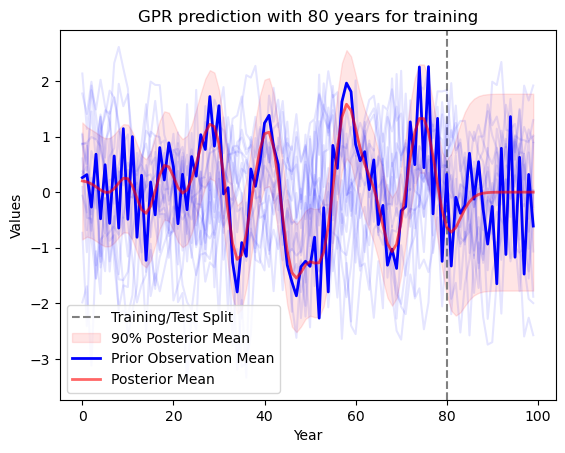

In [113]:
def rbfpe2(best_params):
    kernel = (
        C(best_params['c2']) * ExpSineSquared(length_scale=best_params['ls1'], periodicity=best_params['per1']) * RBF(length_scale=best_params['rbf_ls1']) +
        C(best_params['c3']) * ExpSineSquared(length_scale=best_params['ls2'], periodicity=best_params['per2']) * RBF(length_scale=best_params['rbf_ls2']) +
        WhiteKernel(noise_level=best_params['noise'])
    )
    return kernel

pbounds = {
    'c2': (1e-1, 2),
    'c3': (1e-1, 2),
    'ls1': (1e-2, 10),
    'per1': (10, 30),
    'ls2': (1e-2, 10),
    'per2': (10, 30),
    'rbf_ls1': (1e-2, 1e1),  # Length scale for the first RBF kernel
    'rbf_ls2': (1e-2, 1e1),  # Length scale for the second RBF kernel
    'noise': (1e-6, 1),
}

gpr_model(mod_ids, 20, rainfall_yearly, pbounds, rbfpe2, oos_gcm)
gpr_model(mod_ids, 40, rainfall_yearly, pbounds, rbfpe2, oos_gcm)
gpr_model(mod_ids, 60, rainfall_yearly, pbounds, rbfpe2, oos_gcm)
gpr_model(mod_ids, 80, rainfall_yearly, pbounds, rbfpe2, oos_gcm)

Optimization Progress:   0%|          | 0/200 [00:00<?, ?it/s]

|   iter    |  target   |    c2     |    c3     | linear... | linear... |    ls1    |    ls2    |   noise   |   per1    |   per2    |
-------------------------------------------------------------------------------------------------------------------------------------
|  1        | -595.1    |  1.615    |  1.661    |  9.855    |  9.045    |  1.869    |  2.684    |  0.3341   |  22.89    |  15.03    |
|  2        | -638.1    |  6.389    |  5.84     |  6.188    |  3.678    |  2.589    |  1.952    |  0.5525   |  26.51    |  20.07    |
|  3        | -1.104e+0 |  6.907    |  7.62     |  6.423    |  3.851    |  0.8102   |  8.077    |  0.8115   |  11.02    |  21.89    |
|  4        | -581.5    |  9.686    |  9.864    |  8.198    |  6.899    |  6.236    |  5.996    |  0.6816   |  26.77    |  19.2     |
|  5        | -540.0    |  5.523    |  9.569    |  2.841    |  4.844    |  8.133    |  6.072    |  0.6352   |  18.33    |  25.62    |
|  6        | -538.7    |  3.112    |  7.621    |  4.0      | 

Optimization Progress:   0%|          | 0/200 [00:03<?, ?it/s]

An error occurred during optimization: 'x0' must only have one dimension.
Best parameters found during the optimization process:  {'c2': 1.9248149866664899, 'c3': 0.16857610242236992, 'linear_sigma_0_1': 0.31469473169075507, 'linear_sigma_0_2': 3.4875966633331212, 'ls1': 6.511921146525906, 'ls2': 2.878226113016458, 'noise': 0.17378706656609488, 'per1': 14.660008892726324, 'per2': 19.515360492929663}
Total log marginal likelihood for best parameters found during the optimization process:  -422.27602393712914


total_lml_train: -422.27602393712914
total_lml_test: -2539.3018454644666
total_lml_full: -3321.3015767057295
best kernel is: 1.39**2 * ExpSineSquared(length_scale=6.51, periodicity=14.7) * DotProduct(sigma_0=0.315) + 0.411**2 * ExpSineSquared(length_scale=2.88, periodicity=19.5) * DotProduct(sigma_0=3.49) + WhiteKernel(noise_level=0.174)
observation_lml_train: -36.52900101149369
observation_lml_test: -198.3641538086848
observation_lml_full: -224.3971326644297


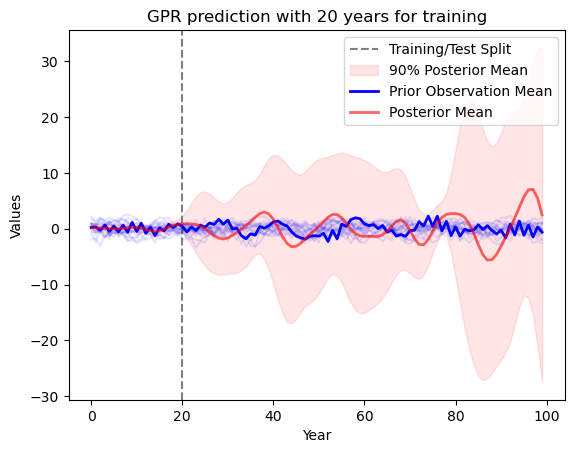

Optimization Progress:   0%|          | 0/200 [00:00<?, ?it/s]

|   iter    |  target   |    c2     |    c3     | linear... | linear... |    ls1    |    ls2    |   noise   |   per1    |   per2    |
-------------------------------------------------------------------------------------------------------------------------------------
|  1        | -1.183e+0 |  1.615    |  1.661    |  9.855    |  9.045    |  1.869    |  2.684    |  0.3341   |  22.89    |  15.03    |
|  2        | -1.273e+0 |  6.389    |  5.84     |  6.188    |  3.678    |  2.589    |  1.952    |  0.5525   |  26.51    |  20.07    |
|  3        | -1.822e+0 |  6.907    |  7.62     |  6.423    |  3.851    |  0.8102   |  8.077    |  0.8115   |  11.02    |  21.89    |
|  4        | -1.114e+0 |  9.686    |  9.864    |  8.198    |  6.899    |  6.236    |  5.996    |  0.6816   |  26.77    |  19.2     |
|  5        | -1.041e+0 |  5.523    |  9.569    |  2.841    |  4.844    |  8.133    |  6.072    |  0.6352   |  18.33    |  25.62    |
|  6        | -1.026e+0 |  3.112    |  7.621    |  4.0      | 

Optimization Progress:   0%|          | 0/200 [00:04<?, ?it/s]

Total log marginal likelihood for best parameters found during the optimization process:  -894.3301187409988


total_lml_train: -894.3301187409988
total_lml_test: -1452.1797839119788
total_lml_full: -2417.075536352304
best kernel is: 1.09**2 * ExpSineSquared(length_scale=4.53, periodicity=28.2) * DotProduct(sigma_0=3.33) + 0.931**2 * ExpSineSquared(length_scale=6.35, periodicity=20.8) * DotProduct(sigma_0=3.92) + WhiteKernel(noise_level=0.387)
observation_lml_train: -57.77768623271398
observation_lml_test: -109.44657134137736
observation_lml_full: -175.5295245827673


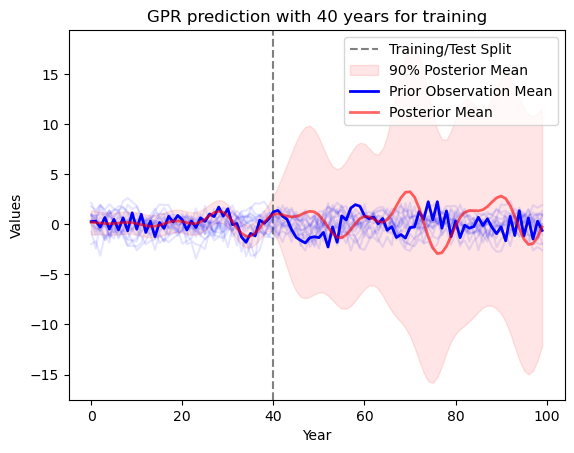

Optimization Progress:   0%|          | 0/200 [00:00<?, ?it/s]

|   iter    |  target   |    c2     |    c3     | linear... | linear... |    ls1    |    ls2    |   noise   |   per1    |   per2    |
-------------------------------------------------------------------------------------------------------------------------------------
|  1        | -1.699e+0 |  1.615    |  1.661    |  9.855    |  9.045    |  1.869    |  2.684    |  0.3341   |  22.89    |  15.03    |
|  2        | -1.855e+0 |  6.389    |  5.84     |  6.188    |  3.678    |  2.589    |  1.952    |  0.5525   |  26.51    |  20.07    |
|  3        | -2.516e+0 |  6.907    |  7.62     |  6.423    |  3.851    |  0.8102   |  8.077    |  0.8115   |  11.02    |  21.89    |
|  4        | -1.619e+0 |  9.686    |  9.864    |  8.198    |  6.899    |  6.236    |  5.996    |  0.6816   |  26.77    |  19.2     |
|  5        | -1.552e+0 |  5.523    |  9.569    |  2.841    |  4.844    |  8.133    |  6.072    |  0.6352   |  18.33    |  25.62    |
|  6        | -1.47e+03 |  3.112    |  7.621    |  4.0      | 

Optimization Progress:   0%|          | 0/200 [00:04<?, ?it/s]

|  99       | -1.604e+0 |  2.318    |  2.744    |  6.068    |  8.306    |  5.615    |  1.473    |  0.3381   |  26.39    |  29.05    |
|  100      | -1.55e+03 |  1.925    |  0.1686   |  0.3147   |  3.488    |  6.512    |  2.878    |  0.1738   |  14.66    |  19.52    |
An error occurred during optimization: 'x0' must only have one dimension.
Best parameters found during the optimization process:  {'c2': 1.1838914536849194, 'c3': 0.8672810255875809, 'linear_sigma_0_1': 3.3286265036613063, 'linear_sigma_0_2': 3.9171365876950697, 'ls1': 4.525450055250312, 'ls2': 6.351656967524147, 'noise': 0.38736922333149115, 'per1': 28.2370308580471, 'per2': 20.79249760882364}
Total log marginal likelihood for best parameters found during the optimization process:  -1356.1923459549416


total_lml_train: -1356.1923459549416
total_lml_test: -1031.521387614389
total_lml_full: -2417.075536352304
best kernel is: 1.09**2 * ExpSineSquared(length_scale=4.53, periodicity=28.2) * DotProduct(sigma_0=3.33) + 0.931**2 * ExpSineSquared(length_scale=6.35, periodicity=20.8) * DotProduct(sigma_0=3.92) + WhiteKernel(noise_level=0.387)
observation_lml_train: -83.23451103182455
observation_lml_test: -79.55257905741767
observation_lml_full: -175.5295245827673


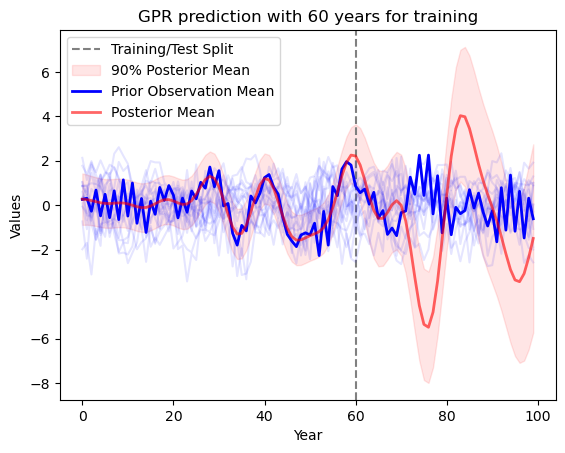

Optimization Progress:   0%|          | 0/200 [00:00<?, ?it/s]

|   iter    |  target   |    c2     |    c3     | linear... | linear... |    ls1    |    ls2    |   noise   |   per1    |   per2    |
-------------------------------------------------------------------------------------------------------------------------------------
|  1        | -2.231e+0 |  1.615    |  1.661    |  9.855    |  9.045    |  1.869    |  2.684    |  0.3341   |  22.89    |  15.03    |
|  2        | -2.355e+0 |  6.389    |  5.84     |  6.188    |  3.678    |  2.589    |  1.952    |  0.5525   |  26.51    |  20.07    |
|  3        | -3.106e+0 |  6.907    |  7.62     |  6.423    |  3.851    |  0.8102   |  8.077    |  0.8115   |  11.02    |  21.89    |
|  4        | -2.118e+0 |  9.686    |  9.864    |  8.198    |  6.899    |  6.236    |  5.996    |  0.6816   |  26.77    |  19.2     |
|  5        | -2.052e+0 |  5.523    |  9.569    |  2.841    |  4.844    |  8.133    |  6.072    |  0.6352   |  18.33    |  25.62    |
|  6        | -1.933e+0 |  3.112    |  7.621    |  4.0      | 

Optimization Progress:   0%|          | 0/200 [00:06<?, ?it/s]

|  100      | -2.447e+0 |  1.925    |  0.1686   |  0.3147   |  3.488    |  6.512    |  2.878    |  0.1738   |  14.66    |  19.52    |
An error occurred during optimization: 'x0' must only have one dimension.
Best parameters found during the optimization process:  {'c2': 1.1838914536849194, 'c3': 0.8672810255875809, 'linear_sigma_0_1': 3.3286265036613063, 'linear_sigma_0_2': 3.9171365876950697, 'ls1': 4.525450055250312, 'ls2': 6.351656967524147, 'noise': 0.38736922333149115, 'per1': 28.2370308580471, 'per2': 20.79249760882364}
Total log marginal likelihood for best parameters found during the optimization process:  -1869.9773249044056


total_lml_train: -1869.9773249044056
total_lml_test: -599.3514855003616
total_lml_full: -2417.075536352304
best kernel is: 1.09**2 * ExpSineSquared(length_scale=4.53, periodicity=28.2) * DotProduct(sigma_0=3.33) + 0.931**2 * ExpSineSquared(length_scale=6.35, periodicity=20.8) * DotProduct(sigma_0=3.92) + WhiteKernel(noise_level=0.387)
observation_lml_train: -130.35583741183314
observation_lml_test: -47.64574298140854
observation_lml_full: -175.5295245827673


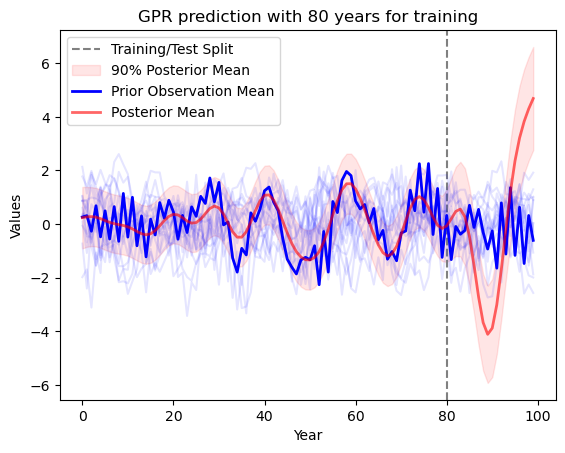

In [74]:
def linearpe2(best_params):
    kernel = (
        C(best_params['c2']) * ExpSineSquared(length_scale=best_params['ls1'], periodicity=best_params['per1']) * DotProduct(sigma_0=best_params['linear_sigma_0_1']) +
        C(best_params['c3']) * ExpSineSquared(length_scale=best_params['ls2'], periodicity=best_params['per2']) * DotProduct(sigma_0=best_params['linear_sigma_0_2']) +
        WhiteKernel(noise_level=best_params['noise'])
    )
    return kernel

pbounds = {
    'c2': (1e-1, 1e1),
    'c3': (1e-1, 1e1),
    'ls1': (1e-2, 1e1),
    'per1': (10, 30),
    'ls2': (1e-2, 1e1),
    'per2': (10, 30),
    'linear_sigma_0_1': (1e-3, 1e1),  # Parameter for the first Linear kernel
    'linear_sigma_0_2': (1e-3, 1e1),  # Parameter for the second Linear kernel
    'noise': (1e-6, 1),
}

gpr_model(mod_ids, 20, rainfall_yearly, pbounds, linearpe2, oos_gcm)
gpr_model(mod_ids, 40, rainfall_yearly, pbounds, linearpe2, oos_gcm)
gpr_model(mod_ids, 60, rainfall_yearly, pbounds, linearpe2, oos_gcm)
gpr_model(mod_ids, 80, rainfall_yearly, pbounds, linearpe2, oos_gcm)


Optimization Progress:   0%|          | 0/200 [00:00<?, ?it/s]

|   iter    |  target   |    c2     |    c3     |    ls1    |    ls2    |   noise   |   per1    |   per2    | poly_s... | poly_s... |
-------------------------------------------------------------------------------------------------------------------------------------
|  1        | -605.0    |  1.615    |  1.661    |  9.856    |  9.055    |  0.1861   |  15.35    |  16.68    |  0.6801   |  0.3263   |
|  2        | -808.9    |  6.389    |  5.84     |  6.226    |  3.741    |  0.2582   |  13.89    |  21.05    |  0.8431   |  0.5531   |
|  3        | -751.6    |  6.907    |  7.62     |  6.459    |  3.912    |  0.0801   |  26.15    |  26.23    |  0.1457   |  0.6348   |
|  4        | -708.1    |  9.686    |  9.864    |  8.216    |  6.93     |  0.6232   |  21.98    |  23.63    |  0.8549   |  0.514    |
|  5        | -816.1    |  5.523    |  9.569    |  2.911    |  4.895    |  0.8131   |  22.14    |  22.7     |  0.475    |  0.8031   |
|  6        | -757.1    |  3.112    |  7.621    |  4.059    | 

Optimization Progress:   0%|          | 0/200 [00:04<?, ?it/s]

|  99       | -751.2    |  2.318    |  2.744    |  6.106    |  8.322    |  0.5611   |  12.93    |  16.76    |  0.8377   |  0.9572   |
|  100      | -1.526e+0 |  1.925    |  0.1686   |  0.4106   |  3.552    |  0.6508   |  15.74    |  13.48    |  0.3097   |  0.5282   |
An error occurred during optimization: 'x0' must only have one dimension.
Best parameters found during the optimization process:  {'c2': 5.153266156675712, 'c3': 5.108156477561731, 'ls1': 7.368436487897758, 'ls2': 9.384895885272904, 'noise': 0.1599745054707214, 'per1': 28.959987802893746, 'per2': 29.601438672081674, 'poly_sigma_0_1': 0.6380801483548729, 'poly_sigma_0_2': 0.19475458948200608}
Total log marginal likelihood for best parameters found during the optimization process:  -587.9559198748144


total_lml_train: -587.9559198748144
total_lml_test: -2642.06349078677
total_lml_full: -3449.740461291032
best kernel is: 2.27**2 * ExpSineSquared(length_scale=7.37, periodicity=29) * DotProduct(sigma_0=0.638) ** 2 + 2.26**2 * ExpSineSquared(length_scale=9.38, periodicity=29.6) * DotProduct(sigma_0=0.195) ** 2 + WhiteKernel(noise_level=0.16) + WhiteKernel(noise_level=1e-10)
observation_lml_train: -48.71100670169057
observation_lml_test: -212.75227970372495
observation_lml_full: -259.9153997523585


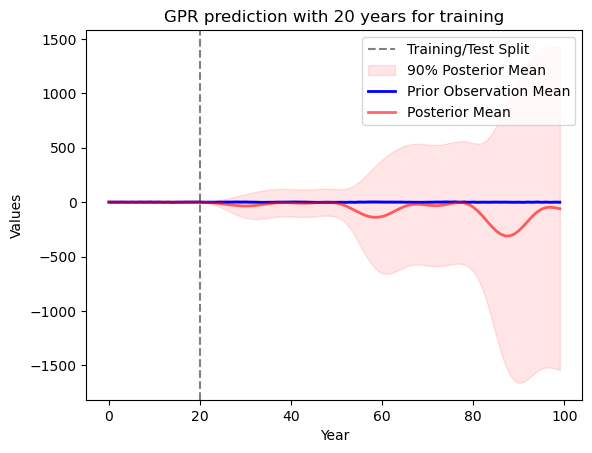

Optimization Progress:   0%|          | 0/200 [00:00<?, ?it/s]

|   iter    |  target   |    c2     |    c3     |    ls1    |    ls2    |   noise   |   per1    |   per2    | poly_s... | poly_s... |
-------------------------------------------------------------------------------------------------------------------------------------
|  1        | -1.277e+0 |  1.615    |  1.661    |  9.856    |  9.055    |  0.1861   |  15.35    |  16.68    |  0.6801   |  0.3263   |
|  2        | -1.665e+0 |  6.389    |  5.84     |  6.226    |  3.741    |  0.2582   |  13.89    |  21.05    |  0.8431   |  0.5531   |
|  3        | -1.528e+0 |  6.907    |  7.62     |  6.459    |  3.912    |  0.0801   |  26.15    |  26.23    |  0.1457   |  0.6348   |
|  4        | -1.428e+0 |  9.686    |  9.864    |  8.216    |  6.93     |  0.6232   |  21.98    |  23.63    |  0.8549   |  0.514    |
|  5        | -1.648e+0 |  5.523    |  9.569    |  2.911    |  4.895    |  0.8131   |  22.14    |  22.7     |  0.475    |  0.8031   |
|  6        | -1.586e+0 |  3.112    |  7.621    |  4.059    | 

Optimization Progress:   0%|          | 0/200 [00:04<?, ?it/s]

|  100      | -3.146e+0 |  1.925    |  0.1686   |  0.4106   |  3.552    |  0.6508   |  15.74    |  13.48    |  0.3097   |  0.5282   |
An error occurred during optimization: 'x0' must only have one dimension.
Best parameters found during the optimization process:  {'c2': 5.153266156675712, 'c3': 5.108156477561731, 'ls1': 7.368436487897758, 'ls2': 9.384895885272904, 'noise': 0.1599745054707214, 'per1': 28.959987802893746, 'per2': 29.601438672081674, 'poly_sigma_0_1': 0.6380801483548729, 'poly_sigma_0_2': 0.19475458948200608}
Total log marginal likelihood for best parameters found during the optimization process:  -1189.1914518629783


total_lml_train: -1189.1914518629783
total_lml_test: -2125.896252479145
total_lml_full: -3449.740461291032
best kernel is: 2.27**2 * ExpSineSquared(length_scale=7.37, periodicity=29) * DotProduct(sigma_0=0.638) ** 2 + 2.26**2 * ExpSineSquared(length_scale=9.38, periodicity=29.6) * DotProduct(sigma_0=0.195) ** 2 + WhiteKernel(noise_level=0.16) + WhiteKernel(noise_level=1e-10)
observation_lml_train: -83.44579327399602
observation_lml_test: -178.17689455290943
observation_lml_full: -259.9153997523585


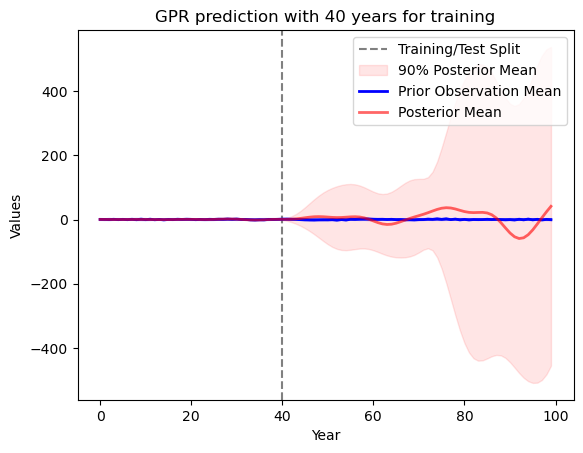

Optimization Progress:   0%|          | 0/200 [00:00<?, ?it/s]

|   iter    |  target   |    c2     |    c3     |    ls1    |    ls2    |   noise   |   per1    |   per2    | poly_s... | poly_s... |
-------------------------------------------------------------------------------------------------------------------------------------
|  1        | -2.121e+0 |  1.615    |  1.661    |  9.856    |  9.055    |  0.1861   |  15.35    |  16.68    |  0.6801   |  0.3263   |
|  2        | -2.412e+0 |  6.389    |  5.84     |  6.226    |  3.741    |  0.2582   |  13.89    |  21.05    |  0.8431   |  0.5531   |
|  3        | -2.293e+0 |  6.907    |  7.62     |  6.459    |  3.912    |  0.0801   |  26.15    |  26.23    |  0.1457   |  0.6348   |
|  4        | -2.148e+0 |  9.686    |  9.864    |  8.216    |  6.93     |  0.6232   |  21.98    |  23.63    |  0.8549   |  0.514    |
|  5        | -2.452e+0 |  5.523    |  9.569    |  2.911    |  4.895    |  0.8131   |  22.14    |  22.7     |  0.475    |  0.8031   |
|  6        | -2.338e+0 |  3.112    |  7.621    |  4.059    | 

Optimization Progress:   0%|          | 0/200 [00:05<?, ?it/s]

|  100      | -4.456e+0 |  1.925    |  0.1686   |  0.4106   |  3.552    |  0.6508   |  15.74    |  13.48    |  0.3097   |  0.5282   |
An error occurred during optimization: 'x0' must only have one dimension.
Best parameters found during the optimization process:  {'c2': 5.153266156675712, 'c3': 5.108156477561731, 'ls1': 7.368436487897758, 'ls2': 9.384895885272904, 'noise': 0.1599745054707214, 'per1': 28.959987802893746, 'per2': 29.601438672081674, 'poly_sigma_0_1': 0.6380801483548729, 'poly_sigma_0_2': 0.19475458948200608}
Total log marginal likelihood for best parameters found during the optimization process:  -1822.5970799043057


total_lml_train: -1822.5970799043057
total_lml_test: -1666.6612994211705
total_lml_full: -3449.740461291032
best kernel is: 2.27**2 * ExpSineSquared(length_scale=7.37, periodicity=29) * DotProduct(sigma_0=0.638) ** 2 + 2.26**2 * ExpSineSquared(length_scale=9.38, periodicity=29.6) * DotProduct(sigma_0=0.195) ** 2 + WhiteKernel(noise_level=0.16) + WhiteKernel(noise_level=1e-10)
observation_lml_train: -122.24615655940028
observation_lml_test: -143.19554478129842
observation_lml_full: -259.9153997523585


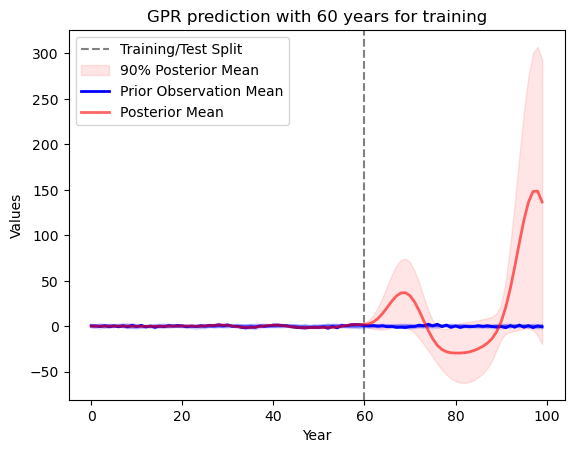

Optimization Progress:   0%|          | 0/200 [00:00<?, ?it/s]

|   iter    |  target   |    c2     |    c3     |    ls1    |    ls2    |   noise   |   per1    |   per2    | poly_s... | poly_s... |
-------------------------------------------------------------------------------------------------------------------------------------
|  1        | -3.022e+0 |  1.615    |  1.661    |  9.856    |  9.055    |  0.1861   |  15.35    |  16.68    |  0.6801   |  0.3263   |
|  2        | -3.164e+0 |  6.389    |  5.84     |  6.226    |  3.741    |  0.2582   |  13.89    |  21.05    |  0.8431   |  0.5531   |
|  3        | -3.19e+03 |  6.907    |  7.62     |  6.459    |  3.912    |  0.0801   |  26.15    |  26.23    |  0.1457   |  0.6348   |
|  4        | -2.863e+0 |  9.686    |  9.864    |  8.216    |  6.93     |  0.6232   |  21.98    |  23.63    |  0.8549   |  0.514    |
|  5        | -3.221e+0 |  5.523    |  9.569    |  2.911    |  4.895    |  0.8131   |  22.14    |  22.7     |  0.475    |  0.8031   |
|  6        | -3.009e+0 |  3.112    |  7.621    |  4.059    | 

Optimization Progress:   0%|          | 0/200 [00:06<?, ?it/s]

An error occurred during optimization: 'x0' must only have one dimension.
Best parameters found during the optimization process:  {'c2': 1.6883907043168316, 'c3': 0.2835994109856088, 'ls1': 2.7876726441024, 'ls2': 8.110014846335313, 'noise': 0.3293708373831191, 'per1': 29.043226783469418, 'per2': 28.651874746742326, 'poly_sigma_0_1': 0.7000797840632729, 'poly_sigma_0_2': 0.13166857847073465}
Total log marginal likelihood for best parameters found during the optimization process:  -2494.8669391258954


total_lml_train: -2494.8669391258954
total_lml_test: -1247.2701319230653
total_lml_full: -3159.959132176653
best kernel is: 1.3**2 * ExpSineSquared(length_scale=2.79, periodicity=29) * DotProduct(sigma_0=0.7) ** 2 + 0.533**2 * ExpSineSquared(length_scale=8.11, periodicity=28.7) * DotProduct(sigma_0=0.132) ** 2 + WhiteKernel(noise_level=0.329) + WhiteKernel(noise_level=1e-10)
observation_lml_train: -163.29422105704376
observation_lml_test: -89.21673325569886
observation_lml_full: -218.59637666819725


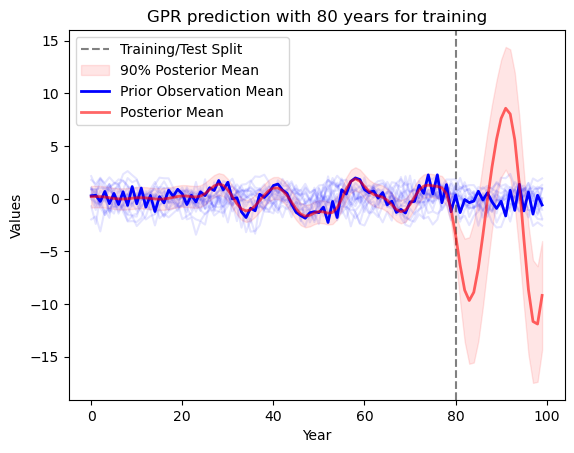

In [83]:
def poly_pe2(best_params):
    kernel = (
        C(best_params['c2']) * ExpSineSquared(length_scale=best_params['ls1'], periodicity=best_params['per1']) *
        DotProduct(sigma_0=best_params['poly_sigma_0_1']) ** 2 +
        
        C(best_params['c3']) * ExpSineSquared(length_scale=best_params['ls2'], periodicity=best_params['per2']) *
        DotProduct(sigma_0=best_params['poly_sigma_0_2']) ** 2 +
        
        WhiteKernel(noise_level=best_params['noise'])+
        WhiteKernel(noise_level=1e-10)  # Add jitter
    )
    return kernel

pbounds = {
    'c2': (1e-1, 1e1),
    'c3': (1e-1, 1e1),
    'ls1': (1e-1, 1e1),
    'per1': (10, 30),
    'ls2': (1e-1, 1e1),
    'per2': (10, 30),
    'poly_sigma_0_1': (1e-1, 1),  # Coefficient offset for the first Polynomial kernel         # Degree for the first Polynomial kernel
    'poly_sigma_0_2': (1e-1, 1),  # Coefficient offset for the second Polynomial kernel       # Degree for the second Polynomial kernel
    'noise': (1e-6, 1),
}

gpr_model(mod_ids, 20, rainfall_yearly, pbounds, poly_pe2, oos_gcm)
gpr_model(mod_ids, 40, rainfall_yearly, pbounds, poly_pe2, oos_gcm)
gpr_model(mod_ids, 60, rainfall_yearly, pbounds, poly_pe2, oos_gcm)
gpr_model(mod_ids, 80, rainfall_yearly, pbounds, poly_pe2, oos_gcm)

Optimization Progress:   0%|          | 0/200 [00:00<?, ?it/s]

|   iter    |  target   |    c2     |    c3     |    ls1    |    ls2    | matern... | matern... | matern... | matern... |   noise   |   per1    |   per2    |
-------------------------------------------------------------------------------------------------------------------------------------------------------------
|  1        | -434.1    |  1.615    |  1.661    |  9.855    |  9.046    |  1.869    |  2.684    |  1.168    |  1.789    |  0.2514   |  22.7     |  21.6     |
|  2        | -464.8    |  6.226    |  3.741    |  2.589    |  1.952    |  5.53     |  8.258    |  1.507    |  1.875    |  0.7595   |  22.85    |  17.7     |
|  3        | -519.5    |  0.893    |  8.094    |  8.117    |  0.5178   |  5.947    |  9.683    |  2.472    |  2.14     |  0.6899   |  22.46    |  21.98    |
|  4        | -511.8    |  6.848    |  8.403    |  4.606    |  5.482    |  9.565    |  2.847    |  1.469    |  2.126    |  0.6068   |  22.7     |  18.33    |
|  5        | -471.9    |  7.834    |  3.112    |  7

Optimization Progress:   0%|          | 0/200 [00:04<?, ?it/s]

|  100      | -527.4    |  7.766    |  5.085    |  2.322    |  5.501    |  6.998    |  2.258    |  1.752    |  1.41     |  0.6146   |  19.57    |  28.03    |
An error occurred during optimization: 'x0' must only have one dimension.
Best parameters found during the optimization process:  {'c2': 1.4638952042350613, 'c3': 1.9412200798696215, 'ls1': 6.393910651781944, 'ls2': 9.067955964987156, 'matern_ls1': 7.618126151250892, 'matern_ls2': 9.412150894382584, 'matern_nu1': 2.0162068598612537, 'matern_nu2': 2.080737731557397, 'noise': 0.3600722049723569, 'per1': 21.35504648056831, 'per2': 25.478535851469147}
Total log marginal likelihood for best parameters found during the optimization process:  -383.99873115977704


total_lml_train: -383.99873115977704
total_lml_test: -1551.6712661442111
total_lml_full: -1926.1271601503768
best kernel is: 1.21**2 * ExpSineSquared(length_scale=6.39, periodicity=21.4) * Matern(length_scale=7.62, nu=2.02) + 1.39**2 * ExpSineSquared(length_scale=9.07, periodicity=25.5) * Matern(length_scale=9.41, nu=2.08) + WhiteKernel(noise_level=0.36)
observation_lml_train: -25.835420207684727
observation_lml_test: -113.37574438529906
observation_lml_full: -138.81250715555177


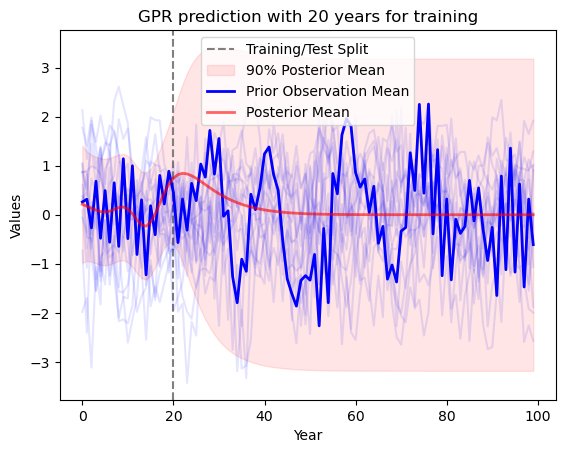

Optimization Progress:   0%|          | 0/200 [00:00<?, ?it/s]

|   iter    |  target   |    c2     |    c3     |    ls1    |    ls2    | matern... | matern... | matern... | matern... |   noise   |   per1    |   per2    |
-------------------------------------------------------------------------------------------------------------------------------------------------------------
|  1        | -869.4    |  1.615    |  1.661    |  9.855    |  9.046    |  1.869    |  2.684    |  1.168    |  1.789    |  0.2514   |  22.7     |  21.6     |
|  2        | -921.1    |  6.226    |  3.741    |  2.589    |  1.952    |  5.53     |  8.258    |  1.507    |  1.875    |  0.7595   |  22.85    |  17.7     |
|  3        | -1.034e+0 |  0.893    |  8.094    |  8.117    |  0.5178   |  5.947    |  9.683    |  2.472    |  2.14     |  0.6899   |  22.46    |  21.98    |
|  4        | -1.015e+0 |  6.848    |  8.403    |  4.606    |  5.482    |  9.565    |  2.847    |  1.469    |  2.126    |  0.6068   |  22.7     |  18.33    |
|  5        | -934.1    |  7.834    |  3.112    |  7

Optimization Progress:   0%|          | 0/200 [00:06<?, ?it/s]

|  99       | -901.4    |  4.5      |  2.507    |  3.775    |  4.509    |  8.418    |  8.25     |  2.066    |  1.453    |  0.9642   |  11.28    |  22.41    |
|  100      | -1.048e+0 |  7.766    |  5.085    |  2.322    |  5.501    |  6.998    |  2.258    |  1.752    |  1.41     |  0.6146   |  19.57    |  28.03    |
An error occurred during optimization: 'x0' must only have one dimension.
Best parameters found during the optimization process:  {'c2': 1.4638952042350613, 'c3': 1.9412200798696215, 'ls1': 6.393910651781944, 'ls2': 9.067955964987156, 'matern_ls1': 7.618126151250892, 'matern_ls2': 9.412150894382584, 'matern_nu1': 2.0162068598612537, 'matern_nu2': 2.080737731557397, 'noise': 0.3600722049723569, 'per1': 21.35504648056831, 'per2': 25.478535851469147}
Total log marginal likelihood for best parameters found during the optimization process:  -764.701748954238


total_lml_train: -764.701748954238
total_lml_test: -1164.538416559861
total_lml_full: -1926.1271601503768
best kernel is: 1.21**2 * ExpSineSquared(length_scale=6.39, periodicity=21.4) * Matern(length_scale=7.62, nu=2.02) + 1.39**2 * ExpSineSquared(length_scale=9.07, periodicity=25.5) * Matern(length_scale=9.41, nu=2.08) + WhiteKernel(noise_level=0.36)
observation_lml_train: -49.76519028441032
observation_lml_test: -89.13502932746277
observation_lml_full: -138.81250715555177


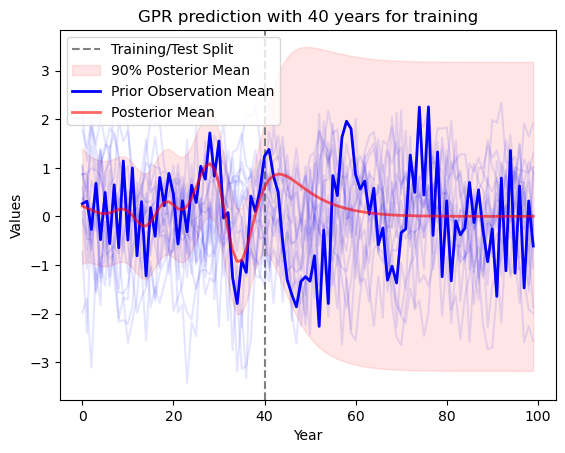

Optimization Progress:   0%|          | 0/200 [00:00<?, ?it/s]

|   iter    |  target   |    c2     |    c3     |    ls1    |    ls2    | matern... | matern... | matern... | matern... |   noise   |   per1    |   per2    |
-------------------------------------------------------------------------------------------------------------------------------------------------------------
|  1        | -1.314e+0 |  1.615    |  1.661    |  9.855    |  9.046    |  1.869    |  2.684    |  1.168    |  1.789    |  0.2514   |  22.7     |  21.6     |
|  2        | -1.382e+0 |  6.226    |  3.741    |  2.589    |  1.952    |  5.53     |  8.258    |  1.507    |  1.875    |  0.7595   |  22.85    |  17.7     |
|  3        | -1.554e+0 |  0.893    |  8.094    |  8.117    |  0.5178   |  5.947    |  9.683    |  2.472    |  2.14     |  0.6899   |  22.46    |  21.98    |
|  4        | -1.525e+0 |  6.848    |  8.403    |  4.606    |  5.482    |  9.565    |  2.847    |  1.469    |  2.126    |  0.6068   |  22.7     |  18.33    |
|  5        | -1.4e+03  |  7.834    |  3.112    |  7

Optimization Progress:   0%|          | 0/200 [00:10<?, ?it/s]

|  100      | -1.573e+0 |  7.766    |  5.085    |  2.322    |  5.501    |  6.998    |  2.258    |  1.752    |  1.41     |  0.6146   |  19.57    |  28.03    |
An error occurred during optimization: 'x0' must only have one dimension.
Best parameters found during the optimization process:  {'c2': 1.4638952042350613, 'c3': 1.9412200798696215, 'ls1': 6.393910651781944, 'ls2': 9.067955964987156, 'matern_ls1': 7.618126151250892, 'matern_ls2': 9.412150894382584, 'matern_nu1': 2.0162068598612537, 'matern_nu2': 2.080737731557397, 'noise': 0.3600722049723569, 'per1': 21.35504648056831, 'per2': 25.478535851469147}
Total log marginal likelihood for best parameters found during the optimization process:  -1155.2504429834737


total_lml_train: -1155.2504429834737
total_lml_test: -772.9436010286179
total_lml_full: -1926.1271601503768
best kernel is: 1.21**2 * ExpSineSquared(length_scale=6.39, periodicity=21.4) * Matern(length_scale=7.62, nu=2.02) + 1.39**2 * ExpSineSquared(length_scale=9.07, periodicity=25.5) * Matern(length_scale=9.41, nu=2.08) + WhiteKernel(noise_level=0.36)
observation_lml_train: -75.9413228351222
observation_lml_test: -62.814420602814174
observation_lml_full: -138.81250715555177


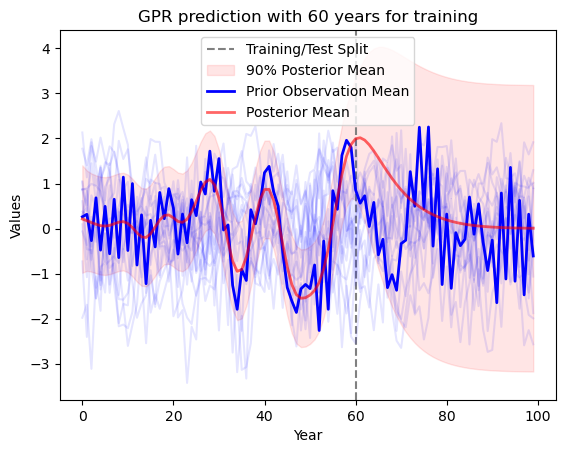

Optimization Progress:   0%|          | 0/200 [00:00<?, ?it/s]

|   iter    |  target   |    c2     |    c3     |    ls1    |    ls2    | matern... | matern... | matern... | matern... |   noise   |   per1    |   per2    |
-------------------------------------------------------------------------------------------------------------------------------------------------------------
|  1        | -1.755e+0 |  1.615    |  1.661    |  9.855    |  9.046    |  1.869    |  2.684    |  1.168    |  1.789    |  0.2514   |  22.7     |  21.6     |
|  2        | -1.841e+0 |  6.226    |  3.741    |  2.589    |  1.952    |  5.53     |  8.258    |  1.507    |  1.875    |  0.7595   |  22.85    |  17.7     |
|  3        | -2.071e+0 |  0.893    |  8.094    |  8.117    |  0.5178   |  5.947    |  9.683    |  2.472    |  2.14     |  0.6899   |  22.46    |  21.98    |
|  4        | -2.032e+0 |  6.848    |  8.403    |  4.606    |  5.482    |  9.565    |  2.847    |  1.469    |  2.126    |  0.6068   |  22.7     |  18.33    |
|  5        | -1.865e+0 |  7.834    |  3.112    |  7

Optimization Progress:   0%|          | 0/200 [00:17<?, ?it/s]

Total log marginal likelihood for best parameters found during the optimization process:  -1543.6424660209052


total_lml_train: -1543.6424660209052
total_lml_test: -399.8265554511392
total_lml_full: -1926.97695960331
best kernel is: 1.33**2 * ExpSineSquared(length_scale=3.91, periodicity=16.6) * Matern(length_scale=6.62, nu=1.23) + 2.45**2 * ExpSineSquared(length_scale=7.03, periodicity=20.1) * Matern(length_scale=8.57, nu=2.49) + WhiteKernel(noise_level=0.312)
observation_lml_train: -109.63721637922716
observation_lml_test: -36.347653794794006
observation_lml_full: -145.07666378324322


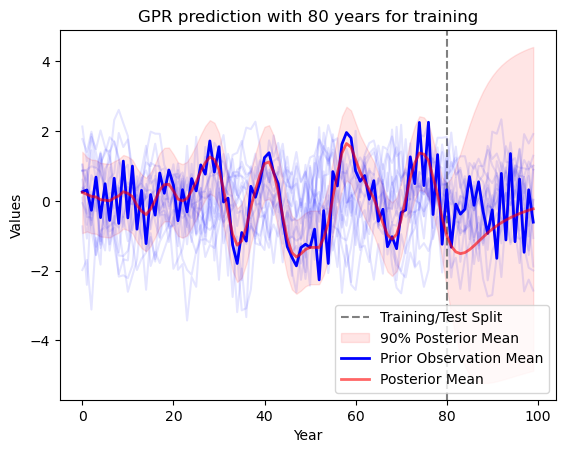

In [84]:
def maternpe2_kernel(best_params):
    kernel = (
        C(best_params['c2']) * ExpSineSquared(length_scale=best_params['ls1'], periodicity=best_params['per1']) * Matern(length_scale=best_params['matern_ls1'], nu=best_params['matern_nu1']) +
        C(best_params['c3']) * ExpSineSquared(length_scale=best_params['ls2'], periodicity=best_params['per2']) * Matern(length_scale=best_params['matern_ls2'], nu=best_params['matern_nu2']) +
        WhiteKernel(noise_level=best_params['noise'])
    )
    return kernel

pbounds = {
    'c2': (1e-1, 1e1),
    'c3': (1e-1, 1e1),
    'ls1': (1e-2, 1e1),
    'per1': (10, 30),
    'ls2': (1e-2, 1e1),
    'per2': (10, 30),
    'matern_ls1': (1e-2, 1e1),  # Length scale for the first Matern kernel
    'matern_nu1': (0.5, 2.5),   # Nu for the first Matern kernel
    'matern_ls2': (1e-2, 1e1),  # Length scale for the second Matern kernel
    'matern_nu2': (0.5, 2.5),   # Nu for the second Matern kernel
    'noise': (1e-6, 1),
}

gpr_model(mod_ids, 20, rainfall_yearly, pbounds, maternpe2_kernel, oos_gcm)
gpr_model(mod_ids, 40, rainfall_yearly, pbounds, maternpe2_kernel, oos_gcm)
gpr_model(mod_ids, 60, rainfall_yearly, pbounds, maternpe2_kernel, oos_gcm)
gpr_model(mod_ids, 80, rainfall_yearly, pbounds, maternpe2_kernel, oos_gcm)


Optimization Progress:   0%|          | 0/200 [00:00<?, ?it/s]

|   iter    |  target   |    c2     |    c3     |    ls1    |    ls2    |   noise   |   per1    |   per2    | rq_alpha1 | rq_alpha2 |  rq_ls1   |  rq_ls2   |
-------------------------------------------------------------------------------------------------------------------------------------------------------------
|  1        | -498.2    |  0.2377   |  0.2419   |  9.855    |  9.046    |  0.1861   |  15.35    |  16.68    |  6.449    |  2.522    |  6.356    |  5.802    |
|  2        | -385.8    |  0.6569   |  0.431    |  2.589    |  1.952    |  0.5525   |  26.51    |  20.07    |  6.879    |  7.598    |  6.427    |  3.856    |
|  3        | -383.5    |  0.1721   |  0.8267   |  8.117    |  0.5178   |  0.5943   |  29.37    |  29.72    |  8.2      |  6.902    |  6.236    |  5.996    |
|  4        | -426.6    |  0.7134   |  0.8549   |  4.606    |  5.482    |  0.9565   |  15.68    |  19.69    |  8.133    |  6.072    |  6.355    |  4.173    |
|  5        | -432.9    |  0.8031   |  0.3738   |  7

Optimization Progress:   0%|          | 0/200 [00:04<?, ?it/s]

An error occurred during optimization: 'x0' must only have one dimension.
Best parameters found during the optimization process:  {'c2': 0.7925437541699353, 'c3': 0.5126504033914611, 'ls1': 3.0028860358038116, 'ls2': 8.406421321474987, 'noise': 0.2436504298293413, 'per1': 20.371446461259573, 'per2': 26.45129793139758, 'rq_alpha1': 9.101991423215521, 'rq_alpha2': 1.481977353100019, 'rq_ls1': 3.4909781196484353, 'rq_ls2': 5.156370800479601}
Total log marginal likelihood for best parameters found during the optimization process:  -344.3643560077947


total_lml_train: -344.3643560077947
total_lml_test: -1433.9602025955382
total_lml_full: -1771.2308171259315
best kernel is: 0.89**2 * ExpSineSquared(length_scale=3, periodicity=20.4) * RationalQuadratic(alpha=9.1, length_scale=3.49) + 0.716**2 * ExpSineSquared(length_scale=8.41, periodicity=26.5) * RationalQuadratic(alpha=1.48, length_scale=5.16) + WhiteKernel(noise_level=0.244)
observation_lml_train: -26.677496666326455
observation_lml_test: -115.36188458769692
observation_lml_full: -141.79728040585985


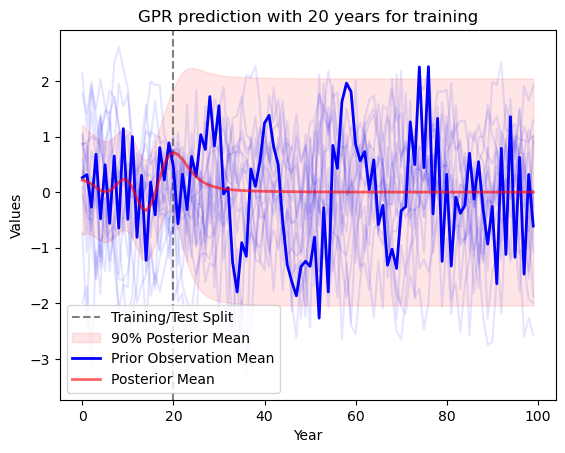

Optimization Progress:   0%|          | 0/200 [00:00<?, ?it/s]

|   iter    |  target   |    c2     |    c3     |    ls1    |    ls2    |   noise   |   per1    |   per2    | rq_alpha1 | rq_alpha2 |  rq_ls1   |  rq_ls2   |
-------------------------------------------------------------------------------------------------------------------------------------------------------------
|  1        | -1.005e+0 |  0.2377   |  0.2419   |  9.855    |  9.046    |  0.1861   |  15.35    |  16.68    |  6.449    |  2.522    |  6.356    |  5.802    |
|  2        | -769.2    |  0.6569   |  0.431    |  2.589    |  1.952    |  0.5525   |  26.51    |  20.07    |  6.879    |  7.598    |  6.427    |  3.856    |
|  3        | -765.9    |  0.1721   |  0.8267   |  8.117    |  0.5178   |  0.5943   |  29.37    |  29.72    |  8.2      |  6.902    |  6.236    |  5.996    |
|  4        | -848.9    |  0.7134   |  0.8549   |  4.606    |  5.482    |  0.9565   |  15.68    |  19.69    |  8.133    |  6.072    |  6.355    |  4.173    |
|  5        | -861.5    |  0.8031   |  0.3738   |  7

Optimization Progress:   0%|          | 0/200 [00:04<?, ?it/s]

An error occurred during optimization: 'x0' must only have one dimension.
Best parameters found during the optimization process:  {'c2': 0.7925437541699353, 'c3': 0.5126504033914611, 'ls1': 3.0028860358038116, 'ls2': 8.406421321474987, 'noise': 0.2436504298293413, 'per1': 20.371446461259573, 'per2': 26.45129793139758, 'rq_alpha1': 9.101991423215521, 'rq_alpha2': 1.481977353100019, 'rq_ls1': 3.4909781196484353, 'rq_ls2': 5.156370800479601}
Total log marginal likelihood for best parameters found during the optimization process:  -695.3105975284847


total_lml_train: -695.3105975284847
total_lml_test: -1081.7729473766751
total_lml_full: -1771.2308171259315
best kernel is: 0.89**2 * ExpSineSquared(length_scale=3, periodicity=20.4) * RationalQuadratic(alpha=9.1, length_scale=3.49) + 0.716**2 * ExpSineSquared(length_scale=8.41, periodicity=26.5) * RationalQuadratic(alpha=1.48, length_scale=5.16) + WhiteKernel(noise_level=0.244)
observation_lml_train: -48.31278696048562
observation_lml_test: -94.11949975847543
observation_lml_full: -141.79728040585985


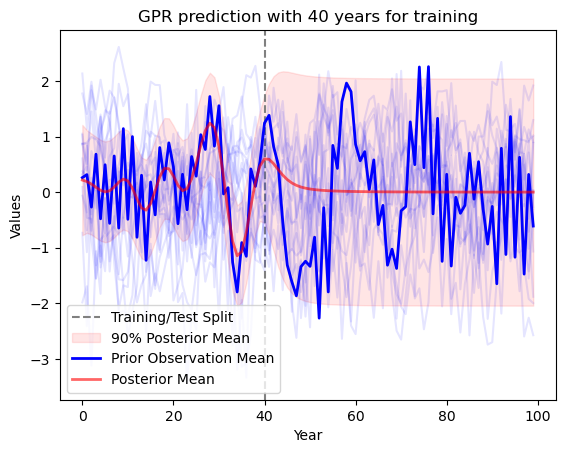

Optimization Progress:   0%|          | 0/200 [00:00<?, ?it/s]

|   iter    |  target   |    c2     |    c3     |    ls1    |    ls2    |   noise   |   per1    |   per2    | rq_alpha1 | rq_alpha2 |  rq_ls1   |  rq_ls2   |
-------------------------------------------------------------------------------------------------------------------------------------------------------------
|  1        | -1.547e+0 |  0.2377   |  0.2419   |  9.855    |  9.046    |  0.1861   |  15.35    |  16.68    |  6.449    |  2.522    |  6.356    |  5.802    |
|  2        | -1.16e+03 |  0.6569   |  0.431    |  2.589    |  1.952    |  0.5525   |  26.51    |  20.07    |  6.879    |  7.598    |  6.427    |  3.856    |
|  3        | -1.155e+0 |  0.1721   |  0.8267   |  8.117    |  0.5178   |  0.5943   |  29.37    |  29.72    |  8.2      |  6.902    |  6.236    |  5.996    |
|  4        | -1.276e+0 |  0.7134   |  0.8549   |  4.606    |  5.482    |  0.9565   |  15.68    |  19.69    |  8.133    |  6.072    |  6.355    |  4.173    |
|  5        | -1.303e+0 |  0.8031   |  0.3738   |  7

Optimization Progress:   0%|          | 0/200 [00:04<?, ?it/s]

|  99       | -1.341e+0 |  0.5      |  0.3188   |  3.775    |  4.509    |  0.8417   |  26.5     |  25.66    |  4.77     |  9.642    |  0.6513   |  6.207    |
|  100      | -1.207e+0 |  0.7969   |  0.5531   |  2.322    |  5.501    |  0.6995   |  14.5     |  22.52    |  4.557    |  6.149    |  4.788    |  9.017    |
An error occurred during optimization: 'x0' must only have one dimension.
Best parameters found during the optimization process:  {'c2': 0.7925437541699353, 'c3': 0.5126504033914611, 'ls1': 3.0028860358038116, 'ls2': 8.406421321474987, 'noise': 0.2436504298293413, 'per1': 20.371446461259573, 'per2': 26.45129793139758, 'rq_alpha1': 9.101991423215521, 'rq_alpha2': 1.481977353100019, 'rq_ls1': 3.4909781196484353, 'rq_ls2': 5.156370800479601}
Total log marginal likelihood for best parameters found during the optimization process:  -1058.4907261561852


total_lml_train: -1058.4907261561852
total_lml_test: -717.1191352704784
total_lml_full: -1771.2308171259315
best kernel is: 0.89**2 * ExpSineSquared(length_scale=3, periodicity=20.4) * RationalQuadratic(alpha=9.1, length_scale=3.49) + 0.716**2 * ExpSineSquared(length_scale=8.41, periodicity=26.5) * RationalQuadratic(alpha=1.48, length_scale=5.16) + WhiteKernel(noise_level=0.244)
observation_lml_train: -73.93627328488766
observation_lml_test: -67.77724491515048
observation_lml_full: -141.79728040585985


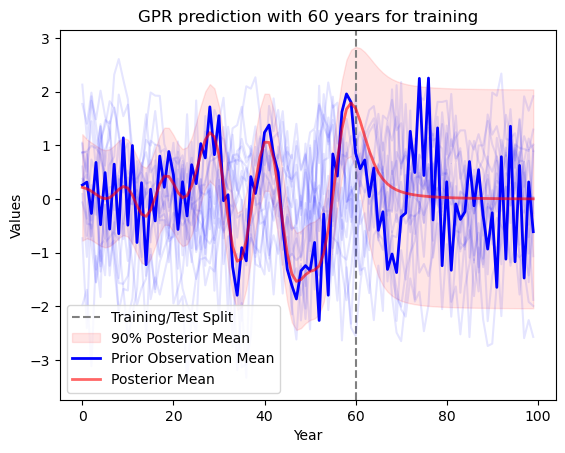

Optimization Progress:   0%|          | 0/200 [00:00<?, ?it/s]

|   iter    |  target   |    c2     |    c3     |    ls1    |    ls2    |   noise   |   per1    |   per2    | rq_alpha1 | rq_alpha2 |  rq_ls1   |  rq_ls2   |
-------------------------------------------------------------------------------------------------------------------------------------------------------------
|  1        | -2.086e+0 |  0.2377   |  0.2419   |  9.855    |  9.046    |  0.1861   |  15.35    |  16.68    |  6.449    |  2.522    |  6.356    |  5.802    |
|  2        | -1.55e+03 |  0.6569   |  0.431    |  2.589    |  1.952    |  0.5525   |  26.51    |  20.07    |  6.879    |  7.598    |  6.427    |  3.856    |
|  3        | -1.542e+0 |  0.1721   |  0.8267   |  8.117    |  0.5178   |  0.5943   |  29.37    |  29.72    |  8.2      |  6.902    |  6.236    |  5.996    |
|  4        | -1.703e+0 |  0.7134   |  0.8549   |  4.606    |  5.482    |  0.9565   |  15.68    |  19.69    |  8.133    |  6.072    |  6.355    |  4.173    |
|  5        | -1.743e+0 |  0.8031   |  0.3738   |  7

Optimization Progress:   0%|          | 0/200 [00:06<?, ?it/s]

Total log marginal likelihood for best parameters found during the optimization process:  -1419.0852811645034


total_lml_train: -1419.0852811645034
total_lml_test: -363.1593766144352
total_lml_full: -1771.2308171259315
best kernel is: 0.89**2 * ExpSineSquared(length_scale=3, periodicity=20.4) * RationalQuadratic(alpha=9.1, length_scale=3.49) + 0.716**2 * ExpSineSquared(length_scale=8.41, periodicity=26.5) * RationalQuadratic(alpha=1.48, length_scale=5.16) + WhiteKernel(noise_level=0.244)
observation_lml_train: -105.76623130945048
observation_lml_test: -36.795842539531904
observation_lml_full: -141.79728040585985


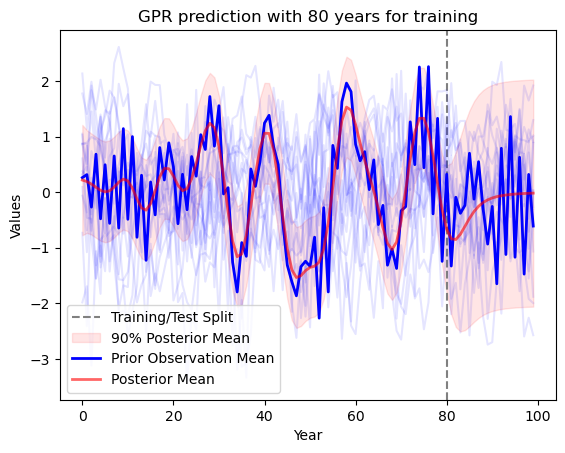

In [86]:
def rqpe2(best_params):
    kernel = (
        C(best_params['c2']) * ExpSineSquared(length_scale=best_params['ls1'], periodicity=best_params['per1']) * RationalQuadratic(length_scale=best_params['rq_ls1'], alpha=best_params['rq_alpha1']) +
        C(best_params['c3']) * ExpSineSquared(length_scale=best_params['ls2'], periodicity=best_params['per2']) * RationalQuadratic(length_scale=best_params['rq_ls2'], alpha=best_params['rq_alpha2']) +
        WhiteKernel(noise_level=best_params['noise'])
    )
    return kernel

pbounds = {
    'c2': (1e-1, 1),
    'c3': (1e-1, 1),
    'ls1': (1e-2, 1e1),
    'per1': (10, 30),
    'ls2': (1e-2, 1e1),
    'per2': (10, 30),
    'rq_ls1': (1e-2, 1e1),
    'rq_alpha1': (1e-2, 1e1),
    'rq_ls2': (1e-2, 1e1),
    'rq_alpha2': (1e-2, 1e1),
    'noise': (1e-6, 1),
}

gpr_model(mod_ids, 20, rainfall_yearly, pbounds, rqpe2, oos_gcm)
gpr_model(mod_ids, 40, rainfall_yearly, pbounds, rqpe2, oos_gcm)
gpr_model(mod_ids, 60, rainfall_yearly, pbounds, rqpe2, oos_gcm)
gpr_model(mod_ids, 80, rainfall_yearly, pbounds, rqpe2, oos_gcm)

Optimization Progress:   0%|          | 0/200 [00:00<?, ?it/s]

|   iter    |  target   |    c2     |    c3     |  exp_ls1  |  exp_ls2  |    ls1    |    ls2    |   noise   |   per1    |   per2    |
-------------------------------------------------------------------------------------------------------------------------------------
|  1        | -405.8    |  1.615    |  1.661    |  9.855    |  9.046    |  1.869    |  2.684    |  0.3341   |  22.89    |  15.03    |
|  2        | -583.6    |  6.389    |  5.84     |  6.192    |  3.684    |  2.589    |  1.952    |  0.5525   |  26.51    |  20.07    |
|  3        | -645.5    |  6.907    |  7.62     |  6.427    |  3.856    |  0.8102   |  8.077    |  0.8115   |  11.02    |  21.89    |
|  4        | -600.4    |  9.686    |  9.864    |  8.2      |  6.902    |  6.236    |  5.996    |  0.6816   |  26.77    |  19.2     |
|  5        | -626.1    |  5.523    |  9.569    |  2.847    |  4.849    |  8.133    |  6.072    |  0.6352   |  18.33    |  25.62    |
|  6        | -547.0    |  3.112    |  7.621    |  4.005    | 

Optimization Progress:   0%|          | 0/200 [00:04<?, ?it/s]

|  100      | -489.2    |  1.925    |  0.1686   |  0.3234   |  3.493    |  6.512    |  2.878    |  0.1738   |  14.66    |  19.52    |
An error occurred during optimization: 'x0' must only have one dimension.
Best parameters found during the optimization process:  {'c2': 1.6152365677848544, 'c3': 1.6610880439931324, 'exp_ls1': 9.855056230689694, 'exp_ls2': 9.045932330744884, 'ls1': 1.8689218440437394, 'ls2': 2.684418048987485, 'noise': 0.33405182343722156, 'per1': 22.89183741865049, 'per2': 15.028144815158127}
Total log marginal likelihood for best parameters found during the optimization process:  -405.75911932728684


total_lml_train: -405.75911932728684
total_lml_test: -1635.5821033820464
total_lml_full: -2033.348729215802
best kernel is: 1.27**2 * ExpSineSquared(length_scale=1.87, periodicity=22.9) * Matern(length_scale=9.86, nu=0.5) + 1.29**2 * ExpSineSquared(length_scale=2.68, periodicity=15) * Matern(length_scale=9.05, nu=0.5) + WhiteKernel(noise_level=0.334)
observation_lml_train: -27.961827894249467
observation_lml_test: -114.30709397878971
observation_lml_full: -141.79613551595907


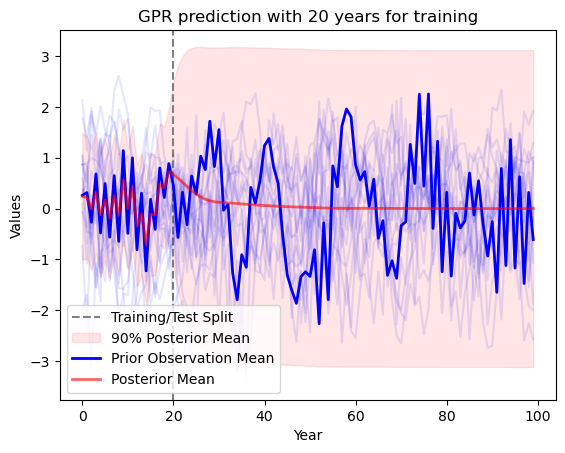

Optimization Progress:   0%|          | 0/200 [00:00<?, ?it/s]

|   iter    |  target   |    c2     |    c3     |  exp_ls1  |  exp_ls2  |    ls1    |    ls2    |   noise   |   per1    |   per2    |
-------------------------------------------------------------------------------------------------------------------------------------
|  1        | -809.0    |  1.615    |  1.661    |  9.855    |  9.046    |  1.869    |  2.684    |  0.3341   |  22.89    |  15.03    |
|  2        | -1.162e+0 |  6.389    |  5.84     |  6.192    |  3.684    |  2.589    |  1.952    |  0.5525   |  26.51    |  20.07    |
|  3        | -1.287e+0 |  6.907    |  7.62     |  6.427    |  3.856    |  0.8102   |  8.077    |  0.8115   |  11.02    |  21.89    |
|  4        | -1.192e+0 |  9.686    |  9.864    |  8.2      |  6.902    |  6.236    |  5.996    |  0.6816   |  26.77    |  19.2     |
|  5        | -1.247e+0 |  5.523    |  9.569    |  2.847    |  4.849    |  8.133    |  6.072    |  0.6352   |  18.33    |  25.62    |
|  6        | -1.088e+0 |  3.112    |  7.621    |  4.005    | 

Optimization Progress:   0%|          | 0/200 [00:04<?, ?it/s]

|  100      | -973.9    |  1.925    |  0.1686   |  0.3234   |  3.493    |  6.512    |  2.878    |  0.1738   |  14.66    |  19.52    |
An error occurred during optimization: 'x0' must only have one dimension.
Best parameters found during the optimization process:  {'c2': 1.6152365677848544, 'c3': 1.6610880439931324, 'exp_ls1': 9.855056230689694, 'exp_ls2': 9.045932330744884, 'ls1': 1.8689218440437394, 'ls2': 2.684418048987485, 'noise': 0.33405182343722156, 'per1': 22.89183741865049, 'per2': 15.028144815158127}
Total log marginal likelihood for best parameters found during the optimization process:  -808.9899004565789


total_lml_train: -808.9899004565789
total_lml_test: -1231.8867450898565
total_lml_full: -2033.348729215802
best kernel is: 1.27**2 * ExpSineSquared(length_scale=1.87, periodicity=22.9) * Matern(length_scale=9.86, nu=0.5) + 1.29**2 * ExpSineSquared(length_scale=2.68, periodicity=15) * Matern(length_scale=9.05, nu=0.5) + WhiteKernel(noise_level=0.334)
observation_lml_train: -52.90275127833373
observation_lml_test: -89.45781742367046
observation_lml_full: -141.79613551595907


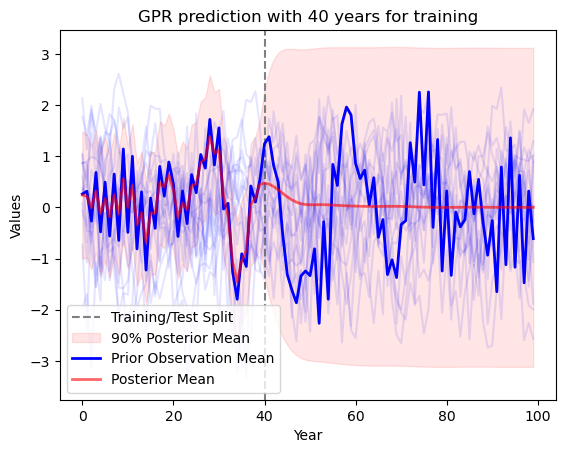

Optimization Progress:   0%|          | 0/200 [00:00<?, ?it/s]

|   iter    |  target   |    c2     |    c3     |  exp_ls1  |  exp_ls2  |    ls1    |    ls2    |   noise   |   per1    |   per2    |
-------------------------------------------------------------------------------------------------------------------------------------
|  1        | -1.219e+0 |  1.615    |  1.661    |  9.855    |  9.046    |  1.869    |  2.684    |  0.3341   |  22.89    |  15.03    |
|  2        | -1.742e+0 |  6.389    |  5.84     |  6.192    |  3.684    |  2.589    |  1.952    |  0.5525   |  26.51    |  20.07    |
|  3        | -1.929e+0 |  6.907    |  7.62     |  6.427    |  3.856    |  0.8102   |  8.077    |  0.8115   |  11.02    |  21.89    |
|  4        | -1.786e+0 |  9.686    |  9.864    |  8.2      |  6.902    |  6.236    |  5.996    |  0.6816   |  26.77    |  19.2     |
|  5        | -1.869e+0 |  5.523    |  9.569    |  2.847    |  4.849    |  8.133    |  6.072    |  0.6352   |  18.33    |  25.62    |
|  6        | -1.631e+0 |  3.112    |  7.621    |  4.005    | 

Optimization Progress:   0%|          | 0/200 [00:04<?, ?it/s]

|  98       | -1.55e+03 |  7.442    |  2.636    |  9.347    |  6.001    |  8.402    |  4.621    |  0.6393   |  16.37    |  24.49    |
|  99       | -1.344e+0 |  2.318    |  2.744    |  6.071    |  8.307    |  5.615    |  1.473    |  0.3381   |  26.39    |  29.05    |
|  100      | -1.462e+0 |  1.925    |  0.1686   |  0.3234   |  3.493    |  6.512    |  2.878    |  0.1738   |  14.66    |  19.52    |
An error occurred during optimization: 'x0' must only have one dimension.
Best parameters found during the optimization process:  {'c2': 1.6152365677848544, 'c3': 1.6610880439931324, 'exp_ls1': 9.855056230689694, 'exp_ls2': 9.045932330744884, 'ls1': 1.8689218440437394, 'ls2': 2.684418048987485, 'noise': 0.33405182343722156, 'per1': 22.89183741865049, 'per2': 15.028144815158127}
Total log marginal likelihood for best parameters found during the optimization process:  -1219.241697546989


total_lml_train: -1219.241697546989
total_lml_test: -821.4233326169427
total_lml_full: -2033.348729215802
best kernel is: 1.27**2 * ExpSineSquared(length_scale=1.87, periodicity=22.9) * Matern(length_scale=9.86, nu=0.5) + 1.29**2 * ExpSineSquared(length_scale=2.68, periodicity=15) * Matern(length_scale=9.05, nu=0.5) + WhiteKernel(noise_level=0.334)
observation_lml_train: -79.93224909000499
observation_lml_test: -62.359350373860224
observation_lml_full: -141.79613551595907


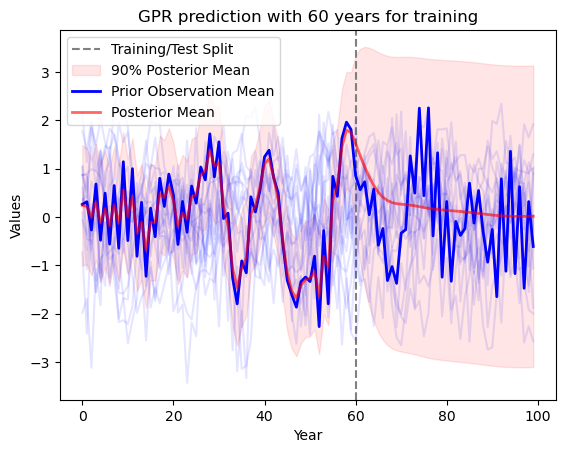

Optimization Progress:   0%|          | 0/200 [00:00<?, ?it/s]

|   iter    |  target   |    c2     |    c3     |  exp_ls1  |  exp_ls2  |    ls1    |    ls2    |   noise   |   per1    |   per2    |
-------------------------------------------------------------------------------------------------------------------------------------
|  1        | -1.627e+0 |  1.615    |  1.661    |  9.855    |  9.046    |  1.869    |  2.684    |  0.3341   |  22.89    |  15.03    |
|  2        | -2.322e+0 |  6.389    |  5.84     |  6.192    |  3.684    |  2.589    |  1.952    |  0.5525   |  26.51    |  20.07    |
|  3        | -2.571e+0 |  6.907    |  7.62     |  6.427    |  3.856    |  0.8102   |  8.077    |  0.8115   |  11.02    |  21.89    |
|  4        | -2.38e+03 |  9.686    |  9.864    |  8.2      |  6.902    |  6.236    |  5.996    |  0.6816   |  26.77    |  19.2     |
|  5        | -2.491e+0 |  5.523    |  9.569    |  2.847    |  4.849    |  8.133    |  6.072    |  0.6352   |  18.33    |  25.62    |
|  6        | -2.174e+0 |  3.112    |  7.621    |  4.005    | 

Optimization Progress:   0%|          | 0/200 [00:06<?, ?it/s]


total_lml_train: -1627.3797453387483
total_lml_test: -414.5066905851942
total_lml_full: -2033.348729215802
best kernel is: 1.27**2 * ExpSineSquared(length_scale=1.87, periodicity=22.9) * Matern(length_scale=9.86, nu=0.5) + 1.29**2 * ExpSineSquared(length_scale=2.68, periodicity=15) * Matern(length_scale=9.05, nu=0.5) + WhiteKernel(noise_level=0.334)
observation_lml_train: -109.7660459729737
observation_lml_test: -32.40309298579925
observation_lml_full: -141.79613551595907


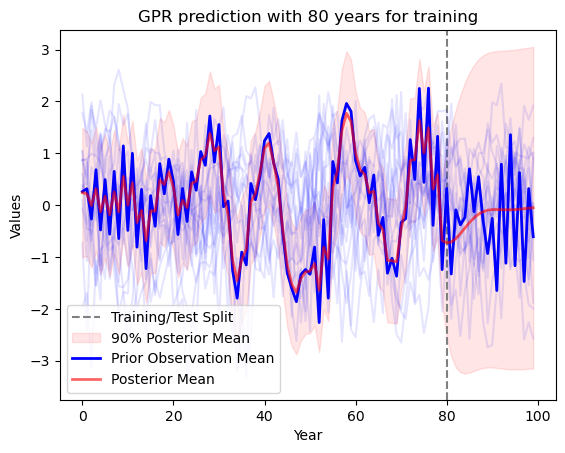

In [89]:
def exponentialpe2(best_params):
    kernel = (
        C(best_params['c2']) * ExpSineSquared(length_scale=best_params['ls1'], periodicity=best_params['per1']) * Matern(length_scale=best_params['exp_ls1'], nu=0.5) +
        C(best_params['c3']) * ExpSineSquared(length_scale=best_params['ls2'], periodicity=best_params['per2']) * Matern(length_scale=best_params['exp_ls2'], nu=0.5) +
        WhiteKernel(noise_level=best_params['noise'])
    )
    return kernel

pbounds = {
    'c2': (1e-1, 1e1),
    'c3': (1e-1, 1e1),
    'ls1': (1e-2, 1e1),
    'per1': (10, 30),
    'ls2': (1e-2, 1e1),
    'per2': (10, 30),
    'exp_ls1': (1e-2, 1e1),  # Length scale for the first Exponential (Matern with nu=0.5) kernel
    'exp_ls2': (1e-2, 1e1),  # Length scale for the second Exponential (Matern with nu=0.5) kernel
    'noise': (1e-6, 1),
}
gpr_model(mod_ids, 20, rainfall_yearly, pbounds, exponentialpe2, oos_gcm)
gpr_model(mod_ids, 40, rainfall_yearly, pbounds, exponentialpe2, oos_gcm)
gpr_model(mod_ids, 60, rainfall_yearly, pbounds, exponentialpe2, oos_gcm)
gpr_model(mod_ids, 80, rainfall_yearly, pbounds, exponentialpe2, oos_gcm)

### 3 periods

Optimization Progress:   0%|          | 0/200 [00:00<?, ?it/s]

|   iter    |  target   |    c2     |    c3     |    c4     |    ls1    |    ls2    |    ls3    |   noise   |   per1    |   per2    |   per3    |
-------------------------------------------------------------------------------------------------------------------------------------------------
|  1        | -381.7    |  1.615    |  1.661    |  9.856    |  9.046    |  1.869    |  2.684    |  0.3341   |  22.89    |  15.03    |  22.7     |
|  2        | -443.4    |  5.84     |  6.226    |  3.741    |  2.589    |  1.952    |  5.53     |  0.8256   |  20.07    |  23.75    |  25.19    |
|  3        | -413.0    |  6.459    |  3.912    |  0.893    |  8.077    |  8.117    |  0.5178   |  0.5943   |  29.37    |  29.72    |  26.4     |
|  4        | -421.6    |  6.93     |  6.27     |  6.032    |  6.819    |  8.389    |  4.606    |  0.5477   |  29.13    |  15.68    |  19.69    |
|  5        | -439.0    |  8.15     |  6.107    |  6.388    |  4.173    |  7.815    |  3.049    |  0.7597   |  18.0     |  2

Optimization Progress:   0%|          | 0/200 [00:03<?, ?it/s]

An error occurred during optimization: 'x0' must only have one dimension.
Best parameters found during the optimization process:  {'c2': 4.964000293318671, 'c3': 2.550392774001768, 'c4': 6.6681697683521595, 'ls1': 3.3332138832242264, 'ls2': 8.899681674222983, 'ls3': 3.880853848851675, 'noise': 0.23281348288544815, 'per1': 12.118924736501292, 'per2': 16.74681866758651, 'per3': 24.62942798424509}
Total log marginal likelihood for best parameters found during the optimization process:  -362.14431962698075


total_lml_train: -362.14431962698075
total_lml_test: -2458.819416286506
total_lml_full: -3288.891567305036
best kernel is: 2.23**2 * ExpSineSquared(length_scale=3.33, periodicity=12.1) + 1.6**2 * ExpSineSquared(length_scale=8.9, periodicity=16.7) + 2.58**2 * ExpSineSquared(length_scale=3.88, periodicity=24.6) + WhiteKernel(noise_level=0.233)
observation_lml_train: -28.8764660303073
observation_lml_test: -156.48001377379353
observation_lml_full: -198.13875337230934


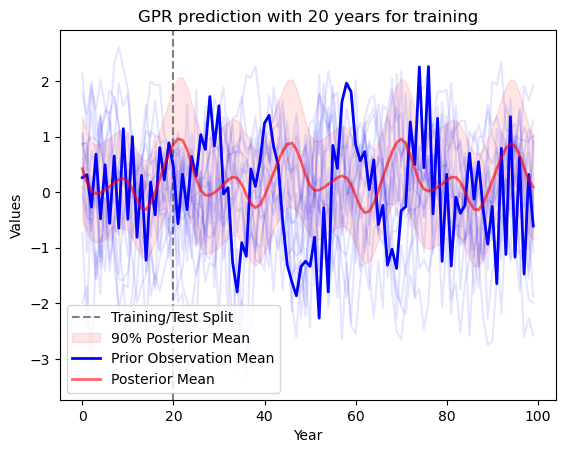

Optimization Progress:   0%|          | 0/200 [00:00<?, ?it/s]

|   iter    |  target   |    c2     |    c3     |    c4     |    ls1    |    ls2    |    ls3    |   noise   |   per1    |   per2    |   per3    |
-------------------------------------------------------------------------------------------------------------------------------------------------
|  1        | -763.6    |  1.615    |  1.661    |  9.856    |  9.046    |  1.869    |  2.684    |  0.3341   |  22.89    |  15.03    |  22.7     |
|  2        | -870.2    |  5.84     |  6.226    |  3.741    |  2.589    |  1.952    |  5.53     |  0.8256   |  20.07    |  23.75    |  25.19    |
|  3        | -827.8    |  6.459    |  3.912    |  0.893    |  8.077    |  8.117    |  0.5178   |  0.5943   |  29.37    |  29.72    |  26.4     |
|  4        | -827.0    |  6.93     |  6.27     |  6.032    |  6.819    |  8.389    |  4.606    |  0.5477   |  29.13    |  15.68    |  19.69    |
|  5        | -866.9    |  8.15     |  6.107    |  6.388    |  4.173    |  7.815    |  3.049    |  0.7597   |  18.0     |  2

Optimization Progress:   0%|          | 0/200 [00:04<?, ?it/s]

An error occurred during optimization: 'x0' must only have one dimension.
Best parameters found during the optimization process:  {'c2': 7.365367514493367, 'c3': 9.243324338538143, 'c4': 5.8887883559914815, 'ls1': 7.401923407451879, 'ls2': 4.836388849104182, 'ls3': 2.7420722379449343, 'noise': 0.28756279476940916, 'per1': 21.095653866667362, 'per2': 14.97968078307359, 'per3': 12.275235214736712}
Total log marginal likelihood for best parameters found during the optimization process:  -742.4838749045791


total_lml_train: -742.4838749045791
total_lml_test: -1180.411901450451
total_lml_full: -2468.8892932639415
best kernel is: 2.71**2 * ExpSineSquared(length_scale=7.4, periodicity=21.1) + 3.04**2 * ExpSineSquared(length_scale=4.84, periodicity=15) + 2.43**2 * ExpSineSquared(length_scale=2.74, periodicity=12.3) + WhiteKernel(noise_level=0.288)
observation_lml_train: -49.76215946088899
observation_lml_test: -106.69402307537896
observation_lml_full: -182.10419676450817


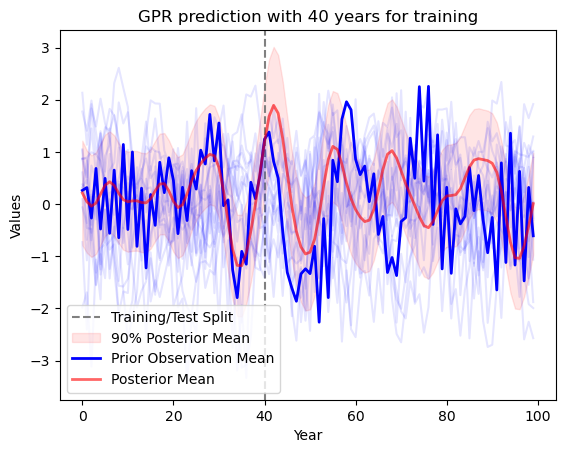

Optimization Progress:   0%|          | 0/200 [00:00<?, ?it/s]

|   iter    |  target   |    c2     |    c3     |    c4     |    ls1    |    ls2    |    ls3    |   noise   |   per1    |   per2    |   per3    |
-------------------------------------------------------------------------------------------------------------------------------------------------
|  1        | -1.356e+0 |  1.615    |  1.661    |  9.856    |  9.046    |  1.869    |  2.684    |  0.3341   |  22.89    |  15.03    |  22.7     |
|  2        | -1.386e+0 |  5.84     |  6.226    |  3.741    |  2.589    |  1.952    |  5.53     |  0.8256   |  20.07    |  23.75    |  25.19    |
|  3        | -1.296e+0 |  6.459    |  3.912    |  0.893    |  8.077    |  8.117    |  0.5178   |  0.5943   |  29.37    |  29.72    |  26.4     |
|  4        | -1.271e+0 |  6.93     |  6.27     |  6.032    |  6.819    |  8.389    |  4.606    |  0.5477   |  29.13    |  15.68    |  19.69    |
|  5        | -1.364e+0 |  8.15     |  6.107    |  6.388    |  4.173    |  7.815    |  3.049    |  0.7597   |  18.0     |  2

Optimization Progress:   0%|          | 0/200 [00:04<?, ?it/s]

|  99       | -1.414e+0 |  8.351    |  1.137    |  9.387    |  9.846    |  2.02     |  4.071    |  0.9922   |  21.28    |  21.21    |  20.72    |
|  100      | -1.234e+0 |  5.788    |  9.156    |  7.939    |  1.633    |  1.869    |  1.651    |  0.3905   |  18.77    |  17.62    |  29.77    |
An error occurred during optimization: 'x0' must only have one dimension.
Best parameters found during the optimization process:  {'c2': 7.916702700380051, 'c3': 5.131571470279993, 'c4': 9.699071138517072, 'ls1': 8.770515717239569, 'ls2': 5.634895892978901, 'ls3': 7.697235671286282, 'noise': 0.45850098971228626, 'per1': 15.991763835443066, 'per2': 26.809652295245222, 'per3': 14.872993469580296}
Total log marginal likelihood for best parameters found during the optimization process:  -1226.1982909659866


total_lml_train: -1226.1982909659866
total_lml_test: -781.3625633338991
total_lml_full: -2116.474411381233
best kernel is: 2.81**2 * ExpSineSquared(length_scale=8.77, periodicity=16) + 2.27**2 * ExpSineSquared(length_scale=5.63, periodicity=26.8) + 3.11**2 * ExpSineSquared(length_scale=7.7, periodicity=14.9) + WhiteKernel(noise_level=0.459)
observation_lml_train: -85.4427082822207
observation_lml_test: -60.86029919870144
observation_lml_full: -149.59145728299947


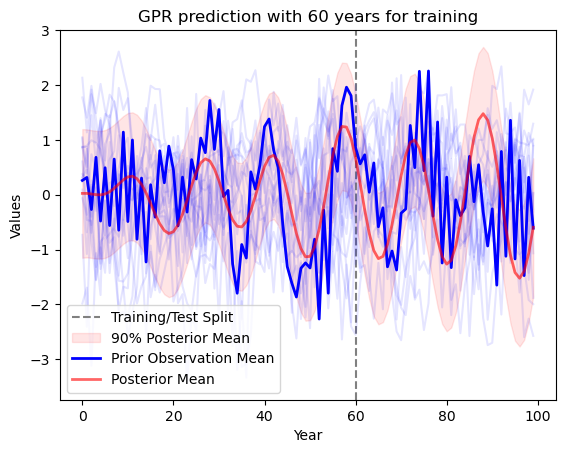

Optimization Progress:   0%|          | 0/200 [00:00<?, ?it/s]

|   iter    |  target   |    c2     |    c3     |    c4     |    ls1    |    ls2    |    ls3    |   noise   |   per1    |   per2    |   per3    |
-------------------------------------------------------------------------------------------------------------------------------------------------
|  1        | -1.862e+0 |  1.615    |  1.661    |  9.856    |  9.046    |  1.869    |  2.684    |  0.3341   |  22.89    |  15.03    |  22.7     |
|  2        | -1.851e+0 |  5.84     |  6.226    |  3.741    |  2.589    |  1.952    |  5.53     |  0.8256   |  20.07    |  23.75    |  25.19    |
|  3        | -1.81e+03 |  6.459    |  3.912    |  0.893    |  8.077    |  8.117    |  0.5178   |  0.5943   |  29.37    |  29.72    |  26.4     |
|  4        | -1.81e+03 |  6.93     |  6.27     |  6.032    |  6.819    |  8.389    |  4.606    |  0.5477   |  29.13    |  15.68    |  19.69    |
|  5        | -1.837e+0 |  8.15     |  6.107    |  6.388    |  4.173    |  7.815    |  3.049    |  0.7597   |  18.0     |  2

Optimization Progress:   0%|          | 0/200 [00:06<?, ?it/s]


total_lml_train: -1656.3574933220907
total_lml_test: -424.1983439848939
total_lml_full: -2082.360860535713
best kernel is: 1.39**2 * ExpSineSquared(length_scale=1.04, periodicity=29) + 1.41**2 * ExpSineSquared(length_scale=3.39, periodicity=23.9) + 2.58**2 * ExpSineSquared(length_scale=3.42, periodicity=24.7) + WhiteKernel(noise_level=0.651)
observation_lml_train: -121.65762022858065
observation_lml_test: -31.048261178200313
observation_lml_full: -150.73608959533112


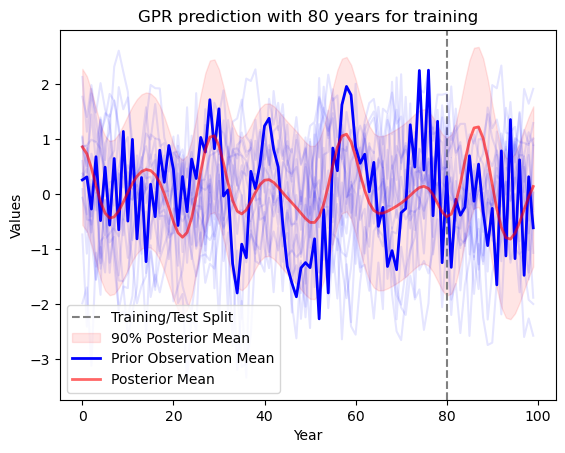

In [90]:
from sklearn.gaussian_process.kernels import ExpSineSquared, WhiteKernel, ConstantKernel as C

def pe3(best_params):
    kernel = (
        C(best_params['c2']) * ExpSineSquared(length_scale=best_params['ls1'], periodicity=best_params['per1']) +
        C(best_params['c3']) * ExpSineSquared(length_scale=best_params['ls2'], periodicity=best_params['per2']) +
        C(best_params['c4']) * ExpSineSquared(length_scale=best_params['ls3'], periodicity=best_params['per3']) +
        WhiteKernel(noise_level=best_params['noise'])
    )
    return kernel

pbounds = {
    'c2': (1e-1, 1e1),
    'c3': (1e-1, 1e1),
    'c4': (1e-1, 1e1),  # Coefficient for the third ExpSineSquared kernel
    'ls1': (1e-2, 1e1),
    'per1': (10, 30),
    'ls2': (1e-2, 1e1),
    'per2': (10, 30),
    'ls3': (1e-2, 1e1),  # Length scale for the third ExpSineSquared kernel
    'per3': (10, 30),    # Periodicity for the third ExpSineSquared kernel
    'noise': (1e-6, 1),
}

gpr_model(mod_ids, 20, rainfall_yearly, pbounds, pe3, oos_gcm)
gpr_model(mod_ids, 40, rainfall_yearly, pbounds, pe3, oos_gcm)
gpr_model(mod_ids, 60, rainfall_yearly, pbounds, pe3, oos_gcm)
gpr_model(mod_ids, 80, rainfall_yearly, pbounds, pe3, oos_gcm)

Optimization Progress:   0%|          | 0/200 [00:00<?, ?it/s]

|   iter    |  target   |    c2     |    c3     |    c4     |   c_rbf   |    ls1    |    ls2    |    ls3    |   noise   |   per1    |   per2    |   per3    |  rbf_ls   |
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------
|  1        | -432.1    |  1.615    |  1.661    |  0.9869   |  9.055    |  1.869    |  2.684    |  3.347    |  0.6446   |  15.03    |  22.7     |  21.6     |  6.192    |
|  2        | -450.5    |  3.741    |  2.656    |  0.2749   |  5.57     |  8.258    |  5.039    |  6.879    |  0.7595   |  22.85    |  17.7     |  11.6     |  8.077    |
|  3        | -432.9    |  8.134    |  0.6032   |  0.6348   |  9.686    |  9.862    |  8.2      |  6.902    |  0.6232   |  21.98    |  23.63    |  26.77    |  4.606    |
|  4        | -399.2    |  5.523    |  9.569    |  0.3556   |  4.895    |  8.133    |  6.072    |  6.355    |  0.4167   |  25.62    |  16.08    |  25.

Optimization Progress:   0%|          | 0/200 [00:05<?, ?it/s]

Total log marginal likelihood for best parameters found during the optimization process:  -364.43296943125716


total_lml_train: -364.43296943125716
total_lml_test: -1459.7082524995305
total_lml_full: -1787.1123347135376
best kernel is: 3.14**2 * ExpSineSquared(length_scale=6.34, periodicity=17.2) + 2.64**2 * ExpSineSquared(length_scale=6.09, periodicity=13.9) + 0.602**2 * ExpSineSquared(length_scale=3.49, periodicity=13.1) + 1.21**2 * RBF(length_scale=3.88) + WhiteKernel(noise_level=0.23)
observation_lml_train: -29.6727290628966
observation_lml_test: -119.63889687722379
observation_lml_full: -147.5907880082066


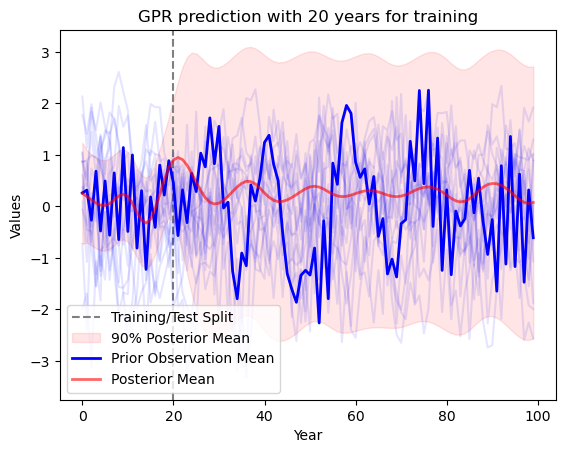

Optimization Progress:   0%|          | 0/200 [00:00<?, ?it/s]

|   iter    |  target   |    c2     |    c3     |    c4     |   c_rbf   |    ls1    |    ls2    |    ls3    |   noise   |   per1    |   per2    |   per3    |  rbf_ls   |
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------
|  1        | -851.4    |  1.615    |  1.661    |  0.9869   |  9.055    |  1.869    |  2.684    |  3.347    |  0.6446   |  15.03    |  22.7     |  21.6     |  6.192    |
|  2        | -900.1    |  3.741    |  2.656    |  0.2749   |  5.57     |  8.258    |  5.039    |  6.879    |  0.7595   |  22.85    |  17.7     |  11.6     |  8.077    |
|  3        | -848.6    |  8.134    |  0.6032   |  0.6348   |  9.686    |  9.862    |  8.2      |  6.902    |  0.6232   |  21.98    |  23.63    |  26.77    |  4.606    |
|  4        | -780.6    |  5.523    |  9.569    |  0.3556   |  4.895    |  8.133    |  6.072    |  6.355    |  0.4167   |  25.62    |  16.08    |  25.

Optimization Progress:   0%|          | 0/200 [00:05<?, ?it/s]

Total log marginal likelihood for best parameters found during the optimization process:  -713.482041704828


total_lml_train: -713.482041704828
total_lml_test: -1102.2584215327254
total_lml_full: -1787.1123347135376
best kernel is: 3.14**2 * ExpSineSquared(length_scale=6.34, periodicity=17.2) + 2.64**2 * ExpSineSquared(length_scale=6.09, periodicity=13.9) + 0.602**2 * ExpSineSquared(length_scale=3.49, periodicity=13.1) + 1.21**2 * RBF(length_scale=3.88) + WhiteKernel(noise_level=0.23)
observation_lml_train: -51.83496762769673
observation_lml_test: -98.79214608492424
observation_lml_full: -147.5907880082066


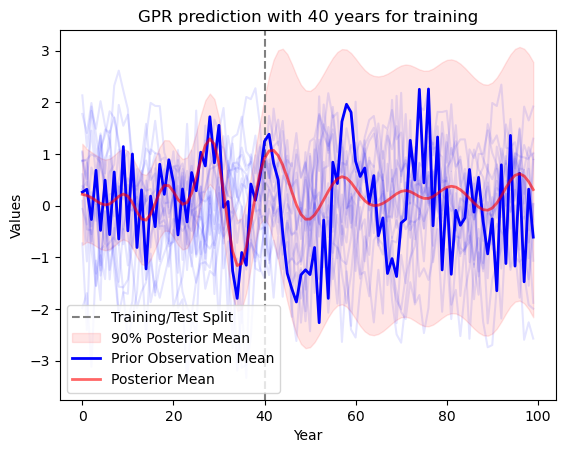

Optimization Progress:   0%|          | 0/200 [00:00<?, ?it/s]

|   iter    |  target   |    c2     |    c3     |    c4     |   c_rbf   |    ls1    |    ls2    |    ls3    |   noise   |   per1    |   per2    |   per3    |  rbf_ls   |
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------
|  1        | -1.282e+0 |  1.615    |  1.661    |  0.9869   |  9.055    |  1.869    |  2.684    |  3.347    |  0.6446   |  15.03    |  22.7     |  21.6     |  6.192    |
|  2        | -1.376e+0 |  3.741    |  2.656    |  0.2749   |  5.57     |  8.258    |  5.039    |  6.879    |  0.7595   |  22.85    |  17.7     |  11.6     |  8.077    |
|  3        | -1.268e+0 |  8.134    |  0.6032   |  0.6348   |  9.686    |  9.862    |  8.2      |  6.902    |  0.6232   |  21.98    |  23.63    |  26.77    |  4.606    |
|  4        | -1.168e+0 |  5.523    |  9.569    |  0.3556   |  4.895    |  8.133    |  6.072    |  6.355    |  0.4167   |  25.62    |  16.08    |  25.

Optimization Progress:   0%|          | 0/200 [00:05<?, ?it/s]

|  99       | -1.077e+0 |  9.83     |  6.988    |  0.3618   |  1.46     |  6.344    |  6.092    |  3.491    |  0.2302   |  17.21    |  13.88    |  13.09    |  3.88     |
|  100      | -1.355e+0 |  4.954    |  9.317    |  0.308    |  2.024    |  5.287    |  7.604    |  0.438    |  0.8686   |  26.86    |  29.32    |  14.78    |  2.371    |
An error occurred during optimization: 'x0' must only have one dimension.
Best parameters found during the optimization process:  {'c2': 9.829716468268932, 'c3': 6.98815289001678, 'c4': 0.3618216633527497, 'c_rbf': 1.4595156742070698, 'ls1': 6.344081532679512, 'ls2': 6.092323056231363, 'ls3': 3.490967606315566, 'noise': 0.23021629737927707, 'per1': 17.213187648710317, 'per2': 13.883266379930612, 'per3': 13.093955317227575, 'rbf_ls': 3.8803432881565962}
Total log marginal likelihood for best parameters found during the optimization process:  -1076.9854254290942


total_lml_train: -1076.9854254290942
total_lml_test: -736.0063932303743
total_lml_full: -1787.1123347135376
best kernel is: 3.14**2 * ExpSineSquared(length_scale=6.34, periodicity=17.2) + 2.64**2 * ExpSineSquared(length_scale=6.09, periodicity=13.9) + 0.602**2 * ExpSineSquared(length_scale=3.49, periodicity=13.1) + 1.21**2 * RBF(length_scale=3.88) + WhiteKernel(noise_level=0.23)
observation_lml_train: -77.18925329269919
observation_lml_test: -72.10318577132
observation_lml_full: -147.5907880082066


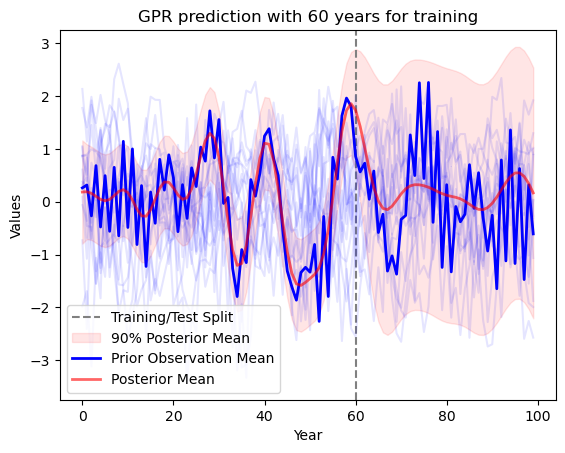

Optimization Progress:   0%|          | 0/200 [00:00<?, ?it/s]

|   iter    |  target   |    c2     |    c3     |    c4     |   c_rbf   |    ls1    |    ls2    |    ls3    |   noise   |   per1    |   per2    |   per3    |  rbf_ls   |
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------
|  1        | -1.71e+03 |  1.615    |  1.661    |  0.9869   |  9.055    |  1.869    |  2.684    |  3.347    |  0.6446   |  15.03    |  22.7     |  21.6     |  6.192    |
|  2        | -1.857e+0 |  3.741    |  2.656    |  0.2749   |  5.57     |  8.258    |  5.039    |  6.879    |  0.7595   |  22.85    |  17.7     |  11.6     |  8.077    |
|  3        | -1.687e+0 |  8.134    |  0.6032   |  0.6348   |  9.686    |  9.862    |  8.2      |  6.902    |  0.6232   |  21.98    |  23.63    |  26.77    |  4.606    |
|  4        | -1.553e+0 |  5.523    |  9.569    |  0.3556   |  4.895    |  8.133    |  6.072    |  6.355    |  0.4167   |  25.62    |  16.08    |  25.

Optimization Progress:   0%|          | 0/200 [00:08<?, ?it/s]

Total log marginal likelihood for best parameters found during the optimization process:  -1434.945822740647


total_lml_train: -1434.945822740647
total_lml_test: -386.2299098082141
total_lml_full: -1787.1123347135376
best kernel is: 3.14**2 * ExpSineSquared(length_scale=6.34, periodicity=17.2) + 2.64**2 * ExpSineSquared(length_scale=6.09, periodicity=13.9) + 0.602**2 * ExpSineSquared(length_scale=3.49, periodicity=13.1) + 1.21**2 * RBF(length_scale=3.88) + WhiteKernel(noise_level=0.23)
observation_lml_train: -109.50343599271396
observation_lml_test: -40.812854470412105
observation_lml_full: -147.5907880082066


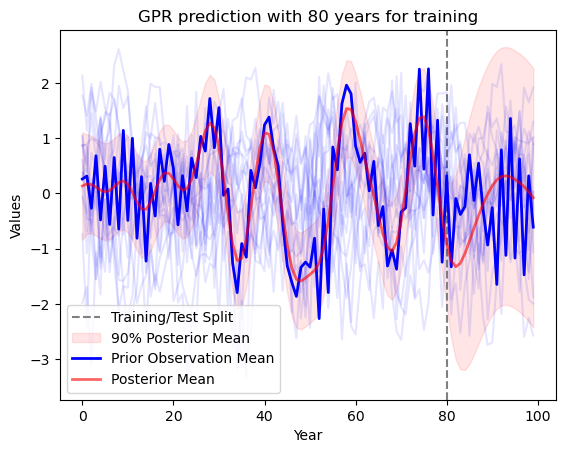

In [114]:
def pe3_rbf(best_params):
    kernel = (
        C(best_params['c2']) * ExpSineSquared(length_scale=best_params['ls1'], periodicity=best_params['per1']) +
        C(best_params['c3']) * ExpSineSquared(length_scale=best_params['ls2'], periodicity=best_params['per2']) +
        C(best_params['c4']) * ExpSineSquared(length_scale=best_params['ls3'], periodicity=best_params['per3']) +
        C(best_params['c_rbf']) * RBF(length_scale=best_params['rbf_ls']) +
        WhiteKernel(noise_level=best_params['noise'])
    )
    return kernel

pbounds = {
    'c2': (1e-1, 1e1),
    'c3': (1e-1, 1e1),
    'c4': (1e-1, 1),
    'c_rbf': (1e-1, 1e1),  # Coefficient for the RBF kernel
    'ls1': (1e-2, 1e1),
    'per1': (10, 30),
    'ls2': (1e-2, 1e1),
    'per2': (10, 30),
    'ls3': (1e-2, 1e1),
    'per3': (10, 30),
    'rbf_ls': (1e-2, 1e1),  # Length scale for the RBF kernel
    'noise': (1e-6, 1),
}

gpr_model(mod_ids, 20, rainfall_yearly, pbounds, pe3_rbf, oos_gcm)
gpr_model(mod_ids, 40, rainfall_yearly, pbounds, pe3_rbf, oos_gcm)
gpr_model(mod_ids, 60, rainfall_yearly, pbounds, pe3_rbf, oos_gcm)
gpr_model(mod_ids, 80, rainfall_yearly, pbounds, pe3_rbf, oos_gcm)

Optimization Progress:   0%|          | 0/200 [00:00<?, ?it/s]

|   iter    |  target   |    c2     |    c3     |    c4     |  c_poly   |    ls1    |    ls2    |    ls3    |   noise   |   per1    |   per2    |   per3    | poly_s... |
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------
|  1        | -609.9    |  0.2377   |  0.2419   |  0.9869   |  0.914    |  1.869    |  2.684    |  3.347    |  0.6446   |  15.03    |  22.7     |  21.6     |  6.188    |
|  2        | -636.5    |  0.431    |  0.3324   |  0.2749   |  0.5973   |  8.258    |  5.039    |  6.879    |  0.7595   |  22.85    |  17.7     |  11.6     |  8.075    |
|  3        | -631.7    |  0.8303   |  0.1457   |  0.6348   |  0.9714   |  9.862    |  8.2      |  6.902    |  0.6232   |  21.98    |  23.63    |  26.77    |  4.601    |
|  4        | -609.0    |  0.593    |  0.9608   |  0.3556   |  0.5359   |  8.133    |  6.072    |  6.355    |  0.4167   |  25.62    |  16.08    |  25.

Optimization Progress:   0%|          | 0/200 [00:05<?, ?it/s]

|  100      | -561.4    |  0.5413   |  0.9379   |  0.308    |  0.2749   |  5.287    |  7.604    |  0.438    |  0.8686   |  26.86    |  29.32    |  14.78    |  2.364    |
An error occurred during optimization: 'x0' must only have one dimension.
Best parameters found during the optimization process:  {'c2': 0.646874802680981, 'c3': 0.9554176597830457, 'c4': 0.7378348927521353, 'c_poly': 0.7689594242864847, 'ls1': 7.163761416975726, 'ls2': 1.696301833123235, 'ls3': 2.1632939463968794, 'noise': 0.4587563132154673, 'per1': 21.769713526946003, 'per2': 11.863453967410877, 'per3': 15.188422354384656, 'poly_sigma_0': 0.3728276784035779}
Total log marginal likelihood for best parameters found during the optimization process:  -463.99414569945424


total_lml_train: -463.99414569945424
total_lml_test: -1835.3438977125065
total_lml_full: -2428.0958308653867
best kernel is: 0.804**2 * ExpSineSquared(length_scale=7.16, periodicity=21.8) + 0.977**2 * ExpSineSquared(length_scale=1.7, periodicity=11.9) + 0.859**2 * ExpSineSquared(length_scale=2.16, periodicity=15.2) + 0.877**2 * DotProduct(sigma_0=0.373) ** 2 + WhiteKernel(noise_level=0.459)
observation_lml_train: -31.416589454972858
observation_lml_test: -132.2767615269772
observation_lml_full: -162.82114960627854


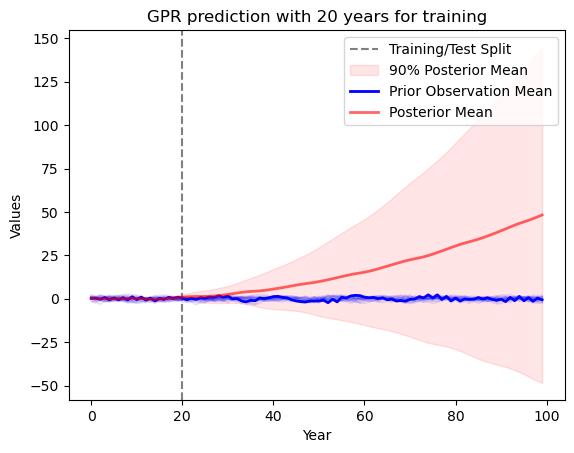

Optimization Progress:   0%|          | 0/200 [00:00<?, ?it/s]

|   iter    |  target   |    c2     |    c3     |    c4     |  c_poly   |    ls1    |    ls2    |    ls3    |   noise   |   per1    |   per2    |   per3    | poly_s... |
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------
|  1        | -1.053e+0 |  0.2377   |  0.2419   |  0.9869   |  0.914    |  1.869    |  2.684    |  3.347    |  0.6446   |  15.03    |  22.7     |  21.6     |  6.188    |
|  2        | -1.149e+0 |  0.431    |  0.3324   |  0.2749   |  0.5973   |  8.258    |  5.039    |  6.879    |  0.7595   |  22.85    |  17.7     |  11.6     |  8.075    |
|  3        | -1.161e+0 |  0.8303   |  0.1457   |  0.6348   |  0.9714   |  9.862    |  8.2      |  6.902    |  0.6232   |  21.98    |  23.63    |  26.77    |  4.601    |
|  4        | -1.118e+0 |  0.593    |  0.9608   |  0.3556   |  0.5359   |  8.133    |  6.072    |  6.355    |  0.4167   |  25.62    |  16.08    |  25.

Optimization Progress:   0%|          | 0/200 [00:05<?, ?it/s]

|  100      | -1.033e+0 |  0.5413   |  0.9379   |  0.308    |  0.2749   |  5.287    |  7.604    |  0.438    |  0.8686   |  26.86    |  29.32    |  14.78    |  2.364    |
An error occurred during optimization: 'x0' must only have one dimension.
Best parameters found during the optimization process:  {'c2': 0.9820647402436753, 'c3': 0.6380801483548729, 'c4': 0.19475458948200608, 'c_poly': 0.8257475059920847, 'ls1': 0.5359569694928217, 'ls2': 5.8106427669966925, 'ls3': 6.977725944977362, 'noise': 0.43800232618225104, 'per1': 26.633767924904653, 'per2': 28.96722274575571, 'per3': 10.85395529317732, 'poly_sigma_0': 0.7116589248344829}
Total log marginal likelihood for best parameters found during the optimization process:  -908.0719286982511


total_lml_train: -908.0719286982511
total_lml_test: -1467.0951917880914
total_lml_full: -2578.6020873062007
best kernel is: 0.991**2 * ExpSineSquared(length_scale=0.536, periodicity=26.6) + 0.799**2 * ExpSineSquared(length_scale=5.81, periodicity=29) + 0.441**2 * ExpSineSquared(length_scale=6.98, periodicity=10.9) + 0.909**2 * DotProduct(sigma_0=0.712) ** 2 + WhiteKernel(noise_level=0.438)
observation_lml_train: -60.403409334091194
observation_lml_test: -126.61181067207363
observation_lml_full: -186.9860648850319


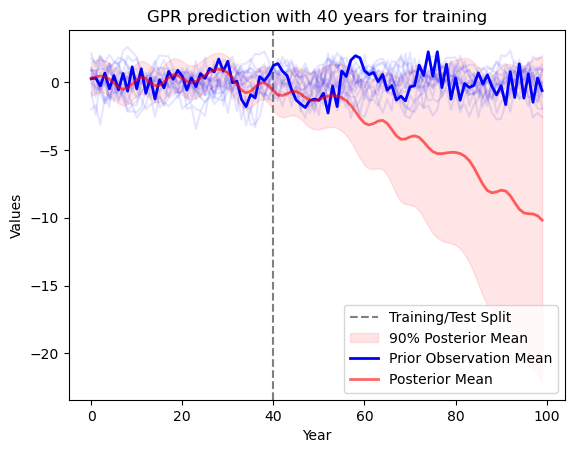

Optimization Progress:   0%|          | 0/200 [00:00<?, ?it/s]

|   iter    |  target   |    c2     |    c3     |    c4     |  c_poly   |    ls1    |    ls2    |    ls3    |   noise   |   per1    |   per2    |   per3    | poly_s... |
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------
|  1        | -1.534e+0 |  0.2377   |  0.2419   |  0.9869   |  0.914    |  1.869    |  2.684    |  3.347    |  0.6446   |  15.03    |  22.7     |  21.6     |  6.188    |
|  2        | -1.648e+0 |  0.431    |  0.3324   |  0.2749   |  0.5973   |  8.258    |  5.039    |  6.879    |  0.7595   |  22.85    |  17.7     |  11.6     |  8.075    |
|  3        | -1.681e+0 |  0.8303   |  0.1457   |  0.6348   |  0.9714   |  9.862    |  8.2      |  6.902    |  0.6232   |  21.98    |  23.63    |  26.77    |  4.601    |
|  4        | -1.692e+0 |  0.593    |  0.9608   |  0.3556   |  0.5359   |  8.133    |  6.072    |  6.355    |  0.4167   |  25.62    |  16.08    |  25.

Optimization Progress:   0%|          | 0/200 [00:05<?, ?it/s]

Total log marginal likelihood for best parameters found during the optimization process:  -1390.740060699567


total_lml_train: -1390.740060699567
total_lml_test: -956.8657114470265
total_lml_full: -2428.0958308653867
best kernel is: 0.804**2 * ExpSineSquared(length_scale=7.16, periodicity=21.8) + 0.977**2 * ExpSineSquared(length_scale=1.7, periodicity=11.9) + 0.859**2 * ExpSineSquared(length_scale=2.16, periodicity=15.2) + 0.877**2 * DotProduct(sigma_0=0.373) ** 2 + WhiteKernel(noise_level=0.459)
observation_lml_train: -98.42732953553153
observation_lml_test: -68.0333330135771
observation_lml_full: -162.82114960627854


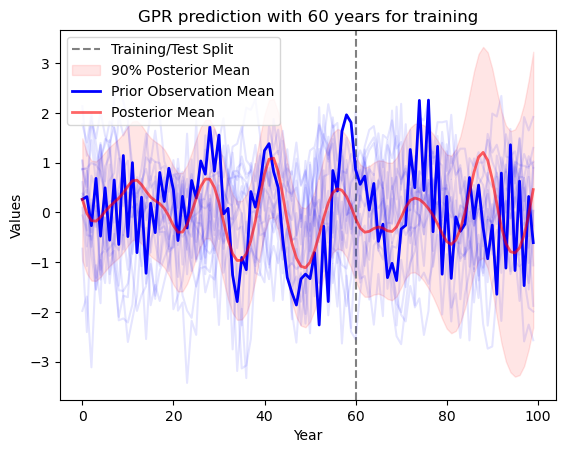

Optimization Progress:   0%|          | 0/200 [00:00<?, ?it/s]

|   iter    |  target   |    c2     |    c3     |    c4     |  c_poly   |    ls1    |    ls2    |    ls3    |   noise   |   per1    |   per2    |   per3    | poly_s... |
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------
|  1        | -1.998e+0 |  0.2377   |  0.2419   |  0.9869   |  0.914    |  1.869    |  2.684    |  3.347    |  0.6446   |  15.03    |  22.7     |  21.6     |  6.188    |
|  2        | -2.128e+0 |  0.431    |  0.3324   |  0.2749   |  0.5973   |  8.258    |  5.039    |  6.879    |  0.7595   |  22.85    |  17.7     |  11.6     |  8.075    |
|  3        | -2.182e+0 |  0.8303   |  0.1457   |  0.6348   |  0.9714   |  9.862    |  8.2      |  6.902    |  0.6232   |  21.98    |  23.63    |  26.77    |  4.601    |
|  4        | -2.252e+0 |  0.593    |  0.9608   |  0.3556   |  0.5359   |  8.133    |  6.072    |  6.355    |  0.4167   |  25.62    |  16.08    |  25.

Optimization Progress:   0%|          | 0/200 [00:07<?, ?it/s]

|  100      | -1.967e+0 |  0.5413   |  0.9379   |  0.308    |  0.2749   |  5.287    |  7.604    |  0.438    |  0.8686   |  26.86    |  29.32    |  14.78    |  2.364    |
An error occurred during optimization: 'x0' must only have one dimension.
Best parameters found during the optimization process:  {'c2': 0.1230563185694423, 'c3': 0.8568506077398266, 'c4': 0.9419960744519742, 'c_poly': 0.24367391536751917, 'ls1': 0.8821325354787637, 'ls2': 1.8524886263688862, 'ls3': 3.088004405170538, 'noise': 0.8744413455805679, 'per1': 25.806637588091668, 'per2': 14.791749706014578, 'per3': 18.56368049279544, 'poly_sigma_0': 5.173132629844523}
Total log marginal likelihood for best parameters found during the optimization process:  -1890.5409349029928


total_lml_train: -1890.5409349029928
total_lml_test: -604.7810196589749
total_lml_full: -2324.306669948359
best kernel is: 0.351**2 * ExpSineSquared(length_scale=0.882, periodicity=25.8) + 0.926**2 * ExpSineSquared(length_scale=1.85, periodicity=14.8) + 0.971**2 * ExpSineSquared(length_scale=3.09, periodicity=18.6) + 0.494**2 * DotProduct(sigma_0=5.17) ** 2 + WhiteKernel(noise_level=0.874)
observation_lml_train: -123.58472475241024
observation_lml_test: -40.620881668055
observation_lml_full: -150.6874817211696


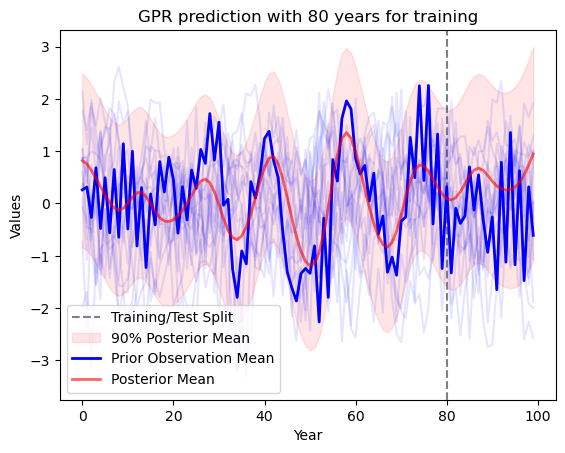

In [94]:
def pe3_poly(best_params):
    kernel = (
        C(best_params['c2']) * ExpSineSquared(length_scale=best_params['ls1'], periodicity=best_params['per1']) +
        C(best_params['c3']) * ExpSineSquared(length_scale=best_params['ls2'], periodicity=best_params['per2']) +
        C(best_params['c4']) * ExpSineSquared(length_scale=best_params['ls3'], periodicity=best_params['per3']) +
        C(best_params['c_poly']) * DotProduct(sigma_0=best_params['poly_sigma_0']) ** 2 +
        WhiteKernel(noise_level=best_params['noise'])
    )
    return kernel

pbounds = {
    'c2': (1e-1, 1),
    'c3': (1e-1, 1),
    'c4': (1e-1, 1),
    'c_poly': (1e-1, 1),  # Coefficient for the Polynomial kernel
    'ls1': (1e-2, 1e1),
    'per1': (10, 30),
    'ls2': (1e-2, 1e1),
    'per2': (10, 30),
    'ls3': (1e-2, 1e1),
    'per3': (10, 30),
    'poly_sigma_0': (1e-3, 1e1),  # Coefficient offset for the Polynomial kernel      # Degree of the Polynomial kernel
    'noise': (1e-6, 1),
}

gpr_model(mod_ids, 20, rainfall_yearly, pbounds, pe3_poly, oos_gcm)
gpr_model(mod_ids, 40, rainfall_yearly, pbounds, pe3_poly, oos_gcm)
gpr_model(mod_ids, 60, rainfall_yearly, pbounds, pe3_poly, oos_gcm)
gpr_model(mod_ids, 80, rainfall_yearly, pbounds, pe3_poly, oos_gcm)

Optimization Progress:   0%|          | 0/200 [00:00<?, ?it/s]

|   iter    |  target   |    c1     |    c2     |    c3     |    c4     |    c5     | dp_sig... |    ls1    |    ls2    |    ls3    |   noise   |   per1    |   per2    |   per3    | rq_alpha  |   rq_ls   |    se1    |    se2    |    se3    |
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
|  1        | -805.5    |  1.615    |  1.661    |  9.856    |  9.055    |  1.942    |  2.678    |  3.347    |  6.449    |  2.522    |  6.352    |  21.6     |  22.38    |  17.36    |  25.82    |  1.952    |  5.53     |  8.258    |  5.039    |
|  2        | -945.8    |  6.907    |  7.62     |  6.459    |  3.912    |  0.893    |  8.075    |  8.117    |  0.5178   |  5.947    |  9.683    |  29.72    |  26.4     |  23.8     |  62.33    |  5.996    |  6.819    |  8.389    |  4.606    |
|  3        | -778.0    |  5.523

Optimization Progress:   0%|          | 0/200 [00:07<?, ?it/s]

|  100      | -785.6    |  4.314    |  5.232    |  0.6593   |  9.646    |  8.115    |  0.1432   |  7.698    |  8.347    |  0.3142   |  1.368    |  19.34    |  16.08    |  15.19    |  61.75    |  8.552    |  8.643    |  3.392    |  5.712    |
An error occurred during optimization: 'x0' must only have one dimension.
Best parameters found during the optimization process:  {'c1': 5.3959524825874565, 'c2': 9.495880929855268, 'c3': 1.9587408456236377, 'c4': 7.35608236563516, 'c5': 4.323911425535375, 'dp_sigma_0': 0.9385703288502555, 'ls1': 2.7733725878932134, 'ls2': 4.7775534598889315, 'ls3': 5.490961902214394, 'noise': 0.19901839529903026, 'per1': 19.391566173630324, 'per2': 13.789846325535818, 'per3': 22.03787872011027, 'rq_alpha': 57.05500076400348, 'rq_ls': 7.93443999429744, 'se1': 4.715983140594607, 'se2': 4.771824922830001, 'se3': 7.422802884725428}
Total log marginal likelihood for best parameters found during the optimization process:  -513.7883006348953


total_lml_train: -513.7883006348953
total_lml_test: -1851.1344038730954
total_lml_full: -2233.777232815409
best kernel is: 2.32**2 * DotProduct(sigma_0=0.939) ** 2 + 3.08**2 * ExpSineSquared(length_scale=2.77, periodicity=19.4) * RBF(length_scale=4.72) + 1.4**2 * ExpSineSquared(length_scale=4.78, periodicity=13.8) * RBF(length_scale=4.77) + 2.71**2 * ExpSineSquared(length_scale=5.49, periodicity=22) * RBF(length_scale=7.42) + 2.08**2 * RationalQuadratic(alpha=57.1, length_scale=7.93) + WhiteKernel(noise_level=0.199)
observation_lml_train: -41.83798563659849
observation_lml_test: -148.50188578318074
observation_lml_full: -181.98213284540842


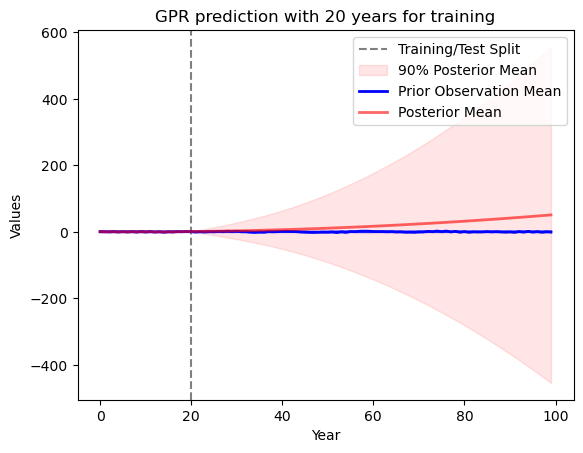

Optimization Progress:   0%|          | 0/200 [00:00<?, ?it/s]

|   iter    |  target   |    c1     |    c2     |    c3     |    c4     |    c5     | dp_sig... |    ls1    |    ls2    |    ls3    |   noise   |   per1    |   per2    |   per3    | rq_alpha  |   rq_ls   |    se1    |    se2    |    se3    |
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
|  1        | -1.53e+03 |  1.615    |  1.661    |  9.856    |  9.055    |  1.942    |  2.678    |  3.347    |  6.449    |  2.522    |  6.352    |  21.6     |  22.38    |  17.36    |  25.82    |  1.952    |  5.53     |  8.258    |  5.039    |
|  2        | -1.729e+0 |  6.907    |  7.62     |  6.459    |  3.912    |  0.893    |  8.075    |  8.117    |  0.5178   |  5.947    |  9.683    |  29.72    |  26.4     |  23.8     |  62.33    |  5.996    |  6.819    |  8.389    |  4.606    |
|  3        | -1.401e+0 |  5.523

Optimization Progress:   0%|          | 0/200 [00:08<?, ?it/s]

|  99       | -1.789e+0 |  5.427    |  5.88     |  5.525    |  7.125    |  9.94     |  8.187    |  8.923    |  7.012    |  5.408    |  7.779    |  19.65    |  20.45    |  13.5     |  95.37    |  4.192    |  0.04784  |  4.24     |  8.55     |
|  100      | -1.51e+03 |  4.314    |  5.232    |  0.6593   |  9.646    |  8.115    |  0.1432   |  7.698    |  8.347    |  0.3142   |  1.368    |  19.34    |  16.08    |  15.19    |  61.75    |  8.552    |  8.643    |  3.392    |  5.712    |
An error occurred during optimization: 'x0' must only have one dimension.
Best parameters found during the optimization process:  {'c1': 5.3959524825874565, 'c2': 9.495880929855268, 'c3': 1.9587408456236377, 'c4': 7.35608236563516, 'c5': 4.323911425535375, 'dp_sigma_0': 0.9385703288502555, 'ls1': 2.7733725878932134, 'ls2': 4.7775534598889315, 'ls3': 5.490961902214394, 'noise': 0.19901839529903026, 'per1': 19.391566173630324, 'per2': 13.789846325535818, 'per3': 22.03787872011027, 'rq_alpha': 57.05500076400348, '

total_lml_train: -946.1920754697976
total_lml_test: -1449.4977057234682
total_lml_full: -2233.777232815409
best kernel is: 2.32**2 * DotProduct(sigma_0=0.939) ** 2 + 3.08**2 * ExpSineSquared(length_scale=2.77, periodicity=19.4) * RBF(length_scale=4.72) + 1.4**2 * ExpSineSquared(length_scale=4.78, periodicity=13.8) * RBF(length_scale=4.77) + 2.71**2 * ExpSineSquared(length_scale=5.49, periodicity=22) * RBF(length_scale=7.42) + 2.08**2 * RationalQuadratic(alpha=57.1, length_scale=7.93) + WhiteKernel(noise_level=0.199)
observation_lml_train: -68.5880035008845
observation_lml_test: -123.7823676649443
observation_lml_full: -181.98213284540842


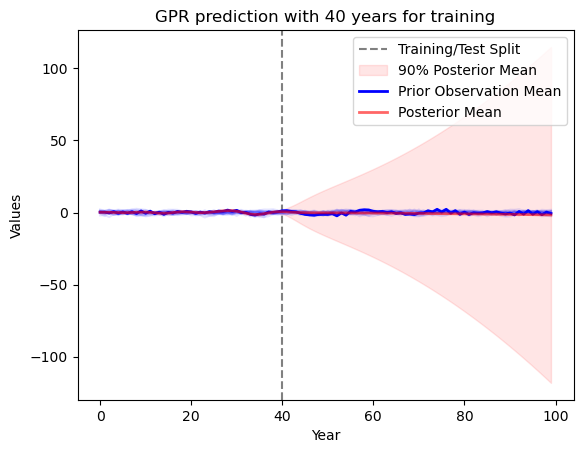

Optimization Progress:   0%|          | 0/200 [00:00<?, ?it/s]

|   iter    |  target   |    c1     |    c2     |    c3     |    c4     |    c5     | dp_sig... |    ls1    |    ls2    |    ls3    |   noise   |   per1    |   per2    |   per3    | rq_alpha  |   rq_ls   |    se1    |    se2    |    se3    |
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
|  1        | -2.242e+0 |  1.615    |  1.661    |  9.856    |  9.055    |  1.942    |  2.678    |  3.347    |  6.449    |  2.522    |  6.352    |  21.6     |  22.38    |  17.36    |  25.82    |  1.952    |  5.53     |  8.258    |  5.039    |
|  2        | -2.498e+0 |  6.907    |  7.62     |  6.459    |  3.912    |  0.893    |  8.075    |  8.117    |  0.5178   |  5.947    |  9.683    |  29.72    |  26.4     |  23.8     |  62.33    |  5.996    |  6.819    |  8.389    |  4.606    |
|  3        | -2.014e+0 |  5.523

Optimization Progress:   0%|          | 0/200 [00:08<?, ?it/s]


total_lml_train: -1386.7282119374272
total_lml_test: -1023.8616856346896
total_lml_full: -2233.777232815409
best kernel is: 2.32**2 * DotProduct(sigma_0=0.939) ** 2 + 3.08**2 * ExpSineSquared(length_scale=2.77, periodicity=19.4) * RBF(length_scale=4.72) + 1.4**2 * ExpSineSquared(length_scale=4.78, periodicity=13.8) * RBF(length_scale=4.77) + 2.71**2 * ExpSineSquared(length_scale=5.49, periodicity=22) * RBF(length_scale=7.42) + 2.08**2 * RationalQuadratic(alpha=57.1, length_scale=7.93) + WhiteKernel(noise_level=0.199)
observation_lml_train: -97.6323350936237
observation_lml_test: -95.22974456778525
observation_lml_full: -181.98213284540842


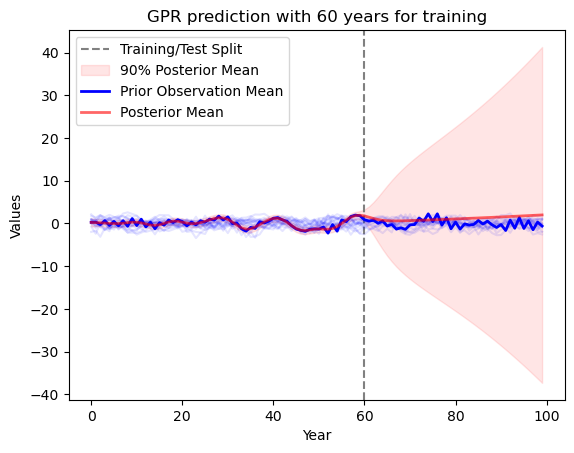

Optimization Progress:   0%|          | 0/200 [00:00<?, ?it/s]

|   iter    |  target   |    c1     |    c2     |    c3     |    c4     |    c5     | dp_sig... |    ls1    |    ls2    |    ls3    |   noise   |   per1    |   per2    |   per3    | rq_alpha  |   rq_ls   |    se1    |    se2    |    se3    |
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
|  1        | -2.948e+0 |  1.615    |  1.661    |  9.856    |  9.055    |  1.942    |  2.678    |  3.347    |  6.449    |  2.522    |  6.352    |  21.6     |  22.38    |  17.36    |  25.82    |  1.952    |  5.53     |  8.258    |  5.039    |
|  2        | -3.261e+0 |  6.907    |  7.62     |  6.459    |  3.912    |  0.893    |  8.075    |  8.117    |  0.5178   |  5.947    |  9.683    |  29.72    |  26.4     |  23.8     |  62.33    |  5.996    |  6.819    |  8.389    |  4.606    |
|  3        | -2.621e+0 |  5.523

Optimization Progress:   0%|          | 0/200 [00:11<?, ?it/s]

|  100      | -2.939e+0 |  4.314    |  5.232    |  0.6593   |  9.646    |  8.115    |  0.1432   |  7.698    |  8.347    |  0.3142   |  1.368    |  19.34    |  16.08    |  15.19    |  61.75    |  8.552    |  8.643    |  3.392    |  5.712    |
An error occurred during optimization: 'x0' must only have one dimension.
Best parameters found during the optimization process:  {'c1': 5.3959524825874565, 'c2': 9.495880929855268, 'c3': 1.9587408456236377, 'c4': 7.35608236563516, 'c5': 4.323911425535375, 'dp_sigma_0': 0.9385703288502555, 'ls1': 2.7733725878932134, 'ls2': 4.7775534598889315, 'ls3': 5.490961902214394, 'noise': 0.19901839529903026, 'per1': 19.391566173630324, 'per2': 13.789846325535818, 'per3': 22.03787872011027, 'rq_alpha': 57.05500076400348, 'rq_ls': 7.93443999429744, 'se1': 4.715983140594607, 'se2': 4.771824922830001, 'se3': 7.422802884725428}
Total log marginal likelihood for best parameters found during the optimization process:  -1810.6745070465297


total_lml_train: -1810.6745070465297
total_lml_test: -606.9308036309764
total_lml_full: -2233.777232815409
best kernel is: 2.32**2 * DotProduct(sigma_0=0.939) ** 2 + 3.08**2 * ExpSineSquared(length_scale=2.77, periodicity=19.4) * RBF(length_scale=4.72) + 1.4**2 * ExpSineSquared(length_scale=4.78, periodicity=13.8) * RBF(length_scale=4.77) + 2.71**2 * ExpSineSquared(length_scale=5.49, periodicity=22) * RBF(length_scale=7.42) + 2.08**2 * RationalQuadratic(alpha=57.1, length_scale=7.93) + WhiteKernel(noise_level=0.199)
observation_lml_train: -135.38726214420663
observation_lml_test: -57.36094147719193
observation_lml_full: -181.98213284540842


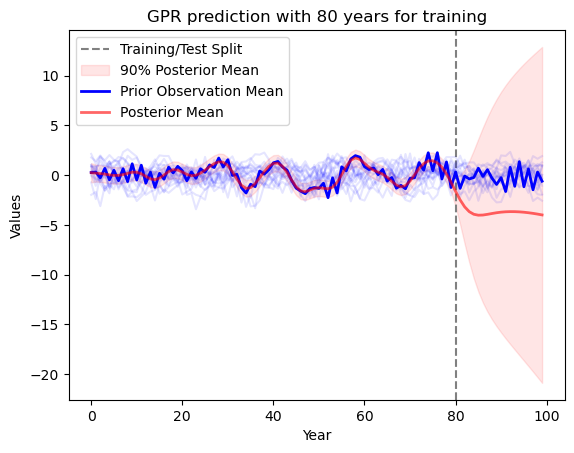

In [64]:
def sepe3_poly_rq(best_params):
    kernel = (
        C(best_params['c1']) * (DotProduct(sigma_0=best_params['dp_sigma_0']) ** 2) +
        C(best_params['c2']) * ExpSineSquared(length_scale=best_params['ls1'], periodicity=best_params['per1']) * RBF(length_scale=best_params['se1']) +
        C(best_params['c3']) * ExpSineSquared(length_scale=best_params['ls2'], periodicity=best_params['per2']) * RBF(length_scale=best_params['se2']) +
        C(best_params['c4']) * ExpSineSquared(length_scale=best_params['ls3'], periodicity=best_params['per3']) * RBF(length_scale=best_params['se3']) +
        C(best_params['c5']) * RationalQuadratic(length_scale=best_params['rq_ls'], alpha=best_params['rq_alpha']) +
        WhiteKernel(noise_level=best_params['noise'])
    )
    return kernel

pbounds = {
    'c1': (1e-1, 1e1),
    'c2': (1e-1, 1e1),
    'c3': (1e-1, 1e1),
    'c4': (1e-1, 1e1),
    'c5': (1e-1, 1e1),
    'ls1': (1e-2, 1e1),
    'per1': (10, 30),
    'ls2': (1e-2, 1e1),
    'per2': (10, 30),
    'ls3': (1e-2, 1e1),
    'per3': (10, 30),
    'noise': (1e-6, 10),
    'dp_sigma_0': (1e-3, 1e1),
    'rq_alpha': (1e-2, 1e2),
    'rq_ls': (1e-2, 1e1),
    'se1': (1e-2, 1e1), 
    'se2': (1e-2, 1e1), 
    'se3': (1e-2, 1e1),
}

gpr_model(mod_ids, 20, rainfall_yearly, pbounds, sepe3_poly_rq, oos_gcm)
gpr_model(mod_ids, 40, rainfall_yearly, pbounds, sepe3_poly_rq, oos_gcm)
gpr_model(mod_ids, 60, rainfall_yearly, pbounds, sepe3_poly_rq, oos_gcm)
gpr_model(mod_ids, 80, rainfall_yearly, pbounds, sepe3_poly_rq, oos_gcm)

Optimization Progress:   0%|          | 0/200 [00:00<?, ?it/s]

|   iter    |  target   |    c1     |    c2     |    c3     |    c4     |    c5     | dp_sig... |    ls1    |    ls2    |    ls3    |   noise   |   per1    |   per2    |   per3    | rq_alpha  |   rq_ls   |
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
|  1        | -528.3    |  0.2377   |  0.2419   |  0.9869   |  0.914    |  0.1012   |  2.678    |  3.347    |  6.449    |  2.522    |  0.6352   |  21.6     |  22.38    |  17.36    |  25.82    |  1.952    |
|  2        | -592.5    |  0.5973   |  0.8431   |  0.5531   |  0.7188   |  0.3822   |  6.423    |  3.856    |  0.8102   |  8.077    |  0.8115   |  11.02    |  21.89    |  29.37    |  98.62    |  8.2      |
|  3        | -610.2    |  0.7209   |  0.6609   |  0.6393   |  0.7134   |  0.421    |  4.601    |  5.482    |  9.565    |  2.847    |  0.4844   |  26.26    |  22.14    |  22.7 

Optimization Progress:   0%|          | 0/200 [00:06<?, ?it/s]

|  100      | -586.3    |  0.4161   |  0.3527   |  0.795    |  0.7681   |  0.05587  |  3.726    |  8.149    |  2.698    |  8.948    |  0.9008   |  28.79    |  17.03    |  29.26    |  28.15    |  0.6097   |
An error occurred during optimization: 'x0' must only have one dimension.
Best parameters found during the optimization process:  {'c1': 0.1382913211673241, 'c2': 0.971275202336677, 'c3': 0.6727019553420176, 'c4': 0.1791707294295669, 'c5': 0.41139360176863526, 'dp_sigma_0': 1.2724587561876028, 'ls1': 6.641998362050651, 'ls2': 8.936659236993608, 'ls3': 1.4591292314309188, 'noise': 0.49973906014149755, 'per1': 19.554725660115402, 'per2': 16.72573150454444, 'per3': 11.30221398350454, 'rq_alpha': 53.68033862663323, 'rq_ls': 6.400961581963669}
Total log marginal likelihood for best parameters found during the optimization process:  -486.01884294099585


total_lml_train: -486.01884294099585
total_lml_test: -1929.862269094628
total_lml_full: -2398.04367432076
best kernel is: 0.372**2 * DotProduct(sigma_0=1.27) ** 2 + 0.986**2 * ExpSineSquared(length_scale=6.64, periodicity=19.6) + 0.82**2 * ExpSineSquared(length_scale=8.94, periodicity=16.7) + 0.423**2 * ExpSineSquared(length_scale=1.46, periodicity=11.3) + 0.641**2 * RationalQuadratic(alpha=53.7, length_scale=6.4) + WhiteKernel(noise_level=0.5)
observation_lml_train: -29.92265330596463
observation_lml_test: -123.58503657188045
observation_lml_full: -147.65643598902028


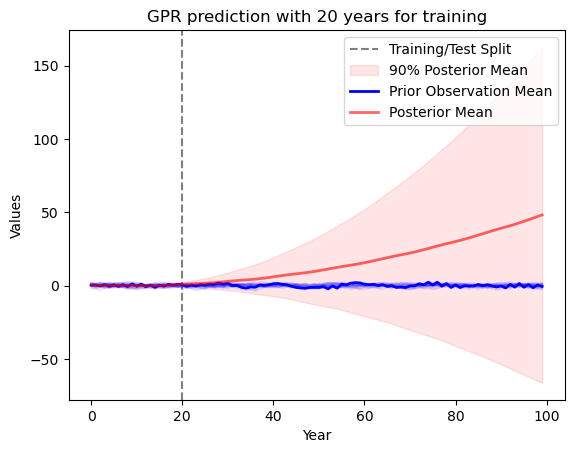

Optimization Progress:   0%|          | 0/200 [00:00<?, ?it/s]

|   iter    |  target   |    c1     |    c2     |    c3     |    c4     |    c5     | dp_sig... |    ls1    |    ls2    |    ls3    |   noise   |   per1    |   per2    |   per3    | rq_alpha  |   rq_ls   |
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
|  1        | -988.6    |  0.2377   |  0.2419   |  0.9869   |  0.914    |  0.1012   |  2.678    |  3.347    |  6.449    |  2.522    |  0.6352   |  21.6     |  22.38    |  17.36    |  25.82    |  1.952    |
|  2        | -1.119e+0 |  0.5973   |  0.8431   |  0.5531   |  0.7188   |  0.3822   |  6.423    |  3.856    |  0.8102   |  8.077    |  0.8115   |  11.02    |  21.89    |  29.37    |  98.62    |  8.2      |
|  3        | -1.129e+0 |  0.7209   |  0.6609   |  0.6393   |  0.7134   |  0.421    |  4.601    |  5.482    |  9.565    |  2.847    |  0.4844   |  26.26    |  22.14    |  22.7 

Optimization Progress:   0%|          | 0/200 [00:06<?, ?it/s]

An error occurred during optimization: 'x0' must only have one dimension.
Best parameters found during the optimization process:  {'c1': 0.4572069183606604, 'c2': 0.9866176056385251, 'c3': 0.8200902921033617, 'c4': 0.4916938066198644, 'c5': 0.21938753578940742, 'dp_sigma_0': 0.7594211062135395, 'ls1': 2.556084779886102, 'ls2': 8.149482581797212, 'ls3': 3.9015679750889425, 'noise': 0.5703437973925986, 'per1': 19.289304335793453, 'per2': 14.640310895626513, 'per3': 12.340868933556948, 'rq_alpha': 46.36695338589812, 'rq_ls': 2.982137651860002}
Total log marginal likelihood for best parameters found during the optimization process:  -916.8905963791071


total_lml_train: -916.8905963791071
total_lml_test: -1354.1102043492724
total_lml_full: -2151.8242111154614
best kernel is: 0.676**2 * DotProduct(sigma_0=0.759) ** 2 + 0.993**2 * ExpSineSquared(length_scale=2.56, periodicity=19.3) + 0.906**2 * ExpSineSquared(length_scale=8.15, periodicity=14.6) + 0.701**2 * ExpSineSquared(length_scale=3.9, periodicity=12.3) + 0.468**2 * RationalQuadratic(alpha=46.4, length_scale=2.98) + WhiteKernel(noise_level=0.57)
observation_lml_train: -56.983952115490176
observation_lml_test: -95.20173477340026
observation_lml_full: -144.39303938626543


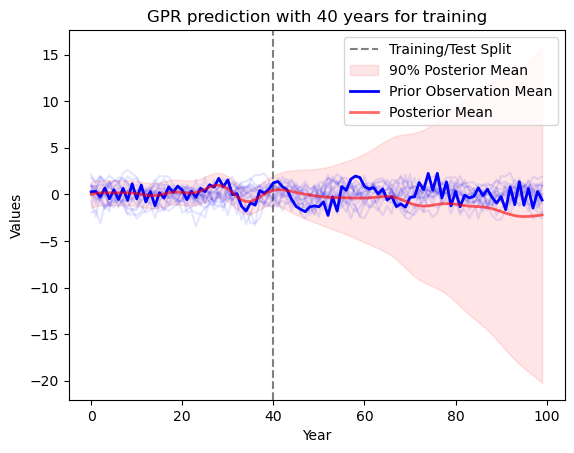

Optimization Progress:   0%|          | 0/200 [00:00<?, ?it/s]

|   iter    |  target   |    c1     |    c2     |    c3     |    c4     |    c5     | dp_sig... |    ls1    |    ls2    |    ls3    |   noise   |   per1    |   per2    |   per3    | rq_alpha  |   rq_ls   |
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
|  1        | -1.451e+0 |  0.2377   |  0.2419   |  0.9869   |  0.914    |  0.1012   |  2.678    |  3.347    |  6.449    |  2.522    |  0.6352   |  21.6     |  22.38    |  17.36    |  25.82    |  1.952    |
|  2        | -1.608e+0 |  0.5973   |  0.8431   |  0.5531   |  0.7188   |  0.3822   |  6.423    |  3.856    |  0.8102   |  8.077    |  0.8115   |  11.02    |  21.89    |  29.37    |  98.62    |  8.2      |
|  3        | -1.645e+0 |  0.7209   |  0.6609   |  0.6393   |  0.7134   |  0.421    |  4.601    |  5.482    |  9.565    |  2.847    |  0.4844   |  26.26    |  22.14    |  22.7 

Optimization Progress:   0%|          | 0/200 [00:06<?, ?it/s]

Total log marginal likelihood for best parameters found during the optimization process:  -1321.546492865132


total_lml_train: -1321.546492865132
total_lml_test: -964.3316970117373
total_lml_full: -2100.2366879876854
best kernel is: 0.723**2 * DotProduct(sigma_0=1.89) ** 2 + 0.474**2 * ExpSineSquared(length_scale=0.305, periodicity=29.9) + 0.499**2 * ExpSineSquared(length_scale=9.98, periodicity=12.5) + 0.484**2 * ExpSineSquared(length_scale=9.79, periodicity=12.8) + 0.656**2 * RationalQuadratic(alpha=82.2, length_scale=2.13) + WhiteKernel(noise_level=0.4)
observation_lml_train: -87.5636746155906
observation_lml_test: -73.15038116818167
observation_lml_full: -149.6442660077535


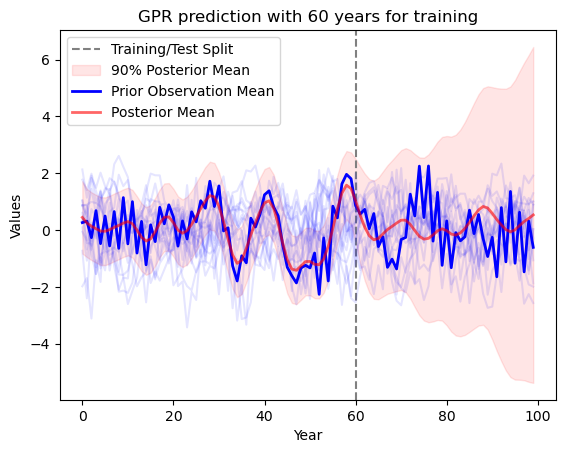

Optimization Progress:   0%|          | 0/200 [00:00<?, ?it/s]

|   iter    |  target   |    c1     |    c2     |    c3     |    c4     |    c5     | dp_sig... |    ls1    |    ls2    |    ls3    |   noise   |   per1    |   per2    |   per3    | rq_alpha  |   rq_ls   |
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
|  1        | -1.906e+0 |  0.2377   |  0.2419   |  0.9869   |  0.914    |  0.1012   |  2.678    |  3.347    |  6.449    |  2.522    |  0.6352   |  21.6     |  22.38    |  17.36    |  25.82    |  1.952    |
|  2        | -2.094e+0 |  0.5973   |  0.8431   |  0.5531   |  0.7188   |  0.3822   |  6.423    |  3.856    |  0.8102   |  8.077    |  0.8115   |  11.02    |  21.89    |  29.37    |  98.62    |  8.2      |
|  3        | -2.164e+0 |  0.7209   |  0.6609   |  0.6393   |  0.7134   |  0.421    |  4.601    |  5.482    |  9.565    |  2.847    |  0.4844   |  26.26    |  22.14    |  22.7 

Optimization Progress:   0%|          | 0/200 [00:09<?, ?it/s]

|  100      | -2.055e+0 |  0.4161   |  0.3527   |  0.795    |  0.7681   |  0.05587  |  3.726    |  8.149    |  2.698    |  8.948    |  0.9008   |  28.79    |  17.03    |  29.26    |  28.15    |  0.6097   |
An error occurred during optimization: 'x0' must only have one dimension.
Best parameters found during the optimization process:  {'c1': 0.5230289156837675, 'c2': 0.22439694605024213, 'c3': 0.24949990926958063, 'c4': 0.23418308251646763, 'c5': 0.43025861111377844, 'dp_sigma_0': 1.892125820539143, 'ls1': 0.3051825086893311, 'ls2': 9.984355889149443, 'ls3': 9.794858794052146, 'noise': 0.40041488989372387, 'per1': 29.92473788208504, 'per2': 12.507711691068566, 'per3': 12.829851423815255, 'rq_alpha': 82.18624631078019, 'rq_ls': 2.1257773804791977}
Total log marginal likelihood for best parameters found during the optimization process:  -1716.6493355266514


total_lml_train: -1716.6493355266514
total_lml_test: -575.7429560206667
total_lml_full: -2100.2366879876854
best kernel is: 0.723**2 * DotProduct(sigma_0=1.89) ** 2 + 0.474**2 * ExpSineSquared(length_scale=0.305, periodicity=29.9) + 0.499**2 * ExpSineSquared(length_scale=9.98, periodicity=12.5) + 0.484**2 * ExpSineSquared(length_scale=9.79, periodicity=12.8) + 0.656**2 * RationalQuadratic(alpha=82.2, length_scale=2.13) + WhiteKernel(noise_level=0.4)
observation_lml_train: -118.23990624918487
observation_lml_test: -43.317843480963575
observation_lml_full: -149.6442660077535


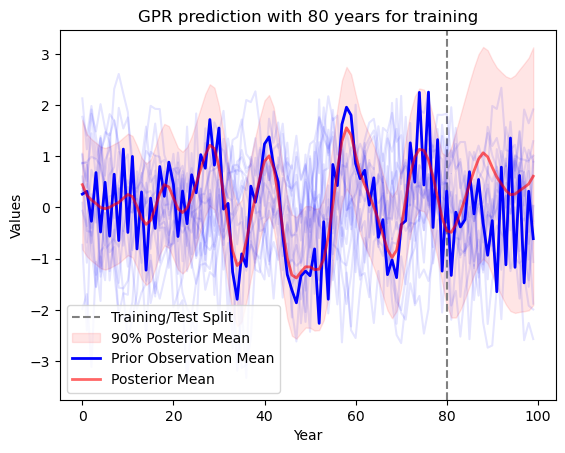

In [97]:
def pe3_poly_rq(best_params):
    kernel = (
        C(best_params['c1']) * (DotProduct(sigma_0=best_params['dp_sigma_0']) ** 2) +
        C(best_params['c2']) * ExpSineSquared(length_scale=best_params['ls1'], periodicity=best_params['per1']) +
        C(best_params['c3']) * ExpSineSquared(length_scale=best_params['ls2'], periodicity=best_params['per2']) +
        C(best_params['c4']) * ExpSineSquared(length_scale=best_params['ls3'], periodicity=best_params['per3']) +
        C(best_params['c5']) * RationalQuadratic(length_scale=best_params['rq_ls'], alpha=best_params['rq_alpha']) +
        WhiteKernel(noise_level=best_params['noise'])
    )
    return kernel

pbounds = {
    'c1': (1e-1, 1),
    'c2': (1e-1, 1),
    'c3': (1e-1, 1),
    'c4': (1e-1, 1),
    'c5': (1e-2, 0.5),
    'ls1': (1e-2, 1e1),
    'per1': (10, 30),
    'ls2': (1e-2, 1e1),
    'per2': (10, 30),
    'ls3': (1e-2, 1e1),
    'per3': (10, 30),
    'noise': (1e-6, 1),
    'dp_sigma_0': (1e-3, 1e1),
    'rq_alpha': (1e-2, 1e2),
    'rq_ls': (1e-2, 1e1),
}

gpr_model(mod_ids, 20, rainfall_yearly, pbounds, pe3_poly_rq, oos_gcm)
gpr_model(mod_ids, 40, rainfall_yearly, pbounds, pe3_poly_rq, oos_gcm)
gpr_model(mod_ids, 60, rainfall_yearly, pbounds, pe3_poly_rq, oos_gcm)
gpr_model(mod_ids, 80, rainfall_yearly, pbounds, pe3_poly_rq, oos_gcm)


Optimization Progress:   0%|          | 0/200 [00:00<?, ?it/s]

|   iter    |  target   |    c1     |    c2     |    c3     |    c4     |    c5     | dp_sig... |    ls1    |    ls2    |    ls3    |   noise   |   per1    |   per2    |   per3    | rq_alpha  |   rq_ls   |
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
|  1        | -861.5    |  3.808    |  9.512    |  7.347    |  6.027    |  1.645    |  1.561    |  0.5903   |  8.663    |  6.015    |  7.081    |  10.41    |  29.4     |  26.65    |  21.24    |  1.826    |
|  2        | -848.7    |  1.916    |  3.112    |  5.295    |  4.376    |  2.983    |  6.119    |  1.404    |  2.929    |  3.67     |  4.561    |  25.7     |  13.99    |  20.28    |  59.25    |  0.474    |
|  3        | -857.1    |  6.115    |  1.788    |  0.744    |  9.494    |  9.66     |  8.084    |  3.053    |  0.9857   |  6.845    |  4.402    |  12.44    |  19.9     |  10.69

Optimization Progress:   0%|          | 0/200 [00:06<?, ?it/s]

Total log marginal likelihood for best parameters found during the optimization process:  -558.2683095521536


total_lml_train: -558.2683095521536
total_lml_test: -1906.5430930631003
total_lml_full: -2334.173252632828
best kernel is: 1.9**2 * DotProduct(sigma_0=0.408) ** 2 + 2.76**2 * ExpSineSquared(length_scale=8.56, periodicity=19.8) + 0.492**2 * ExpSineSquared(length_scale=7.04, periodicity=19.5) + 1.12**2 * ExpSineSquared(length_scale=4.75, periodicity=13.5) + 0.745**2 * RationalQuadratic(alpha=43.4, length_scale=3.99) + WhiteKernel(noise_level=0.979)
observation_lml_train: -34.584846576514664
observation_lml_test: -126.46891967550384
observation_lml_full: -152.5405736792019


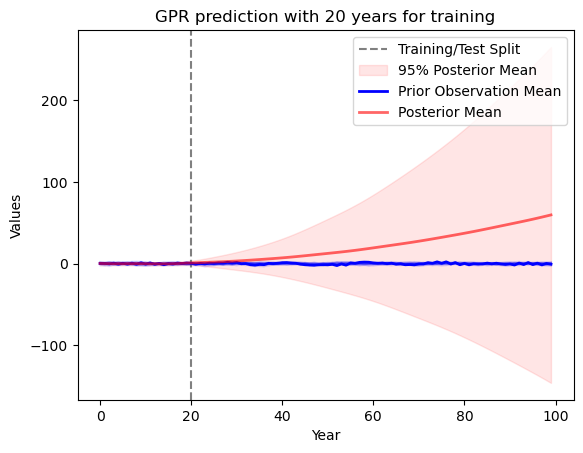

Optimization Progress:   0%|          | 0/200 [00:00<?, ?it/s]

|   iter    |  target   |    c1     |    c2     |    c3     |    c4     |    c5     | dp_sig... |    ls1    |    ls2    |    ls3    |   noise   |   per1    |   per2    |   per3    | rq_alpha  |   rq_ls   |
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
|  1        | -1.598e+0 |  3.808    |  9.512    |  7.347    |  6.027    |  1.645    |  1.561    |  0.5903   |  8.663    |  6.015    |  7.081    |  10.41    |  29.4     |  26.65    |  21.24    |  1.826    |
|  2        | -1.555e+0 |  1.916    |  3.112    |  5.295    |  4.376    |  2.983    |  6.119    |  1.404    |  2.929    |  3.67     |  4.561    |  25.7     |  13.99    |  20.28    |  59.25    |  0.474    |
|  3        | -1.543e+0 |  6.115    |  1.788    |  0.744    |  9.494    |  9.66     |  8.084    |  3.053    |  0.9857   |  6.845    |  4.402    |  12.44    |  19.9     |  10.69

Optimization Progress:   0%|          | 0/200 [00:06<?, ?it/s]

An error occurred during optimization: 'x0' must only have one dimension.
Best parameters found during the optimization process:  {'c1': 3.62412951864749, 'c2': 7.602676493597254, 'c3': 0.2424955374345831, 'c4': 1.2491191410184708, 'c5': 0.5554261560153523, 'dp_sigma_0': 0.40824729438738244, 'ls1': 8.556051234269962, 'ls2': 7.039542015206436, 'ls3': 4.746996552582378, 'noise': 0.9792437723493639, 'per1': 19.832317502336647, 'per2': 19.469435415611315, 'per3': 13.464037398200304, 'rq_alpha': 43.39082640730492, 'rq_ls': 3.9910622966297606}
Total log marginal likelihood for best parameters found during the optimization process:  -1014.3705517178571


total_lml_train: -1014.3705517178571
total_lml_test: -1473.0959572369616
total_lml_full: -2334.173252632828
best kernel is: 1.9**2 * DotProduct(sigma_0=0.408) ** 2 + 2.76**2 * ExpSineSquared(length_scale=8.56, periodicity=19.8) + 0.492**2 * ExpSineSquared(length_scale=7.04, periodicity=19.5) + 1.12**2 * ExpSineSquared(length_scale=4.75, periodicity=13.5) + 0.745**2 * RationalQuadratic(alpha=43.4, length_scale=3.99) + WhiteKernel(noise_level=0.979)
observation_lml_train: -63.35196910183623
observation_lml_test: -98.64419634358373
observation_lml_full: -152.5405736792019


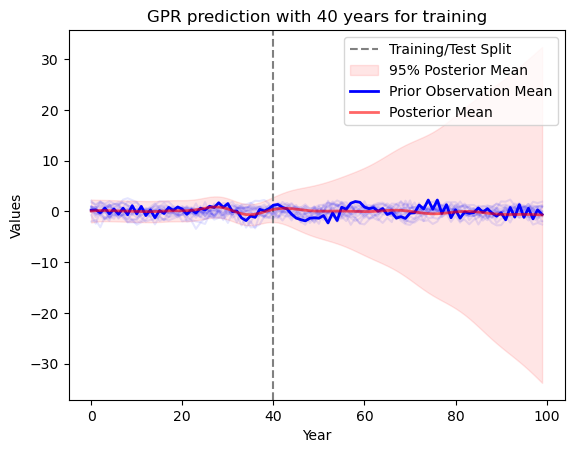

Optimization Progress:   0%|          | 0/200 [00:00<?, ?it/s]

|   iter    |  target   |    c1     |    c2     |    c3     |    c4     |    c5     | dp_sig... |    ls1    |    ls2    |    ls3    |   noise   |   per1    |   per2    |   per3    | rq_alpha  |   rq_ls   |
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
|  1        | -2.3e+03  |  3.808    |  9.512    |  7.347    |  6.027    |  1.645    |  1.561    |  0.5903   |  8.663    |  6.015    |  7.081    |  10.41    |  29.4     |  26.65    |  21.24    |  1.826    |
|  2        | -2.234e+0 |  1.916    |  3.112    |  5.295    |  4.376    |  2.983    |  6.119    |  1.404    |  2.929    |  3.67     |  4.561    |  25.7     |  13.99    |  20.28    |  59.25    |  0.474    |
|  3        | -2.211e+0 |  6.115    |  1.788    |  0.744    |  9.494    |  9.66     |  8.084    |  3.053    |  0.9857   |  6.845    |  4.402    |  12.44    |  19.9     |  10.69

Optimization Progress:   0%|          | 0/200 [00:06<?, ?it/s]

|  100      | -2.194e+0 |  3.728    |  4.022    |  6.985    |  3.947    |  4.542    |  2.376    |  3.739    |  2.28     |  0.7412   |  6.035    |  23.36    |  22.39    |  19.27    |  37.98    |  8.635    |
An error occurred during optimization: 'x0' must only have one dimension.
Best parameters found during the optimization process:  {'c1': 3.62412951864749, 'c2': 7.602676493597254, 'c3': 0.2424955374345831, 'c4': 1.2491191410184708, 'c5': 0.5554261560153523, 'dp_sigma_0': 0.40824729438738244, 'ls1': 8.556051234269962, 'ls2': 7.039542015206436, 'ls3': 4.746996552582378, 'noise': 0.9792437723493639, 'per1': 19.832317502336647, 'per2': 19.469435415611315, 'per3': 13.464037398200304, 'rq_alpha': 43.39082640730492, 'rq_ls': 3.9910622966297606}
Total log marginal likelihood for best parameters found during the optimization process:  -1461.099275768967


total_lml_train: -1461.099275768967
total_lml_test: -1046.6674710253214
total_lml_full: -2334.173252632828
best kernel is: 1.9**2 * DotProduct(sigma_0=0.408) ** 2 + 2.76**2 * ExpSineSquared(length_scale=8.56, periodicity=19.8) + 0.492**2 * ExpSineSquared(length_scale=7.04, periodicity=19.5) + 1.12**2 * ExpSineSquared(length_scale=4.75, periodicity=13.5) + 0.745**2 * RationalQuadratic(alpha=43.4, length_scale=3.99) + WhiteKernel(noise_level=0.979)
observation_lml_train: -93.68237332654715
observation_lml_test: -69.79478366933361
observation_lml_full: -152.5405736792019


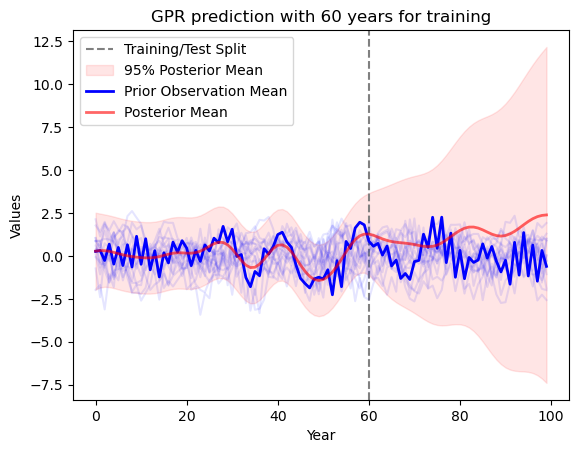

Optimization Progress:   0%|          | 0/200 [00:00<?, ?it/s]

|   iter    |  target   |    c1     |    c2     |    c3     |    c4     |    c5     | dp_sig... |    ls1    |    ls2    |    ls3    |   noise   |   per1    |   per2    |   per3    | rq_alpha  |   rq_ls   |
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
|  1        | -2.99e+03 |  3.808    |  9.512    |  7.347    |  6.027    |  1.645    |  1.561    |  0.5903   |  8.663    |  6.015    |  7.081    |  10.41    |  29.4     |  26.65    |  21.24    |  1.826    |
|  2        | -2.9e+03  |  1.916    |  3.112    |  5.295    |  4.376    |  2.983    |  6.119    |  1.404    |  2.929    |  3.67     |  4.561    |  25.7     |  13.99    |  20.28    |  59.25    |  0.474    |
|  3        | -2.872e+0 |  6.115    |  1.788    |  0.744    |  9.494    |  9.66     |  8.084    |  3.053    |  0.9857   |  6.845    |  4.402    |  12.44    |  19.9     |  10.69

Optimization Progress:   0%|          | 0/200 [00:09<?, ?it/s]

An error occurred during optimization: 'x0' must only have one dimension.
Best parameters found during the optimization process:  {'c1': 3.62412951864749, 'c2': 7.602676493597254, 'c3': 0.2424955374345831, 'c4': 1.2491191410184708, 'c5': 0.5554261560153523, 'dp_sigma_0': 0.40824729438738244, 'ls1': 8.556051234269962, 'ls2': 7.039542015206436, 'ls3': 4.746996552582378, 'noise': 0.9792437723493639, 'per1': 19.832317502336647, 'per2': 19.469435415611315, 'per3': 13.464037398200304, 'rq_alpha': 43.39082640730492, 'rq_ls': 3.9910622966297606}
Total log marginal likelihood for best parameters found during the optimization process:  -1900.1458442861358


total_lml_train: -1900.1458442861358
total_lml_test: -617.0796360100994
total_lml_full: -2334.173252632828
best kernel is: 1.9**2 * DotProduct(sigma_0=0.408) ** 2 + 2.76**2 * ExpSineSquared(length_scale=8.56, periodicity=19.8) + 0.492**2 * ExpSineSquared(length_scale=7.04, periodicity=19.5) + 1.12**2 * ExpSineSquared(length_scale=4.75, periodicity=13.5) + 0.745**2 * RationalQuadratic(alpha=43.4, length_scale=3.99) + WhiteKernel(noise_level=0.979)
observation_lml_train: -123.78322645306267
observation_lml_test: -40.912770898023226
observation_lml_full: -152.5405736792019


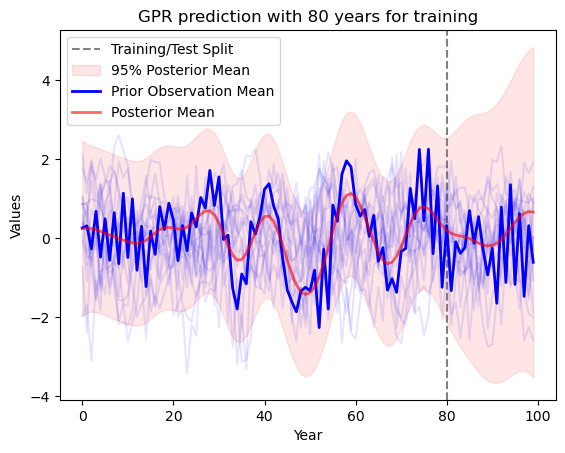

In [33]:
def pe3_poly_rq(best_params):
    kernel = (
        C(best_params['c1']) * (DotProduct(sigma_0=best_params['dp_sigma_0']) ** 2) +
        C(best_params['c2']) * ExpSineSquared(length_scale=best_params['ls1'], periodicity=best_params['per1']) +
        C(best_params['c3']) * ExpSineSquared(length_scale=best_params['ls2'], periodicity=best_params['per2']) +
        C(best_params['c4']) * ExpSineSquared(length_scale=best_params['ls3'], periodicity=best_params['per3']) +
        C(best_params['c5']) * RationalQuadratic(length_scale=best_params['rq_ls'], alpha=best_params['rq_alpha']) +
        WhiteKernel(noise_level=best_params['noise'])
    )
    return kernel

pbounds = {
        'c1': (1e-1, 1e1),
        'c2': (1e-1, 1e1),
        'c3': (1e-1, 1e1),
        'c4': (1e-1, 1e1),
        'c5': (1e-1, 1e1),
        'ls1': (1e-2, 1e1),
        'per1': (10, 30),
        'ls2': (1e-2, 1e1),
        'per2': (10, 30),
        'ls3': (1e-2, 1e1),
        'per3': (10, 30),
        'noise': (1e-3, 1e1),
        'dp_sigma_0': (1e-3, 1e1),
        'rq_alpha': (1e-2, 1e2),
        'rq_ls': (1e-2, 1e1),
    }
gpr_model(mod_ids, 20, rainfall_yearly, pbounds, pe3_poly_rq, oos_gcm)
gpr_model(mod_ids, 40, rainfall_yearly, pbounds, pe3_poly_rq, oos_gcm)
gpr_model(mod_ids, 60, rainfall_yearly, pbounds, pe3_poly_rq, oos_gcm)
gpr_model(mod_ids, 80, rainfall_yearly, pbounds, pe3_poly_rq, oos_gcm)

Optimization Progress:   0%|          | 0/200 [00:00<?, ?it/s]

|   iter    |  target   |    c1     |    c2     |    c3     |    c4     |    c5     | dp_sig... |    ls1    |    ls2    |    ls3    |   noise   |   per1    |   per2    |   per3    |   rbf_c   |  rbf_ls   | rq_alpha1 | rq_alpha2 | rq_alpha3 |  rq_ls1   |  rq_ls2   |  rq_ls3   |
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
|  1        | -3.295e+0 |  3.808    |  9.512    |  7.347    |  6.027    |  1.645    |  1.561    |  0.5903   |  8.663    |  6.015    |  7.081    |  10.41    |  29.4     |  26.65    |  2.202    |  1.826    |  18.35    |  30.43    |  52.48    |  4.325    |  2.919    |  6.122    |
|  2        | -3.068e+0 |  1.481    |  2.992    |  3.727    |  4.615    |  7.873    |  1.998    |  5.147    |  5.928    |  0.474    |  6.076    |  13.41    |  11.3   

Optimization Progress:   0%|          | 0/200 [00:14<?, ?it/s]

|  100      | -3.089e+0 |  7.743    |  0.369    |  0.7455   |  4.693    |  9.101    |  5.387    |  4.983    |  1.064    |  6.571    |  8.221    |  17.61    |  25.51    |  29.29    |  2.117    |  5.238    |  28.72    |  79.29    |  57.76    |  6.349    |  7.981    |  3.966    |
An error occurred during optimization: 'x0' must only have one dimension.
Best parameters found during the optimization process:  {'c1': 1.5973436044758522, 'c2': 2.3306376065172274, 'c3': 2.5845699472689505, 'c4': 8.521098972627264, 'c5': 5.656105603996997, 'dp_sigma_0': 5.2343857228322905, 'ls1': 1.1565410299734826, 'ls2': 8.602795536560855, 'ls3': 7.230914889052753, 'noise': 0.6776159506381159, 'per1': 24.156701944595373, 'per2': 20.870764346852923, 'per3': 11.634506914935566, 'rbf_c': 4.637176351133699, 'rbf_ls': 4.85211590842917, 'rq_alpha1': 16.585796270925943, 'rq_alpha2': 94.57035771855823, 'rq_alpha3': 84.99903739435139, 'rq_ls1': 6.693533149917792, 'rq_ls2': 4.628332654396066, 'rq_ls3': 4.12353776042924

total_lml_train: -2052.04476251303
total_lml_test: -656.7874156470892
total_lml_full: -2520.2199336026006
best kernel is: 1.26**2 * DotProduct(sigma_0=5.23) ** 2 + 1.53**2 * RationalQuadratic(alpha=16.6, length_scale=6.69) * ExpSineSquared(length_scale=1.16, periodicity=24.2) + 1.61**2 * ExpSineSquared(length_scale=8.6, periodicity=20.9) * RationalQuadratic(alpha=94.6, length_scale=4.63) + 2.92**2 * ExpSineSquared(length_scale=7.23, periodicity=11.6) * RationalQuadratic(alpha=85, length_scale=4.12) + 2.38**2 * RationalQuadratic(alpha=16.6, length_scale=6.69) + 2.15**2 * RBF(length_scale=4.85) + WhiteKernel(noise_level=0.678)


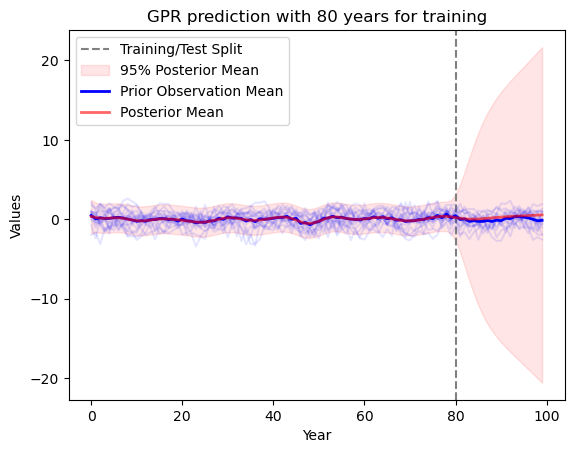

In [38]:
def rqpe2_poly_rq(best_params):
    kernel = (
        C(best_params['c1']) * (DotProduct(sigma_0=best_params['dp_sigma_0']) ** 2) +
        C(best_params['c2']) * RationalQuadratic(length_scale=best_params['rq_ls1'], alpha=best_params['rq_alpha1']) * ExpSineSquared(length_scale=best_params['ls1'], periodicity=best_params['per1']) +
        C(best_params['c3']) * ExpSineSquared(length_scale=best_params['ls2'], periodicity=best_params['per2']) * RationalQuadratic(length_scale=best_params['rq_ls2'], alpha=best_params['rq_alpha2']) +
        C(best_params['c4']) * ExpSineSquared(length_scale=best_params['ls3'], periodicity=best_params['per3']) * RationalQuadratic(length_scale=best_params['rq_ls3'], alpha=best_params['rq_alpha3']) +
        C(best_params['c5']) * RationalQuadratic(length_scale=best_params['rq_ls1'], alpha=best_params['rq_alpha1']) + C(best_params['rbf_c']) * RBF(length_scale=best_params['rbf_ls']) +
        WhiteKernel(noise_level=best_params['noise'])
    )
    return kernel

pbounds = {
    'c1': (1e-1, 1e1),
    'c2': (1e-1, 1e1),
    'c3': (1e-1, 1e1),
    'c4': (1e-1, 1e1),
    'c5': (1e-1, 1e1),
    'ls1': (1e-2, 1e1),
    'per1': (10, 30),
    'ls2': (1e-2, 1e1),
    'per2': (10, 30),
    'ls3': (1e-2, 1e1),
    'per3': (10, 30),
    'noise': (1e-3, 1e1),
    'dp_sigma_0': (1e-3, 1e1),
    'rq_alpha1': (1e-2, 1e2),
    'rq_ls1': (1e-2, 1e1),
    'rq_alpha2': (1e-2, 1e2),
    'rq_ls2': (1e-2, 1e1),
    'rq_alpha3': (1e-2, 1e2),
    'rq_ls3': (1e-2, 1e1),
    'rbf_c': (1e-1, 1e1),
    'rbf_ls': (1e-2, 1e1),
}
gpr_model(mod_ids, 80, rainfall_yearly, pbounds, rqpe2_poly_rq)

Optimization Progress:   0%|          | 0/200 [00:00<?, ?it/s]

|   iter    |  target   |    c1     |    c2     |    ls1    |    ls2    |    ls3    |   noise   |   per1    |   per2    |   per3    |
-------------------------------------------------------------------------------------------------------------------------------------
|  1        | -625.4    |  3.808    |  9.512    |  7.323    |  5.991    |  1.569    |  1.561    |  11.16    |  27.32    |  22.02    |
|  2        | -642.6    |  7.11     |  0.3038   |  9.699    |  8.326    |  2.131    |  1.819    |  13.67    |  16.08    |  20.5     |
|  3        | -708.0    |  4.376    |  2.983    |  6.122    |  1.404    |  2.929    |  3.664    |  19.12    |  25.7     |  13.99    |
|  4        | -602.3    |  5.191    |  5.965    |  0.474    |  6.079    |  1.714    |  0.6515   |  28.98    |  29.31    |  26.17    |
|  5        | -732.7    |  3.116    |  1.067    |  6.845    |  4.407    |  1.229    |  4.952    |  10.69    |  28.19    |  15.18    |
|  6        | -830.0    |  6.659    |  3.186    |  5.205    | 

Optimization Progress:   0%|          | 0/200 [00:04<?, ?it/s]

|  99       | -609.3    |  0.2951   |  1.131    |  8.001    |  1.794    |  6.531    |  2.383    |  11.99    |  14.86    |  24.45    |
|  100      | -711.8    |  8.571    |  8.319    |  3.978    |  6.684    |  2.058    |  2.932    |  27.93    |  10.26    |  11.71    |
An error occurred during optimization: 'x0' must only have one dimension.
Best parameters found during the optimization process:  {'c1': 0.15466895952366377, 'c2': 8.173068141702858, 'ls1': 7.071504865037695, 'ls2': 7.292781608729463, 'ls3': 7.714990763392598, 'noise': 0.7413724726891696, 'per1': 17.169314570885454, 'per2': 12.317381190502594, 'per3': 27.26206851751187}
Total log marginal likelihood for best parameters found during the optimization process:  -503.4699960929175


total_lml_train: -503.4699960929175
total_lml_test: -1981.3477341677365
total_lml_full: -2492.705421544157
best kernel is: 0.393**2 * DotProduct(sigma_0=1) ** 2 + 2.86**2 * ExpSineSquared(length_scale=7.07, periodicity=17.2) + 2.86**2 * ExpSineSquared(length_scale=7.29, periodicity=12.3) + 2.86**2 * ExpSineSquared(length_scale=7.71, periodicity=27.3) + WhiteKernel(noise_level=0.741)
observation_lml_train: -32.03321862085175
observation_lml_test: -126.29547060812371
observation_lml_full: -153.49012889251082


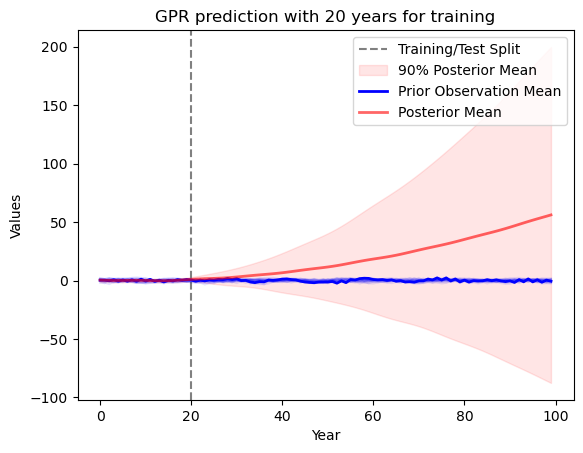

Optimization Progress:   0%|          | 0/200 [00:00<?, ?it/s]

|   iter    |  target   |    c1     |    c2     |    ls1    |    ls2    |    ls3    |   noise   |   per1    |   per2    |   per3    |
-------------------------------------------------------------------------------------------------------------------------------------
|  1        | -1.188e+0 |  3.808    |  9.512    |  7.323    |  5.991    |  1.569    |  1.561    |  11.16    |  27.32    |  22.02    |
|  2        | -1.174e+0 |  7.11     |  0.3038   |  9.699    |  8.326    |  2.131    |  1.819    |  13.67    |  16.08    |  20.5     |
|  3        | -1.315e+0 |  4.376    |  2.983    |  6.122    |  1.404    |  2.929    |  3.664    |  19.12    |  25.7     |  13.99    |
|  4        | -1.096e+0 |  5.191    |  5.965    |  0.474    |  6.079    |  1.714    |  0.6515   |  28.98    |  29.31    |  26.17    |
|  5        | -1.369e+0 |  3.116    |  1.067    |  6.845    |  4.407    |  1.229    |  4.952    |  10.69    |  28.19    |  15.18    |
|  6        | -1.564e+0 |  6.659    |  3.186    |  5.205    | 

Optimization Progress:   0%|          | 0/200 [00:05<?, ?it/s]

An error occurred during optimization: 'x0' must only have one dimension.
Best parameters found during the optimization process:  {'c1': 0.15466895952366377, 'c2': 8.173068141702858, 'ls1': 7.071504865037695, 'ls2': 7.292781608729463, 'ls3': 7.714990763392598, 'noise': 0.7413724726891696, 'per1': 17.169314570885454, 'per2': 12.317381190502594, 'per3': 27.26206851751187}
Total log marginal likelihood for best parameters found during the optimization process:  -941.1718765676469


total_lml_train: -941.1718765676469
total_lml_test: -1439.5871279686642
total_lml_full: -2492.705421544157
best kernel is: 0.393**2 * DotProduct(sigma_0=1) ** 2 + 2.86**2 * ExpSineSquared(length_scale=7.07, periodicity=17.2) + 2.86**2 * ExpSineSquared(length_scale=7.29, periodicity=12.3) + 2.86**2 * ExpSineSquared(length_scale=7.71, periodicity=27.3) + WhiteKernel(noise_level=0.741)
observation_lml_train: -59.665158629145154
observation_lml_test: -97.98707427997167
observation_lml_full: -153.49012889251082


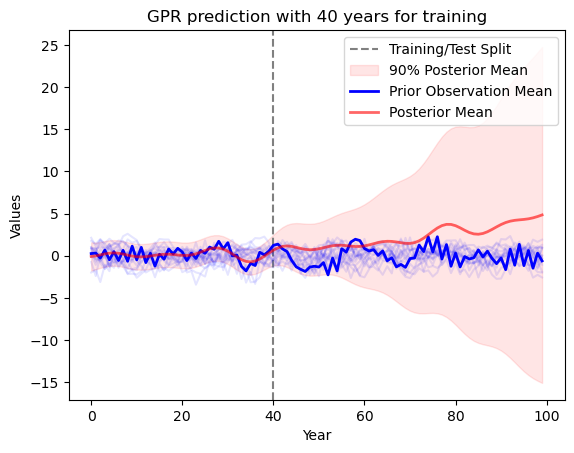

Optimization Progress:   0%|          | 0/200 [00:00<?, ?it/s]

|   iter    |  target   |    c1     |    c2     |    ls1    |    ls2    |    ls3    |   noise   |   per1    |   per2    |   per3    |
-------------------------------------------------------------------------------------------------------------------------------------
|  1        | -1.707e+0 |  3.808    |  9.512    |  7.323    |  5.991    |  1.569    |  1.561    |  11.16    |  27.32    |  22.02    |
|  2        | -1.683e+0 |  7.11     |  0.3038   |  9.699    |  8.326    |  2.131    |  1.819    |  13.67    |  16.08    |  20.5     |
|  3        | -1.898e+0 |  4.376    |  2.983    |  6.122    |  1.404    |  2.929    |  3.664    |  19.12    |  25.7     |  13.99    |
|  4        | -1.553e+0 |  5.191    |  5.965    |  0.474    |  6.079    |  1.714    |  0.6515   |  28.98    |  29.31    |  26.17    |
|  5        | -1.984e+0 |  3.116    |  1.067    |  6.845    |  4.407    |  1.229    |  4.952    |  10.69    |  28.19    |  15.18    |
|  6        | -2.275e+0 |  6.659    |  3.186    |  5.205    | 

Optimization Progress:   0%|          | 0/200 [00:05<?, ?it/s]

Total log marginal likelihood for best parameters found during the optimization process:  -1466.9555468830536


total_lml_train: -1466.9555468830536
total_lml_test: -1042.1376709562605
total_lml_full: -2346.6839001026983
best kernel is: 1.91**2 * DotProduct(sigma_0=1) ** 2 + 1.7**2 * ExpSineSquared(length_scale=5.43, periodicity=29.7) + 1.7**2 * ExpSineSquared(length_scale=1.42, periodicity=25.4) + 1.7**2 * ExpSineSquared(length_scale=8.02, periodicity=14) + WhiteKernel(noise_level=0.746)
observation_lml_train: -100.57090749625411
observation_lml_test: -71.34897864227514
observation_lml_full: -168.33883744959897


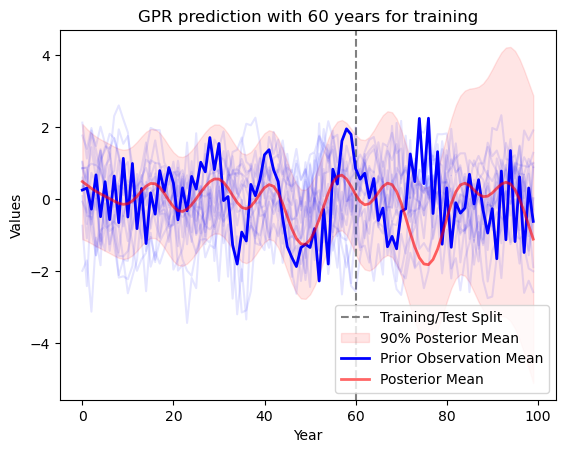

Optimization Progress:   0%|          | 0/200 [00:00<?, ?it/s]

|   iter    |  target   |    c1     |    c2     |    ls1    |    ls2    |    ls3    |   noise   |   per1    |   per2    |   per3    |
-------------------------------------------------------------------------------------------------------------------------------------
|  1        | -2.208e+0 |  3.808    |  9.512    |  7.323    |  5.991    |  1.569    |  1.561    |  11.16    |  27.32    |  22.02    |
|  2        | -2.187e+0 |  7.11     |  0.3038   |  9.699    |  8.326    |  2.131    |  1.819    |  13.67    |  16.08    |  20.5     |
|  3        | -2.465e+0 |  4.376    |  2.983    |  6.122    |  1.404    |  2.929    |  3.664    |  19.12    |  25.7     |  13.99    |
|  4        | -2.034e+0 |  5.191    |  5.965    |  0.474    |  6.079    |  1.714    |  0.6515   |  28.98    |  29.31    |  26.17    |
|  5        | -2.59e+03 |  3.116    |  1.067    |  6.845    |  4.407    |  1.229    |  4.952    |  10.69    |  28.19    |  15.18    |
|  6        | -2.974e+0 |  6.659    |  3.186    |  5.205    | 

Optimization Progress:   0%|          | 0/200 [00:07<?, ?it/s]


total_lml_train: -1919.315637510862
total_lml_test: -611.9910671917013
total_lml_full: -2346.6839001026983
best kernel is: 1.91**2 * DotProduct(sigma_0=1) ** 2 + 1.7**2 * ExpSineSquared(length_scale=5.43, periodicity=29.7) + 1.7**2 * ExpSineSquared(length_scale=1.42, periodicity=25.4) + 1.7**2 * ExpSineSquared(length_scale=8.02, periodicity=14) + WhiteKernel(noise_level=0.746)
observation_lml_train: -137.90388496180606
observation_lml_test: -42.243525228974185
observation_lml_full: -168.33883744959897


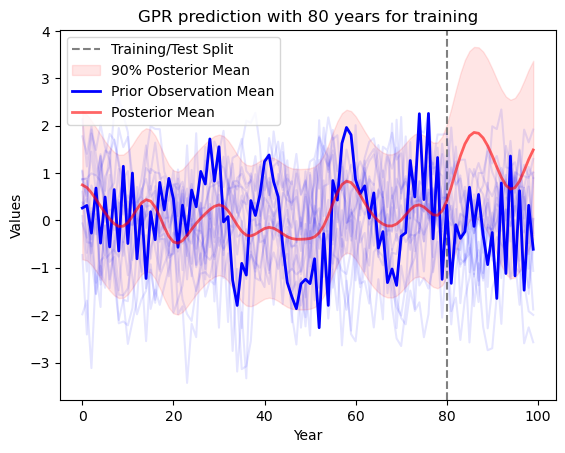

In [51]:
def pe3_poly(best_params):
    kernel = (
        C(best_params['c1']) * (DotProduct() ** 2) +
        C(best_params['c2']) * ExpSineSquared(length_scale=best_params['ls1'], periodicity=best_params['per1']) +
        C(best_params['c2']) * ExpSineSquared(length_scale=best_params['ls2'], periodicity=best_params['per2']) +
        C(best_params['c2']) * ExpSineSquared(length_scale=best_params['ls3'], periodicity=best_params['per3']) +
        WhiteKernel(noise_level=best_params['noise'])
    )
    return kernel

pbounds = {
    'c1': (1e-1, 1e1),
    'c2': (1e-1, 1e1),
    'ls1': (1e-2, 1e1),
    'per1': (10, 30),
    'ls2': (1e-2, 1e1),
    'per2': (10, 30),
    'ls3': (1e-2, 1e1),
    'per3': (10, 30),
    'noise': (1e-3, 1e1),
}
gpr_model(mod_ids, 20, rainfall_yearly, pbounds, pe3_poly, oos_gcm)
gpr_model(mod_ids, 40, rainfall_yearly, pbounds, pe3_poly, oos_gcm)
gpr_model(mod_ids, 60, rainfall_yearly, pbounds, pe3_poly, oos_gcm)
gpr_model(mod_ids, 80, rainfall_yearly, pbounds, pe3_poly, oos_gcm)

Optimization Progress:   0%|          | 0/200 [00:00<?, ?it/s]

|   iter    |  target   |    c1     |    c2     |    c3     |    c4     |    ls1    |    ls2    |    ls3    |   noise   |   per1    |   per2    |   per3    |
-------------------------------------------------------------------------------------------------------------------------------------------------------------
|  1        | -921.6    |  37.52    |  95.08    |  73.23    |  59.91    |  1.569    |  1.568    |  0.5903   |  0.8663   |  22.02    |  24.16    |  10.41    |
|  2        | -664.1    |  96.99    |  83.26    |  21.31    |  18.26    |  1.842    |  3.049    |  5.252    |  0.4325   |  15.82    |  22.24    |  12.79    |
|  3        | -783.1    |  29.29    |  36.7     |  45.66    |  78.54    |  2.005    |  5.147    |  5.928    |  0.0474   |  22.15    |  13.41    |  11.3     |
|  4        | -764.5    |  94.89    |  96.57    |  80.86    |  30.53    |  0.9857   |  6.845    |  4.407    |  0.1229   |  19.9     |  10.69    |  28.19    |
|  5        | -606.3    |  25.95    |  66.29    |  3

Optimization Progress:   0%|          | 0/200 [00:04<?, ?it/s]

|  100      | -620.6    |  23.24    |  94.28    |  65.0     |  60.81    |  5.132    |  2.314    |  1.774    |  0.2213   |  13.73    |  25.59    |  17.0     |
An error occurred during optimization: 'x0' must only have one dimension.
Best parameters found during the optimization process:  {'c1': 4.791900080827999, 'c2': 16.711708538732335, 'c3': 73.8295582809944, 'c4': 8.371586925720134, 'ls1': 6.035489573569218, 'ls2': 2.4610376057163963, 'ls3': 3.8990631842793455, 'noise': 0.28940504303392917, 'per1': 17.113454329298982, 'per2': 24.38091810368491, 'per3': 15.9424343124635}
Total log marginal likelihood for best parameters found during the optimization process:  -524.7026814837552


total_lml_train: -524.7026814837552
total_lml_test: -2018.3214707796897
total_lml_full: -2861.569315159019
best kernel is: 2.19**2 * DotProduct(sigma_0=1) ** 2 + 4.09**2 * ExpSineSquared(length_scale=6.04, periodicity=17.1) + 8.59**2 * ExpSineSquared(length_scale=2.46, periodicity=24.4) + 2.89**2 * ExpSineSquared(length_scale=3.9, periodicity=15.9) + WhiteKernel(noise_level=0.289)
observation_lml_train: -38.92266205681148
observation_lml_test: -153.16484082222894
observation_lml_full: -195.94066139640015


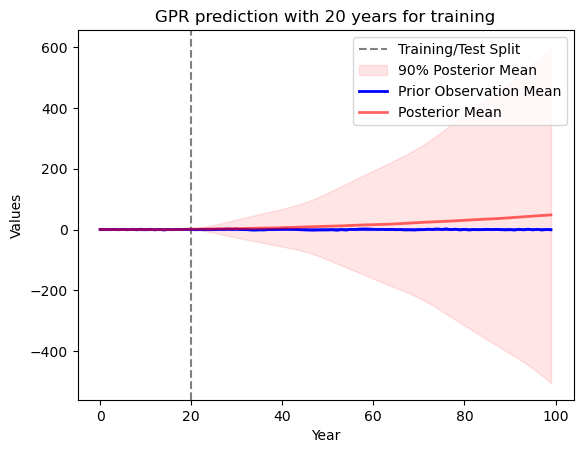

Optimization Progress:   0%|          | 0/200 [00:00<?, ?it/s]

|   iter    |  target   |    c1     |    c2     |    c3     |    c4     |    ls1    |    ls2    |    ls3    |   noise   |   per1    |   per2    |   per3    |
-------------------------------------------------------------------------------------------------------------------------------------------------------------
|  1        | -1.519e+0 |  37.52    |  95.08    |  73.23    |  59.91    |  1.569    |  1.568    |  0.5903   |  0.8663   |  22.02    |  24.16    |  10.41    |
|  2        | -1.122e+0 |  96.99    |  83.26    |  21.31    |  18.26    |  1.842    |  3.049    |  5.252    |  0.4325   |  15.82    |  22.24    |  12.79    |
|  3        | -1.57e+03 |  29.29    |  36.7     |  45.66    |  78.54    |  2.005    |  5.147    |  5.928    |  0.0474   |  22.15    |  13.41    |  11.3     |
|  4        | -1.296e+0 |  94.89    |  96.57    |  80.86    |  30.53    |  0.9857   |  6.845    |  4.407    |  0.1229   |  19.9     |  10.69    |  28.19    |
|  5        | -1.076e+0 |  25.95    |  66.29    |  3

Optimization Progress:   0%|          | 0/200 [00:05<?, ?it/s]

An error occurred during optimization: 'x0' must only have one dimension.
Best parameters found during the optimization process:  {'c1': 4.791900080827999, 'c2': 16.711708538732335, 'c3': 73.8295582809944, 'c4': 8.371586925720134, 'ls1': 6.035489573569218, 'ls2': 2.4610376057163963, 'ls3': 3.8990631842793455, 'noise': 0.28940504303392917, 'per1': 17.113454329298982, 'per2': 24.38091810368491, 'per3': 15.9424343124635}
Total log marginal likelihood for best parameters found during the optimization process:  -963.4547467328173


total_lml_train: -963.4547467328173
total_lml_test: -1406.6062320954045
total_lml_full: -2861.569315159019
best kernel is: 2.19**2 * DotProduct(sigma_0=1) ** 2 + 4.09**2 * ExpSineSquared(length_scale=6.04, periodicity=17.1) + 8.59**2 * ExpSineSquared(length_scale=2.46, periodicity=24.4) + 2.89**2 * ExpSineSquared(length_scale=3.9, periodicity=15.9) + WhiteKernel(noise_level=0.289)
observation_lml_train: -66.65876754842822
observation_lml_test: -110.37846258833761
observation_lml_full: -195.94066139640015


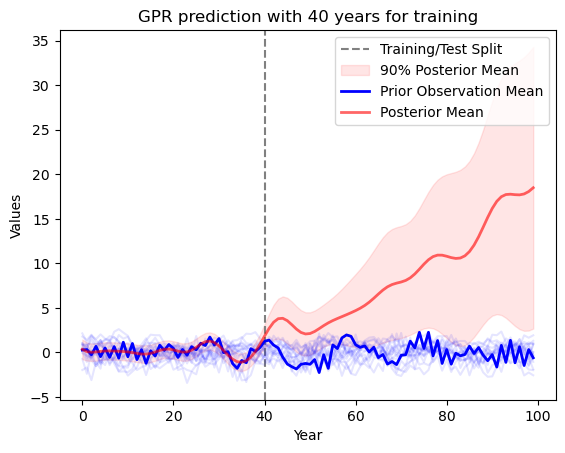

Optimization Progress:   0%|          | 0/200 [00:00<?, ?it/s]

|   iter    |  target   |    c1     |    c2     |    c3     |    c4     |    ls1    |    ls2    |    ls3    |   noise   |   per1    |   per2    |   per3    |
-------------------------------------------------------------------------------------------------------------------------------------------------------------
|  1        | -2.104e+0 |  37.52    |  95.08    |  73.23    |  59.91    |  1.569    |  1.568    |  0.5903   |  0.8663   |  22.02    |  24.16    |  10.41    |
|  2        | -1.577e+0 |  96.99    |  83.26    |  21.31    |  18.26    |  1.842    |  3.049    |  5.252    |  0.4325   |  15.82    |  22.24    |  12.79    |
|  3        | -3.537e+0 |  29.29    |  36.7     |  45.66    |  78.54    |  2.005    |  5.147    |  5.928    |  0.0474   |  22.15    |  13.41    |  11.3     |
|  4        | -2.234e+0 |  94.89    |  96.57    |  80.86    |  30.53    |  0.9857   |  6.845    |  4.407    |  0.1229   |  19.9     |  10.69    |  28.19    |
|  5        | -1.559e+0 |  25.95    |  66.29    |  3

Optimization Progress:   0%|          | 0/200 [00:05<?, ?it/s]

Total log marginal likelihood for best parameters found during the optimization process:  -1443.5244265340652


total_lml_train: -1443.5244265340652
total_lml_test: -1020.0404253582133
total_lml_full: -2507.022734043714
best kernel is: 4.02**2 * DotProduct(sigma_0=1) ** 2 + 7.41**2 * ExpSineSquared(length_scale=2.25, periodicity=24.9) + 8.32**2 * ExpSineSquared(length_scale=7.12, periodicity=23) + 8.08**2 * ExpSineSquared(length_scale=2.38, periodicity=27) + WhiteKernel(noise_level=0.326)
observation_lml_train: -108.77994280829375
observation_lml_test: -82.58909512176353
observation_lml_full: -216.48864249423963


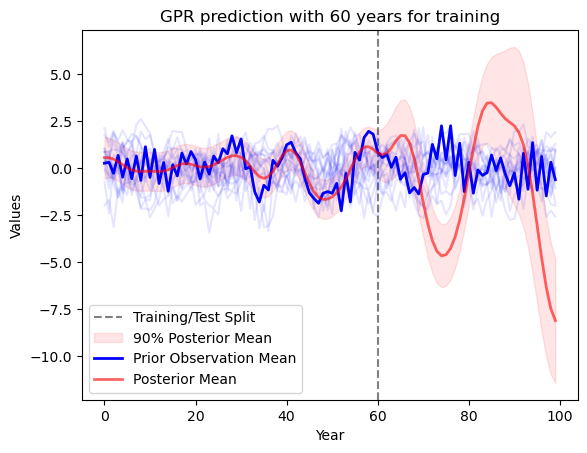

Optimization Progress:   0%|          | 0/200 [00:00<?, ?it/s]

|   iter    |  target   |    c1     |    c2     |    c3     |    c4     |    ls1    |    ls2    |    ls3    |   noise   |   per1    |   per2    |   per3    |
-------------------------------------------------------------------------------------------------------------------------------------------------------------
|  1        | -2.665e+0 |  37.52    |  95.08    |  73.23    |  59.91    |  1.569    |  1.568    |  0.5903   |  0.8663   |  22.02    |  24.16    |  10.41    |
|  2        | -2.131e+0 |  96.99    |  83.26    |  21.31    |  18.26    |  1.842    |  3.049    |  5.252    |  0.4325   |  15.82    |  22.24    |  12.79    |
|  3        | -6.309e+0 |  29.29    |  36.7     |  45.66    |  78.54    |  2.005    |  5.147    |  5.928    |  0.0474   |  22.15    |  13.41    |  11.3     |
|  4        | -3.312e+0 |  94.89    |  96.57    |  80.86    |  30.53    |  0.9857   |  6.845    |  4.407    |  0.1229   |  19.9     |  10.69    |  28.19    |
|  5        | -1.999e+0 |  25.95    |  66.29    |  3

Optimization Progress:   0%|          | 0/200 [00:07<?, ?it/s]

An error occurred during optimization: 'x0' must only have one dimension.
Best parameters found during the optimization process:  {'c1': 58.47299976111772, 'c2': 90.1256852480498, 'c3': 4.6400933961116415, 'c4': 28.168222640263814, 'ls1': 9.504610725924822, 'ls2': 8.903735201070255, 'ls3': 4.562010960329272, 'noise': 0.6205124652037352, 'per1': 15.547623659622653, 'per2': 13.762423194475225, 'per3': 19.273968098799642}
Total log marginal likelihood for best parameters found during the optimization process:  -1937.6842765084589


total_lml_train: -1937.6842765084589
total_lml_test: -649.832536516241
total_lml_full: -2359.943163816918
best kernel is: 7.65**2 * DotProduct(sigma_0=1) ** 2 + 9.49**2 * ExpSineSquared(length_scale=9.5, periodicity=15.5) + 2.15**2 * ExpSineSquared(length_scale=8.9, periodicity=13.8) + 5.31**2 * ExpSineSquared(length_scale=4.56, periodicity=19.3) + WhiteKernel(noise_level=0.621)
observation_lml_train: -125.60455290101547
observation_lml_test: -46.58570841328944
observation_lml_full: -153.40207199062502


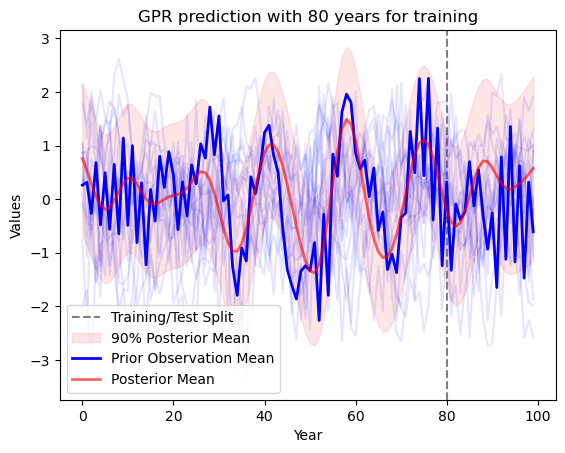

In [52]:
def pe3_poly(best_params):
    kernel = (
        C(best_params['c1']) * (DotProduct() ** 2) +
        C(best_params['c2']) * ExpSineSquared(length_scale=best_params['ls1'], periodicity=best_params['per1']) +
        C(best_params['c3']) * ExpSineSquared(length_scale=best_params['ls2'], periodicity=best_params['per2']) +
        C(best_params['c4']) * ExpSineSquared(length_scale=best_params['ls3'], periodicity=best_params['per3']) +
        WhiteKernel(noise_level=best_params['noise'])
    )
    return kernel

pbounds = {
    'c1': (1e-1, 1e2),
    'c2': (1e-1, 1e2),
    'c3': (1e-1, 1e2),
    'c4': (1e-1, 1e2),
    'ls1': (1e-2, 1e1),
    'per1': (10, 30),
    'ls2': (1e-2, 1e1),
    'per2': (10, 30),
    'ls3': (1e-2, 1e1),
    'per3': (10, 30),
    'noise': (1e-3, 1),
}
gpr_model(mod_ids, 20, rainfall_yearly, pbounds, pe3_poly, oos_gcm)
gpr_model(mod_ids, 40, rainfall_yearly, pbounds, pe3_poly, oos_gcm)
gpr_model(mod_ids, 60, rainfall_yearly, pbounds, pe3_poly, oos_gcm)
gpr_model(mod_ids, 80, rainfall_yearly, pbounds, pe3_poly, oos_gcm)

Optimization Progress:   0%|          | 0/200 [00:00<?, ?it/s]

|   iter    |  target   |    c1     |    c2     |    c3     |    c4     | dp_sig... |    ls1    |    ls2    |    ls3    |   noise   |   per1    |   per2    |   per3    |  rbf_ls   | rbf_rq_c  | rq_alpha1 | rq_alpha2 | rq_alpha3 | rq_alp... |  rq_ls1   |  rq_ls2   |  rq_ls3   | rq_ls_rbf |
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
|  1        | -3.206e+0 |  3.808    |  9.512    |  7.347    |  6.027    |  1.561    |  1.568    |  0.5903   |  8.663    |  6.012    |  24.16    |  10.41    |  29.4     |  8.326    |  2.202    |  18.19    |  18.35    |  30.43    |  52.48    |  4.325    |  2.919    |  6.122    |  1.404    |
|  2        | -3.348e+0 |  2.992    |  3.727    |  4.615    |  7.873    |  1.998    |  5.147    |  5.928    |  0.474    |  6.076  

Optimization Progress:   0%|          | 0/200 [00:12<?, ?it/s]

|  100      | -3.129e+0 |  6.972    |  5.175    |  3.123    |  2.205    |  0.3329   |  3.046    |  6.535    |  9.384    |  8.712    |  25.32    |  25.77    |  23.3     |  2.61     |  9.081    |  67.08    |  56.05    |  11.11    |  44.71    |  4.609    |  8.647    |  5.471    |  3.81     |
An error occurred during optimization: 'x0' must only have one dimension.
Best parameters found during the optimization process:  {'c1': 9.118179126489041, 'c2': 8.243118704939373, 'c3': 9.503019141590048, 'c4': 7.2846231330447635, 'dp_sigma_0': 6.1345385441619635, 'ls1': 4.188247932543282, 'ls2': 9.327957548706593, 'ls3': 8.66197825610908, 'noise': 0.4531414823917879, 'per1': 10.52733948994504, 'per2': 17.52926733756099, 'per3': 26.211066615636657, 'rbf_ls': 9.872888531856296, 'rbf_rq_c': 1.589127221924929, 'rq_alpha1': 59.41713022805999, 'rq_alpha2': 38.09527675453584, 'rq_alpha3': 96.99174063748218, 'rq_alpha_rbf': 84.2134711243395, 'rq_ls1': 8.384903760064267, 'rq_ls2': 4.692244666351753, 'rq_ls3'

total_lml_train: -2051.1010907303603
total_lml_test: -676.9545680106663
total_lml_full: -2509.0894204647707
best kernel is: 3.02**2 * DotProduct(sigma_0=6.13) ** 2 + 2.87**2 * RationalQuadratic(alpha=59.4, length_scale=8.38) * ExpSineSquared(length_scale=4.19, periodicity=10.5) + 3.08**2 * ExpSineSquared(length_scale=9.33, periodicity=17.5) * RationalQuadratic(alpha=38.1, length_scale=4.69) + 2.7**2 * ExpSineSquared(length_scale=8.66, periodicity=26.2) * RationalQuadratic(alpha=97, length_scale=4.15) + 1.26**2 * RBF(length_scale=9.87) * RationalQuadratic(alpha=84.2, length_scale=2.74) + WhiteKernel(noise_level=0.453)


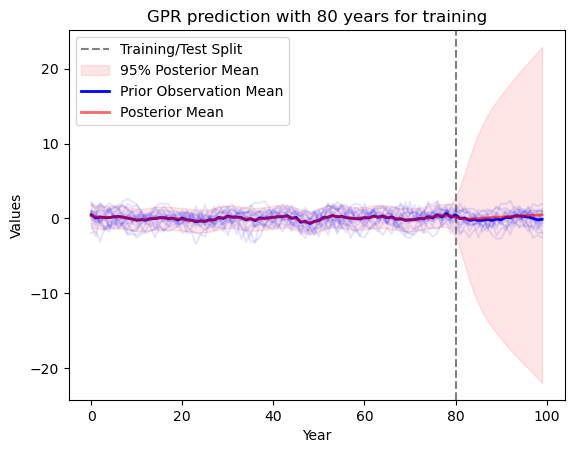

In [40]:
def rqpe3_poly_rqrbf(best_params):
    kernel = (
        C(best_params['c1']) * (DotProduct(sigma_0=best_params['dp_sigma_0']) ** 2) +
        C(best_params['c2']) * RationalQuadratic(length_scale=best_params['rq_ls1'], alpha=best_params['rq_alpha1']) * ExpSineSquared(length_scale=best_params['ls1'], periodicity=best_params['per1']) +
        C(best_params['c3']) * ExpSineSquared(length_scale=best_params['ls2'], periodicity=best_params['per2']) * RationalQuadratic(length_scale=best_params['rq_ls2'], alpha=best_params['rq_alpha2']) +
        C(best_params['c4']) * ExpSineSquared(length_scale=best_params['ls3'], periodicity=best_params['per3']) * RationalQuadratic(length_scale=best_params['rq_ls3'], alpha=best_params['rq_alpha3']) +
        C(best_params['rbf_rq_c']) * RBF(length_scale=best_params['rbf_ls']) * RationalQuadratic(length_scale=best_params['rq_ls_rbf'], alpha=best_params['rq_alpha_rbf']) +
        WhiteKernel(noise_level=best_params['noise'])
    )
    return kernel

pbounds = {
    'c1': (1e-1, 1e1),
    'c2': (1e-1, 1e1),
    'c3': (1e-1, 1e1),
    'c4': (1e-1, 1e1),
    'ls1': (1e-2, 1e1),
    'per1': (10, 30),
    'ls2': (1e-2, 1e1),
    'per2': (10, 30),
    'ls3': (1e-2, 1e1),
    'per3': (10, 30),
    'noise': (1e-3, 1e1),
    'dp_sigma_0': (1e-3, 1e1),
    'rq_alpha1': (1e-2, 1e2),
    'rq_ls1': (1e-2, 1e1),
    'rq_alpha2': (1e-2, 1e2),
    'rq_ls2': (1e-2, 1e1),
    'rq_alpha3': (1e-2, 1e2),
    'rq_ls3': (1e-2, 1e1),
    'rbf_rq_c': (1e-1, 1e1),
    'rbf_ls': (1e-2, 1e1),
    'rq_alpha_rbf': (1e-2, 1e2),
    'rq_ls_rbf': (1e-2, 1e1),
}
gpr_model(mod_ids, 80, rainfall_yearly, pbounds, rqpe3_poly_rqrbf)

Optimization Progress:   0%|          | 0/200 [00:00<?, ?it/s]

|   iter    |  target   |    c1     |    c2     |    c3     |    c4     |    c5     |    c6     |    ls1    |    ls2    |    ls3    |    ls4    |    ls5    |   noise   |   per1    |   per2    |   per3    |  rbf_ls   | rbf_rq_c  | rq_alpha1 | rq_alp... |  rq_ls1   | rq_ls_rbf |
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
|  1        | -3.075e+0 |  3.808    |  9.512    |  7.347    |  6.027    |  1.645    |  1.644    |  0.5903   |  8.663    |  6.015    |  7.084    |  0.2156   |  9.699    |  26.65    |  14.25    |  13.64    |  1.842    |  3.112    |  52.48    |  43.2     |  2.919    |  6.122    |
|  2        | -2.153e+0 |  1.481    |  2.992    |  3.727    |  4.615    |  7.873    |  2.077    |  5.147    |  5.928    |  0.474    |  6.079    |  1.714    |  0.6515 

Optimization Progress:   0%|          | 0/200 [00:13<?, ?it/s]

|  100      | -2.929e+0 |  7.743    |  0.369    |  0.7455   |  4.693    |  9.101    |  5.433    |  4.983    |  1.064    |  6.571    |  8.223    |  3.81     |  7.756    |  29.29    |  14.08    |  20.47    |  2.879    |  7.949    |  57.76    |  63.46    |  7.981    |  3.966    |
An error occurred during optimization: 'x0' must only have one dimension.
Best parameters found during the optimization process:  {'c1': 3.795192737130467, 'c2': 2.3499693099052, 'c3': 0.824639645307592, 'c4': 6.074141074475641, 'c5': 6.715306705694661, 'c6': 6.232954425495183, 'ls1': 4.640305497567717, 'ls2': 3.804059943990506, 'ls3': 8.634703159222534, 'ls4': 5.195627033510818, 'ls5': 4.7970269575210125, 'noise': 0.25739501599855047, 'per1': 16.824956552523126, 'per2': 17.60391237571714, 'per3': 17.976455617938008, 'rbf_ls': 5.80592196858105, 'rbf_rq_c': 5.3826652125960965, 'rq_alpha1': 60.79443022841652, 'rq_alpha_rbf': 76.4906773215974, 'rq_ls1': 8.131727529773773, 'rq_ls_rbf': 7.184049531502679}


total_lml_train: -1608.5498473360424
total_lml_test: -428.950621421955
total_lml_full: -2006.3522220980326
best kernel is: 1.95**2 * RationalQuadratic(alpha=60.8, length_scale=8.13) + 2.32**2 * RBF(length_scale=5.81) * RationalQuadratic(alpha=76.5, length_scale=7.18) + 1.53**2 * ExpSineSquared(length_scale=4.64, periodicity=16.8) + 0.908**2 * ExpSineSquared(length_scale=3.8, periodicity=17.6) + 2.46**2 * ExpSineSquared(length_scale=8.63, periodicity=18) + 2.59**2 * RBF(length_scale=5.2) + 2.5**2 * RBF(length_scale=4.8) + WhiteKernel(noise_level=0.257)


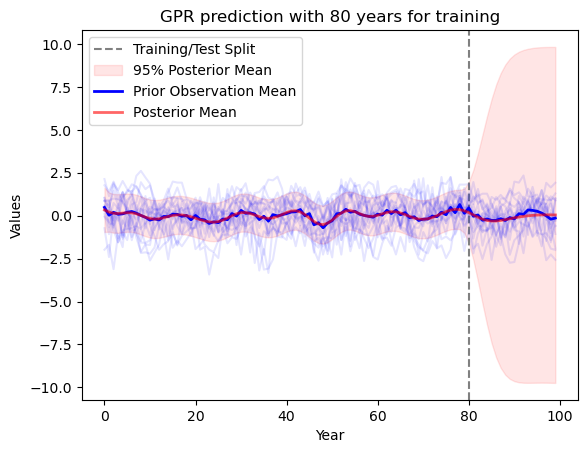

In [41]:
def pe3_rbf2_rqrbf_rq(best_params):
    kernel = (
        C(best_params['c1']) * RationalQuadratic(length_scale=best_params['rq_ls1'], alpha=best_params['rq_alpha1']) +
        C(best_params['rbf_rq_c']) * RBF(length_scale=best_params['rbf_ls']) * RationalQuadratic(length_scale=best_params['rq_ls_rbf'], alpha=best_params['rq_alpha_rbf']) +
        C(best_params['c2']) * ExpSineSquared(length_scale=best_params['ls1'], periodicity=best_params['per1']) +
        C(best_params['c3']) * ExpSineSquared(length_scale=best_params['ls2'], periodicity=best_params['per2']) +
        C(best_params['c4']) * ExpSineSquared(length_scale=best_params['ls3'], periodicity=best_params['per3']) +
        C(best_params['c5']) * RBF(length_scale=best_params['ls4']) +
        C(best_params['c6']) * RBF(length_scale=best_params['ls5']) +
        WhiteKernel(noise_level=best_params['noise'])
    )
    return kernel

pbounds = {
    'c1': (1e-1, 1e1),
    'c2': (1e-1, 1e1),
    'c3': (1e-1, 1e1),
    'c4': (1e-1, 1e1),
    'c5': (1e-1, 1e1),
    'c6': (1e-1, 1e1),
    'ls1': (1e-2, 1e1),
    'per1': (10, 30),
    'ls2': (1e-2, 1e1),
    'per2': (10, 30),
    'ls3': (1e-2, 1e1),
    'per3': (10, 30),
    'ls4': (1e-2, 1e1),
    'ls5': (1e-2, 1e1),
    'noise': (1e-3, 1e1),
    'rq_alpha1': (1e-2, 1e2),
    'rq_ls1': (1e-2, 1e1),
    'rbf_rq_c': (1e-1, 1e1),
    'rbf_ls': (1e-2, 1e1),
    'rq_alpha_rbf': (1e-2, 1e2),
    'rq_ls_rbf': (1e-2, 1e1),
}

gpr_model(mod_ids, 80, rainfall_yearly, pbounds, pe3_rbf2_rqrbf_rq)

Optimization Progress:   0%|          | 0/200 [00:00<?, ?it/s]

|   iter    |  target   |    c1     |    c2     |    c3     |    c4     |    c5     |    ls1    |    ls2    |    ls3    |    ls4    |   noise   |   per1    |   per2    |  rbf_ls   | rbf_rq_c  | rq_alpha1 | rq_alp... |  rq_ls1   | rq_ls_rbf |
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
|  1        | -2.857e+0 |  3.808    |  9.512    |  7.347    |  6.027    |  1.645    |  1.568    |  0.5903   |  8.663    |  6.015    |  7.081    |  10.41    |  29.4     |  8.326    |  2.202    |  18.19    |  18.35    |  3.049    |  5.252    |
|  2        | -2.615e+0 |  4.376    |  2.983    |  6.157    |  1.481    |  2.992    |  3.67     |  4.566    |  7.854    |  2.005    |  5.143    |  21.85    |  10.93    |  6.079    |  1.788    |  6.515    |  94.89    |  9.657    |  8.086    |
|  3        | -2.822e+0 |  3.116

Optimization Progress:   0%|          | 0/200 [00:11<?, ?it/s]

|  99       | -2.954e+0 |  1.585    |  3.314    |  7.4      |  4.813    |  3.821    |  3.951    |  4.6      |  7.852    |  8.922    |  9.553    |  25.74    |  16.31    |  6.884    |  4.432    |  25.47    |  84.09    |  0.3939   |  9.019    |
|  100      | -3.146e+0 |  4.669    |  6.408    |  6.628    |  8.962    |  6.403    |  6.143    |  0.6759   |  5.189    |  1.51     |  7.375    |  20.24    |  23.6     |  0.4263   |  0.9394   |  71.64    |  7.218    |  0.7219   |  0.131    |
An error occurred during optimization: 'x0' must only have one dimension.
Best parameters found during the optimization process:  {'c1': 0.2820676978199207, 'c2': 9.15155818494894, 'c3': 1.2657357206123974, 'c4': 5.80751310759111, 'c5': 2.8131466848033395, 'ls1': 5.546238245132776, 'ls2': 6.517689679635123, 'ls3': 8.299120619034944, 'ls4': 2.072148504888426, 'noise': 0.1109472907561463, 'per1': 12.737712601376145, 'per2': 28.0003728369621, 'rbf_ls': 8.740161874849527, 'rbf_rq_c': 6.014389711486052, 'rq_alpha1':

total_lml_train: -2022.9550981159084
total_lml_test: -534.1935898931521
total_lml_full: -2543.3207951229974
best kernel is: 0.531**2 * RationalQuadratic(alpha=60.1, length_scale=1.76) + 2.45**2 * RBF(length_scale=8.74) * RationalQuadratic(alpha=66.5, length_scale=9.14) + 3.03**2 * ExpSineSquared(length_scale=5.55, periodicity=12.7) + 1.13**2 * ExpSineSquared(length_scale=6.52, periodicity=28) + 2.41**2 * RBF(length_scale=8.3) + 1.68**2 * RBF(length_scale=2.07) + WhiteKernel(noise_level=0.111)


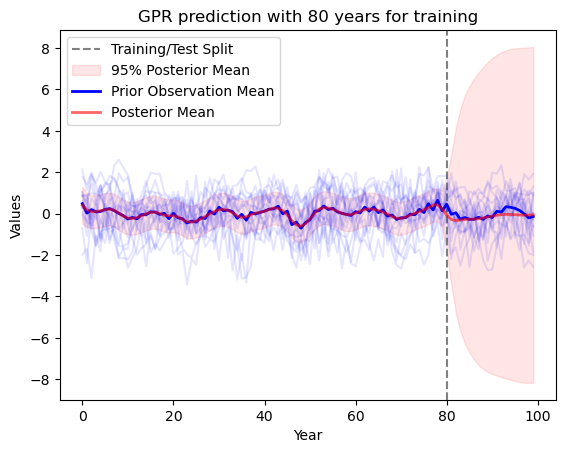

In [42]:
def pe2_rbf2_rqrbf_rq(best_params):
    kernel = (
        C(best_params['c1']) * RationalQuadratic(length_scale=best_params['rq_ls1'], alpha=best_params['rq_alpha1']) +
        C(best_params['rbf_rq_c']) * RBF(length_scale=best_params['rbf_ls']) * RationalQuadratic(length_scale=best_params['rq_ls_rbf'], alpha=best_params['rq_alpha_rbf']) +
        C(best_params['c2']) * ExpSineSquared(length_scale=best_params['ls1'], periodicity=best_params['per1']) +
        C(best_params['c3']) * ExpSineSquared(length_scale=best_params['ls2'], periodicity=best_params['per2']) +
        C(best_params['c4']) * RBF(length_scale=best_params['ls3']) +
        C(best_params['c5']) * RBF(length_scale=best_params['ls4']) +
        WhiteKernel(noise_level=best_params['noise'])
    )
    return kernel

pbounds = {
    'c1': (1e-1, 1e1),
    'c2': (1e-1, 1e1),
    'c3': (1e-1, 1e1),
    'c4': (1e-1, 1e1),
    'c5': (1e-1, 1e1),
    'ls1': (1e-2, 1e1),
    'per1': (10, 30),
    'ls2': (1e-2, 1e1),
    'per2': (10, 30),
    'ls3': (1e-2, 1e1),
    'ls4': (1e-2, 1e1),
    'noise': (1e-3, 1e1),
    'rq_alpha1': (1e-2, 1e2),
    'rq_ls1': (1e-2, 1e1),
    'rbf_rq_c': (1e-1, 1e1),
    'rbf_ls': (1e-2, 1e1),
    'rq_alpha_rbf': (1e-2, 1e2),
    'rq_ls_rbf': (1e-2, 1e1),
}

gpr_model(mod_ids, 80, rainfall_yearly, pbounds, pe2_rbf2_rqrbf_rq)

Optimization Progress:   0%|          | 0/200 [00:00<?, ?it/s]

|   iter    |  target   |    c1     |    c2     |    c3     |    c4     |    ls1    |    ls2    |    ls3    |   noise   |   per1    |   per2    |  rbf_ls   | rbf_rq_c  | rq_alpha1 | rq_alp... |  rq_ls1   | rq_ls_rbf |
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
|  1        | -3.374e+0 |  3.808    |  9.512    |  7.347    |  6.027    |  1.569    |  1.568    |  0.5903   |  8.662    |  22.02    |  24.16    |  0.2156   |  9.702    |  83.25    |  21.24    |  1.826    |  1.842    |
|  2        | -2.633e+0 |  3.112    |  5.295    |  4.376    |  2.983    |  6.122    |  1.404    |  2.929    |  3.664    |  19.12    |  25.7     |  2.005    |  5.191    |  59.25    |  4.655    |  6.079    |  1.714    |
|  3        | -3.104e+0 |  0.744    |  9.494    |  9.66     |  8.103    |  3.053    |  0.9857   |  6.845    |  4.402    |  12.44

Optimization Progress:   0%|          | 0/200 [00:09<?, ?it/s]

|  100      | -3.179e+0 |  9.879    |  1.451    |  6.982    |  4.103    |  4.288    |  7.179    |  6.927    |  9.913    |  12.57    |  12.08    |  7.246    |  5.826    |  27.42    |  7.951    |  0.8657   |  8.943    |
An error occurred during optimization: 'x0' must only have one dimension.
Best parameters found during the optimization process:  {'c1': 7.004967470525908, 'c2': 6.833393640426974, 'c3': 6.224252644330324, 'c4': 7.551894731620648, 'ls1': 1.5944650018778064, 'ls2': 8.809898884397295, 'ls3': 8.719716842174867, 'noise': 0.2934435830625569, 'per1': 26.516335011295254, 'per2': 12.577397349468903, 'rbf_ls': 3.3578373540488275, 'rbf_rq_c': 7.460731737286917, 'rq_alpha1': 16.08438200587034, 'rq_alpha_rbf': 81.79852274166502, 'rq_ls1': 8.323020437797842, 'rq_ls_rbf': 5.079602660270753}


total_lml_train: -1758.127384889232
total_lml_test: -465.81782514430967
total_lml_full: -2196.4355313168153
best kernel is: 2.65**2 * RationalQuadratic(alpha=16.1, length_scale=8.32) + 2.73**2 * RBF(length_scale=3.36) * RationalQuadratic(alpha=81.8, length_scale=5.08) + 2.61**2 * ExpSineSquared(length_scale=1.59, periodicity=26.5) + 2.49**2 * ExpSineSquared(length_scale=8.81, periodicity=12.6) + 2.75**2 * RBF(length_scale=8.72) + WhiteKernel(noise_level=0.293)


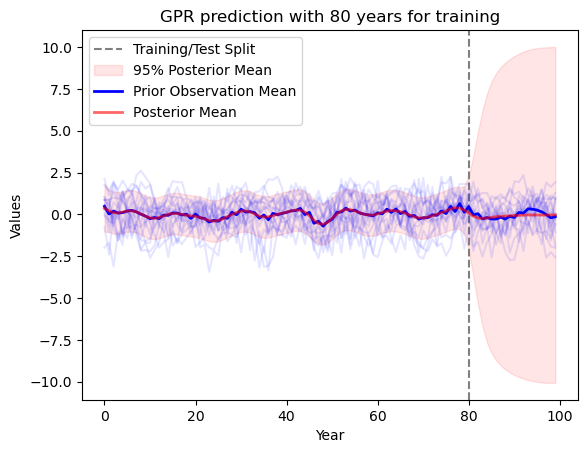

In [43]:
def pe2_rbf1_rqrbf_rq(best_params):
    kernel = (
        C(best_params['c1']) * RationalQuadratic(length_scale=best_params['rq_ls1'], alpha=best_params['rq_alpha1']) +
        C(best_params['rbf_rq_c']) * RBF(length_scale=best_params['rbf_ls']) * RationalQuadratic(length_scale=best_params['rq_ls_rbf'], alpha=best_params['rq_alpha_rbf']) +
        C(best_params['c2']) * ExpSineSquared(length_scale=best_params['ls1'], periodicity=best_params['per1']) +
        C(best_params['c3']) * ExpSineSquared(length_scale=best_params['ls2'], periodicity=best_params['per2']) +
        C(best_params['c4']) * RBF(length_scale=best_params['ls3']) +
        WhiteKernel(noise_level=best_params['noise'])
    )
    return kernel

pbounds = {
    'c1': (1e-1, 1e1),
    'c2': (1e-1, 1e1),
    'c3': (1e-1, 1e1),
    'c4': (1e-1, 1e1),
    'ls1': (1e-2, 1e1),
    'per1': (10, 30),
    'ls2': (1e-2, 1e1),
    'per2': (10, 30),
    'ls3': (1e-2, 1e1),
    'noise': (1e-3, 1e1),
    'rq_alpha1': (1e-2, 1e2),
    'rq_ls1': (1e-2, 1e1),
    'rbf_rq_c': (1e-1, 1e1),
    'rbf_ls': (1e-2, 1e1),
    'rq_alpha_rbf': (1e-2, 1e2),
    'rq_ls_rbf': (1e-2, 1e1),
}

gpr_model(mod_ids, 80, rainfall_yearly, pbounds, pe2_rbf1_rqrbf_rq)


Optimization Progress:   0%|          | 0/200 [00:00<?, ?it/s]

|   iter    |  target   |    c1     |    c2     |    c3     |    c4     |    ls1    |    ls2    |    ls3    |   noise   |   per1    |   per2    |  rbf_ls1  |
-------------------------------------------------------------------------------------------------------------------------------------------------------------
|  1        | -3.154e+0 |  3.808    |  9.512    |  7.347    |  6.027    |  1.569    |  1.568    |  0.5903   |  8.662    |  22.02    |  24.16    |  0.2156   |
|  2        | -2.757e+0 |  9.702    |  8.341    |  2.202    |  1.9      |  1.842    |  3.049    |  5.252    |  4.32     |  15.82    |  22.24    |  1.404    |
|  3        | -2.269e+0 |  2.992    |  3.727    |  4.615    |  7.873    |  2.005    |  5.147    |  5.928    |  0.4655   |  22.15    |  13.41    |  0.6599   |
|  4        | -2.018e+0 |  9.494    |  9.66     |  8.103    |  3.116    |  0.9857   |  6.845    |  4.407    |  1.221    |  19.9     |  10.69    |  9.094    |
|  5        | -2.729e+0 |  2.662    |  6.659    |  3

Optimization Progress:   0%|          | 0/200 [00:06<?, ?it/s]

An error occurred during optimization: 'x0' must only have one dimension.
Best parameters found during the optimization process:  {'c1': 9.302338528053475, 'c2': 8.323132137098519, 'c3': 9.653766415598474, 'c4': 1.330542512506893, 'ls1': 7.311366077284406, 'ls2': 9.384021163642169, 'ls3': 1.8205183309949449, 'noise': 0.6658961774004082, 'per1': 24.82241298580118, 'per2': 21.489462263598238, 'rbf_ls1': 8.419869479815137}


total_lml_train: -1805.251338070156
total_lml_test: -467.9580599713273
total_lml_full: -2251.2147583319875
best kernel is: 3.05**2 * RBF(length_scale=8.42) + 2.88**2 * ExpSineSquared(length_scale=7.31, periodicity=24.8) + 3.11**2 * ExpSineSquared(length_scale=9.38, periodicity=21.5) + 1.15**2 * RBF(length_scale=1.82) + WhiteKernel(noise_level=0.666)


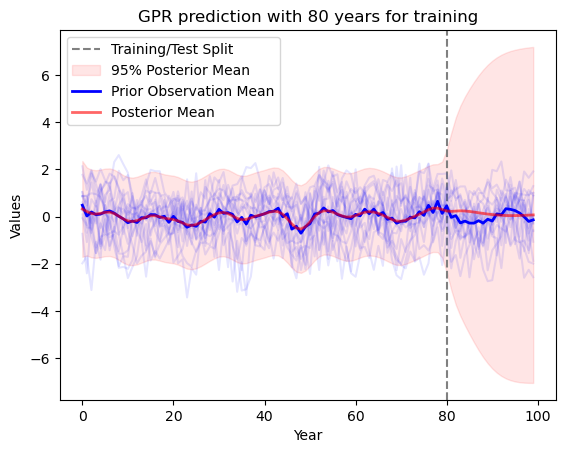

In [44]:
def pe2_rbf2(best_params):
    kernel = (
        C(best_params['c1']) * RBF(length_scale=best_params['rbf_ls1']) +
        C(best_params['c2']) * ExpSineSquared(length_scale=best_params['ls1'], periodicity=best_params['per1']) +
        C(best_params['c3']) * ExpSineSquared(length_scale=best_params['ls2'], periodicity=best_params['per2']) +
        C(best_params['c4']) * RBF(length_scale=best_params['ls3']) +
        WhiteKernel(noise_level=best_params['noise'])
    )
    return kernel

pbounds = {
    'c1': (1e-1, 1e1),
    'c2': (1e-1, 1e1),
    'c3': (1e-1, 1e1),
    'c4': (1e-1, 1e1),
    'ls1': (1e-2, 1e1),
    'per1': (10, 30),
    'ls2': (1e-2, 1e1),
    'per2': (10, 30),
    'ls3': (1e-2, 1e1),
    'rbf_ls1': (1e-2, 1e1),
    'noise': (1e-3, 1e1)
}

gpr_model(mod_ids, 80, rainfall_yearly, pbounds, pe2_rbf2)

Optimization Progress:   0%|          | 0/200 [00:00<?, ?it/s]

|   iter    |  target   |    c1     |    c2     |    c3     |    c4     |    c5     |    ls1    |    ls2    |   noise   |   per1    |   per2    |  rbf_ls1  |  rbf_ls2  |  rbf_ls3  |
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
|  1        | -400.5    |  0.02377  |  0.02419  |  0.09869  |  0.914    |  0.2675   |  2.684    |  3.347    |  0.6449   |  15.03    |  22.7     |  5.802    |  6.192    |  3.684    |
|  2        | -456.2    |  0.03324  |  0.02749  |  0.05973  |  0.8431   |  0.5531   |  6.879    |  7.598    |  0.6427   |  17.7     |  11.6     |  8.077    |  8.117    |  0.5178   |
|  3        | -433.1    |  0.06348  |  0.09714  |  0.09876  |  0.8378   |  0.7209   |  6.236    |  5.996    |  0.6819   |  26.77    |  19.2     |  5.482    |  9.565    |  2.847    |
|  4        | -441.3    |  0.05359  |  0.08318  |  0.06461  |  0.6717   |  0.475    |  7.8

Optimization Progress:   0%|          | 0/200 [00:06<?, ?it/s]

|  99       | -420.7    |  0.0811   |  0.02957  |  0.07091  |  0.5061   |  0.597    |  6.687    |  5.691    |  0.4929   |  15.63    |  26.58    |  3.116    |  7.233    |  3.702    |
|  100      | -457.5    |  0.01338  |  0.0462   |  0.02416  |  0.1626   |  0.3219   |  3.859    |  5.362    |  0.8865   |  13.54    |  21.35    |  7.216    |  9.96     |  9.257    |
An error occurred during optimization: 'x0' must only have one dimension.
Best parameters found during the optimization process:  {'c1': 0.09438915163977474, 'c2': 0.01720415197123566, 'c3': 0.04499222106508764, 'c4': 0.6908196182302577, 'c5': 0.8673445915993666, 'ls1': 4.506682791349557, 'ls2': 0.898041781428305, 'noise': 0.36734720743509575, 'per1': 22.54659455317525, 'per2': 17.303370642001976, 'rbf_ls1': 9.409168670340476, 'rbf_ls2': 5.715776013704026, 'rbf_ls3': 2.466817100210225}
Total log marginal likelihood for best parameters found during the optimization process:  -367.72047984039995


total_lml_train: -367.72047984039995
total_lml_test: -1860.8879687435365
total_lml_full: -2362.2498247032945
best kernel is: 0.307**2 * RBF(length_scale=9.41) + 0.131**2 * RBF(length_scale=5.72) + 0.212**2 * RBF(length_scale=2.47) + 0.831**2 * ExpSineSquared(length_scale=4.51, periodicity=22.5) + 0.931**2 * ExpSineSquared(length_scale=0.898, periodicity=17.3) + WhiteKernel(noise_level=0.367)
observation_lml_train: -25.271170210288496
observation_lml_test: -117.14265817736606
observation_lml_full: -144.2014409211747


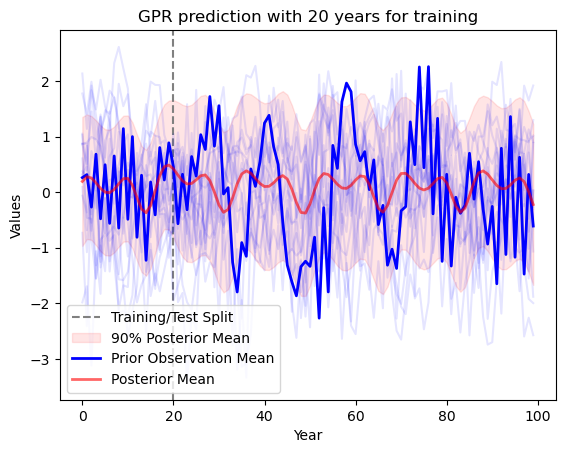

Optimization Progress:   0%|          | 0/200 [00:00<?, ?it/s]

|   iter    |  target   |    c1     |    c2     |    c3     |    c4     |    c5     |    ls1    |    ls2    |   noise   |   per1    |   per2    |  rbf_ls1  |  rbf_ls2  |  rbf_ls3  |
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
|  1        | -792.9    |  0.02377  |  0.02419  |  0.09869  |  0.914    |  0.2675   |  2.684    |  3.347    |  0.6449   |  15.03    |  22.7     |  5.802    |  6.192    |  3.684    |
|  2        | -903.2    |  0.03324  |  0.02749  |  0.05973  |  0.8431   |  0.5531   |  6.879    |  7.598    |  0.6427   |  17.7     |  11.6     |  8.077    |  8.117    |  0.5178   |
|  3        | -855.7    |  0.06348  |  0.09714  |  0.09876  |  0.8378   |  0.7209   |  6.236    |  5.996    |  0.6819   |  26.77    |  19.2     |  5.482    |  9.565    |  2.847    |
|  4        | -874.6    |  0.05359  |  0.08318  |  0.06461  |  0.6717   |  0.475    |  7.8

Optimization Progress:   0%|          | 0/200 [00:06<?, ?it/s]

|  99       | -824.0    |  0.0811   |  0.02957  |  0.07091  |  0.5061   |  0.597    |  6.687    |  5.691    |  0.4929   |  15.63    |  26.58    |  3.116    |  7.233    |  3.702    |
|  100      | -893.5    |  0.01338  |  0.0462   |  0.02416  |  0.1626   |  0.3219   |  3.859    |  5.362    |  0.8865   |  13.54    |  21.35    |  7.216    |  9.96     |  9.257    |
An error occurred during optimization: 'x0' must only have one dimension.
Best parameters found during the optimization process:  {'c1': 0.010784199173775624, 'c2': 0.0469874882768062, 'c3': 0.02913149313641091, 'c4': 0.8340160741286251, 'c5': 0.9865343353089978, 'ls1': 0.8674111048970718, 'ls2': 1.3273325425479972, 'noise': 0.5371163748176617, 'per1': 27.791326639922893, 'per2': 27.577427133741633, 'rbf_ls1': 1.1939009067510868, 'rbf_ls2': 6.198129377205603, 'rbf_ls3': 6.786935114800215}
Total log marginal likelihood for best parameters found during the optimization process:  -777.8416166196248


total_lml_train: -777.8416166196248
total_lml_test: -1205.9814930843331
total_lml_full: -2086.763481607107
best kernel is: 0.104**2 * RBF(length_scale=1.19) + 0.217**2 * RBF(length_scale=6.2) + 0.171**2 * RBF(length_scale=6.79) + 0.913**2 * ExpSineSquared(length_scale=0.867, periodicity=27.8) + 0.993**2 * ExpSineSquared(length_scale=1.33, periodicity=27.6) + WhiteKernel(noise_level=0.537)
observation_lml_train: -49.36471614703818
observation_lml_test: -98.65496585247513
observation_lml_full: -147.92185276876742


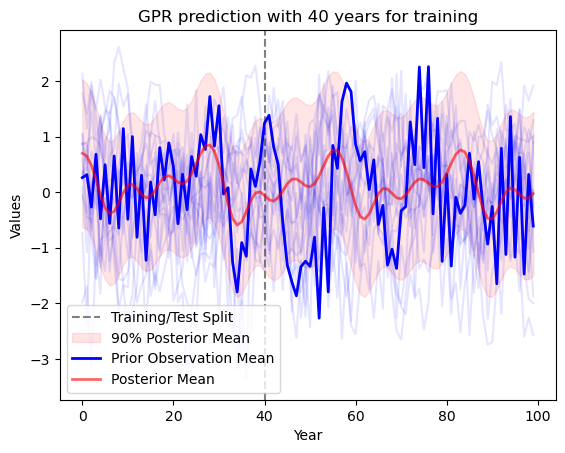

Optimization Progress:   0%|          | 0/200 [00:00<?, ?it/s]

|   iter    |  target   |    c1     |    c2     |    c3     |    c4     |    c5     |    ls1    |    ls2    |   noise   |   per1    |   per2    |  rbf_ls1  |  rbf_ls2  |  rbf_ls3  |
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
|  1        | -1.208e+0 |  0.02377  |  0.02419  |  0.09869  |  0.914    |  0.2675   |  2.684    |  3.347    |  0.6449   |  15.03    |  22.7     |  5.802    |  6.192    |  3.684    |
|  2        | -1.372e+0 |  0.03324  |  0.02749  |  0.05973  |  0.8431   |  0.5531   |  6.879    |  7.598    |  0.6427   |  17.7     |  11.6     |  8.077    |  8.117    |  0.5178   |
|  3        | -1.287e+0 |  0.06348  |  0.09714  |  0.09876  |  0.8378   |  0.7209   |  6.236    |  5.996    |  0.6819   |  26.77    |  19.2     |  5.482    |  9.565    |  2.847    |
|  4        | -1.324e+0 |  0.05359  |  0.08318  |  0.06461  |  0.6717   |  0.475    |  7.8

Optimization Progress:   0%|          | 0/200 [00:06<?, ?it/s]

|  99       | -1.24e+03 |  0.0811   |  0.02957  |  0.07091  |  0.5061   |  0.597    |  6.687    |  5.691    |  0.4929   |  15.63    |  26.58    |  3.116    |  7.233    |  3.702    |
|  100      | -1.338e+0 |  0.01338  |  0.0462   |  0.02416  |  0.1626   |  0.3219   |  3.859    |  5.362    |  0.8865   |  13.54    |  21.35    |  7.216    |  9.96     |  9.257    |
An error occurred during optimization: 'x0' must only have one dimension.
Best parameters found during the optimization process:  {'c1': 0.039397704536475425, 'c2': 0.09145745788603027, 'c3': 0.01144839508030076, 'c4': 0.764575853704881, 'c5': 0.4332302296090804, 'ls1': 7.77498731956144, 'ls2': 3.6781693245060403, 'noise': 0.5466987350757623, 'per1': 18.98171682092493, 'per2': 14.059803803978252, 'rbf_ls1': 6.399006078419385, 'rbf_ls2': 2.75131016204423, 'rbf_ls3': 5.729730345779749}
Total log marginal likelihood for best parameters found during the optimization process:  -1195.6496938735595


total_lml_train: -1195.6496938735595
total_lml_test: -798.4383892958224
total_lml_full: -1981.4549537196513
best kernel is: 0.198**2 * RBF(length_scale=6.4) + 0.302**2 * RBF(length_scale=2.75) + 0.107**2 * RBF(length_scale=5.73) + 0.874**2 * ExpSineSquared(length_scale=7.77, periodicity=19) + 0.658**2 * ExpSineSquared(length_scale=3.68, periodicity=14.1) + WhiteKernel(noise_level=0.547)
observation_lml_train: -79.07470279141621
observation_lml_test: -56.650216241715846
observation_lml_full: -135.46384391212212


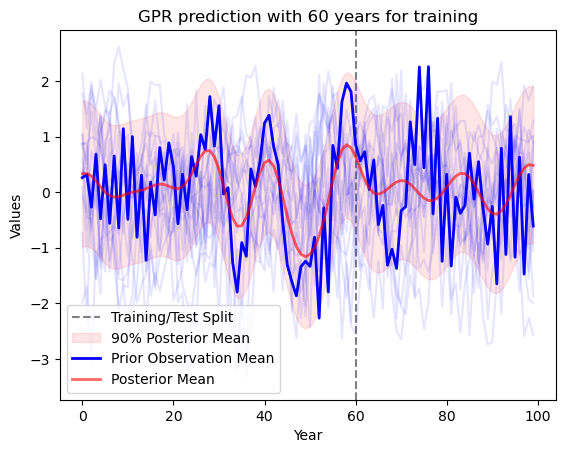

Optimization Progress:   0%|          | 0/200 [00:00<?, ?it/s]

|   iter    |  target   |    c1     |    c2     |    c3     |    c4     |    c5     |    ls1    |    ls2    |   noise   |   per1    |   per2    |  rbf_ls1  |  rbf_ls2  |  rbf_ls3  |
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
|  1        | -1.615e+0 |  0.02377  |  0.02419  |  0.09869  |  0.914    |  0.2675   |  2.684    |  3.347    |  0.6449   |  15.03    |  22.7     |  5.802    |  6.192    |  3.684    |
|  2        | -1.823e+0 |  0.03324  |  0.02749  |  0.05973  |  0.8431   |  0.5531   |  6.879    |  7.598    |  0.6427   |  17.7     |  11.6     |  8.077    |  8.117    |  0.5178   |
|  3        | -1.713e+0 |  0.06348  |  0.09714  |  0.09876  |  0.8378   |  0.7209   |  6.236    |  5.996    |  0.6819   |  26.77    |  19.2     |  5.482    |  9.565    |  2.847    |
|  4        | -1.761e+0 |  0.05359  |  0.08318  |  0.06461  |  0.6717   |  0.475    |  7.8

Optimization Progress:   0%|          | 0/200 [00:08<?, ?it/s]

An error occurred during optimization: 'x0' must only have one dimension.
Best parameters found during the optimization process:  {'c1': 0.039397704536475425, 'c2': 0.09145745788603027, 'c3': 0.01144839508030076, 'c4': 0.764575853704881, 'c5': 0.4332302296090804, 'ls1': 7.77498731956144, 'ls2': 3.6781693245060403, 'noise': 0.5466987350757623, 'per1': 18.98171682092493, 'per2': 14.059803803978252, 'rbf_ls1': 6.399006078419385, 'rbf_ls2': 2.75131016204423, 'rbf_ls3': 5.729730345779749}
Total log marginal likelihood for best parameters found during the optimization process:  -1585.5879996804479


total_lml_train: -1585.5879996804479
total_lml_test: -410.15041425008076
total_lml_full: -1981.4549537196513
best kernel is: 0.198**2 * RBF(length_scale=6.4) + 0.302**2 * RBF(length_scale=2.75) + 0.107**2 * RBF(length_scale=5.73) + 0.874**2 * ExpSineSquared(length_scale=7.77, periodicity=19) + 0.658**2 * ExpSineSquared(length_scale=3.68, periodicity=14.1) + WhiteKernel(noise_level=0.547)
observation_lml_train: -108.40519607430038
observation_lml_test: -27.769102976532295
observation_lml_full: -135.46384391212212


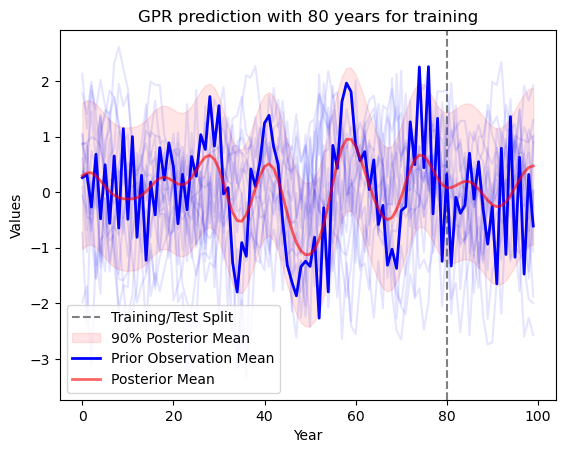

In [100]:
def pe3_rbf2(best_params):
    kernel = (
        C(best_params['c1']) * RBF(length_scale=best_params['rbf_ls1']) +
        C(best_params['c2']) * RBF(length_scale=best_params['rbf_ls2']) +
        C(best_params['c3']) * RBF(length_scale=best_params['rbf_ls3']) +
        C(best_params['c4']) * ExpSineSquared(length_scale=best_params['ls1'], periodicity=best_params['per1']) +
        C(best_params['c5']) * ExpSineSquared(length_scale=best_params['ls2'], periodicity=best_params['per2']) +
        WhiteKernel(noise_level=best_params['noise'])
    )
    return kernel

pbounds = {
    'c1': (1e-2, 1e-1),
    'c2': (1e-2, 1e-1),
    'c3': (1e-2, 1e-1),
    'c4': (1e-1, 1),
    'c5': (1e-1, 1),
    'ls1': (1e-2, 1e1),
    'per1': (10, 30),
    'ls2': (1e-2, 1e1),
    'per2': (10, 30),
    'rbf_ls1': (1e-2, 1e1),
    'rbf_ls2': (1e-2, 1e1),
    'rbf_ls3': (1e-2, 1e1),
    'noise': (1e-3, 1)
}

gpr_model(mod_ids, 20, rainfall_yearly, pbounds, pe3_rbf2, oos_gcm)
gpr_model(mod_ids, 40, rainfall_yearly, pbounds, pe3_rbf2, oos_gcm)
gpr_model(mod_ids, 60, rainfall_yearly, pbounds, pe3_rbf2, oos_gcm)
gpr_model(mod_ids, 80, rainfall_yearly, pbounds, pe3_rbf2, oos_gcm)


Optimization Progress:   0%|          | 0/200 [00:00<?, ?it/s]

|   iter    |  target   |    c1     |    c2     |    c3     |    c4     |    c5     |    ls1    |    ls2    |    ls3    |   noise   |   per1    |   per2    |   per3    |  rbf_ls   | rbf_rq_ls | rq_alpha  |   rq_ls   |
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
|  1        | -2.965e+0 |  3.808    |  9.512    |  7.347    |  6.027    |  1.645    |  1.568    |  0.5903   |  8.663    |  6.012    |  24.16    |  10.41    |  29.4     |  8.326    |  2.131    |  18.19    |  1.842    |
|  2        | -2.839e+0 |  3.112    |  5.295    |  4.376    |  2.983    |  6.157    |  1.404    |  2.929    |  3.67     |  4.561    |  25.7     |  13.99    |  20.28    |  5.928    |  0.474    |  60.76    |  1.714    |
|  3        | -2.054e+0 |  0.744    |  9.494    |  9.66     |  8.103    |  3.116    |  0.9857   |  6.845    |  4.407    |  1.221

Optimization Progress:   0%|          | 0/200 [00:09<?, ?it/s]

|  100      | -2.292e+0 |  9.879    |  1.451    |  6.982    |  4.103    |  4.339    |  7.179    |  6.927    |  9.913    |  1.285    |  12.08    |  24.49    |  21.57    |  2.749    |  0.8034   |  8.575    |  8.943    |
An error occurred during optimization: 'x0' must only have one dimension.
Best parameters found during the optimization process:  {'c1': 5.071730602279302, 'c2': 5.9943116714684335, 'c3': 0.7640571261454321, 'c4': 7.52460865695186, 'c5': 2.178065371646299, 'ls1': 8.98156235151273, 'ls2': 2.0593450084152516, 'ls3': 1.914970329430029, 'noise': 0.36646012881310075, 'per1': 19.441338902199984, 'per2': 21.29682266525233, 'per3': 11.314172788567047, 'rbf_ls': 7.757520890783155, 'rbf_rq_ls': 4.538355459132796, 'rq_alpha': 52.44378303006472, 'rq_ls': 4.413219841912899}


total_lml_train: -1690.0944872218463
total_lml_test: -448.99549316955137
total_lml_full: -2107.4040810325564
best kernel is: 2.25**2 * RBF(length_scale=7.76) + 2.45**2 * RBF(length_scale=4.54) * RationalQuadratic(alpha=52.4, length_scale=4.41) + 0.874**2 * ExpSineSquared(length_scale=8.98, periodicity=19.4) + 2.74**2 * ExpSineSquared(length_scale=2.06, periodicity=21.3) + 1.48**2 * ExpSineSquared(length_scale=1.91, periodicity=11.3) + WhiteKernel(noise_level=0.366)


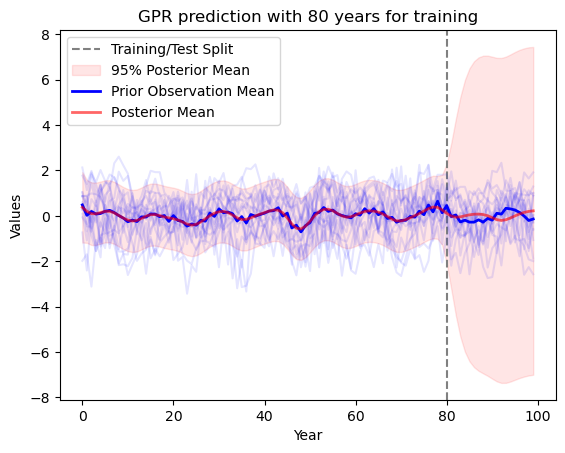

In [46]:
def pe3_rbf1_rqrbf(best_params):
    kernel = (
        C(best_params['c1']) * RBF(length_scale=best_params['rbf_ls']) +
        C(best_params['c2']) * RBF(length_scale=best_params['rbf_rq_ls']) * RationalQuadratic(length_scale=best_params['rq_ls'], alpha=best_params['rq_alpha']) +
        C(best_params['c3']) * ExpSineSquared(length_scale=best_params['ls1'], periodicity=best_params['per1']) +
        C(best_params['c4']) * ExpSineSquared(length_scale=best_params['ls2'], periodicity=best_params['per2']) +
        C(best_params['c5']) * ExpSineSquared(length_scale=best_params['ls3'], periodicity=best_params['per3']) +
        WhiteKernel(noise_level=best_params['noise'])
    )
    return kernel

pbounds = {
    'c1': (1e-1, 1e1),
    'c2': (1e-1, 1e1),
    'c3': (1e-1, 1e1),
    'c4': (1e-1, 1e1),
    'c5': (1e-1, 1e1),
    'ls1': (1e-2, 1e1),
    'per1': (10, 30),
    'ls2': (1e-2, 1e1),
    'per2': (10, 30),
    'ls3': (1e-2, 1e1),
    'per3': (10, 30),
    'rbf_ls': (1e-2, 1e1),
    'rbf_rq_ls': (1e-2, 1e1),
    'rq_ls': (1e-2, 1e1),
    'rq_alpha': (1e-2, 1e2),
    'noise': (1e-3, 1e1)
}

gpr_model(mod_ids, 80, rainfall_yearly, pbounds, pe3_rbf1_rqrbf)

## Poly(PE)

In [46]:
class CustomPolynomialKernel(Kernel):
    def __init__(self, degree=2, periods=[1, 1, 1], include_bias=False):
        self.degree = degree
        self.periods = periods if isinstance(periods, (list, np.ndarray)) else [periods]
        self.include_bias = include_bias
        self.poly = PolynomialFeatures(degree=self.degree, include_bias=self.include_bias)
    
    def periodic_transform(self, X):
        return np.hstack([np.cos(2 * np.pi * X / p) for p in self.periods] +
                         [np.sin(2 * np.pi * X / p) for p in self.periods])
    
    def __call__(self, X, Y=None, eval_gradient=False):
        X_transformed = self.periodic_transform(X)
        if Y is None:
            Y_transformed = X_transformed
        else:
            Y_transformed = self.periodic_transform(Y)
        
        K = self.poly.fit_transform(X_transformed).dot(self.poly.fit_transform(Y_transformed).T)
        
        if eval_gradient:
            K_gradient = np.zeros((X_transformed.shape[0], Y_transformed.shape[0], 0))
            return K, K_gradient
        else:
            return K
    
    def diag(self, X):
        return np.diag(self.__call__(X))
    
    def is_stationary(self):
        return False

Optimization Progress:   0%|          | 0/200 [00:00<?, ?it/s]

|   iter    |  target   | constant1 | constant2 | constant3 | matern_ls | noise_... |    nu     |  periods  | rq_alpha  |   rq_ls   |
-------------------------------------------------------------------------------------------------------------------------------------
|  1        | -2.739e+0 |  374.5    |  950.7    |  732.0    |  59.87    |  1.569    |  0.812    |  11.16    |  1.746    |  60.12    |
|  2        | -2.689e+0 |  708.1    |  20.59    |  969.9    |  83.25    |  2.131    |  0.8636   |  13.67    |  0.6781   |  52.48    |
|  3        | -3.121e+0 |  431.9    |  291.2    |  611.9    |  13.96    |  2.929    |  1.233    |  19.12    |  1.592    |  19.98    |
|  4        | -2.342e+0 |  514.2    |  592.4    |  46.45    |  60.76    |  1.714    |  0.6301   |  28.98    |  1.935    |  80.84    |
|  5        | -2.305e+0 |  304.6    |  97.67    |  684.2    |  44.02    |  1.229    |  1.49     |  10.69    |  1.828    |  25.89    |
|  6        | -2.377e+0 |  662.5    |  311.7    |  520.1    | 

Optimization Progress:   0%|          | 0/200 [00:12<?, ?it/s]


total_lml_train: -2066.830686717068
total_lml_test: -662.7784568012189
total_lml_full: -2534.9226612367756
best kernel is: 29.9**2 * CustomPolynomialKernel() + 19.7**2 * RationalQuadratic(alpha=1.91, length_scale=57.3) + 3.29**2 * Matern(length_scale=90.5, nu=1.14) + WhiteKernel(noise_level=0.922)


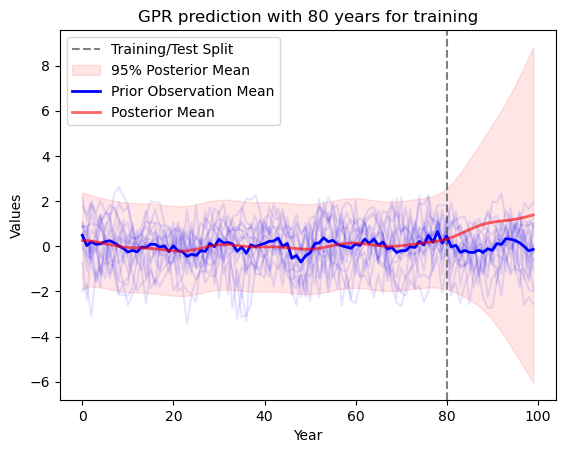

In [48]:
def polype_rq_Matern(best_params):
    custom_poly_kernel = C(best_params['constant1']) * CustomPolynomialKernel(degree=2, periods=best_params['periods'])
    original_kernel = (
        C(best_params['constant2']) * RQ(length_scale=best_params['rq_ls'], alpha=best_params['rq_alpha']) +
        C(best_params['constant3']) * Matern(length_scale=best_params['matern_ls'], nu=best_params['nu']) +
        WhiteKernel(noise_level=best_params['noise_level'])
    )
    return custom_poly_kernel + original_kernel

pbounds = {
    'periods': (10, 30),
    'rq_alpha': (0.1, 2.0),
    'matern_ls': (1e-2, 1e2),
    'noise_level': (1e-2, 1e1),
    'constant1': (1e-3, 1e3),
    'constant2': (1e-3, 1e3),
    'constant3': (1e-3, 1e3),
    'nu': (0.5, 2.5),
    'rq_ls': (1e-2, 1e2)
}
gpr_model(mod_ids, 80, rainfall_yearly, pbounds, polype_rq_Matern)

Optimization Progress:   0%|          | 0/200 [00:00<?, ?it/s]

|   iter    |  target   | constant1 | constant2 | constant3 | constant4 | constant5 | matern... | noise_... |    nu     |  period1  |  period2  |  period3  | rbf_le... | rq_alpha  |   rq_ls   |
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
|  1        | -2.893e+0 |  374.5    |  950.7    |  732.0    |  598.7    |  156.0    |  16.44    |  0.5903   |  2.232    |  22.02    |  24.16    |  10.41    |  96.99    |  83.25    |  21.24    |
|  2        | -3.522e+0 |  181.8    |  183.4    |  304.2    |  524.8    |  431.9    |  29.83    |  6.122    |  0.779    |  15.84    |  17.33    |  19.12    |  78.52    |  19.98    |  51.43    |
|  3        | -3.905e+0 |  592.4    |  46.45    |  607.5    |  170.5    |  65.05    |  94.94    |  9.657    |  2.117    |  16.09    |  11.95    |  23.68    |  44.02    |  12.21    |  49.52    |
|  4        | -2.985e+0 |  34.

Optimization Progress:   0%|          | 0/200 [00:13<?, ?it/s]

|  100      | -3.753e+0 |  773.5    |  130.9    |  969.8    |  453.8    |  236.1    |  8.276    |  1.706    |  1.54     |  16.74    |  26.58    |  18.62    |  24.88    |  61.72    |  70.68    |
An error occurred during optimization: 'x0' must only have one dimension.
Best parameters found during the optimization process:  {'constant1': 645.4726504348719, 'constant2': 177.11150229636954, 'constant3': 940.45864389433, 'constant4': 953.9286230740104, 'constant5': 914.8644753560583, 'matern_length': 37.64571132528899, 'noise_level': 0.16441159912338563, 'nu': 2.3566371251754505, 'period1': 18.563682966346285, 'period2': 29.333096380873393, 'period3': 29.272399541785056, 'rbf_length': 85.30241545218134, 'rq_alpha': 29.451944718037872, 'rq_ls': 38.515921882906504}


total_lml_train: -2403.6407309569286
total_lml_test: -811.7413462076885
total_lml_full: -2866.154535291951
best kernel is: 25.4**2 * CustomPolynomialKernel() + 13.3**2 * RationalQuadratic(alpha=29.5, length_scale=38.5) + 30.7**2 * Matern(length_scale=37.6, nu=2.36) + 30.9**2 * RBF(length_scale=85.3) + WhiteKernel(noise_level=0.164)


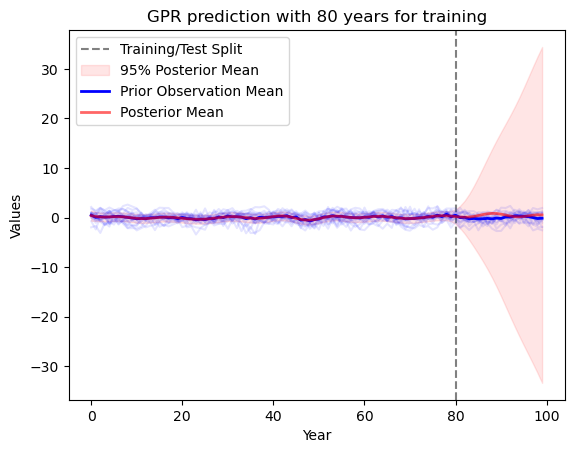

In [49]:
def polype3_rq_matern_rbf(best_params):
    custom_poly_kernel = C(best_params['constant1']) * CustomPolynomialKernel(degree=2, periods=[best_params['period1'], best_params['period2'], best_params['period3']])
    original_kernel = (
        C(best_params['constant2']) * RQ(length_scale=best_params['rq_ls'], alpha=best_params['rq_alpha']) +
        C(best_params['constant3']) * Matern(length_scale=best_params['matern_length'], nu=best_params['nu']) +
        C(best_params['constant4']) * RBF(length_scale=best_params['rbf_length']) +
        WhiteKernel(noise_level=best_params['noise_level'])
    )
    return custom_poly_kernel + original_kernel

pbounds = {
    'period1': (10, 30),
    'period2': (10, 30),
    'period3': (10, 30),
    'rq_alpha': (1e-2, 1e2),
    'matern_length': (1e0, 1e2),
    'noise_level': (1e-2, 1e1),
    'constant1': (1e-3, 1e3),
    'constant2': (1e-3, 1e3),
    'constant3': (1e-3, 1e3),
    'constant4': (1e-3, 1e3),
    'constant5': (1e-3, 1e3),
    'rbf_length': (1e-2, 1e2),
    'nu': (0.5, 2.5),
    'rq_ls': (1e-2, 1e2)
}

gpr_model(mod_ids, 80, rainfall_yearly, pbounds, polype3_rq_matern_rbf)

Optimization Progress:   0%|          | 0/200 [00:00<?, ?it/s]

|   iter    |  target   | constant1 | constant2 | constant3 | constant4 | constant5 | constant6 | matern... | noise_... |    nu     |  period1  |  period2  |  period3  | rbf_le... | rq_alpha  |   rq_ls   |
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
|  1        | -407.2    |  0.1539   |  0.1585   |  0.9855   |  0.4523   |  0.09385  |  0.1346   |  4.006    |  0.6481   |  1.003    |  22.7     |  21.6     |  22.38    |  3.684    |  0.2656   |  1.952    |
|  2        | -457.2    |  0.553    |  0.8258   |  0.5039   |  0.3441   |  0.38     |  0.3215   |  4.465    |  0.0893   |  2.115    |  26.23    |  11.02    |  21.89    |  9.683    |  0.9864   |  8.2      |
|  3        | -444.8    |  0.6902   |  0.6236   |  0.5996   |  0.3411   |  0.4195   |  0.2305   |  5.93     |  0.9569   |  1.068    |  19.69    |  26.26    |  22.14    |  6.355

Optimization Progress:   0%|          | 0/200 [00:09<?, ?it/s]

Total log marginal likelihood for best parameters found during the optimization process:  -348.48533706246667


total_lml_train: -348.48533706246667
total_lml_test: -1694.9533882644673
total_lml_full: -2120.2230495062136
best kernel is: 0.131**2 * CustomPolynomialKernel() + 0.859**2 * CustomPolynomialKernel() + 0.609**2 * CustomPolynomialKernel() + 0.624**2 * RationalQuadratic(alpha=0.783, length_scale=8.39) + 0.429**2 * Matern(length_scale=5.04, nu=1.78) + 0.523**2 * RBF(length_scale=5.57) + WhiteKernel(noise_level=0.211)
observation_lml_train: -30.141850798884754
observation_lml_test: -125.26790756639244
observation_lml_full: -153.77014796312022


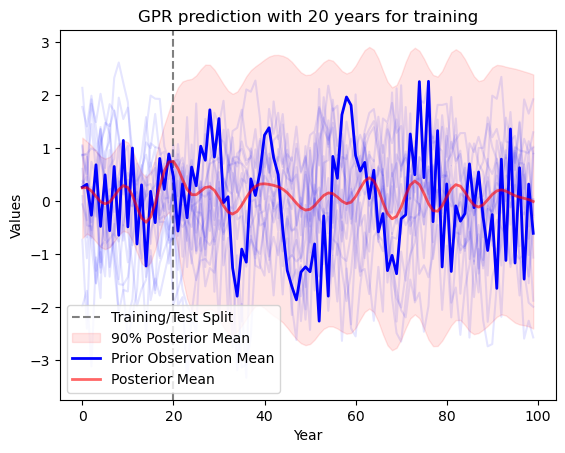

Optimization Progress:   0%|          | 0/200 [00:00<?, ?it/s]

|   iter    |  target   | constant1 | constant2 | constant3 | constant4 | constant5 | constant6 | matern... | noise_... |    nu     |  period1  |  period2  |  period3  | rbf_le... | rq_alpha  |   rq_ls   |
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
|  1        | -836.9    |  0.1539   |  0.1585   |  0.9855   |  0.4523   |  0.09385  |  0.1346   |  4.006    |  0.6481   |  1.003    |  22.7     |  21.6     |  22.38    |  3.684    |  0.2656   |  1.952    |
|  2        | -934.6    |  0.553    |  0.8258   |  0.5039   |  0.3441   |  0.38     |  0.3215   |  4.465    |  0.0893   |  2.115    |  26.23    |  11.02    |  21.89    |  9.683    |  0.9864   |  8.2      |
|  3        | -880.6    |  0.6902   |  0.6236   |  0.5996   |  0.3411   |  0.4195   |  0.2305   |  5.93     |  0.9569   |  1.068    |  19.69    |  26.26    |  22.14    |  6.355

Optimization Progress:   0%|          | 0/200 [00:10<?, ?it/s]

Total log marginal likelihood for best parameters found during the optimization process:  -700.6573172588884


total_lml_train: -700.6573172588884
total_lml_test: -1108.5495050951622
total_lml_full: -1876.9954029410853
best kernel is: 0.431**2 * CustomPolynomialKernel() + 0.779**2 * CustomPolynomialKernel() + 0.216**2 * CustomPolynomialKernel() + 0.407**2 * RationalQuadratic(alpha=0.878, length_scale=5.63) + 0.661**2 * Matern(length_scale=3.24, nu=2.47) + 0.498**2 * RBF(length_scale=9.7) + WhiteKernel(noise_level=0.242)
observation_lml_train: -50.077228490784435
observation_lml_test: -96.16633515399911
observation_lml_full: -148.13833091959987


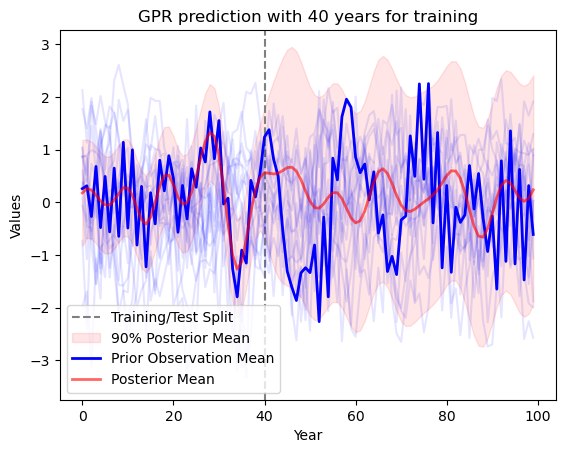

Optimization Progress:   0%|          | 0/200 [00:00<?, ?it/s]

|   iter    |  target   | constant1 | constant2 | constant3 | constant4 | constant5 | constant6 | matern... | noise_... |    nu     |  period1  |  period2  |  period3  | rbf_le... | rq_alpha  |   rq_ls   |
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
|  1        | -1.25e+03 |  0.1539   |  0.1585   |  0.9855   |  0.4523   |  0.09385  |  0.1346   |  4.006    |  0.6481   |  1.003    |  22.7     |  21.6     |  22.38    |  3.684    |  0.2656   |  1.952    |
|  2        | -1.458e+0 |  0.553    |  0.8258   |  0.5039   |  0.3441   |  0.38     |  0.3215   |  4.465    |  0.0893   |  2.115    |  26.23    |  11.02    |  21.89    |  9.683    |  0.9864   |  8.2      |
|  3        | -1.321e+0 |  0.6902   |  0.6236   |  0.5996   |  0.3411   |  0.4195   |  0.2305   |  5.93     |  0.9569   |  1.068    |  19.69    |  26.26    |  22.14    |  6.355

Optimization Progress:   0%|          | 0/200 [00:11<?, ?it/s]


total_lml_train: -1095.1693642249372
total_lml_test: -725.286469148578
total_lml_full: -1876.9954029410853
best kernel is: 0.431**2 * CustomPolynomialKernel() + 0.779**2 * CustomPolynomialKernel() + 0.216**2 * CustomPolynomialKernel() + 0.407**2 * RationalQuadratic(alpha=0.878, length_scale=5.63) + 0.661**2 * Matern(length_scale=3.24, nu=2.47) + 0.498**2 * RBF(length_scale=9.7) + WhiteKernel(noise_level=0.242)
observation_lml_train: -76.30921599256008
observation_lml_test: -70.04231418023656
observation_lml_full: -148.13833091959987


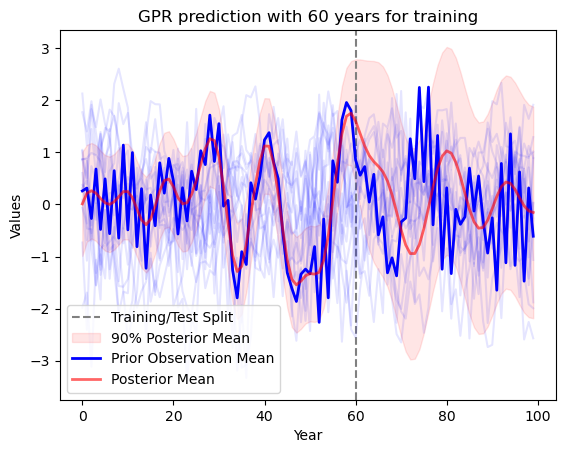

Optimization Progress:   0%|          | 0/200 [00:00<?, ?it/s]

|   iter    |  target   | constant1 | constant2 | constant3 | constant4 | constant5 | constant6 | matern... | noise_... |    nu     |  period1  |  period2  |  period3  | rbf_le... | rq_alpha  |   rq_ls   |
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
|  1        | -1.657e+0 |  0.1539   |  0.1585   |  0.9855   |  0.4523   |  0.09385  |  0.1346   |  4.006    |  0.6481   |  1.003    |  22.7     |  21.6     |  22.38    |  3.684    |  0.2656   |  1.952    |
|  2        | -2.007e+0 |  0.553    |  0.8258   |  0.5039   |  0.3441   |  0.38     |  0.3215   |  4.465    |  0.0893   |  2.115    |  26.23    |  11.02    |  21.89    |  9.683    |  0.9864   |  8.2      |
|  3        | -1.773e+0 |  0.6902   |  0.6236   |  0.5996   |  0.3411   |  0.4195   |  0.2305   |  5.93     |  0.9569   |  1.068    |  19.69    |  26.26    |  22.14    |  6.355

Optimization Progress:   0%|          | 0/200 [00:16<?, ?it/s]

Total log marginal likelihood for best parameters found during the optimization process:  -1492.481361160655


total_lml_train: -1492.481361160655
total_lml_test: -377.0292860354536
total_lml_full: -1909.4843667324585
best kernel is: 0.415**2 * CustomPolynomialKernel() + 0.706**2 * CustomPolynomialKernel() + 0.382**2 * CustomPolynomialKernel() + 0.545**2 * RationalQuadratic(alpha=0.468, length_scale=8.37) + 0.567**2 * Matern(length_scale=4.03, nu=0.76) + 0.442**2 * RBF(length_scale=0.265) + WhiteKernel(noise_level=0.112)
observation_lml_train: -110.24187144307382
observation_lml_test: -34.67008379985524
observation_lml_full: -144.72666777406278


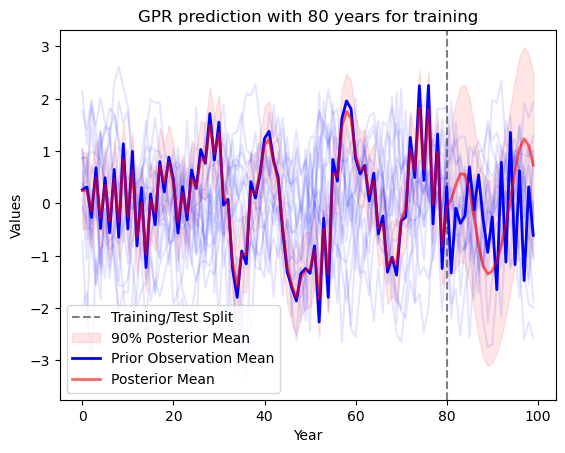

In [101]:
def polype3_rq_matern_rbf_true(best_params):
    custom_poly_kernel1 = C(best_params['constant1']) * CustomPolynomialKernel(degree=2, periods=best_params['period1'])
    custom_poly_kernel2 = C(best_params['constant2']) * CustomPolynomialKernel(degree=2, periods=best_params['period2'])
    custom_poly_kernel3 = C(best_params['constant3']) * CustomPolynomialKernel(degree=2, periods=best_params['period3'])
    
    original_kernel = (
        C(best_params['constant4']) * RQ(length_scale=best_params['rq_ls'], alpha=best_params['rq_alpha']) +
        C(best_params['constant5']) * Matern(length_scale=best_params['matern_length'], nu=best_params['nu']) +
        C(best_params['constant6']) * RBF(length_scale=best_params['rbf_length']) +
        WhiteKernel(noise_level=best_params['noise_level'])
    )
    
    return custom_poly_kernel1 + custom_poly_kernel2 + custom_poly_kernel3 + original_kernel

pbounds = {
    'period1': (10, 30),
    'period2': (10, 30),
    'period3': (10, 30),
    'rq_alpha': (1e-2, 1),
    'matern_length': (1e0, 10),
    'noise_level': (1e-2, 1),
    'constant1': (1e-3, 1),
    'constant2': (1e-3, 1),
    'constant3': (1e-3, 1),
    'constant4': (1e-3, 0.5),
    'constant5': (1e-3, 0.5),
    'constant6': (1e-3, 0.5),
    'rbf_length': (1e-2, 10),
    'nu': (0.5, 2.5),
    'rq_ls': (1e-2, 10)
}

gpr_model(mod_ids, 20, rainfall_yearly, pbounds, polype3_rq_matern_rbf_true, oos_gcm)
gpr_model(mod_ids, 40, rainfall_yearly, pbounds, polype3_rq_matern_rbf_true, oos_gcm)
gpr_model(mod_ids, 60, rainfall_yearly, pbounds, polype3_rq_matern_rbf_true, oos_gcm)
gpr_model(mod_ids, 80, rainfall_yearly, pbounds, polype3_rq_matern_rbf_true, oos_gcm)


Optimization Progress:   0%|          | 0/200 [00:00<?, ?it/s]

|   iter    |  target   | constant1 | constant2 | constant3 | constant4 | noise_... |    nu     |  period1  |  period2  |  period3  | rbf_le... | rq_alpha  |   rq_ls   |
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------
|  1        | -389.4    |  0.07737  |  0.07969  |  0.4928   |  0.4523   |  0.1942   |  1.035    |  16.68    |  22.89    |  15.03    |  63.52    |  0.584    |  61.88    |
|  2        | -414.3    |  0.1845   |  0.1298   |  0.09798  |  0.2767   |  0.8274   |  1.507    |  23.75    |  25.19    |  22.85    |  38.51    |  0.0893   |  80.75    |
|  3        | -461.5    |  0.4059   |  0.02636  |  0.2975   |  0.4842   |  0.9864   |  2.14     |  23.8     |  22.46    |  21.98    |  68.16    |  0.8403   |  46.01    |
|  4        | -431.0    |  0.2743   |  0.4783   |  0.1427   |  0.2427   |  0.815    |  1.714    |  22.7     |  18.33    |  25.62    |  30.43    |  0.7

Optimization Progress:   0%|          | 0/200 [00:05<?, ?it/s]

|  100      | -415.8    |  0.2457   |  0.4656   |  0.1163   |  0.098    |  0.533    |  2.02     |  10.86    |  27.37    |  26.86    |  96.6     |  0.2467   |  23.64    |
An error occurred during optimization: 'x0' must only have one dimension.
Best parameters found during the optimization process:  {'constant1': 0.2053139170986881, 'constant2': 0.07866229756586268, 'constant3': 0.10729333251818993, 'constant4': 0.10968195637077195, 'noise_level': 0.09710605878514555, 'nu': 1.9872419223543596, 'period1': 22.244657896659383, 'period2': 19.767686832097223, 'period3': 21.66076904779309, 'rbf_length': 8.8876228425549, 'rq_alpha': 0.8688549001753177, 'rq_ls': 79.14263910023482}
Total log marginal likelihood for best parameters found during the optimization process:  -338.8974319274929


total_lml_train: -338.8974319274929
total_lml_test: -2495.1648274940926
total_lml_full: -3126.389245283529
best kernel is: 0.453**2 * CustomPolynomialKernel() + 0.28**2 * RationalQuadratic(alpha=0.869, length_scale=79.1) * RBF(length_scale=8.89) + 0.328**2 * Matern(length_scale=0.11, nu=1.99) + WhiteKernel(noise_level=0.0971)
observation_lml_train: -29.041662159724698
observation_lml_test: -179.21451108068703
observation_lml_full: -214.3558225503573


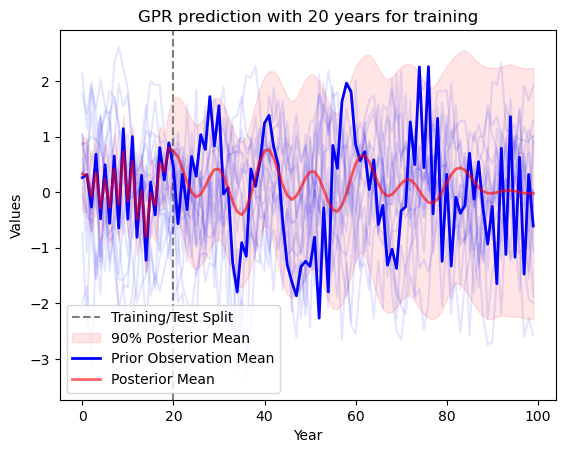

Optimization Progress:   0%|          | 0/200 [00:00<?, ?it/s]

|   iter    |  target   | constant1 | constant2 | constant3 | constant4 | noise_... |    nu     |  period1  |  period2  |  period3  | rbf_le... | rq_alpha  |   rq_ls   |
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------
|  1        | -780.0    |  0.07737  |  0.07969  |  0.4928   |  0.4523   |  0.1942   |  1.035    |  16.68    |  22.89    |  15.03    |  63.52    |  0.584    |  61.88    |
|  2        | -864.2    |  0.1845   |  0.1298   |  0.09798  |  0.2767   |  0.8274   |  1.507    |  23.75    |  25.19    |  22.85    |  38.51    |  0.0893   |  80.75    |
|  3        | -939.2    |  0.4059   |  0.02636  |  0.2975   |  0.4842   |  0.9864   |  2.14     |  23.8     |  22.46    |  21.98    |  68.16    |  0.8403   |  46.01    |
|  4        | -860.4    |  0.2743   |  0.4783   |  0.1427   |  0.2427   |  0.815    |  1.714    |  22.7     |  18.33    |  25.62    |  30.43    |  0.7

Optimization Progress:   0%|          | 0/200 [00:06<?, ?it/s]

Total log marginal likelihood for best parameters found during the optimization process:  -710.514218576152


total_lml_train: -710.514218576152
total_lml_test: -1102.503266002686
total_lml_full: -2013.528875029149
best kernel is: 0.357**2 * CustomPolynomialKernel() + 0.671**2 * RationalQuadratic(alpha=0.534, length_scale=17.9) * RBF(length_scale=64.1) + 0.584**2 * Matern(length_scale=0.321, nu=0.611) + WhiteKernel(noise_level=0.0142)
observation_lml_train: -47.774074057510674
observation_lml_test: -88.24643968903979
observation_lml_full: -134.52775336754962


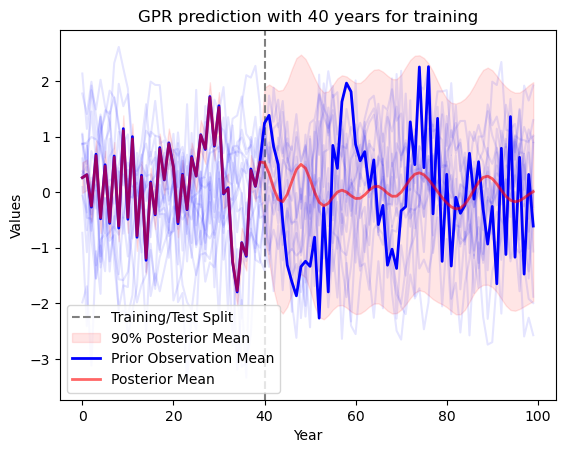

Optimization Progress:   0%|          | 0/200 [00:00<?, ?it/s]

|   iter    |  target   | constant1 | constant2 | constant3 | constant4 | noise_... |    nu     |  period1  |  period2  |  period3  | rbf_le... | rq_alpha  |   rq_ls   |
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------
|  1        | -1.202e+0 |  0.07737  |  0.07969  |  0.4928   |  0.4523   |  0.1942   |  1.035    |  16.68    |  22.89    |  15.03    |  63.52    |  0.584    |  61.88    |
|  2        | -1.316e+0 |  0.1845   |  0.1298   |  0.09798  |  0.2767   |  0.8274   |  1.507    |  23.75    |  25.19    |  22.85    |  38.51    |  0.0893   |  80.75    |
|  3        | -1.409e+0 |  0.4059   |  0.02636  |  0.2975   |  0.4842   |  0.9864   |  2.14     |  23.8     |  22.46    |  21.98    |  68.16    |  0.8403   |  46.01    |
|  4        | -1.318e+0 |  0.2743   |  0.4783   |  0.1427   |  0.2427   |  0.815    |  1.714    |  22.7     |  18.33    |  25.62    |  30.43    |  0.7

Optimization Progress:   0%|          | 0/200 [00:07<?, ?it/s]

Total log marginal likelihood for best parameters found during the optimization process:  -1086.6787335768809


total_lml_train: -1086.6787335768809
total_lml_test: -729.7809169135048
total_lml_full: -2013.528875029149
best kernel is: 0.357**2 * CustomPolynomialKernel() + 0.671**2 * RationalQuadratic(alpha=0.534, length_scale=17.9) * RBF(length_scale=64.1) + 0.584**2 * Matern(length_scale=0.321, nu=0.611) + WhiteKernel(noise_level=0.0142)
observation_lml_train: -73.76848573725013
observation_lml_test: -62.69653497527719
observation_lml_full: -134.52775336754962


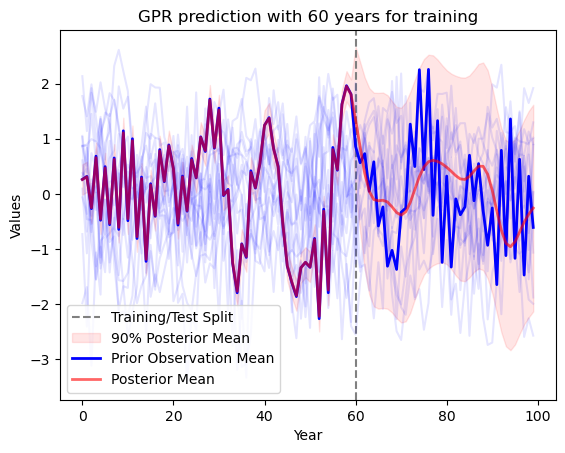

Optimization Progress:   0%|          | 0/200 [00:00<?, ?it/s]

|   iter    |  target   | constant1 | constant2 | constant3 | constant4 | noise_... |    nu     |  period1  |  period2  |  period3  | rbf_le... | rq_alpha  |   rq_ls   |
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------
|  1        | -1.604e+0 |  0.07737  |  0.07969  |  0.4928   |  0.4523   |  0.1942   |  1.035    |  16.68    |  22.89    |  15.03    |  63.52    |  0.584    |  61.88    |
|  2        | -1.78e+03 |  0.1845   |  0.1298   |  0.09798  |  0.2767   |  0.8274   |  1.507    |  23.75    |  25.19    |  22.85    |  38.51    |  0.0893   |  80.75    |
|  3        | -1.887e+0 |  0.4059   |  0.02636  |  0.2975   |  0.4842   |  0.9864   |  2.14     |  23.8     |  22.46    |  21.98    |  68.16    |  0.8403   |  46.01    |
|  4        | -1.793e+0 |  0.2743   |  0.4783   |  0.1427   |  0.2427   |  0.815    |  1.714    |  22.7     |  18.33    |  25.62    |  30.43    |  0.7

Optimization Progress:   0%|          | 0/200 [00:10<?, ?it/s]

|  100      | -1.682e+0 |  0.2457   |  0.4656   |  0.1163   |  0.098    |  0.533    |  2.02     |  10.86    |  27.37    |  26.86    |  96.6     |  0.2467   |  23.64    |
An error occurred during optimization: 'x0' must only have one dimension.
Best parameters found during the optimization process:  {'constant1': 0.12712004379586503, 'constant2': 0.45015402720559183, 'constant3': 0.3406224440223954, 'constant4': 0.32075278188925804, 'noise_level': 0.014194691000749647, 'nu': 0.6109149895126202, 'period1': 25.642604232985768, 'period2': 15.784927502164505, 'period3': 20.64048759674474, 'rbf_length': 64.09120895448282, 'rq_alpha': 0.5344079931040854, 'rq_ls': 17.91911910191622}
Total log marginal likelihood for best parameters found during the optimization process:  -1495.0465014704096


total_lml_train: -1495.0465014704096
total_lml_test: -368.4518361595035
total_lml_full: -2013.528875029149
best kernel is: 0.357**2 * CustomPolynomialKernel() + 0.671**2 * RationalQuadratic(alpha=0.534, length_scale=17.9) * RBF(length_scale=64.1) + 0.584**2 * Matern(length_scale=0.321, nu=0.611) + WhiteKernel(noise_level=0.0142)
observation_lml_train: -102.61314692149257
observation_lml_test: -33.26472747859962
observation_lml_full: -134.52775336754962


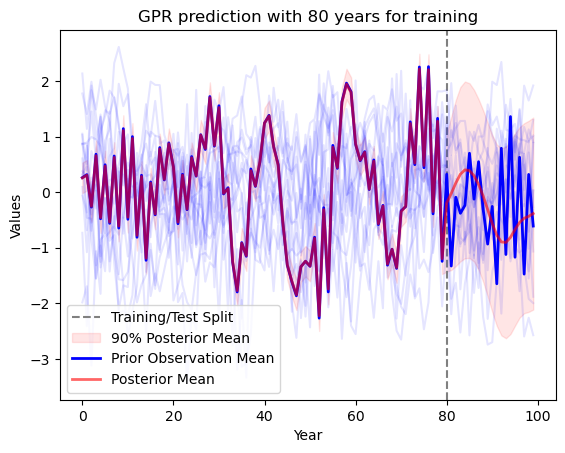

In [102]:
def polype3_rqrbf_matern(best_params):
    custom_poly_kernel = C(best_params['constant1']) * CustomPolynomialKernel(
        degree=2, periods=[best_params['period1'], best_params['period2'], best_params['period3']]
    )
    combined_kernel = (
        C(best_params['constant2']) * RQ(length_scale=best_params['rq_ls'], alpha=best_params['rq_alpha']) *
        RBF(length_scale=best_params['rbf_length']) +
        C(best_params['constant3']) * Matern(length_scale=best_params['constant4'], nu=best_params['nu']) +
        WhiteKernel(noise_level=best_params['noise_level'])
    )
    return custom_poly_kernel + combined_kernel

pbounds = {
    'period1': (10, 30),
    'period2': (10, 30),
    'period3': (10, 30),
    'rq_alpha': (1e-2, 1),
    'rbf_length': (1e-2, 1e2),
    'noise_level': (1e-2, 1),
    'constant1': (1e-3, 0.5),
    'constant2': (1e-3, 0.5),
    'constant3': (1e-3, 0.5),
    'constant4': (1e-3, 0.5),
    'nu': (0.5, 2.5),
    'rq_ls': (1e-2, 1e2)
}

gpr_model(mod_ids, 20, rainfall_yearly, pbounds, polype3_rqrbf_matern, oos_gcm)
gpr_model(mod_ids, 40, rainfall_yearly, pbounds, polype3_rqrbf_matern, oos_gcm)
gpr_model(mod_ids, 60, rainfall_yearly, pbounds, polype3_rqrbf_matern, oos_gcm)
gpr_model(mod_ids, 80, rainfall_yearly, pbounds, polype3_rqrbf_matern, oos_gcm)

Optimization Progress:   0%|          | 0/200 [00:00<?, ?it/s]

|   iter    |  target   | constant1 | constant2 | constant3 | constant4 | noise_... |  period1  |  period2  |  period3  | rbf_le... | rbf_le... | rq_alpha  |   rq_ls   |
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------
|  1        | -497.6    |  0.1539   |  0.1585   |  0.9855   |  0.9046   |  1.869    |  15.35    |  16.68    |  22.89    |  25.15    |  63.52    |  57.98    |  61.88    |
|  2        | -680.7    |  0.3684   |  0.2589   |  0.1952   |  0.553    |  8.258    |  20.07    |  23.75    |  25.19    |  64.23    |  38.51    |  8.02     |  80.75    |
|  3        | -719.8    |  0.8117   |  0.05178  |  0.5947   |  0.9683   |  9.862    |  26.4     |  23.8     |  22.46    |  59.93    |  68.16    |  83.87    |  46.01    |
|  4        | -690.2    |  0.5482   |  0.9565   |  0.2847   |  0.4849   |  8.133    |  22.14    |  22.7     |  18.33    |  78.13    |  30.43    |  75.

Optimization Progress:   0%|          | 0/200 [00:05<?, ?it/s]

Total log marginal likelihood for best parameters found during the optimization process:  -376.5778682427067


total_lml_train: -376.5778682427067
total_lml_test: -1526.0218747549684
total_lml_full: -2029.9169359105776
best kernel is: 0.591**2 * CustomPolynomialKernel() + 0.718**2 * RationalQuadratic(alpha=25.2, length_scale=86.3) * RBF(length_scale=25.8) + 0.189**2 * RBF(length_scale=82) + WhiteKernel(noise_level=0.316)
observation_lml_train: -29.16517475562683
observation_lml_test: -114.61339821115493
observation_lml_full: -146.1197696377527


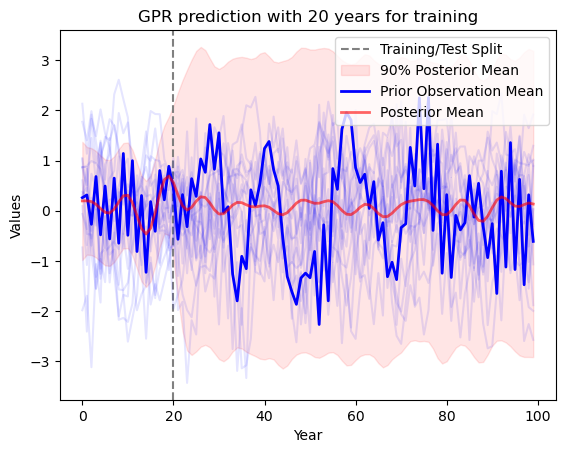

Optimization Progress:   0%|          | 0/200 [00:00<?, ?it/s]

|   iter    |  target   | constant1 | constant2 | constant3 | constant4 | noise_... |  period1  |  period2  |  period3  | rbf_le... | rbf_le... | rq_alpha  |   rq_ls   |
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------
|  1        | -987.2    |  0.1539   |  0.1585   |  0.9855   |  0.9046   |  1.869    |  15.35    |  16.68    |  22.89    |  25.15    |  63.52    |  57.98    |  61.88    |
|  2        | -1.355e+0 |  0.3684   |  0.2589   |  0.1952   |  0.553    |  8.258    |  20.07    |  23.75    |  25.19    |  64.23    |  38.51    |  8.02     |  80.75    |
|  3        | -1.423e+0 |  0.8117   |  0.05178  |  0.5947   |  0.9683   |  9.862    |  26.4     |  23.8     |  22.46    |  59.93    |  68.16    |  83.87    |  46.01    |
|  4        | -1.371e+0 |  0.5482   |  0.9565   |  0.2847   |  0.4849   |  8.133    |  22.14    |  22.7     |  18.33    |  78.13    |  30.43    |  75.

Optimization Progress:   0%|          | 0/200 [00:05<?, ?it/s]

|  99       | -1.355e+0 |  0.9828   |  0.6961   |  0.2916   |  0.1382   |  6.344    |  22.18    |  16.97    |  14.6     |  36.07    |  19.42    |  15.48    |  38.75    |
|  100      | -1.272e+0 |  0.4908   |  0.9311   |  0.2319   |  0.1952   |  5.287    |  25.2     |  10.86    |  27.37    |  84.3     |  96.6     |  23.92    |  23.64    |
An error occurred during optimization: 'x0' must only have one dimension.
Best parameters found during the optimization process:  {'constant1': 0.3490978119648436, 'constant2': 0.51563708004796, 'constant3': 0.03587469408409572, 'constant4': 0.286795108239508, 'noise_level': 0.3158063926132095, 'period1': 26.17586588392698, 'period2': 17.679817562763322, 'period3': 14.662480524047401, 'rbf_length1': 25.75686939928519, 'rbf_length2': 81.99508109521744, 'rq_alpha': 25.16848071349691, 'rq_ls': 86.3337379725817}
Total log marginal likelihood for best parameters found during the optimization process:  -747.0068666428647


total_lml_train: -747.0068666428647
total_lml_test: -1150.2431288426951
total_lml_full: -2029.9169359105776
best kernel is: 0.591**2 * CustomPolynomialKernel() + 0.718**2 * RationalQuadratic(alpha=25.2, length_scale=86.3) * RBF(length_scale=25.8) + 0.189**2 * RBF(length_scale=82) + WhiteKernel(noise_level=0.316)
observation_lml_train: -51.892100647745686
observation_lml_test: -92.13039908243103
observation_lml_full: -146.1197696377527


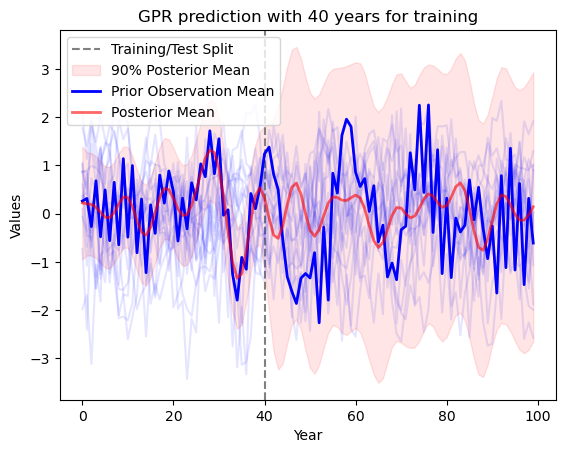

Optimization Progress:   0%|          | 0/200 [00:00<?, ?it/s]

|   iter    |  target   | constant1 | constant2 | constant3 | constant4 | noise_... |  period1  |  period2  |  period3  | rbf_le... | rbf_le... | rq_alpha  |   rq_ls   |
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------
|  1        | -1.492e+0 |  0.1539   |  0.1585   |  0.9855   |  0.9046   |  1.869    |  15.35    |  16.68    |  22.89    |  25.15    |  63.52    |  57.98    |  61.88    |
|  2        | -2.029e+0 |  0.3684   |  0.2589   |  0.1952   |  0.553    |  8.258    |  20.07    |  23.75    |  25.19    |  64.23    |  38.51    |  8.02     |  80.75    |
|  3        | -2.124e+0 |  0.8117   |  0.05178  |  0.5947   |  0.9683   |  9.862    |  26.4     |  23.8     |  22.46    |  59.93    |  68.16    |  83.87    |  46.01    |
|  4        | -2.053e+0 |  0.5482   |  0.9565   |  0.2847   |  0.4849   |  8.133    |  22.14    |  22.7     |  18.33    |  78.13    |  30.43    |  75.

Optimization Progress:   0%|          | 0/200 [00:05<?, ?it/s]

Total log marginal likelihood for best parameters found during the optimization process:  -1125.4071770985556


total_lml_train: -1125.4071770985556
total_lml_test: -768.0728615410213
total_lml_full: -2029.9169359105776
best kernel is: 0.591**2 * CustomPolynomialKernel() + 0.718**2 * RationalQuadratic(alpha=25.2, length_scale=86.3) * RBF(length_scale=25.8) + 0.189**2 * RBF(length_scale=82) + WhiteKernel(noise_level=0.316)
observation_lml_train: -77.26231527340317
observation_lml_test: -67.09434480723031
observation_lml_full: -146.1197696377527


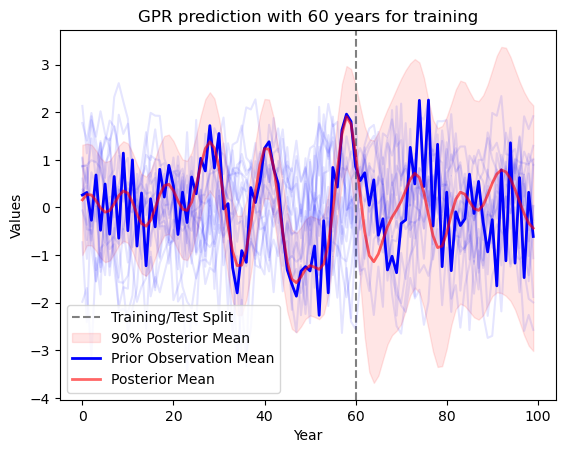

Optimization Progress:   0%|          | 0/200 [00:00<?, ?it/s]

|   iter    |  target   | constant1 | constant2 | constant3 | constant4 | noise_... |  period1  |  period2  |  period3  | rbf_le... | rbf_le... | rq_alpha  |   rq_ls   |
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------
|  1        | -1.981e+0 |  0.1539   |  0.1585   |  0.9855   |  0.9046   |  1.869    |  15.35    |  16.68    |  22.89    |  25.15    |  63.52    |  57.98    |  61.88    |
|  2        | -2.703e+0 |  0.3684   |  0.2589   |  0.1952   |  0.553    |  8.258    |  20.07    |  23.75    |  25.19    |  64.23    |  38.51    |  8.02     |  80.75    |
|  3        | -2.825e+0 |  0.8117   |  0.05178  |  0.5947   |  0.9683   |  9.862    |  26.4     |  23.8     |  22.46    |  59.93    |  68.16    |  83.87    |  46.01    |
|  4        | -2.729e+0 |  0.5482   |  0.9565   |  0.2847   |  0.4849   |  8.133    |  22.14    |  22.7     |  18.33    |  78.13    |  30.43    |  75.

Optimization Progress:   0%|          | 0/200 [00:08<?, ?it/s]

|  100      | -2.517e+0 |  0.4908   |  0.9311   |  0.2319   |  0.1952   |  5.287    |  25.2     |  10.86    |  27.37    |  84.3     |  96.6     |  23.92    |  23.64    |
An error occurred during optimization: 'x0' must only have one dimension.
Best parameters found during the optimization process:  {'constant1': 0.3490978119648436, 'constant2': 0.51563708004796, 'constant3': 0.03587469408409572, 'constant4': 0.286795108239508, 'noise_level': 0.3158063926132095, 'period1': 26.17586588392698, 'period2': 17.679817562763322, 'period3': 14.662480524047401, 'rbf_length1': 25.75686939928519, 'rbf_length2': 81.99508109521744, 'rq_alpha': 25.16848071349691, 'rq_ls': 86.3337379725817}
Total log marginal likelihood for best parameters found during the optimization process:  -1494.6041509747458


total_lml_train: -1494.6041509747458
total_lml_test: -393.20601827748203
total_lml_full: -2029.9169359105776
best kernel is: 0.591**2 * CustomPolynomialKernel() + 0.718**2 * RationalQuadratic(alpha=25.2, length_scale=86.3) * RBF(length_scale=25.8) + 0.189**2 * RBF(length_scale=82) + WhiteKernel(noise_level=0.316)
observation_lml_train: -107.87649179517118
observation_lml_test: -36.09887132892332
observation_lml_full: -146.1197696377527


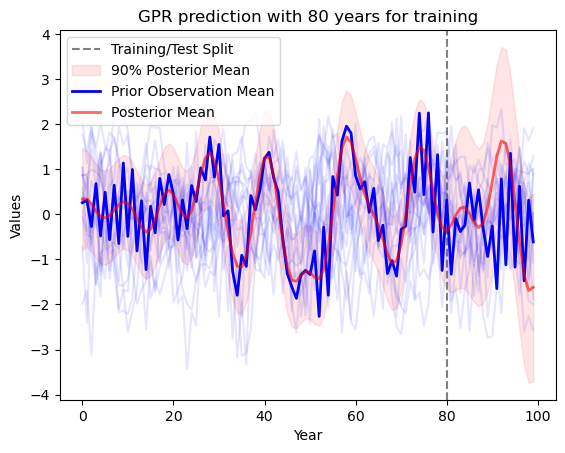

In [103]:
def polype3_rqrbf_rbf(best_params):
    custom_poly_kernel = C(best_params['constant1']) * CustomPolynomialKernel(
        degree=2, periods=[best_params['period1'], best_params['period2'], best_params['period3']]
    )
    combined_kernel = (
        C(best_params['constant2']) * RQ(length_scale=best_params['rq_ls'], alpha=best_params['rq_alpha']) *
        RBF(length_scale=best_params['rbf_length1']) +
        C(best_params['constant3']) * RBF(length_scale=best_params['rbf_length2']) +
        WhiteKernel(noise_level=best_params['noise_level'])
    )
    return custom_poly_kernel + combined_kernel

pbounds = {
    'period1': (10, 30),
    'period2': (10, 30),
    'period3': (10, 30),
    'rq_alpha': (1e-2, 1e2),
    'rbf_length1': (1e-2, 1e2),
    'rbf_length2': (1e-2, 1e2),
    'noise_level': (1e-2, 1e1),
    'constant1': (1e-3, 1),
    'constant2': (1e-3, 1),
    'constant3': (1e-3, 1),
    'constant4': (1e-3, 1),
    'rq_ls': (1e-2, 1e2)
}

gpr_model(mod_ids, 20, rainfall_yearly, pbounds, polype3_rqrbf_rbf, oos_gcm)
gpr_model(mod_ids, 40, rainfall_yearly, pbounds, polype3_rqrbf_rbf, oos_gcm)
gpr_model(mod_ids, 60, rainfall_yearly, pbounds, polype3_rqrbf_rbf, oos_gcm)
gpr_model(mod_ids, 80, rainfall_yearly, pbounds, polype3_rqrbf_rbf, oos_gcm)

Optimization Progress:   0%|          | 0/200 [00:00<?, ?it/s]

|   iter    |  target   | constant1 | constant2 | constant3 | constant4 | noise_... |  period1  |  period2  | rbf_le... | rbf_le... | rq_alpha  |   rq_ls   |
-------------------------------------------------------------------------------------------------------------------------------------------------------------
|  1        | -3.865e+0 |  374.5    |  950.7    |  732.0    |  598.7    |  1.569    |  13.12    |  11.16    |  86.62    |  60.12    |  70.81    |  2.068    |
|  2        | -2.742e+0 |  969.9    |  832.4    |  212.3    |  181.8    |  1.842    |  16.08    |  20.5     |  43.2     |  29.13    |  61.19    |  13.96    |
|  3        | -2.995e+0 |  292.1    |  366.4    |  456.1    |  785.2    |  2.005    |  20.28    |  21.85    |  4.655    |  60.76    |  17.06    |  6.515    |
|  4        | -2.634e+0 |  948.9    |  965.6    |  808.4    |  304.6    |  0.9857   |  23.68    |  18.8     |  12.21    |  49.52    |  3.449    |  90.93    |
|  5        | -2.967e+0 |  258.8    |  662.5    |  3

Optimization Progress:   0%|          | 0/200 [00:09<?, ?it/s]

|  99       | -2.8e+03  |  218.3    |  950.0    |  786.3    |  89.41    |  4.182    |  27.58    |  28.89    |  46.75    |  61.35    |  16.71    |  99.12    |
|  100      | -3.123e+0 |  231.7    |  942.7    |  649.6    |  607.7    |  5.132    |  14.61    |  13.53    |  22.06    |  18.65    |  77.96    |  35.02    |
An error occurred during optimization: 'x0' must only have one dimension.
Best parameters found during the optimization process:  {'constant1': 795.1863995825089, 'constant2': 270.83298042982295, 'constant3': 438.9719817342154, 'constant4': 78.45730288588462, 'noise_level': 0.26325392672042053, 'period1': 29.252968293558503, 'period2': 26.719602410244118, 'rbf_length1': 69.60046086730887, 'rbf_length2': 40.901204911982845, 'rq_alpha': 17.33769906388387, 'rq_ls': 15.652139896681893}


total_lml_train: -2212.5910135373692
total_lml_test: -629.8286945629845
total_lml_full: -2714.431631544723
best kernel is: 28.2**2 * CustomPolynomialKernel() + 16.5**2 * CustomPolynomialKernel() + 21**2 * RationalQuadratic(alpha=17.3, length_scale=15.7) * RBF(length_scale=69.6) + 8.86**2 * RBF(length_scale=40.9) + WhiteKernel(noise_level=0.263)


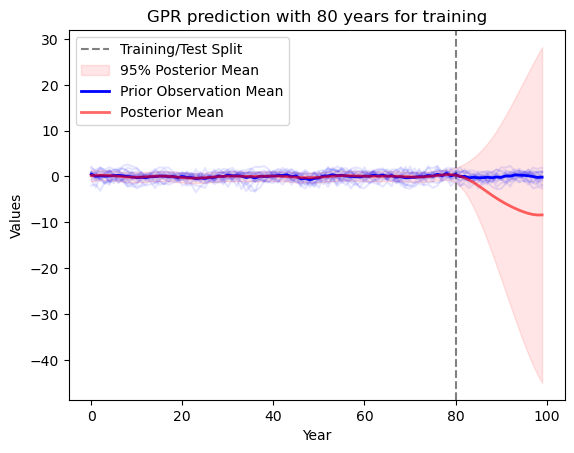

In [53]:
def polype3_rqrbf_rbf(best_params):
    custom_poly_kernel1 = C(best_params['constant1']) * CustomPolynomialKernel(
        degree=2, periods=best_params['period1']
    )
    custom_poly_kernel2 = C(best_params['constant2']) * CustomPolynomialKernel(
        degree=2, periods=best_params['period2']
    )
    combined_kernel = (
        custom_poly_kernel1 +
        custom_poly_kernel2 +
        C(best_params['constant3']) * RQ(length_scale=best_params['rq_ls'], alpha=best_params['rq_alpha']) * 
        RBF(length_scale=best_params['rbf_length1']) +
        C(best_params['constant4']) * RBF(length_scale=best_params['rbf_length2']) +
        WhiteKernel(noise_level=best_params['noise_level'])
    )
    return combined_kernel

pbounds = {
    'period1': (10, 30),
    'period2': (10, 30),
    'rq_alpha': (1e-2, 1e2),
    'rbf_length1': (1e-2, 1e2),
    'rbf_length2': (1e-2, 1e2),
    'noise_level': (1e-2, 1e1),
    'constant1': (1e-3, 1e3),
    'constant2': (1e-3, 1e3),
    'constant3': (1e-3, 1e3),
    'constant4': (1e-3, 1e3),
    'rq_ls': (1e-2, 1e2)
}

gpr_model(mod_ids, 80, rainfall_yearly, pbounds, polype3_rqrbf_rbf)